In [1]:
import numpy as np
print(np.__version__)
print(np.__file__)

import matplotlib.pyplot as plt
import matplotlib
import jax
import jax.numpy as jnp
import jax.scipy as jsp
import jax.scipy.special  # Import for rel_entr function
from jax.scipy import optimize
import scipy.stats
import dataclasses
from functools import partial
from typing import Callable, Union

# Update matplotlib parameters for consistent styling
matplotlib.rcParams.update({
    'font.size': 14,            # General font size
    'axes.labelsize': 14,       # Axis label size
    'axes.titlesize': 14,       # Title size
    'xtick.labelsize': 14,      # X-tick label size
    'ytick.labelsize': 14,      # Y-tick label size
    'legend.fontsize': 14       # Legend font size
})

print(jax.devices())

# Problem setup parameters
nx = 256
nv = 256
dt = 0.1
t_final = 30  # Adjusted for demonstration purposes
hv = 0.1      # Example value for velocity step (modify as per your setup)
hx = 0.1      # Example value for space step (modify as per your setup)

# Mesh dataclass
@dataclasses.dataclass
class Mesh:
    xs: jnp.ndarray
    dx: float
    vs: jnp.ndarray
    dv: float
    V: jnp.ndarray
    X: jnp.ndarray
    period_x: float
    period_v: float
    nx: int
    nv: int

# Function to create a mesh
def make_mesh(length_x: float, length_v: float, nx: int, nv: int) -> Mesh:
    xs = jnp.linspace(0., length_x, nx, endpoint=False)
    dx = float(xs[1] - xs[0])  # Convert to Python float
    vs = jnp.linspace(-length_v, length_v, nv, endpoint=False)
    dv = float(vs[1] - vs[0])  # Convert to Python float
    V, X = jnp.meshgrid(vs, xs)
    return Mesh(xs=xs, dx=dx, vs=vs, dv=dv, X=X, V=V,
                period_x=length_x, period_v=length_v, nx=nx, nv=nv)

# Helper functions for the backward solver

@partial(jax.jit, static_argnums=(0, 1, 2))  # nx, period_x, d are static
def compute_E_from_rho_pure(nx: int, period_x: float, d: float, rho: jnp.ndarray) -> jnp.ndarray:
    rho_hat = jnp.fft.fft(rho)
    kx = 2 * jnp.pi * jnp.fft.fftfreq(nx, d=d)
    kx = jnp.where(kx == 0, 1e-10, kx)  # Avoid division by zero
    inv_multiplier = -1.0 / (1j * kx)
    E_hat = inv_multiplier * rho_hat
    E_hat = E_hat.at[0].set(0.0)  # Enforce zero mean
    return jnp.real(jnp.fft.ifft(E_hat))

@jax.jit
def semilag_x_pure(xs: jnp.ndarray, vs: jnp.ndarray, period_x: float, dt: float, f: jnp.ndarray, sign: float = 1.0) -> jnp.ndarray:
    def interp_x(v, f_col):
        shift = sign * 0.5 * v * dt
        return jnp.interp(xs - shift, xs, f_col, period=period_x)
    return jax.vmap(interp_x, in_axes=(0, 1), out_axes=1)(vs, f.T)

@jax.jit
def semilag_v_pure(vs: jnp.ndarray, period_v: float, dv: float, dt: float, f: jnp.ndarray, E: jnp.ndarray,
                   s: Union[jnp.ndarray, None] = None, sign: float = 1.0) -> jnp.ndarray:
    def interp_v(E_i, f_row):
        shift = sign * E_i * dt
        result = jnp.interp(vs - shift, vs, f_row, period=2.0 * period_v)
        if s is not None:
            result += sign * dt * s
        return result
    return jax.vmap(interp_v, in_axes=(0, 0), out_axes=0)(E, f)

@jax.jit
def shift_by_n_pure(vs: jnp.ndarray, dv: float, dt: float, g: jnp.ndarray, EH: jnp.ndarray) -> jnp.ndarray:
    n = jnp.floor(-dt * EH / dv).astype(int)  # Shape (nx,)

    def shift_row(shift, row):
        return jnp.roll(row, -shift)
    return jax.vmap(shift_row, in_axes=(0, 0))(n, g)

@partial(jax.jit, static_argnums=(2, 3, 4, 5, 6, 7))  # period_x, d, period_v, dv, dt, nx are static
def time_step_backward_pure(xs: jnp.ndarray, vs: jnp.ndarray, period_x: float, d: float, period_v: float,
                            dv: float, dt: float, nx: int, f: jnp.ndarray, f_star: jnp.ndarray, EH_star: jnp.ndarray) -> tuple:
    # Perform semilagrangian step in x with sign=-1.0
    f = semilag_x_pure(xs, vs, period_x, dt, f, sign=-1.0)
    g_starstar = f

    # Shift by n
    g_ss_s = shift_by_n_pure(vs, dv, dt, g_starstar, EH_star)

    # Compute derivative
    g_ss_d = (g_ss_s - jnp.roll(g_ss_s, 1, axis=1)) / dv

    # Compute rho
    rho = jnp.sum(g_ss_d * f_star, axis=1) * dv

    # Compute electric field from rho
    s = compute_E_from_rho_pure(nx, period_x, d, rho)

    # Perform semilagrangian step in v with sign=-1.0 and source term s
    f = semilag_v_pure(vs, period_v, dv, dt, f, EH_star, s, sign=-1.0)

    # Perform semilagrangian step in x with sign=-1.0
    f = semilag_x_pure(xs, vs, period_x, dt, f, sign=-1.0)

    return g_starstar, f

# Vlasov-Poisson Solver class with forward and backward solvers
@dataclasses.dataclass(frozen=True)
class VlasovPoissonSolver:
    mesh: Mesh
    dt: float
    f_eq: jnp.ndarray  # Equilibrium distribution

    # Forward solver methods
    def semilag_x(self, f: jnp.ndarray) -> jnp.ndarray:
        out = jnp.zeros_like(f)
        for i, v in enumerate(self.mesh.vs):
            out = out.at[:, i].set(
                jnp.interp(
                    self.mesh.xs - 0.5 * v * self.dt,
                    self.mesh.xs,
                    f[:, i],
                    period=self.mesh.period_x
                )
            )
        return out

    def semilag_v(self, f: jnp.ndarray, E: jnp.ndarray, s: Union[jnp.ndarray, None] = None) -> jnp.ndarray:
        out = jnp.zeros_like(f)
        if jnp.sum((jnp.real(E) * self.dt % self.mesh.dv) == 0) != 0.0:
            raise ValueError("E*dt shouldn't be a multiple of dv.")
        for i in range(self.mesh.nx):
            out = out.at[i, :].set(
                jnp.interp(
                    self.mesh.vs - E[i] * self.dt,
                    self.mesh.vs,
                    f[i, :],
                    period=2.0 * self.mesh.period_v
                )
            )
            if s is not None:
                out = out.at[i, :].add(self.dt * s[i])
        return out

    def build_semilag_x(self) -> Callable[[jnp.ndarray], jnp.ndarray]:
        def interp_jax_x(f, v):
            return jnp.interp(
                self.mesh.xs - 0.5 * v * self.dt,
                self.mesh.xs,
                f,
                period=self.mesh.period_x
            )
        interp_vmap = jax.vmap(interp_jax_x, in_axes=(1, 0), out_axes=1)
        def semilag_x(f):
            return interp_vmap(f, self.mesh.vs)
        return semilag_x

    def build_semilag_v(self) -> Callable[[jnp.ndarray, jnp.ndarray], jnp.ndarray]:
        def interp_jax_v(f: jnp.ndarray, E: jnp.ndarray) -> jnp.ndarray:
            return jnp.interp(
                self.mesh.vs - E * self.dt,
                self.mesh.vs,
                f,
                period=2 * self.mesh.period_v
            )
        return jax.vmap(interp_jax_v, in_axes=(0, 0), out_axes=0)

    def compute_rho(self, f: jnp.ndarray) -> jnp.ndarray:
        return self.mesh.dv * jnp.sum(self.f_eq - f, axis=1)

    def compute_E_from_rho(self, rho: jnp.ndarray) -> jnp.ndarray:
        rho_hat = jnp.fft.fft(rho)
        E_hat = jnp.zeros_like(rho_hat)
        inv_multiplier = -1.0 / (1j * 2 * jnp.pi * jnp.fft.fftfreq(self.mesh.nx, d=self.mesh.period_x / self.mesh.nx)[1:])
        E_hat = E_hat.at[1:].set(inv_multiplier * rho_hat[1:])
        return jnp.real(jnp.fft.ifft(E_hat))

    def compute_E(self, f: jnp.ndarray) -> jnp.ndarray:
        return self.compute_E_from_rho(self.compute_rho(f))

    def compute_electric_energy(self, E: jnp.ndarray) -> jnp.ndarray:
        return 0.5 * jnp.sum(jnp.square(E)) * self.mesh.dx

    @jax.jit
    def time_step(self, f: jnp.ndarray, H: jnp.ndarray) -> tuple:
        f_half = self.semilag_x(f)
        E = self.compute_E(f_half)
        E_total = E + H
        f = self.semilag_v(f_half, E_total)
        f = self.semilag_x(f)
        return f, f_half, E_total

    def run_forward_jax_loop(self, f_iv: jnp.ndarray, H: jnp.ndarray, t_final: float) -> tuple:
        """
        Run the forward solver over the entire time span without using jax.lax.scan.
        Collects the results for all time steps in separate arrays.

        Args:
            f_iv (jnp.ndarray): Initial value of the distribution function f.
            H (jnp.ndarray): Control field applied.
            t_final (float): Final time for the simulation.

        Returns:
            tuple: Arrays representing f, f_half, E, and ee for all time steps.
        """
        num_steps = int(t_final / self.dt)
        f = f_iv.copy()

        # Allocate arrays to store the results for each time step
        f_array = []
        f_half_array = []
        E_array = []
        ee_array = []

        # Get the compiled versions of the necessary functions
        semilag_x = self.build_semilag_x()
        semilag_v = self.build_semilag_v()
        compute_E_jax = jax.jit(self.compute_E)
        compute_energy_jax = jax.jit(self.compute_electric_energy)

        # Iterate over the number of time steps
        for _ in range(num_steps):
            # Perform the time step
            f_half = semilag_x(f)
            E = compute_E_jax(f_half)
            E_total = E + H
            ee = compute_energy_jax(E)
            f = semilag_v(f_half, E_total)
            f = semilag_x(f)

            # Store the current time step results
            f_array.append(f)
            f_half_array.append(f_half)
            E_array.append(E_total)
            ee_array.append(ee)

        # Convert lists to JAX arrays for consistency
        f_array = jnp.stack(f_array, axis=0)  # Shape (num_steps, nx, nv)
        E_array = jnp.stack(E_array, axis=0)  # Shape (num_steps, nx)
        ee_array = jnp.stack(ee_array, axis=0)  # Shape (num_steps,)

        return f_array, E_array, ee_array


    
    # Backward solver methods
    def run_backward_loop(self, gT: jnp.ndarray, f_stars: jnp.ndarray, E_stars: jnp.ndarray) -> tuple:
        """
        Run the backward solver iteratively without using jax.lax.scan.
        Collects the results for all time steps in separate arrays.

        Args:
            gT (jnp.ndarray): Terminal gradient (initial condition for the backward pass).
            f_stars (jnp.ndarray): Intermediate forward solutions from the forward pass.
            E_stars (jnp.ndarray): Electric fields computed during the forward pass.

        Returns:
            tuple: Arrays representing g_starstars and fs for all time steps.
        """
        # Ensure `f_stars` and `E_stars` have consistent lengths
        num_steps = f_stars.shape[0]
        if num_steps != E_stars.shape[0]:
            raise ValueError("Mismatch in number of time steps for f_stars and E_stars. Ensure they all have consistent lengths.")

        # Reverse the arrays for backward pass
        f_stars_rev = f_stars[::-1]
        E_stars_rev = E_stars[::-1]
        f = gT  # Initial condition for backward pass

        # Allocate arrays to store the results for each time step
        g_starstars_array = []
        fs_array = []

        # Iterate over the number of time steps in reverse
        for f_star, EH_star in zip(f_stars_rev, E_stars_rev):
            d = float(self.mesh.period_x / self.mesh.nx)  # Ensure 'd' is a Python float
            g_starstar, f = time_step_backward_pure(
                self.mesh.xs,              # xs
                self.mesh.vs,              # vs
                float(self.mesh.period_x), # period_x
                d,                         # d
                float(self.mesh.period_v), # period_v
                float(self.mesh.dv),       # dv
                float(self.dt),            # dt
                int(self.mesh.nx),         # nx
                f,                         # f
                f_star,                    # f_star
                EH_star                    # EH_star
            )
            
            # Store the current time step results
            g_starstars_array.append(g_starstar)
            fs_array.append(f)

        # Reverse the outputs to match the forward time order
        fs_array = fs_array[::-1]
        g_starstars_array = g_starstars_array[::-1]

        # Convert lists to JAX arrays for consistency
        fs_array = jnp.stack(fs_array, axis=0)  # Shape (num_steps, nx, nv)
        g_starstars_array = jnp.stack(g_starstars_array, axis=0)  # Shape (num_steps, nx, nv)

        return fs_array, g_starstars_array


    def calc_cost_gradient(self, H: jnp.ndarray, f_iv: jnp.ndarray, t_final: float) -> tuple:
        """
        Calculate the cost and its gradient with respect to the external field H.

        Args:
            H (jnp.ndarray): External field.
            f_eq (jnp.ndarray): Equilibrium distribution function.
            t_final (float): Final time for the simulation.

        Returns:
            tuple: Cost, gradient, f_array, and ee_array.
        """
        # Run forward solver
        f_array, E_array, ee_array = self.run_forward_jax_loop(f_iv, H, t_final)

        # Compute cost
        cost = jnp.sum((f_array[-1] - f_eq) ** 2) * self.mesh.dx * self.mesh.dv

        # Compute terminal gradient
        gT = 2 * (f_array[-1] - f_eq) / self.dt
        
        print(gT.shape)

        # Run backward solver
        f_back_array, g_starstars = self.run_backward_loop(gT, f_array, E_array)

        # Ensure all arrays have consistent time steps for vmap operation
        num_steps = f_array.shape[0]
        if num_steps != E_array.shape[0] or num_steps != g_starstars.shape[0]:
            raise ValueError("Mismatch in time steps across f_array, E_array, and g_starstars. Ensure consistent time steps.")

#         # Debug: Print shapes to verify consistency
#         print("Shapes:")
#         print("f_array:", f_array.shape)       # Expected (time_steps, nx, nv)
#         print("g_starstars:", g_starstars.shape)  # Expected (time_steps, nx, nv)
#         print("E_array:", E_array.shape)       # Expected (time_steps, nx)

        # Compute the gradient
        hv = self.mesh.dv
        dt = self.dt
        hx = self.mesh.dx

        # Vectorize the gradient computation over time steps
        def compute_gradient(f_star, g_starstar, E_star):
            f_ss_s = shift_by_n_pure(self.mesh.vs, hv, dt, f_star, E_star)

            # Ensure f_ss_s is 2D before applying jnp.roll
            if f_ss_s.ndim == 1:
                f_ss_s = jnp.expand_dims(f_ss_s, axis=-1)
            f_ss_d = (f_ss_s - jnp.roll(f_ss_s, shift=-1, axis=1)) / hv

            grad = jnp.sum(f_ss_d * g_starstar, axis=1) * hv
            return grad

        # Apply vmap across the time dimension (axis 0) of f_array and E_array
        gradient_list = jax.vmap(compute_gradient)(f_array, g_starstars, E_array)
        gradient = jnp.sum(gradient_list, axis=0) * dt ** 2 * hx

        return cost, gradient, f_array, ee_array


    def calc_cost_only(self, H: jnp.ndarray, f_iv: jnp.ndarray, t_final: float):
        """
        Calculate only the cost without computing the gradient.

        Args:
            H (jnp.ndarray): External field.
            f_eq (jnp.ndarray): Equilibrium distribution function.
            t_final (float): Final time for the simulation.

        Returns:
            float: Cost.
        """
        f_array, _, _ = self.run_forward_jax_loop(f_iv, H, t_final)
        cost = jnp.sum((f_array[-1] - f_eq) ** 2) * self.mesh.dx * self.mesh.dv
        return cost
    

    # Backward solver methods
    def run_backward_loop_KL(self, gT: jnp.ndarray, f_stars: jnp.ndarray, E_stars: jnp.ndarray) -> tuple:
        """
        Run the backward solver iteratively without using jax.lax.scan.
        Collects the results for all time steps in separate arrays.

        Args:
            gT (jnp.ndarray): Terminal gradient (initial condition for the backward pass).
            f_stars (jnp.ndarray): Intermediate forward solutions from the forward pass.
            E_stars (jnp.ndarray): Electric fields computed during the forward pass.

        Returns:
            tuple: Arrays representing g_starstars and fs for all time steps.
        """
        # Ensure `f_stars` and `E_stars` have consistent lengths
        num_steps = f_stars.shape[0]
        if num_steps != E_stars.shape[0]:
            raise ValueError("Mismatch in number of time steps for f_stars and E_stars. Ensure they all have consistent lengths.")

        # Reverse the arrays for backward pass
        f_stars_rev = f_stars[::-1]
        E_stars_rev = E_stars[::-1]
        f = gT  # Initial condition for backward pass

        # Allocate arrays to store the results for each time step
        g_starstars_array = []
        fs_array = []

        # Iterate over the number of time steps in reverse
        for f_star, EH_star in zip(f_stars_rev, E_stars_rev):
            d = float(self.mesh.period_x / self.mesh.nx)  # Ensure 'd' is a Python float
            g_starstar, f = time_step_backward_pure(
                self.mesh.xs,              # xs
                self.mesh.vs,              # vs
                float(self.mesh.period_x), # period_x
                d,                         # d
                float(self.mesh.period_v), # period_v
                float(self.mesh.dv),       # dv
                float(self.dt),            # dt
                int(self.mesh.nx),         # nx
                f,                         # f
                f_star,                    # f_star
                EH_star                    # EH_star
            )

            # Store the current time step results
            g_starstars_array.append(g_starstar)
            fs_array.append(f)

        # Reverse the outputs to match the forward time order
        fs_array = fs_array[::-1]
        g_starstars_array = g_starstars_array[::-1]

        # Convert lists to JAX arrays for consistency
        fs_array = jnp.stack(fs_array, axis=0)  # Shape (num_steps, nx, nv)
        g_starstars_array = jnp.stack(g_starstars_array, axis=0)  # Shape (num_steps, nx, nv)

        return fs_array, g_starstars_array


    def calc_cost_gradient_KL(self, H: jnp.ndarray, f_iv: jnp.ndarray, t_final: float) -> tuple:
        """
        Calculate the cost and its gradient with respect to the external field H,
        using KL divergence as the objective function.

        Args:
            H (jnp.ndarray): External field.
            f_iv (jnp.ndarray): Initial distribution function.
            t_final (float): Final time for the simulation.

        Returns:
            tuple: Cost, gradient, f_array, and ee_array.
        """
        # Run forward solver
        f_array, E_array, ee_array = self.run_forward_jax_loop(f_iv, H, t_final)

        # Access the equilibrium distribution function
        f_eq = self.f_eq  # Assuming f_eq is stored as an attribute of the class

        # Compute cost using KL divergence
        # Add a small epsilon to prevent division by zero and log(0)
        epsilon = 1e-10
        f_T = f_array[-1] + epsilon
        f_eq_eps = f_eq + epsilon

        # Use jax.scipy.special.rel_entr for numerical stability
        cost = jnp.sum(jax.scipy.special.rel_entr(f_T, f_eq_eps)) * self.mesh.dx * self.mesh.dv

        # Compute terminal gradient
        gT = (jnp.log(f_T / f_eq_eps) + 1.0) / self.dt  # Shape: (nx, nv)

        # Run backward solver
        f_back_array, g_starstars = self.run_backward_loop_KL(gT, f_array, E_array)

        # Ensure all arrays have consistent time steps for vmap operation
        num_steps = f_array.shape[0]
        if num_steps != E_array.shape[0] or num_steps != g_starstars.shape[0]:
            raise ValueError("Mismatch in time steps across f_array, E_array, and g_starstars. Ensure consistent time steps.")

        # Compute the gradient
        hv = self.mesh.dv
        dt = self.dt
        hx = self.mesh.dx

        # Vectorize the gradient computation over time steps
        def compute_gradient(f_star, g_starstar, E_star):
            f_ss_s = shift_by_n_pure(self.mesh.vs, hv, dt, f_star, E_star)

            # Ensure f_ss_s is 2D before applying jnp.roll
            if f_ss_s.ndim == 1:
                f_ss_s = jnp.expand_dims(f_ss_s, axis=-1)
            f_ss_d = (f_ss_s - jnp.roll(f_ss_s, shift=-1, axis=1)) / hv

            grad = jnp.sum(f_ss_d * g_starstar, axis=1) * hv  # Shape: (nx,)
            return grad

        # Apply vmap across the time dimension (axis 0) of f_array and E_array
        gradient_list = jax.vmap(compute_gradient)(f_array, g_starstars, E_array)
        gradient = jnp.sum(gradient_list, axis=0) * dt ** 2 * hx  # Shape: (nx,)

        return cost, gradient, f_array, ee_array

    def calc_cost_only_KL(self, H: jnp.ndarray, f_iv: jnp.ndarray, t_final: float):
        """
        Calculate only the cost without computing the gradient,
        using KL divergence as the objective function.

        Args:
            H (jnp.ndarray): External field.
            f_iv (jnp.ndarray): Initial distribution function.
            t_final (float): Final time for the simulation.

        Returns:
            float: Cost.
        """
        f_array, _, _ = self.run_forward_jax_loop(f_iv, H, t_final)

        # Access the equilibrium distribution function
        f_eq = self.f_eq  # Assuming f_eq is stored as an attribute of the class

        # Compute cost using KL divergence
        epsilon = 1e-10
        f_T = f_array[-1] + epsilon
        f_eq_eps = f_eq + epsilon

        # Use jax.scipy.special.rel_entr for numerical stability
        cost = jnp.sum(jax.scipy.special.rel_entr(f_T, f_eq_eps)) * self.mesh.dx * self.mesh.dv

        return cost

1.24.4
/staff/yyue24/.local/lib/python3.10/site-packages/numpy/__init__.py
[CudaDevice(id=0)]


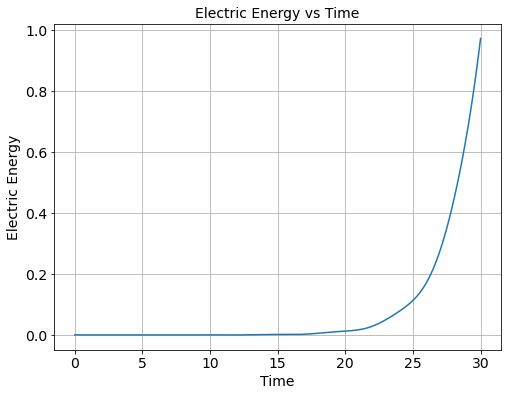

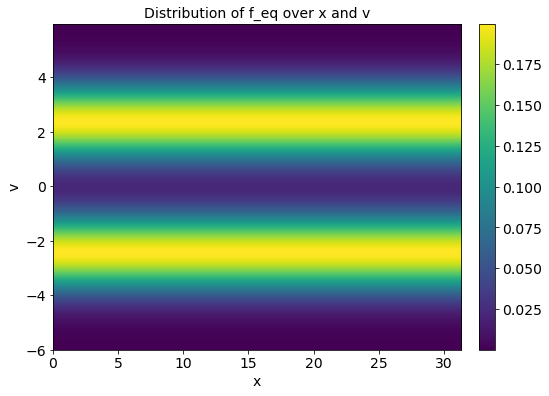

(300, 256, 256)


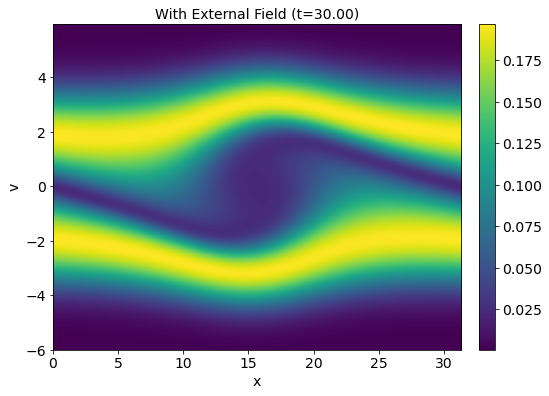

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import jax
import jax.numpy as jnp
import dataclasses
from typing import Callable, Union

# Mesh and Simulation Setup
mesh = make_mesh(10 * jnp.pi, 6.0, nx, nv)

L = 10 * jnp.pi
LV = 6.0
alpha = 0.5
mu1 = 2.4
mu2 = -2.4
f_eq = (alpha * jnp.exp(-0.5 * (mesh.V - mu1)**2) + (1 - alpha) * jnp.exp(-0.5 * (mesh.V - mu2)**2)) / jnp.sqrt(2 * jnp.pi)
epsilon = 0.001
k_0 = 0.2
f_iv = (1.0 + epsilon * jnp.cos(k_0 * mesh.X)) * f_eq

# External field parameters (coefficients for the cosine terms)
a_k = [0, 0, 0, 0.0, 0.0]

# Function to compute the external field H (not time-dependent)
def compute_external_field(xs, a_k):
    H = jnp.zeros(len(xs))  # Initialize H as a 1D array (space)
    for k in range(1, 6):  # Iterate over k from 1 to 5
        H += a_k[k - 1] * jnp.cos(k * xs / L * 2 * jnp.pi)  # Compute H for each k and sum
    return H

# Compute the external field
H = compute_external_field(mesh.xs, a_k)

# Function to plot the distribution of f_eq over x and v
def plot_feq_distribution(ax, f_eq, title):
    im = ax.imshow(f_eq.T, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], 
                   aspect='auto', cmap='viridis')  # 'auto' aspect ratio
    ax.set_title(title)
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)  # Adjusted colorbar size

# Modify the plot_distribution function to handle 2D data
def plot_distribution(ax, data, title, time):
    im = ax.imshow(data.T, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], 
                   aspect='auto', cmap='viridis')  # Transpose data
    ax.set_title(f'{title} (t={time:.2f})')
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)  # Adjusted colorbar size

# Solver initialization
solver = VlasovPoissonSolver(mesh=mesh, dt=dt, f_eq=f_eq)

# Run the forward solver without JIT
f_array, E_array, ee_array = solver.run_forward_jax_loop(f_iv, H, t_final=t_final)

# Plot electric energy over time
fig, ax = plt.subplots(figsize=(8, 6))
t_values = jnp.linspace(0, t_final, int(t_final / dt))

plt.plot(t_values, ee_array)
plt.xlabel('Time')
plt.ylabel('Electric Energy')
plt.title('Electric Energy vs Time')
plt.grid(True)
plt.show()

# Plot the distribution of f_eq over x and v
fig, ax = plt.subplots(figsize=(8, 6))
plot_feq_distribution(ax, f_eq, 'Distribution of f_eq over x and v')
plt.show()

print(f_array.shape)  # This will help understand the dimensions of f_array

# Plot f_array at the final time step
fig, ax = plt.subplots(figsize=(8, 6))
plot_distribution(ax, f_array[-1], 'With External Field', t_final)
plt.show()


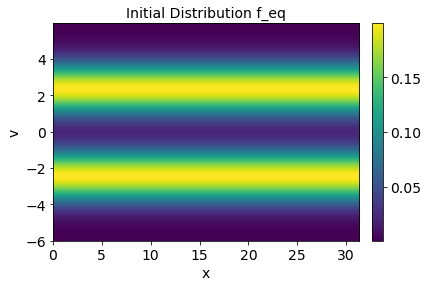

(256, 256)
Iteration 1, Cost: 0.5859899520874023, Coefficients: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]


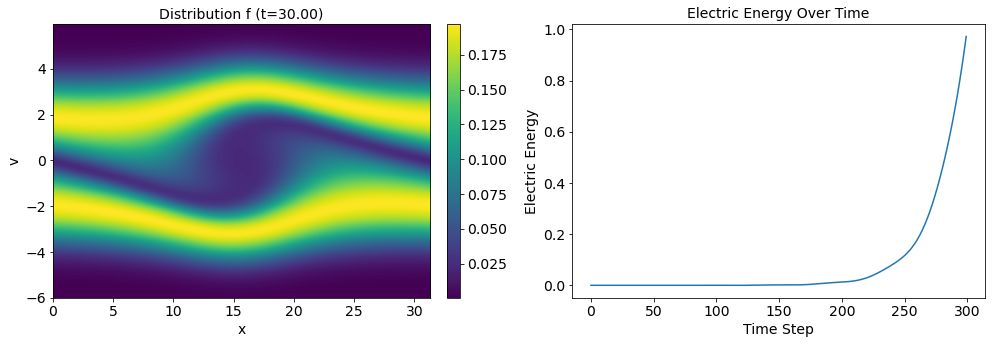

(256, 256)
Iteration 2, Cost: 0.12092819809913635, Coefficients: [ 3.5164488e-04  9.0411077e-06 -3.1953386e-05 -6.0834586e-06
  5.8570990e-06  6.0852408e-06 -2.7067827e-06 -8.1664248e-06
 -8.8577590e-06 -9.7180082e-06 -9.5229143e-06 -9.5641644e-06
 -8.8652696e-06 -8.6681093e-06 -7.7312543e-06 -9.6406386e-04
 -5.9252861e-04  2.9924628e-05  4.2226049e-05  5.3339943e-05
  3.5979556e-05  2.5546415e-05  1.0124806e-05  6.6790512e-06
  1.3618927e-06  3.0158180e-06  7.7909431e-07  3.0062322e-06
  1.2950333e-06  3.2279252e-06]


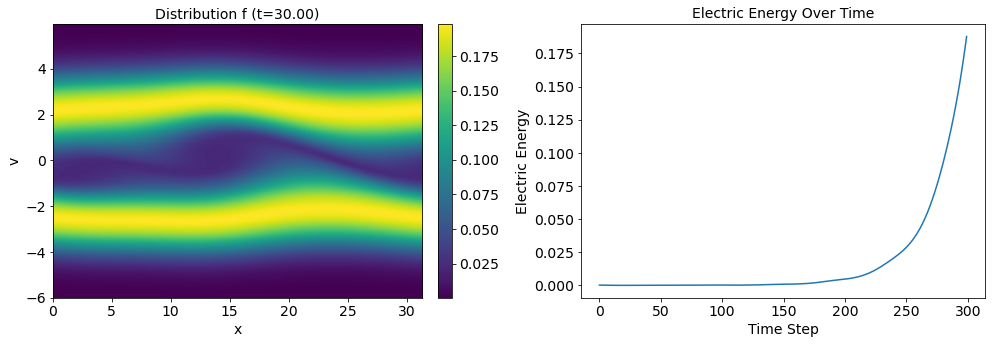

(256, 256)
Iteration 3, Cost: 1.0282074213027954, Coefficients: [ 1.7606250e-04  1.8413848e-04  2.6576778e-05  3.2700784e-05
  2.6234195e-05  3.0124436e-05  2.2107663e-05  1.5987691e-05
  9.0781004e-06  9.1664579e-06  4.7215590e-06  5.5494529e-06
  2.6509606e-06  3.5235016e-06  7.4994477e-07  5.0032855e-04
  2.7407578e-04  1.8389142e-04  1.2808767e-04  8.9027322e-05
  5.3434153e-05  1.9165933e-05  2.2049708e-06 -6.5682466e-06
 -7.4381151e-06 -7.8118328e-06 -6.4120168e-06 -5.4985758e-06
 -4.7907520e-06 -4.0872073e-06]


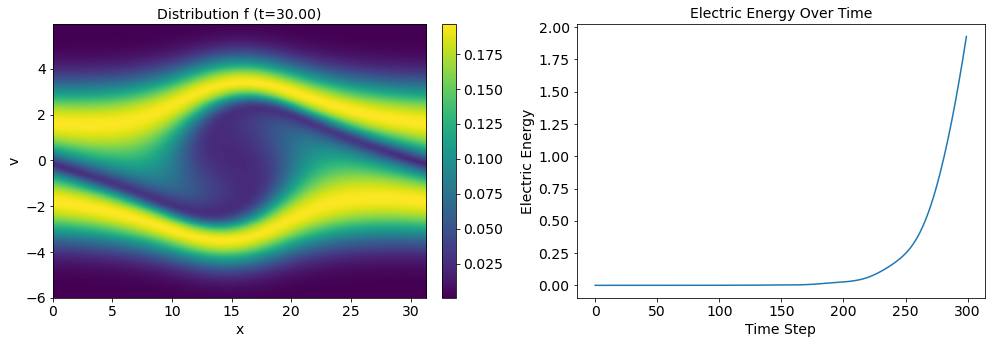

(256, 256)
Iteration 4, Cost: 0.8502613306045532, Coefficients: [ 8.4881038e-05  1.3480033e-04  1.3626057e-05  3.7896501e-05
  2.1156233e-05  3.6784782e-05  1.9452542e-05  2.3661732e-05
  7.6218048e-06  1.5814761e-05  4.4970398e-06  1.2170156e-05
  3.2521875e-06  1.0108737e-05  1.8296568e-06 -4.2520780e-03
 -1.8263740e-03  2.1382075e-05  7.8285215e-05  9.8290213e-05
  5.4711756e-05  3.9173741e-05  9.7215143e-06  1.0074698e-05
 -9.6861413e-07  6.7936380e-06 -1.3543058e-07  7.8630028e-06
  1.2200330e-06  8.3577879e-06]


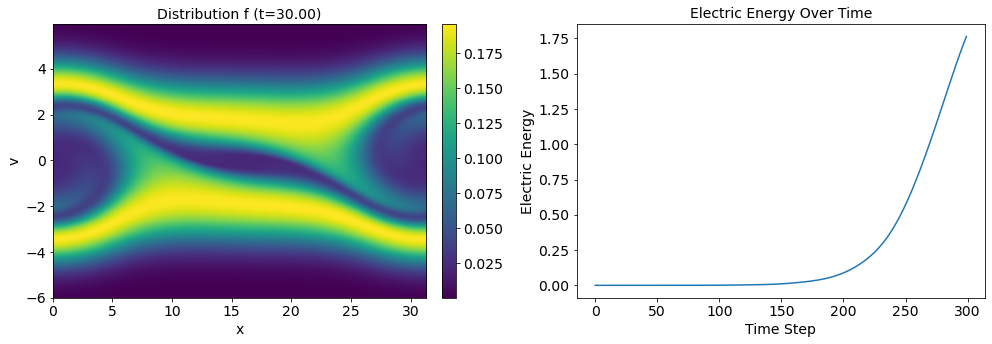

(256, 256)
Iteration 5, Cost: 0.14330321550369263, Coefficients: [-2.7431999e-04  5.4717954e-04  1.4340432e-04  1.0206680e-04
  6.8890979e-05  8.2985956e-05  8.2505976e-05  7.0546921e-05
  5.3699252e-05  4.9324874e-05  4.1394283e-05  3.4300188e-05
  3.1255782e-05  2.8313199e-05  2.2872662e-05 -7.7303685e-04
 -1.0381511e-03 -2.1767271e-04 -1.3295619e-05  6.8196729e-05
  7.0387498e-05  5.4163567e-05  4.5103887e-05  1.9240953e-05
  1.2766899e-05  3.0714500e-07  2.1806052e-06 -3.4924005e-06
 -6.5111449e-06 -3.4594486e-06]


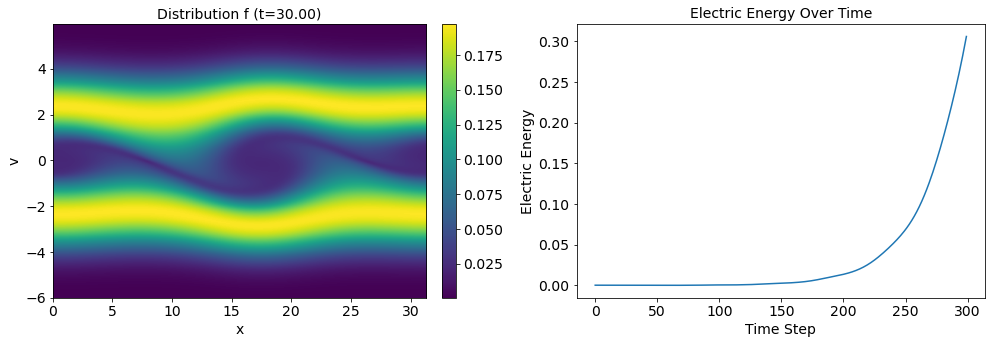

(256, 256)
Iteration 6, Cost: 0.282572478055954, Coefficients: [ 4.0781495e-04  1.1533353e-04 -2.1354572e-05 -9.5227006e-07
  1.3502173e-05  2.1668340e-05  8.4764106e-06  1.7299899e-06
 -5.7347097e-06 -3.8772450e-06 -6.7155670e-06 -7.5811840e-06
 -6.4998931e-06 -4.7680405e-06 -6.8006775e-06 -5.4582290e-04
 -8.1453606e-04 -1.4353980e-04  3.1444877e-05  8.9174850e-05
  8.1743914e-05  5.8034966e-05  4.6408422e-05  2.0915477e-05
  1.5523749e-05  4.2071360e-06  6.4318883e-06  1.3139388e-06
 -1.5099413e-06  1.3495160e-06]


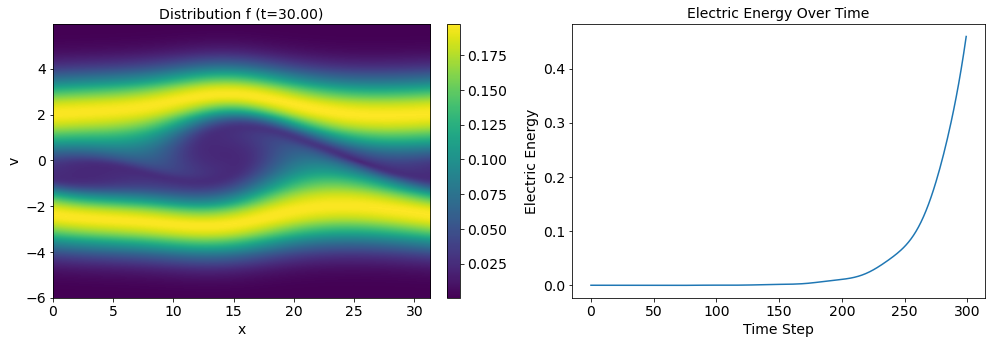

(256, 256)
Iteration 7, Cost: 0.7868927717208862, Coefficients: [ 1.7810325e-04  2.4743902e-04  3.8121587e-05  3.2362695e-05
  3.2290405e-05  3.9485330e-05  3.1420510e-05  2.2446537e-05
  1.1884460e-05  1.1902273e-05  7.9418887e-06  5.6147819e-06
  5.3355789e-06  6.0686862e-06  2.7191290e-06  4.0906208e-04
 -3.3413791e-04  9.2464034e-06  1.2970952e-04  1.5072426e-04
  1.1966733e-04  6.7296824e-05  4.5710276e-05  1.2230927e-05
  8.0808368e-06 -5.5993914e-06 -2.4440396e-07 -6.7992760e-06
 -7.0658266e-06 -5.4982274e-06]


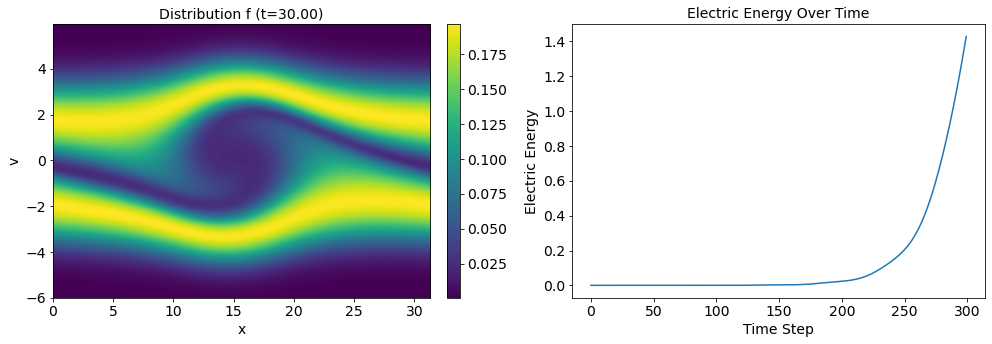

(256, 256)
Iteration 8, Cost: 0.3834996223449707, Coefficients: [ 9.16134304e-05  2.31052909e-04  3.64347725e-05  3.76720054e-05
  3.14305071e-05  4.58176692e-05  3.17162303e-05  2.95825430e-05
  1.26430550e-05  1.77123875e-05  8.25580810e-06  1.10399696e-05
  6.19951788e-06  1.14779450e-05  3.92197308e-06 -2.66572111e-03
 -1.80587638e-03 -7.36055226e-05  1.14534596e-04  1.76751651e-04
  1.33269728e-04  9.00431696e-05  5.42123234e-05  2.48002725e-05
  1.25797551e-05  3.54703843e-06  2.90104754e-06  1.08995937e-06
 -4.50871630e-06  1.48427398e-06]


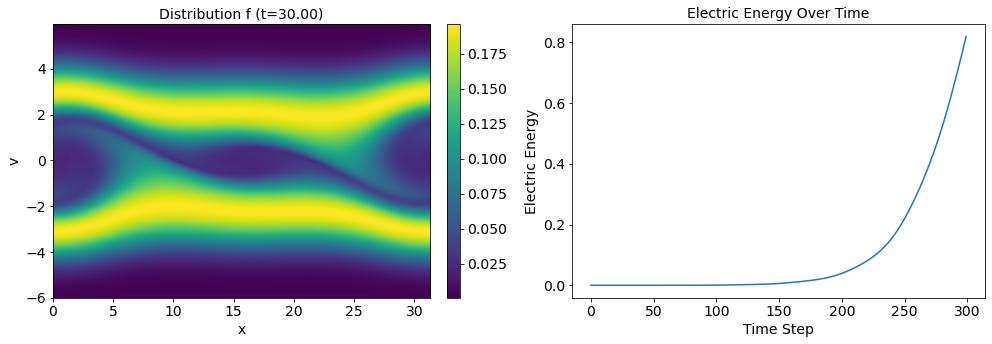

(256, 256)
Iteration 9, Cost: 0.6709551811218262, Coefficients: [-5.5785949e-04  7.4896088e-05  7.8377212e-05  2.3771103e-05
  6.2647359e-06  8.9630666e-06  2.0820189e-05  2.6615598e-05
  2.2466018e-05  2.3021848e-05  2.1564341e-05  1.9760157e-05
  1.9453120e-05  2.0163403e-05  1.6080292e-05  1.6887859e-04
 -4.5682467e-04 -2.1752508e-04  5.7771103e-07  6.7827968e-05
  7.9362522e-05  5.5691838e-05  4.9485203e-05  2.2076538e-05
  1.7914652e-05 -1.2515238e-07  4.2589645e-06 -4.5680690e-06
 -5.0498038e-06 -3.0286024e-06]


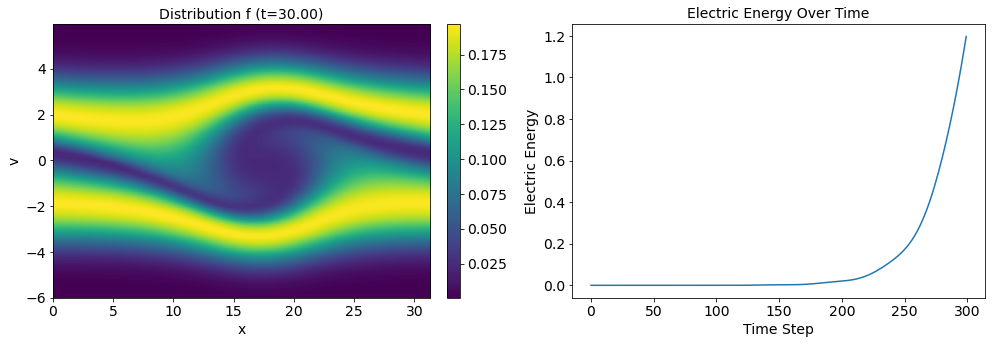

(256, 256)
Iteration 10, Cost: 0.4081658124923706, Coefficients: [ 2.1638075e-04  8.5905922e-05 -1.3253179e-05  1.1885122e-05
  4.9074865e-06  2.2980876e-05  5.2279793e-06  1.0461010e-05
 -2.6404578e-06  4.9898681e-06 -3.3081560e-06  1.1186239e-06
 -3.7014452e-06  3.3423767e-06 -3.8767921e-06 -2.7201835e-03
 -1.8692206e-03 -3.2478225e-04 -3.2348515e-05  7.3889481e-05
  8.7435954e-05  6.9711976e-05  6.2703853e-05  3.2562064e-05
  2.9343479e-05  9.4602565e-06  1.6998196e-05  4.7961648e-06
  7.3903266e-06  6.4960136e-06]


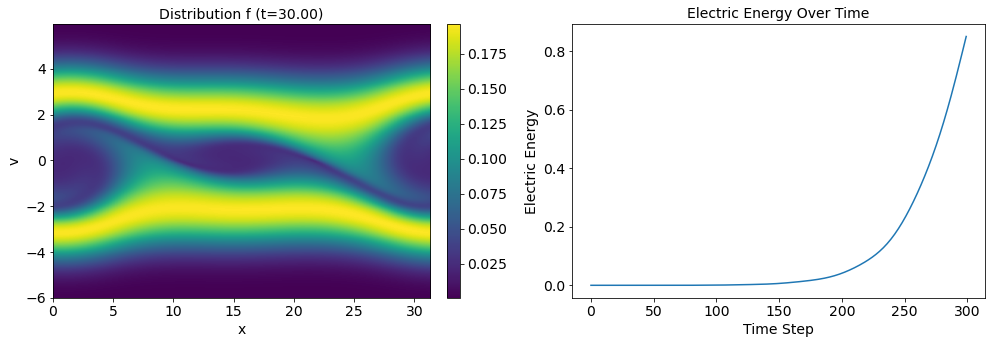

(256, 256)
Iteration 11, Cost: 0.6740010976791382, Coefficients: [-5.11642662e-04  6.47295165e-05  6.57793062e-05  2.27960682e-05
 -5.99198529e-06  6.08873961e-06  9.30922306e-06  2.54484858e-05
  1.60983418e-05  2.37296717e-05  1.63476980e-05  1.90178816e-05
  1.40368065e-05  1.98352973e-05  1.28233387e-05  1.86331337e-04
 -4.41597542e-04 -4.32832807e-04 -1.31649052e-04 -2.85939896e-05
  3.88564622e-05  3.36264602e-05  5.82424727e-05  2.70434903e-05
  3.25090223e-05  4.01536499e-06  1.53030996e-05 -3.68473320e-06
  4.39870655e-06 -1.99918895e-06]


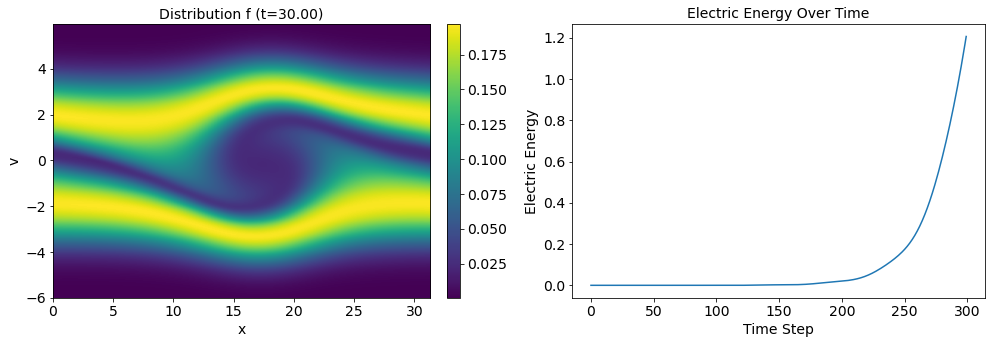

(256, 256)
Iteration 12, Cost: 0.4012404978275299, Coefficients: [ 2.0293938e-04  8.6635679e-05 -2.0057712e-05  1.2847359e-05
 -8.0235914e-06  1.9887801e-05 -4.4586486e-06  1.1722843e-05
 -8.1224443e-06  7.7738168e-06 -6.9684793e-06  2.4438559e-06
 -6.9594807e-06  4.2265438e-06 -4.9792525e-06 -2.7256885e-03
 -1.8581451e-03 -5.5456866e-04 -1.7218810e-04 -2.9396635e-05
  4.4091095e-05  4.3241736e-05  6.8933965e-05  3.5682016e-05
  4.3405904e-05  1.1278707e-05  2.7451602e-05  3.8066410e-06
  1.6295548e-05  5.2862483e-06]


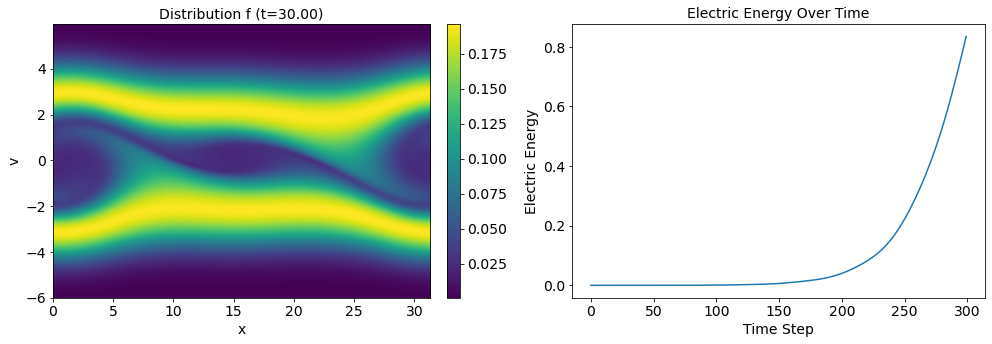

(256, 256)
Iteration 13, Cost: 0.6756554245948792, Coefficients: [-5.1799131e-04  6.1956707e-05  5.9016842e-05  2.3983741e-05
 -1.5787246e-05  1.9717172e-06  2.1191818e-06  2.4025961e-05
  1.1978980e-05  2.3996450e-05  1.3508532e-05  1.7632236e-05
  1.0965747e-05  1.7101767e-05  1.1578402e-05  1.7526303e-04
 -4.4865313e-04 -6.5011397e-04 -2.7209890e-04 -1.2632953e-04
 -4.3977161e-06  1.2299268e-05  6.6426408e-05  3.3631477e-05
  4.8732407e-05  8.9168225e-06  2.8083656e-05 -2.8962186e-06
  1.3801163e-05 -2.2111012e-06]


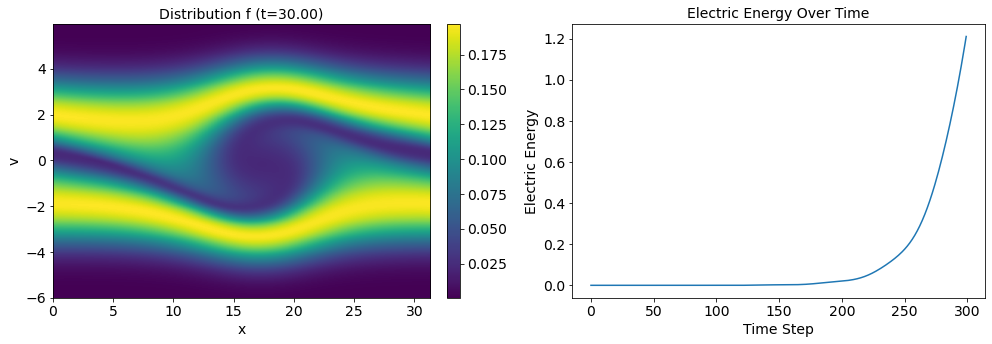

(256, 256)
Iteration 14, Cost: 0.4064652621746063, Coefficients: [ 1.9039254e-04  8.3289720e-05 -3.1380441e-05  9.4243997e-06
 -2.1669039e-05  1.2718944e-05 -1.5312449e-05  8.3556115e-06
 -1.3324368e-05  7.4858326e-06 -9.3463150e-06  6.3664993e-07
 -8.6461332e-06  2.3641451e-06 -5.3584117e-06 -2.7814314e-03
 -1.8834914e-03 -7.8827457e-04 -3.2320505e-04 -1.3750010e-04
 -5.5723713e-06  1.4685797e-05  7.3828502e-05  3.7092537e-05
  5.7735135e-05  1.2365841e-05  3.8866830e-05  2.5263521e-06
  2.4671250e-05  4.3277996e-06]


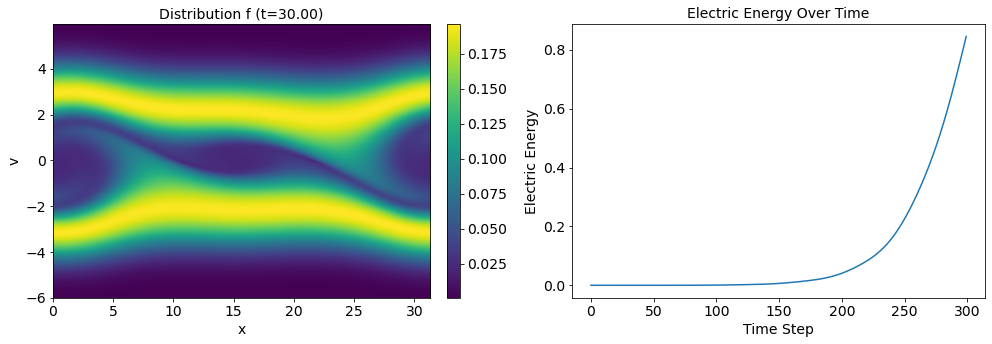

(256, 256)
Iteration 15, Cost: 0.6621338725090027, Coefficients: [-5.2589312e-04  6.9266767e-05  5.1248680e-05  2.3197030e-05
 -2.5515139e-05 -2.2121103e-06 -5.6803419e-06  2.2924884e-05
  9.3442613e-06  2.4333161e-05  1.3900197e-05  1.6778195e-05
  1.0732812e-05  1.5555912e-05  1.2139870e-05  1.4535035e-04
 -4.9641321e-04 -8.8174263e-04 -4.2634271e-04 -2.3267006e-04
 -5.3833017e-05 -1.1786072e-05  7.2884752e-05  3.8568935e-05
  6.3701962e-05  1.3441854e-05  4.0234314e-05 -1.2004080e-06
  2.2554725e-05 -8.6047385e-07]


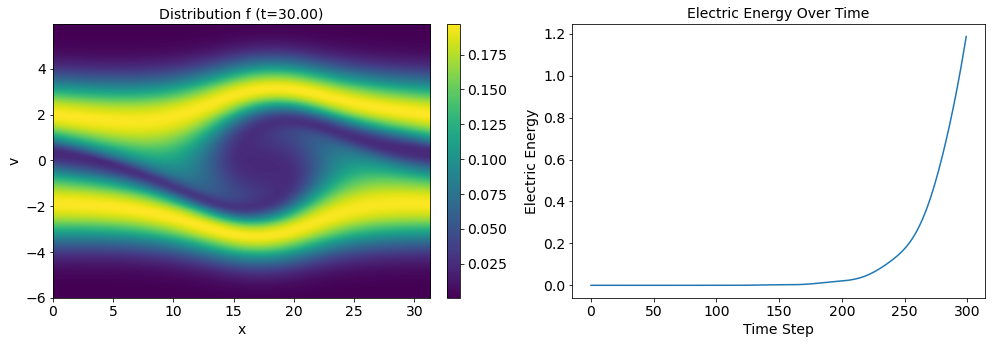

(256, 256)
Iteration 16, Cost: 0.39839574694633484, Coefficients: [ 1.8664112e-04  8.7823290e-05 -4.1317879e-05  6.7057990e-06
 -3.3246786e-05  8.4044414e-06 -2.3687637e-05  6.8670615e-06
 -1.5705944e-05  6.3545667e-06 -9.0341600e-06 -2.1736832e-06
 -1.0158632e-05 -2.1343385e-06 -6.4712622e-06 -2.7941000e-03
 -1.9205784e-03 -1.0296414e-03 -4.8300988e-04 -2.4883490e-04
 -5.5153130e-05 -1.0663254e-05  8.1300474e-05  4.1415493e-05
  7.4153533e-05  1.7513961e-05  5.1267558e-05  3.9174829e-06
  3.3345063e-05  4.9372984e-06]


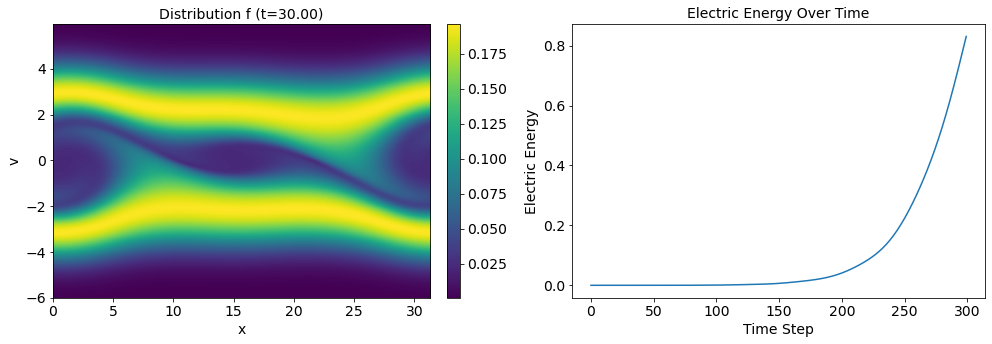

(256, 256)
Iteration 17, Cost: 0.6673226356506348, Coefficients: [-5.22464921e-04  5.98444203e-05  3.77828692e-05  1.89991333e-05
 -3.66122622e-05 -8.30650879e-06 -1.43604793e-05  1.94969853e-05
  6.88687032e-06  2.22046565e-05  1.45616505e-05  1.30928456e-05
  9.85398947e-06  1.09768644e-05  1.08093718e-05  1.44595280e-04
 -5.20715024e-04 -1.10938586e-03 -5.81955537e-04 -3.42610292e-04
 -1.04815481e-04 -3.52939751e-05  7.96189561e-05  4.43573408e-05
  7.92881328e-05  1.99046499e-05  5.18398228e-05  2.14210900e-06
  3.03580964e-05  2.99726707e-07]


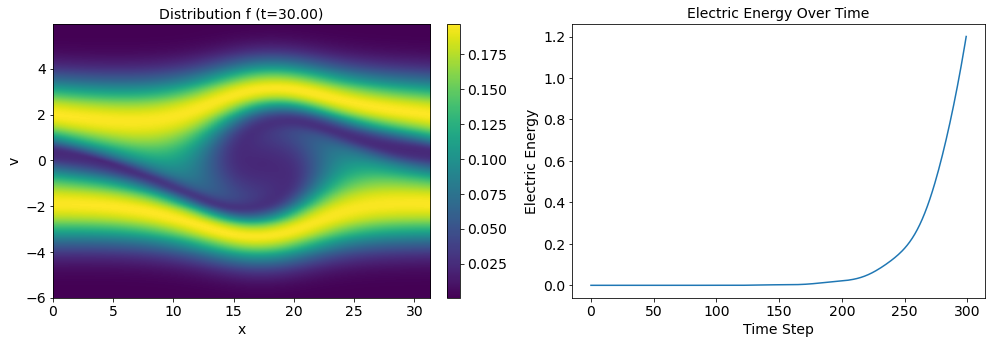

(256, 256)
Iteration 18, Cost: 0.40974169969558716, Coefficients: [ 1.7405651e-04  8.3060004e-05 -5.2179603e-05  4.0007171e-06
 -4.5022865e-05  1.4218922e-06 -3.3334858e-05  2.2418644e-06
 -1.8810579e-05  2.6035232e-06 -9.9685585e-06 -7.0458173e-06
 -1.1666876e-05 -6.8727841e-06 -6.9645866e-06 -2.8794403e-03
 -1.9716746e-03 -1.2744057e-03 -6.4721319e-04 -3.6609080e-04
 -1.0822434e-04 -3.6202320e-05  8.8182423e-05  4.6931211e-05
  9.0817426e-05  2.4242134e-05  6.4443710e-05  7.3193842e-06
  4.1758056e-05  5.9363965e-06]


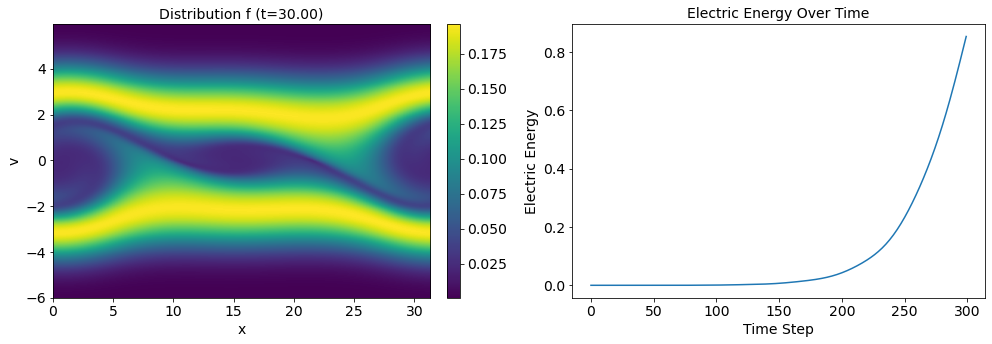

(256, 256)
Iteration 19, Cost: 0.6493139266967773, Coefficients: [-5.3320220e-04  6.8962443e-05  3.0946976e-05  1.9639228e-05
 -4.5099132e-05 -1.3710481e-05 -1.9526629e-05  1.6725189e-05
  5.3517215e-06  2.0087275e-05  1.5858017e-05  9.2011305e-06
  9.9165081e-06  6.4861970e-06  1.2312979e-05  1.0418543e-04
 -5.9507973e-04 -1.3547604e-03 -7.5098692e-04 -4.5937329e-04
 -1.5769260e-04 -5.7257617e-05  8.7173168e-05  5.3049269e-05
  9.5996722e-05  2.8219716e-05  6.3735970e-05  7.2836092e-06
  3.8054881e-05  2.5483166e-06]


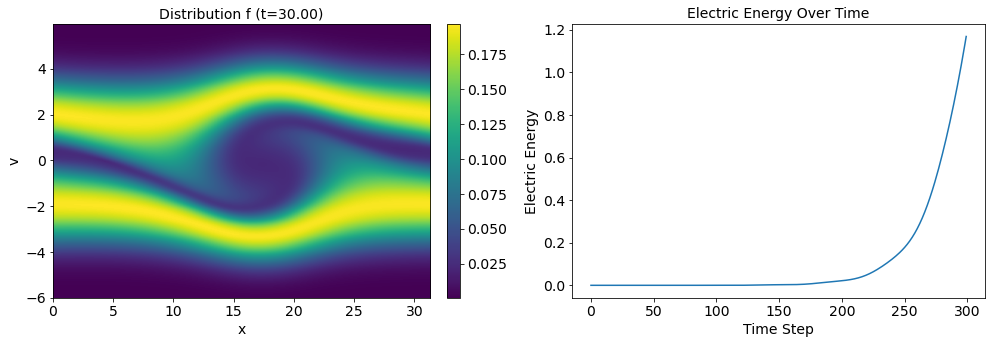

(256, 256)
Iteration 20, Cost: 0.4002675712108612, Coefficients: [ 1.7486297e-04  8.7023633e-05 -6.1228464e-05  2.4878464e-06
 -5.5508466e-05 -5.5236824e-06 -3.9657145e-05 -2.4114743e-06
 -2.0923040e-05 -1.0457006e-06 -8.8371235e-06 -1.2447077e-05
 -1.1901531e-05 -1.2959213e-05 -5.3934873e-06 -2.8935815e-03
 -2.0288136e-03 -1.5277116e-03 -8.1988162e-04 -4.8573187e-04
 -1.6002735e-04 -5.8564397e-05  9.6493779e-05  5.4967015e-05
  1.0752465e-04  3.1565967e-05  7.5044896e-05  1.1187558e-05
  4.7922105e-05  7.4212176e-06]


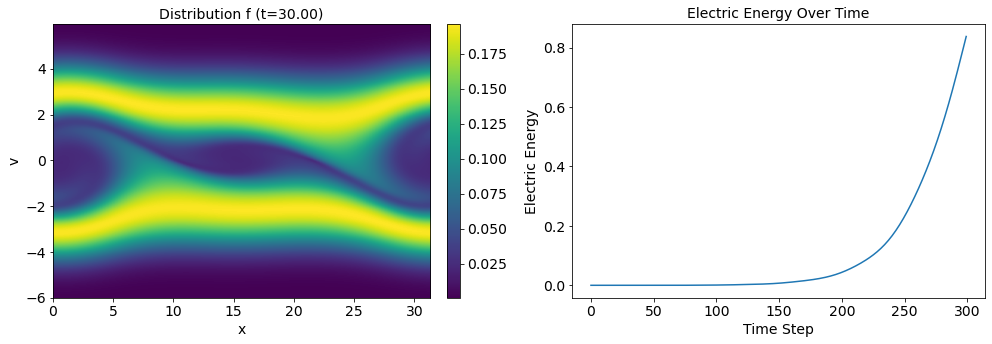

(256, 256)
Iteration 21, Cost: 0.6586544513702393, Coefficients: [-5.2735244e-04  5.4679236e-05  1.8602739e-05  1.4397086e-05
 -5.6027686e-05 -2.2371165e-05 -2.8260842e-05  9.6398171e-06
  2.2581153e-06  1.4438490e-05  1.6354597e-05  3.1125273e-06
  8.9793703e-06 -3.0477167e-08  1.3112187e-05  1.0987534e-04
 -6.2479172e-04 -1.5904478e-03 -9.1649318e-04 -5.7766057e-04
 -2.1170068e-04 -7.8242265e-05  9.3114133e-05  6.2795290e-05
  1.1119197e-04  3.6530546e-05  7.3444848e-05  1.1743109e-05
  4.2886051e-05  5.1816774e-06]


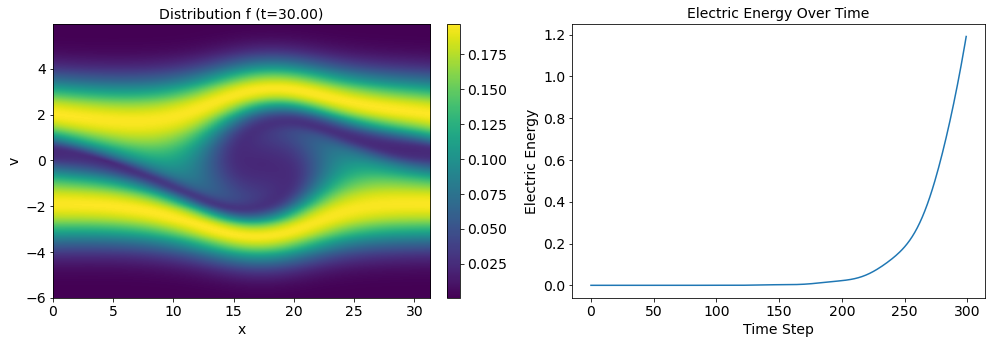

(256, 256)
Iteration 22, Cost: 0.4169130325317383, Coefficients: [ 1.5399465e-04  7.7333752e-05 -7.0389950e-05 -1.4475054e-06
 -6.7638393e-05 -1.4077269e-05 -4.7538328e-05 -8.4721114e-06
 -2.2940583e-05 -6.0014791e-06 -6.5780787e-06 -1.7635954e-05
 -1.1400400e-05 -1.9461266e-05 -3.7182508e-06 -3.0086571e-03
 -2.0956080e-03 -1.7802838e-03 -9.9297322e-04 -6.0966221e-04
 -2.1408952e-04 -8.0640915e-05  1.0309751e-04  6.3915366e-05
  1.2283013e-04  3.9115825e-05  8.3776482e-05  1.4422311e-05
  5.1509222e-05  9.3134349e-06]


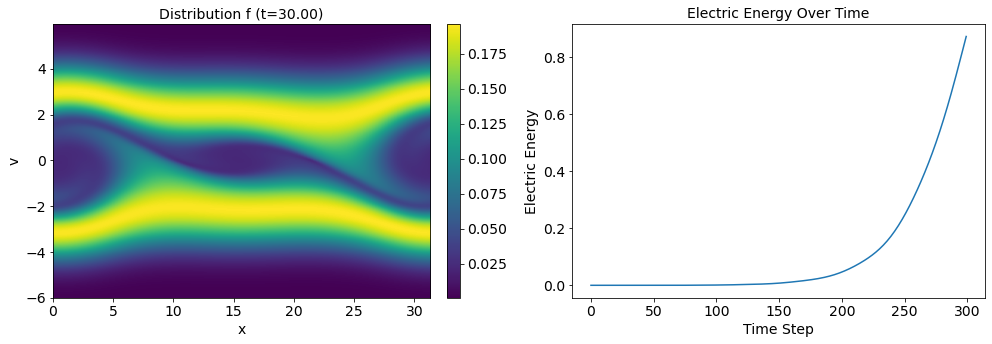

(256, 256)
Iteration 23, Cost: 0.6361386775970459, Coefficients: [-5.4284022e-04  6.7205845e-05  1.4033882e-05  1.6001013e-05
 -6.3683539e-05 -2.7145863e-05 -3.2660886e-05  7.1098411e-06
  3.6177171e-06  1.1552593e-05  1.9352286e-05  3.2196840e-07
  1.1140190e-05 -5.1238967e-06  1.4747189e-05  5.6509394e-05
 -7.2618912e-04 -1.8458529e-03 -1.0953434e-03 -7.0196332e-04
 -2.6653672e-04 -9.5115050e-05  1.0251639e-04  7.4393582e-05
  1.2588414e-04  4.6621459e-05  8.0403923e-05  1.6920729e-05
  4.4743389e-05  8.3489158e-06]


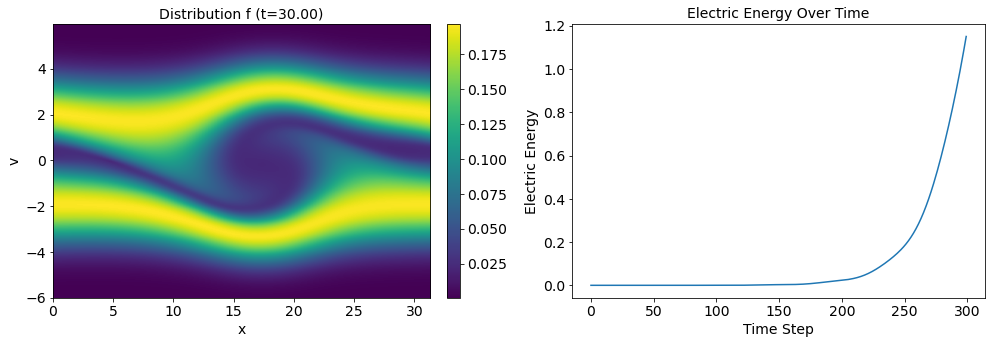

(256, 256)
Iteration 24, Cost: 0.40409937500953674, Coefficients: [ 1.5182921e-04  8.2682156e-05 -7.7868601e-05 -3.6825531e-06
 -7.8243502e-05 -2.1064847e-05 -5.2197989e-05 -1.2868032e-05
 -2.2804841e-05 -1.0861793e-05 -4.0403411e-06 -2.1268877e-05
 -9.9138288e-06 -2.5086349e-05 -2.8657178e-06 -3.0243141e-03
 -2.1746228e-03 -2.0425019e-03 -1.1756229e-03 -7.3462544e-04
 -2.6633093e-04 -9.6512114e-05  1.1211272e-04  7.5057666e-05
  1.3743037e-04  4.9147257e-05  8.9657624e-05  1.8749624e-05
  5.2722557e-05  1.2857283e-05]


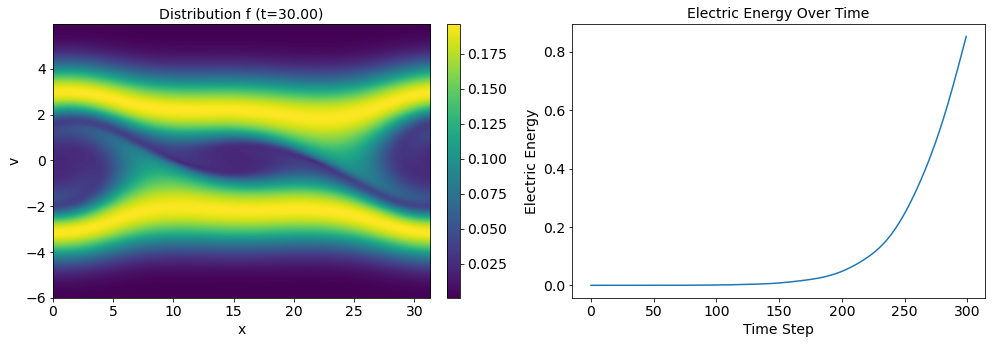

(256, 256)
Iteration 25, Cost: 0.6515383720397949, Coefficients: [-5.33554761e-04  4.30402069e-05 -2.20577931e-07  1.19177148e-05
 -7.44687422e-05 -3.92368129e-05 -4.11883375e-05  9.06380592e-07
  2.73729711e-06  4.48466017e-06  1.86565339e-05 -3.52372081e-06
  1.22085239e-05 -1.13399774e-05  1.31848756e-05  7.34433997e-05
 -7.61227333e-04 -2.07984960e-03 -1.26638950e-03 -8.28323653e-04
 -3.22972628e-04 -1.07608816e-04  1.12112466e-04  8.47668343e-05
  1.37218405e-04  5.87469476e-05  8.71389930e-05  2.04457992e-05
  4.35302318e-05  1.27605890e-05]


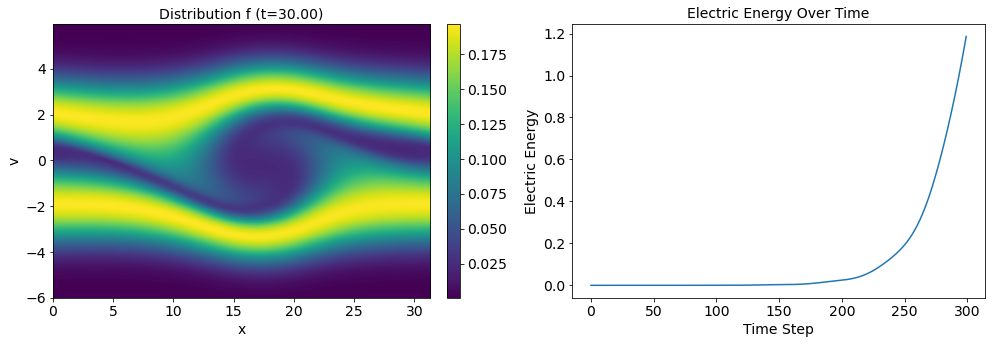

(256, 256)
Iteration 26, Cost: 0.42568880319595337, Coefficients: [ 1.2585655e-04  6.4530912e-05 -8.8302346e-05 -6.2972758e-06
 -8.9755733e-05 -3.3774693e-05 -5.9555165e-05 -1.7768572e-05
 -2.2008033e-05 -1.6444554e-05 -3.7455902e-06 -2.4211060e-05
 -8.0974478e-06 -3.0391293e-05 -3.3398665e-06 -3.1675424e-03
 -2.2591308e-03 -2.2969376e-03 -1.3568312e-03 -8.6675410e-04
 -3.2182565e-04 -1.0986949e-04  1.2105680e-04  8.4208521e-05
  1.4911694e-04  6.0664745e-05  9.6394215e-05  2.1795266e-05
  5.1860690e-05  1.7249286e-05]


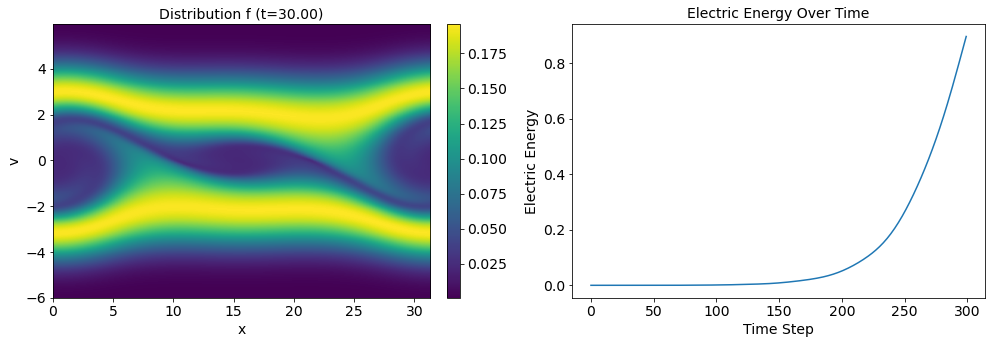

(256, 256)
Iteration 27, Cost: 0.6255818605422974, Coefficients: [-5.51944366e-04  5.48114840e-05 -4.70882514e-06  1.33889316e-05
 -8.12452927e-05 -4.65135163e-05 -4.32655106e-05 -1.55002635e-06
  4.59960211e-06  2.53406142e-06  2.16239623e-05 -5.61751403e-06
  1.34760776e-05 -1.48132785e-05  1.42323970e-05  4.53996472e-06
 -8.89218529e-04 -2.33619520e-03 -1.45210349e-03 -9.61822458e-04
 -3.79279722e-04 -1.13917333e-04  1.23936858e-04  9.79212928e-05
  1.48266787e-04  7.18506490e-05  9.18692967e-05  2.55166542e-05
  4.28085550e-05  1.75412206e-05]


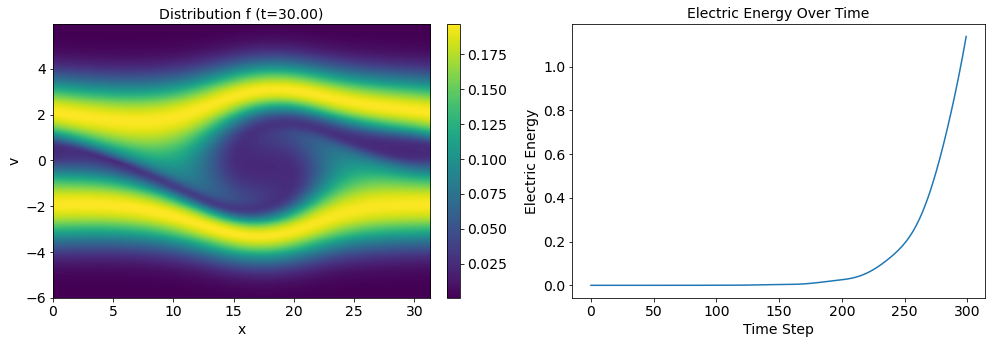

(256, 256)
Iteration 28, Cost: 0.40731948614120483, Coefficients: [ 1.2486166e-04  6.7559347e-05 -9.6873082e-05 -8.2165152e-06
 -9.8293276e-05 -4.3269360e-05 -6.3571686e-05 -2.2614109e-05
 -2.0978432e-05 -1.9356172e-05 -1.5111927e-06 -2.8058124e-05
 -7.8581706e-06 -3.4939523e-05 -2.2343993e-06 -3.1713983e-03
 -2.3545013e-03 -2.5554106e-03 -1.5423094e-03 -1.0006076e-03
 -3.7745279e-04 -1.1602168e-04  1.3423710e-04  9.8663462e-05
  1.5864847e-04  7.1669128e-05  1.0017172e-04  2.8571476e-05
  5.1663759e-05  2.2392058e-05]


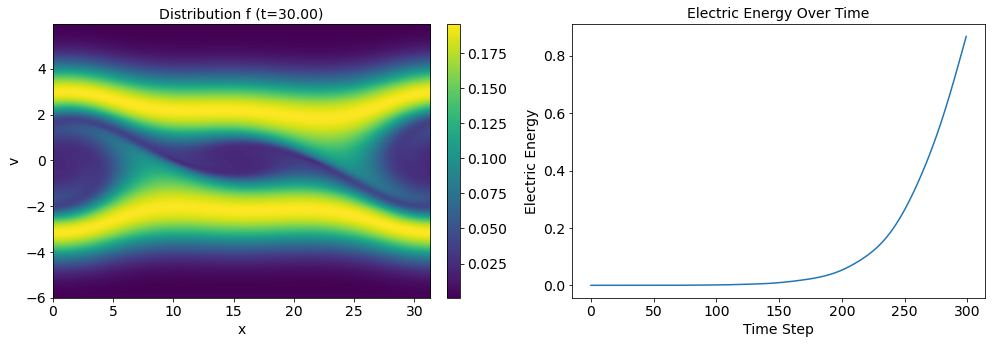

(256, 256)
Iteration 29, Cost: 0.6458066701889038, Coefficients: [-5.4336467e-04  2.2847093e-05 -2.1190768e-05  4.7670601e-06
 -9.3266564e-05 -6.0111168e-05 -5.1368748e-05 -1.0969582e-05
  1.5773894e-06 -3.1994059e-06  2.2052151e-05 -1.1320319e-05
  1.1098806e-05 -1.9513784e-05  1.3563238e-05  2.7561095e-05
 -9.2419388e-04 -2.5687972e-03 -1.6272258e-03 -1.0931260e-03
 -4.3761727e-04 -1.2296156e-04  1.3312949e-04  1.1386430e-04
  1.5963410e-04  8.1602557e-05  9.2904767e-05  3.2810294e-05
  4.4980283e-05  2.2451004e-05]


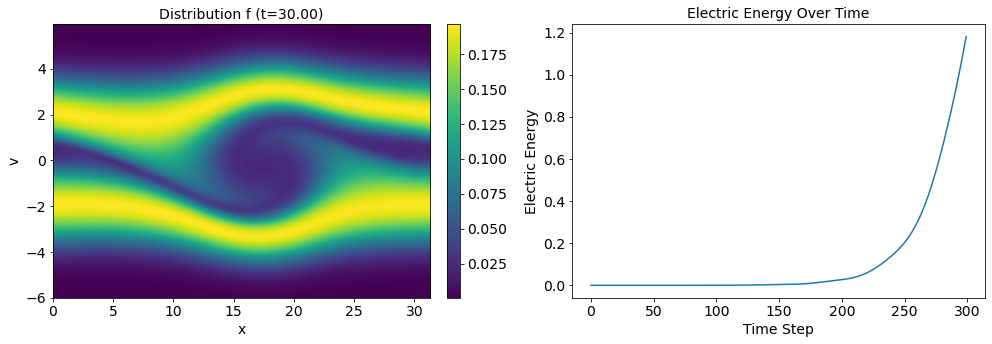

(256, 256)
Iteration 30, Cost: 0.42820900678634644, Coefficients: [ 9.96316085e-05  4.34211179e-05 -1.09155699e-04 -1.41073106e-05
 -1.09836714e-04 -5.58688625e-05 -7.03203696e-05 -3.03159250e-05
 -2.25316526e-05 -2.32485527e-05  4.96424036e-07 -3.28956739e-05
 -8.99553015e-06 -3.90398818e-05 -1.83511474e-06 -3.31593025e-03
 -2.44205049e-03 -2.80528003e-03 -1.72407553e-03 -1.13791088e-03
 -4.38241725e-04 -1.26742729e-04  1.44378020e-04  1.15116141e-04
  1.69021427e-04  7.91328348e-05  1.00586949e-04  3.67466673e-05
  5.42456619e-05  2.73568858e-05]


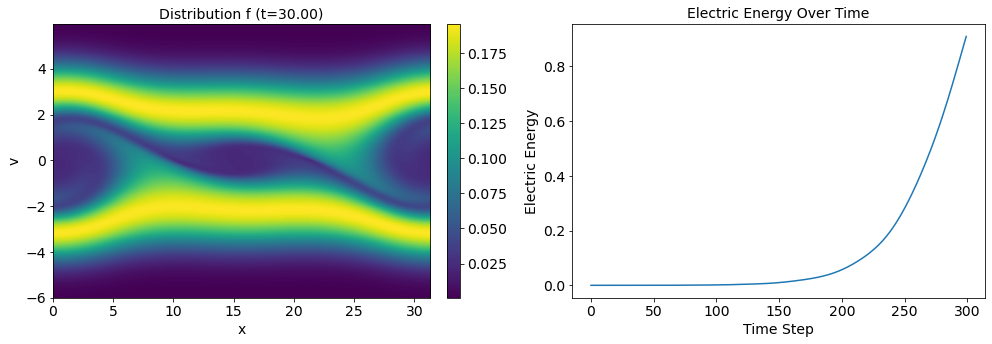

(256, 256)
Iteration 31, Cost: 0.6207106113433838, Coefficients: [-5.6081533e-04  3.0670544e-05 -2.7168200e-05  3.8288399e-06
 -9.9706842e-05 -6.8496076e-05 -5.2948319e-05 -1.4933898e-05
  2.4345027e-06 -3.9389906e-06  2.4834519e-05 -1.3239278e-05
  9.7590000e-06 -2.1382295e-05  1.4158155e-05 -5.1818788e-05
 -1.0586578e-03 -2.8259621e-03 -1.8175233e-03 -1.2272187e-03
 -4.9733208e-04 -1.2980991e-04  1.4362896e-04  1.3498694e-04
  1.7204574e-04  8.9379828e-05  9.1508948e-05  4.1417559e-05
  4.8510821e-05  2.7750639e-05]


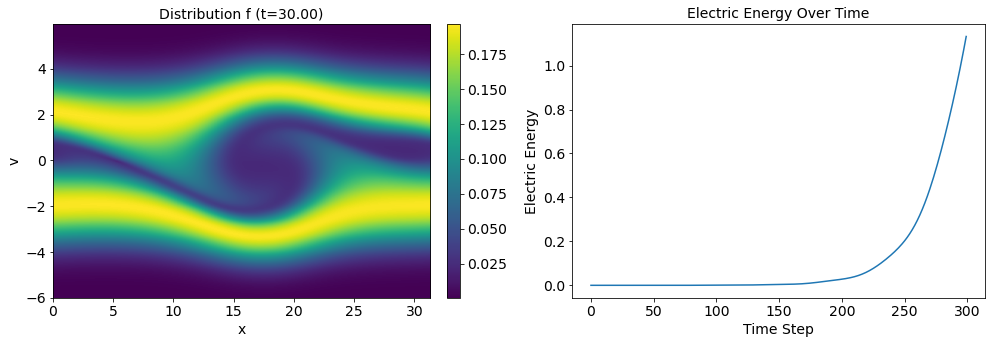

(256, 256)
Iteration 32, Cost: 0.40724971890449524, Coefficients: [ 1.02056947e-04  4.58879877e-05 -1.18431104e-04 -1.82011881e-05
 -1.17535033e-04 -6.53464449e-05 -7.30991742e-05 -3.61271195e-05
 -2.23627503e-05 -2.49774803e-05  2.68918120e-06 -3.65913220e-05
 -1.07992037e-05 -4.15463437e-05 -1.86089346e-06 -3.30911414e-03
 -2.53673340e-03 -3.06171528e-03 -1.91226660e-03 -1.27159420e-03
 -4.98081848e-04 -1.33702764e-04  1.55955553e-04  1.37114708e-04
  1.80004776e-04  8.59951106e-05  9.87299209e-05  4.62497555e-05
  5.71978999e-05  3.35174554e-05]


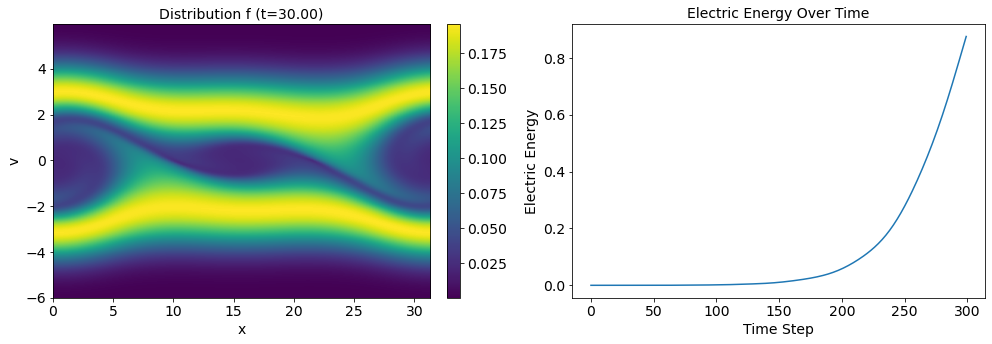

(256, 256)
Iteration 33, Cost: 0.641664445400238, Coefficients: [-5.4949697e-04 -3.5548401e-06 -4.4915774e-05 -8.1086609e-06
 -1.1082250e-04 -8.2692335e-05 -6.0750368e-05 -2.5295803e-05
 -2.0839652e-06 -7.7384884e-06  2.3690105e-05 -1.8112565e-05
  5.6758981e-06 -2.5262103e-05  1.2503198e-05 -2.5591115e-05
 -1.0869888e-03 -3.0573758e-03 -1.9957107e-03 -1.3575318e-03
 -5.5969384e-04 -1.4097411e-04  1.5118884e-04  1.5660490e-04
  1.8461462e-04  9.5875832e-05  8.8731664e-05  5.0173981e-05
  5.1715284e-05  3.4028111e-05]


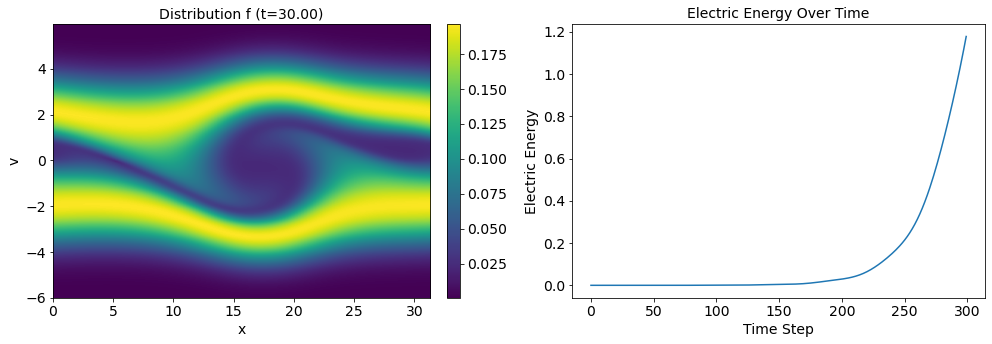

(256, 256)
Iteration 34, Cost: 0.4285256862640381, Coefficients: [ 8.6190179e-05  1.7624232e-05 -1.3184370e-04 -2.7928349e-05
 -1.2825942e-04 -7.8216297e-05 -8.0266851e-05 -4.4246481e-05
 -2.6020138e-05 -2.6548581e-05  2.5880727e-06 -4.0471496e-05
 -1.3961313e-05 -4.4984994e-05 -2.9091789e-06 -3.4494246e-03
 -2.6123142e-03 -3.3092424e-03 -2.0949061e-03 -1.4081070e-03
 -5.6209718e-04 -1.4673712e-04  1.6446938e-04  1.5914004e-04
  1.9155648e-04  9.1257461e-05  9.4909745e-05  5.5516877e-05
  5.9939135e-05  4.0687784e-05]


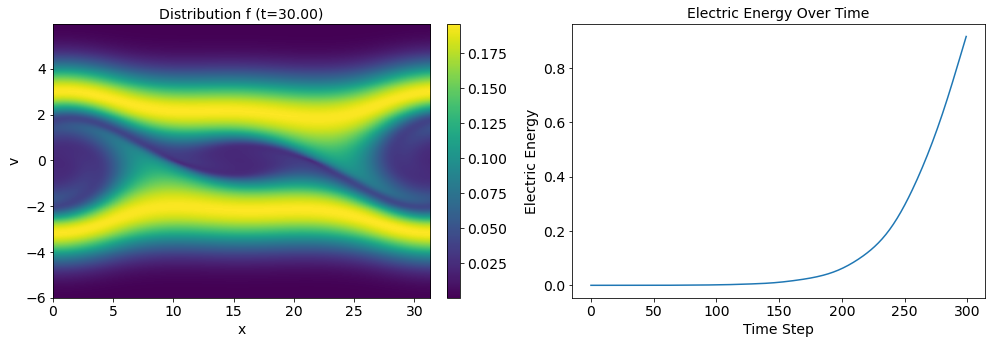

(256, 256)
Iteration 35, Cost: 0.6149376034736633, Coefficients: [-5.6002790e-04  5.2719233e-06 -5.1384253e-05 -1.0551037e-05
 -1.1681738e-04 -8.8731867e-05 -6.3198742e-05 -2.7804153e-05
 -3.4197637e-06 -5.3555177e-06  2.4841864e-05 -1.8821931e-05
  3.4032128e-06 -2.6550813e-05  1.2160359e-05 -1.1313427e-04
 -1.2126971e-03 -3.3124005e-03 -2.1865424e-03 -1.4908806e-03
 -6.2124361e-04 -1.5084662e-04  1.6055212e-04  1.8182621e-04
  1.9709655e-04  1.0291836e-04  8.3479310e-05  5.9791877e-05
  5.3979558e-05  4.0593575e-05]


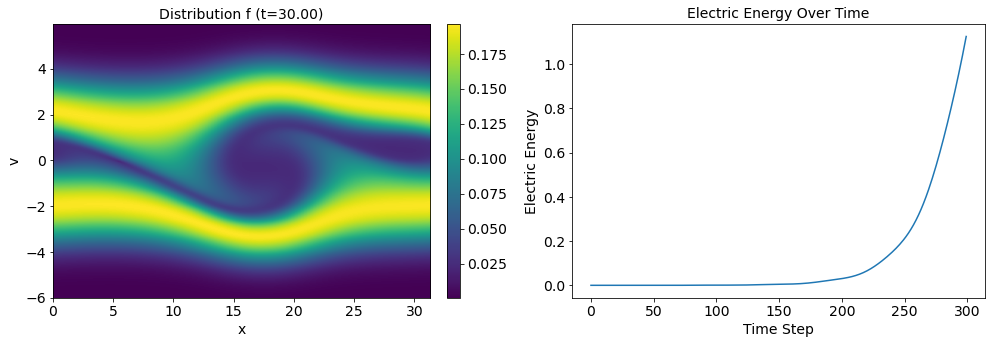

(256, 256)
Iteration 36, Cost: 0.40645188093185425, Coefficients: [ 9.7234210e-05  2.3064331e-05 -1.4058739e-04 -3.2411357e-05
 -1.3478950e-04 -8.4194995e-05 -8.3946332e-05 -4.7644295e-05
 -2.8155951e-05 -2.4698697e-05  2.8593095e-06 -4.1788175e-05
 -1.6426366e-05 -4.6437777e-05 -4.2431202e-06 -3.4258035e-03
 -2.6875972e-03 -3.5605426e-03 -2.2812518e-03 -1.5407394e-03
 -6.2284368e-04 -1.5657913e-04  1.7445962e-04  1.8481890e-04
  2.0218668e-04  9.8353477e-05  8.8841414e-05  6.5472035e-05
  6.1081126e-05  4.8384085e-05]


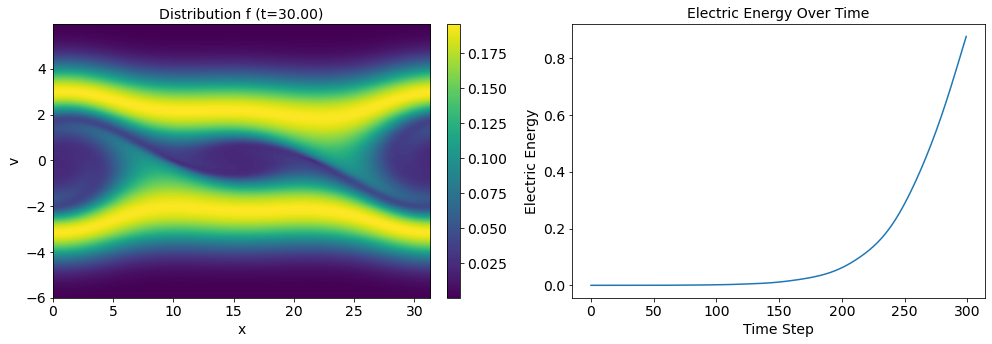

(256, 256)
Iteration 37, Cost: 0.635686457157135, Coefficients: [-5.43963979e-04 -2.46591298e-05 -6.68220164e-05 -2.26047960e-05
 -1.26134444e-04 -1.00036712e-04 -7.11255125e-05 -3.59301812e-05
 -9.03922410e-06 -6.50054608e-06  2.32385210e-05 -2.22339168e-05
  1.05772415e-07 -3.03548004e-05  9.97059124e-06 -8.01980495e-05
 -1.22109626e-03 -3.53800133e-03 -2.36205896e-03 -1.62016018e-03
 -6.84412662e-04 -1.65093137e-04  1.66279424e-04  2.06118944e-04
  2.08615980e-04  1.09959619e-04  7.82397037e-05  6.77347416e-05
  5.54616054e-05  4.70972409e-05]


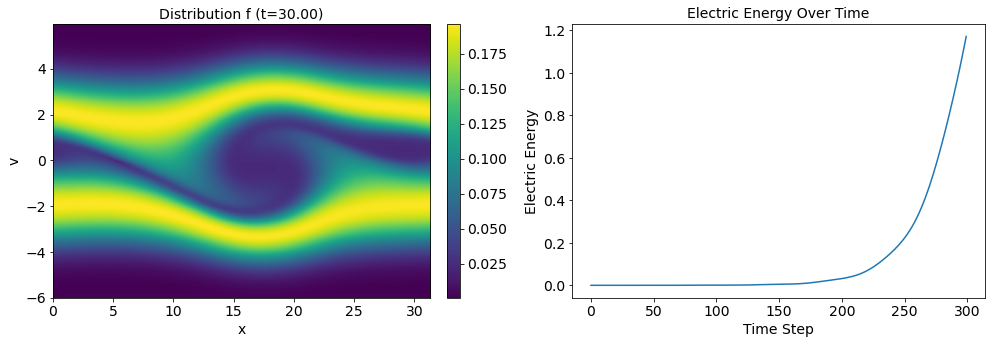

(256, 256)
Iteration 38, Cost: 0.42632755637168884, Coefficients: [ 8.1243808e-05  6.5754830e-07 -1.5153893e-04 -4.1443505e-05
 -1.4323070e-04 -9.4711890e-05 -8.9933063e-05 -5.4592430e-05
 -3.1439711e-05 -2.5103735e-05  3.5212288e-06 -4.4358898e-05
 -1.8595552e-05 -4.8854483e-05 -6.5176491e-06 -3.5533716e-03
 -2.7415650e-03 -3.8005798e-03 -2.4607941e-03 -1.6751838e-03
 -6.8861782e-04 -1.7218814e-04  1.8047383e-04  2.0926278e-04
  2.1333800e-04  1.0409577e-04  8.3440187e-05  7.2508781e-05
  6.2702355e-05  5.5177079e-05]


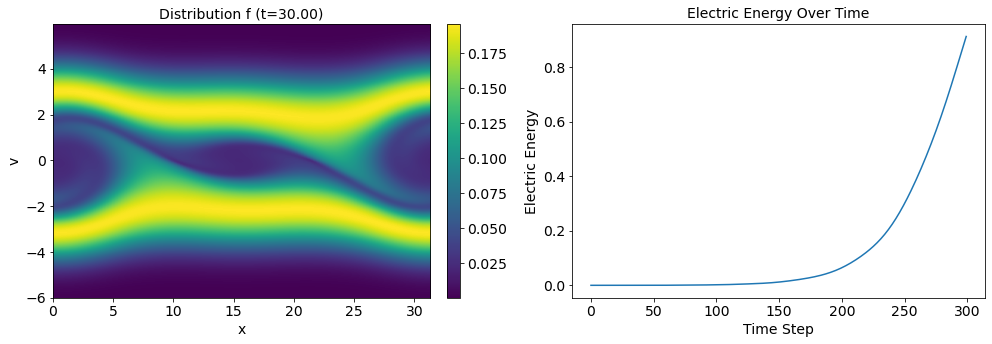

(256, 256)
Iteration 39, Cost: 0.6110825538635254, Coefficients: [-5.56004059e-04 -1.16960091e-05 -7.12099354e-05 -2.45680985e-05
 -1.30346059e-04 -1.04137136e-04 -7.31654582e-05 -3.70321432e-05
 -1.00954112e-05 -3.52916140e-06  2.56719322e-05 -2.28834742e-05
 -5.57427484e-07 -3.15932157e-05  9.13859458e-06 -1.70566142e-04
 -1.33215287e-03 -3.78727471e-03 -2.55127833e-03 -1.75105326e-03
 -7.48554652e-04 -1.76237430e-04  1.73205044e-04  2.33077881e-04
  2.20264352e-04  1.16738360e-04  7.33993656e-05  7.41321783e-05
  5.76408675e-05  5.27719239e-05]


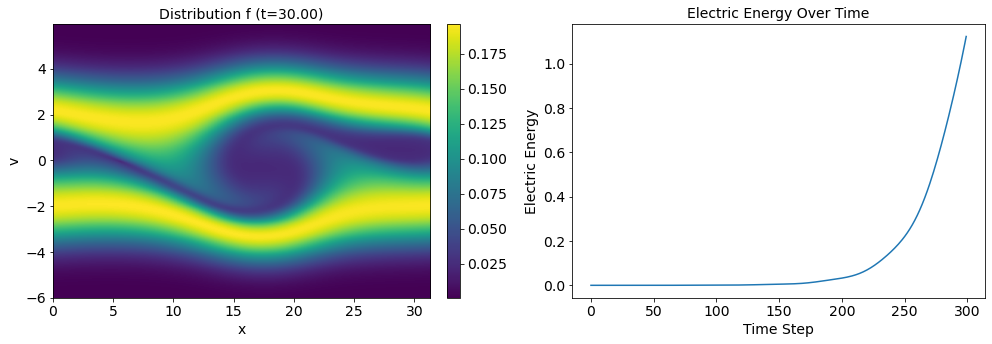

(256, 256)
Iteration 40, Cost: 0.4055248498916626, Coefficients: [ 9.0700516e-05  1.1946875e-05 -1.5877909e-04 -4.5727582e-05
 -1.4862181e-04 -9.9368131e-05 -9.2868322e-05 -5.6901212e-05
 -3.2418611e-05 -2.3111979e-05  5.1824354e-06 -4.6024521e-05
 -2.0492498e-05 -5.0473678e-05 -8.9497289e-06 -3.5289002e-03
 -2.8043180e-03 -4.0445402e-03 -2.6463955e-03 -1.8039298e-03
 -7.5273163e-04 -1.8201630e-04  1.8752825e-04  2.3662076e-04
  2.2409426e-04  1.1094595e-04  7.8402794e-05  7.8810728e-05
  6.4460299e-05  6.1991865e-05]


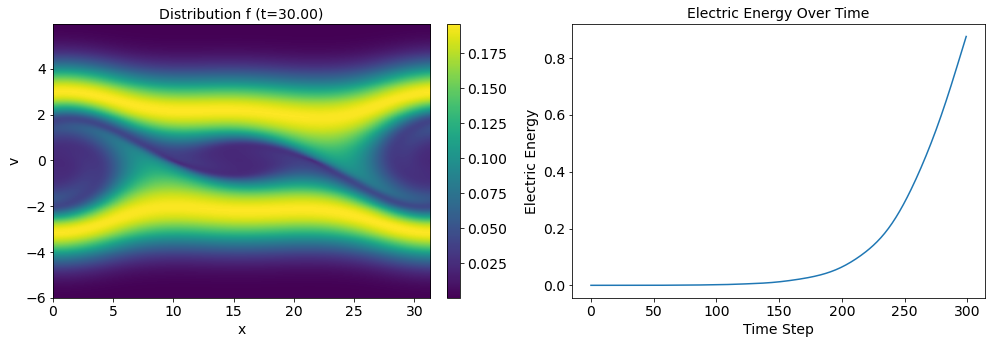

(256, 256)
Iteration 41, Cost: 0.6287321448326111, Coefficients: [-5.4162252e-04 -3.4269782e-05 -8.5084386e-05 -3.6300233e-05
 -1.3859537e-04 -1.1368116e-04 -7.9721191e-05 -4.3950160e-05
 -1.3807881e-05 -5.3594704e-06  2.5574764e-05 -2.6822767e-05
 -2.9723233e-06 -3.4864483e-05  5.5822584e-06 -1.4235568e-04
 -1.3364900e-03 -4.0079053e-03 -2.7274895e-03 -1.8770911e-03
 -8.1461010e-04 -1.8995644e-04  1.7691936e-04  2.5849041e-04
  2.3200428e-04  1.2298445e-04  7.0112736e-05  7.8516830e-05
  6.0084065e-05  5.7612862e-05]


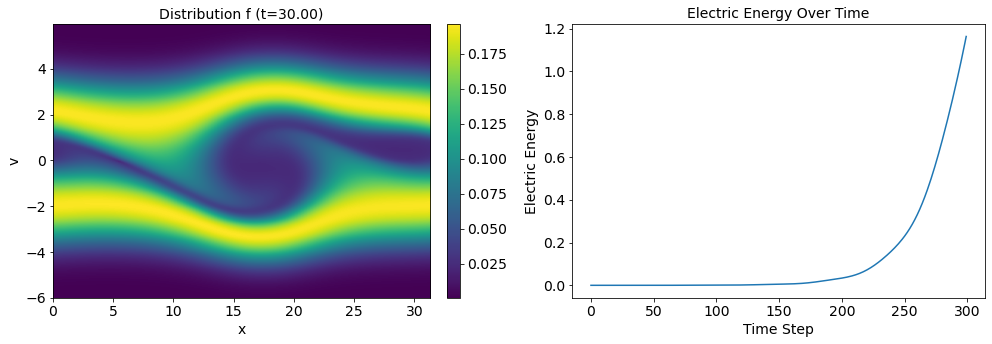

(256, 256)
Iteration 42, Cost: 0.4228416085243225, Coefficients: [ 7.5551739e-05 -3.9740844e-06 -1.6860399e-04 -5.4971038e-05
 -1.5584764e-04 -1.0832670e-04 -9.7701602e-05 -6.2927895e-05
 -3.4052660e-05 -2.4075565e-05  6.5134263e-06 -4.8709499e-05
 -2.2036109e-05 -5.2422212e-05 -1.2445409e-05 -3.6435393e-03
 -2.8493423e-03 -4.2779585e-03 -2.8263924e-03 -1.9339835e-03
 -8.2141726e-04 -1.9685499e-04  1.9163713e-04  2.6183325e-04
  2.3567352e-04  1.1605921e-04  7.4784628e-05  8.2732775e-05
  6.6418688e-05  6.7750574e-05]


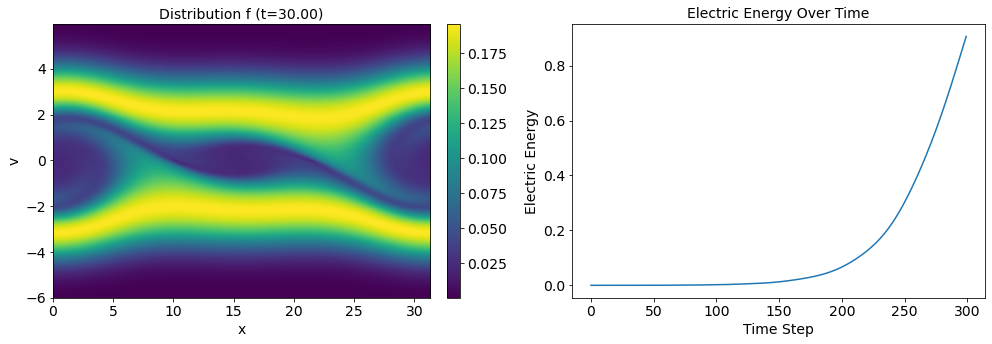

(256, 256)
Iteration 43, Cost: 0.6082496643066406, Coefficients: [-5.56030485e-04 -1.75596506e-05 -9.03625623e-05 -3.81596183e-05
 -1.42615318e-04 -1.17783864e-04 -7.98091496e-05 -4.70395607e-05
 -1.10611581e-05 -5.64226502e-06  3.09132156e-05 -3.02359967e-05
 -1.33660251e-06 -3.75342715e-05  4.80042036e-06 -2.28781486e-04
 -1.43729639e-03 -4.24776180e-03 -2.91867089e-03 -2.00195936e-03
 -8.83977977e-04 -1.98703128e-04  1.80461677e-04  2.86859722e-04
  2.43756469e-04  1.28495594e-04  6.84819533e-05  8.01528076e-05
  6.40462094e-05  6.10224379e-05]


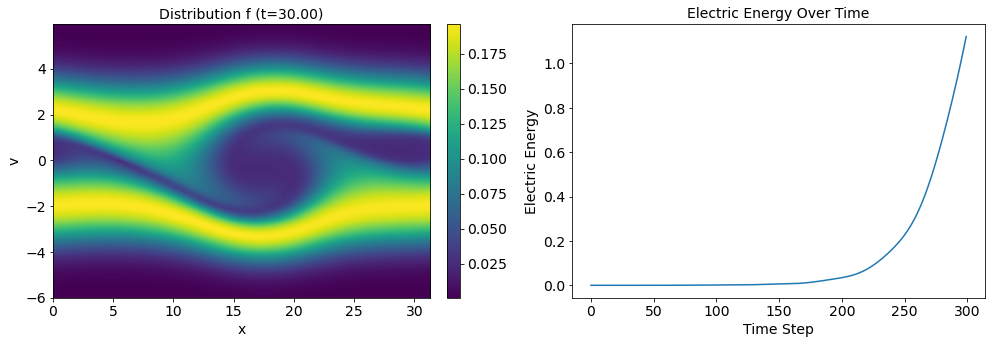

(256, 256)
Iteration 44, Cost: 0.40516310930252075, Coefficients: [ 8.1255857e-05  1.2164892e-05 -1.7624610e-04 -5.8173304e-05
 -1.6016404e-04 -1.1327240e-04 -9.7948643e-05 -6.8075460e-05
 -3.1783049e-05 -2.5739970e-05  1.1245322e-05 -5.2341413e-05
 -2.1176373e-05 -5.4743978e-05 -1.4381079e-05 -3.6312218e-03
 -2.9096419e-03 -4.5133494e-03 -3.0143070e-03 -2.0571058e-03
 -8.9040084e-04 -2.0426148e-04  1.9481433e-04  2.9072069e-04
  2.4623462e-04  1.2228242e-04  7.2538664e-05  8.4714338e-05
  7.0168207e-05  7.1931296e-05]


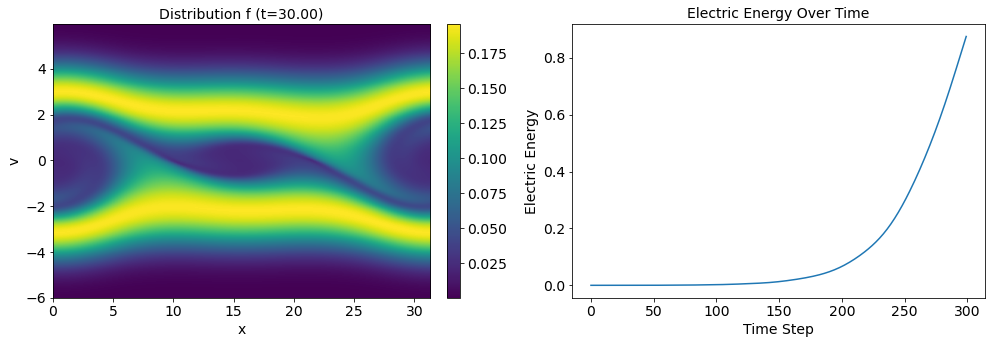

(256, 256)
Iteration 45, Cost: 0.6206061840057373, Coefficients: [-5.4391200e-04 -3.2255426e-05 -1.0357535e-04 -4.8121452e-05
 -1.4947924e-04 -1.2696115e-04 -8.3939580e-05 -5.5962577e-05
 -1.1887449e-05 -9.9643057e-06  3.3200729e-05 -3.4678604e-05
 -2.4734272e-06 -4.0134637e-05  4.4940953e-07 -2.1140696e-04
 -1.4496540e-03 -4.4634868e-03 -3.0990590e-03 -2.1233154e-03
 -9.5366809e-04 -2.1049286e-04  1.8274024e-04  3.1240066e-04
  2.5670015e-04  1.3295443e-04  6.8782225e-05  8.0315993e-05
  6.8392081e-05  6.4058142e-05]


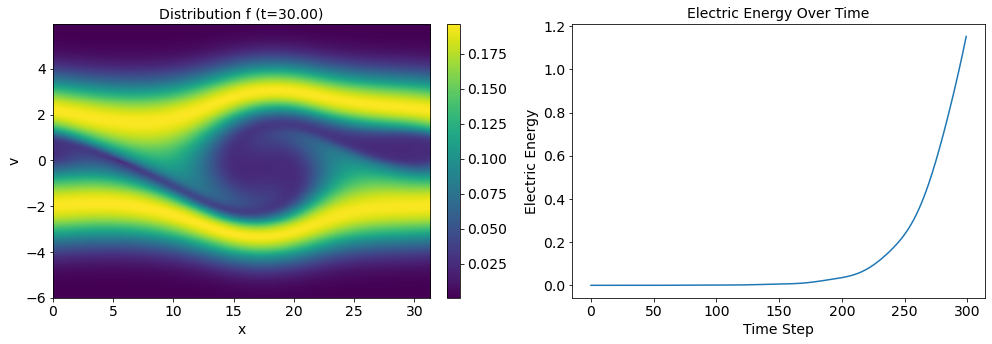

(256, 256)
Iteration 46, Cost: 0.4179952144622803, Coefficients: [ 6.8050111e-05  2.8881695e-06 -1.8606361e-04 -6.6172099e-05
 -1.6601027e-04 -1.2223551e-04 -1.0053489e-04 -7.6561875e-05
 -3.0837473e-05 -2.9276252e-05  1.4489224e-05 -5.5408404e-05
 -2.1585878e-05 -5.6412959e-05 -1.8433191e-05 -3.7281422e-03
 -2.9534395e-03 -4.7385492e-03 -3.1979948e-03 -2.1810392e-03
 -9.6266193e-04 -2.1691734e-04  1.9730389e-04  3.1603960e-04
  2.5918867e-04  1.2585663e-04  7.2777344e-05  8.4119594e-05
  7.4321950e-05  7.5169453e-05]


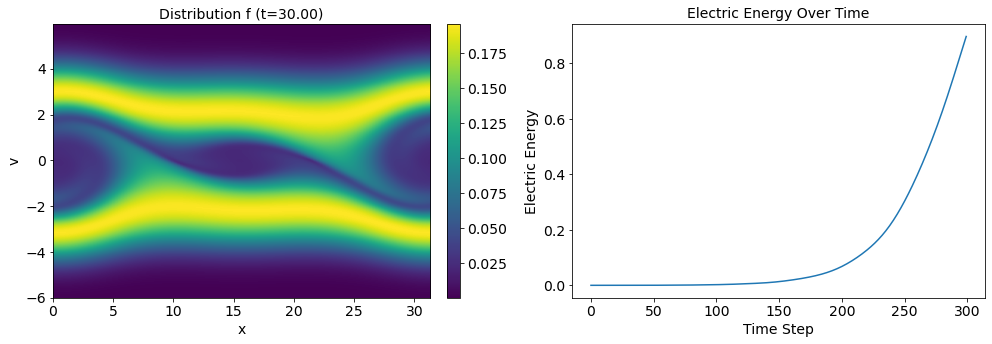

(256, 256)
Iteration 47, Cost: 0.6044570207595825, Coefficients: [-5.5517117e-04 -1.6681464e-05 -1.1061614e-04 -5.0224007e-05
 -1.5336255e-04 -1.3138018e-04 -8.3791194e-05 -6.0814033e-05
 -9.5396827e-06 -1.1071552e-05  3.6963254e-05 -3.5944176e-05
 -2.6110647e-06 -4.0316714e-05 -3.2131475e-06 -2.8782035e-04
 -1.5368958e-03 -4.6931906e-03 -3.2907496e-03 -2.2443344e-03
 -1.0249547e-03 -2.1976315e-04  1.8622733e-04  3.3865884e-04
  2.7073233e-04  1.3634599e-04  7.0056740e-05  7.9893303e-05
  7.1682858e-05  6.8419460e-05]


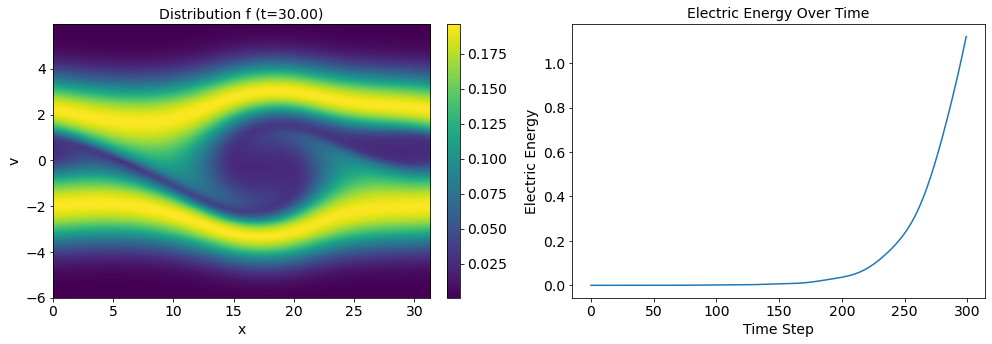

(256, 256)
Iteration 48, Cost: 0.40337640047073364, Coefficients: [ 7.3116622e-05  1.9044863e-05 -1.9494559e-04 -6.9926245e-05
 -1.7023917e-04 -1.2760528e-04 -1.0024042e-04 -8.2318438e-05
 -2.8523120e-05 -3.0884665e-05  1.7412520e-05 -5.6936846e-05
 -2.3075581e-05 -5.6639514e-05 -2.2857610e-05 -3.7236009e-03
 -3.0064736e-03 -4.9645477e-03 -3.3871776e-03 -2.3005733e-03
 -1.0339813e-03 -2.2501088e-04  2.0039987e-04  3.4264961e-04
  2.7280027e-04  1.2963190e-04  7.3587078e-05  8.4071529e-05
  7.7227407e-05  7.9975842e-05]


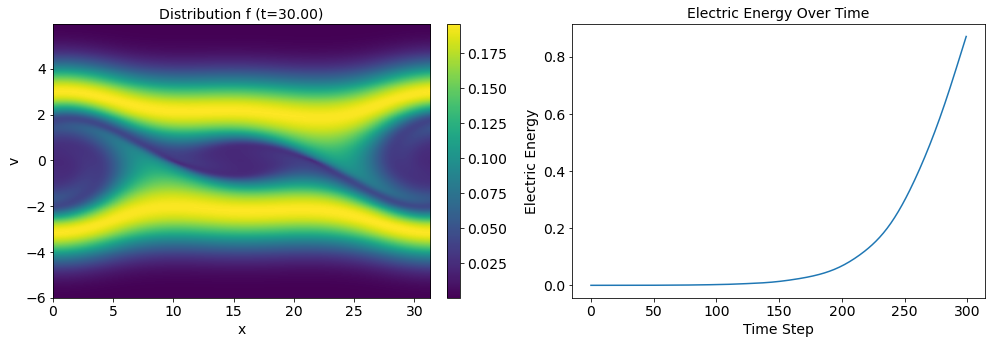

(256, 256)
Iteration 49, Cost: 0.6132659912109375, Coefficients: [-5.4392254e-04 -2.6539630e-05 -1.2410797e-04 -6.0102371e-05
 -1.5953789e-04 -1.4071484e-04 -8.6742708e-05 -6.9625574e-05
 -9.7025713e-06 -1.4609708e-05  3.7658108e-05 -3.8606155e-05
 -5.5950659e-06 -4.1374864e-05 -8.5024267e-06 -2.7767476e-04
 -1.5517381e-03 -4.9022837e-03 -3.4738437e-03 -2.3624350e-03
 -1.0965030e-03 -2.3187546e-04  1.8940528e-04  3.6162802e-04
  2.8647148e-04  1.3879346e-04  7.2452327e-05  7.9545287e-05
  7.4053372e-05  7.3235700e-05]


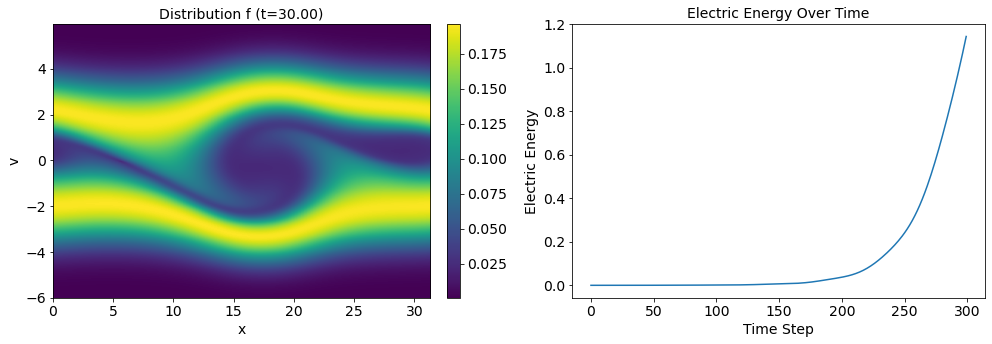

(256, 256)
Iteration 50, Cost: 0.4143293499946594, Coefficients: [ 6.16546022e-05  1.37848219e-05 -2.05885910e-04 -7.84005679e-05
 -1.75686771e-04 -1.37132753e-04 -1.01458514e-04 -9.03956534e-05
 -2.70444325e-05 -3.36009289e-05  1.88413924e-05 -5.84938316e-05
 -2.59427470e-05 -5.68490832e-05 -2.77132895e-05 -3.81155219e-03
 -3.04771261e-03 -5.18165808e-03 -3.57295736e-03 -2.42068060e-03
 -1.10742776e-03 -2.37559289e-04  2.03893098e-04  3.65195447e-04
  2.88390729e-04  1.31235051e-04  7.53274144e-05  8.33666563e-05
  7.96817621e-05  8.50458018e-05]


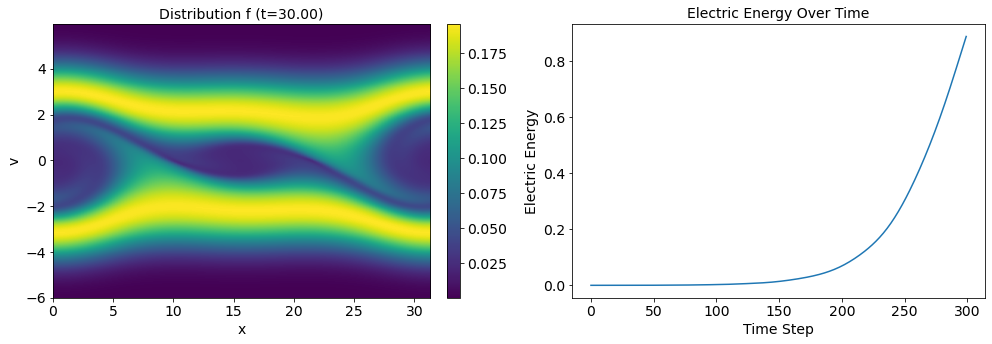

(256, 256)
Iteration 51, Cost: 0.5983386039733887, Coefficients: [-5.52086218e-04 -1.26354480e-05 -1.32204819e-04 -6.41703664e-05
 -1.63181219e-04 -1.46592938e-04 -8.61171648e-05 -7.45636353e-05
 -7.47838021e-06 -1.49938205e-05  3.95938987e-05 -3.91663125e-05
 -7.13323971e-06 -4.22934863e-05 -1.09804423e-05 -3.50493239e-04
 -1.63186283e-03 -5.12358453e-03 -3.66603304e-03 -2.48091132e-03
 -1.16808643e-03 -2.42393842e-04  1.94478765e-04  3.84515792e-04
  3.02741799e-04  1.41119905e-04  7.37529917e-05  8.08146433e-05
  7.42491975e-05  8.00441703e-05]


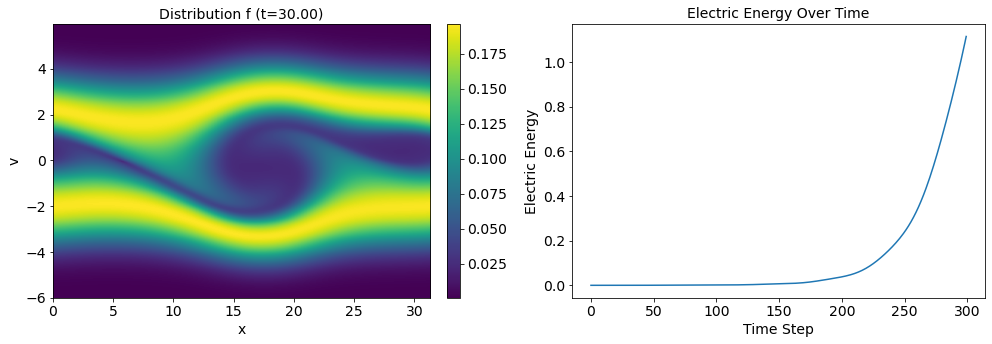

(256, 256)
Iteration 52, Cost: 0.400654137134552, Coefficients: [ 6.6307723e-05  2.8532742e-05 -2.1526526e-04 -8.3677274e-05
 -1.7938433e-04 -1.4373857e-04 -1.0085274e-04 -9.6295640e-05
 -2.5169518e-05 -3.4090397e-05  1.9605181e-05 -5.8710000e-05
 -2.8247727e-05 -5.8077752e-05 -3.0516152e-05 -3.8074683e-03
 -3.0948292e-03 -5.3987163e-03 -3.7628633e-03 -2.5373022e-03
 -1.1794158e-03 -2.4731702e-04  2.0873135e-04  3.8825374e-04
  3.0430823e-04  1.3430568e-04  7.6432611e-05  8.4564512e-05
  7.9695557e-05  9.1840840e-05]


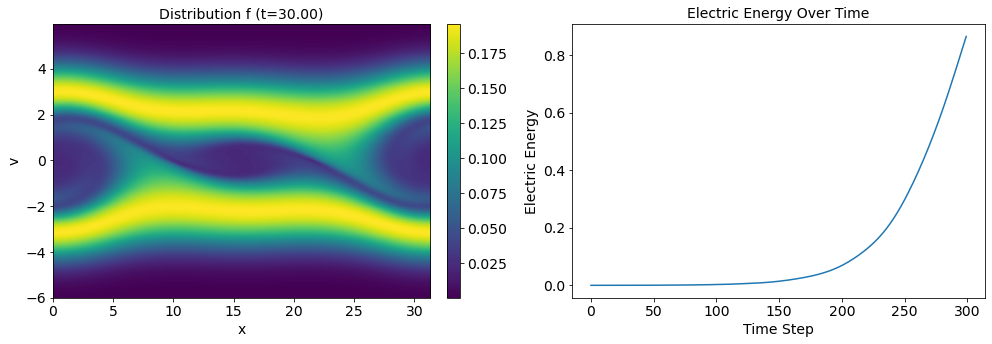

(256, 256)
Iteration 53, Cost: 0.606665313243866, Coefficients: [-5.4153666e-04 -2.3212620e-05 -1.4614932e-04 -7.5027390e-05
 -1.6918786e-04 -1.5636843e-04 -8.8751840e-05 -8.3347550e-05
 -8.1179733e-06 -1.7671255e-05  3.8705992e-05 -4.1161871e-05
 -9.5678242e-06 -4.5206194e-05 -1.4108638e-05 -3.4346897e-04
 -1.6454093e-03 -5.3256014e-03 -3.8495953e-03 -2.5971383e-03
 -1.2398047e-03 -2.5602392e-04  1.9924562e-04  4.0483742e-04
  3.1966937e-04  1.4384453e-04  7.5834549e-05  8.1838058e-05
  7.3963456e-05  8.6689623e-05]


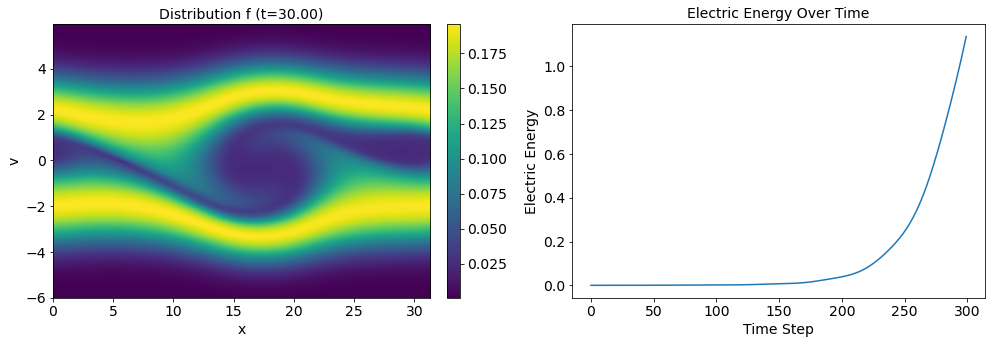

(256, 256)
Iteration 54, Cost: 0.4096568822860718, Coefficients: [ 5.6925928e-05  2.2197621e-05 -2.2648629e-04 -9.3426264e-05
 -1.8419678e-04 -1.5393109e-04 -1.0180044e-04 -1.0474341e-04
 -2.4619694e-05 -3.5944933e-05  1.9214707e-05 -5.9374994e-05
 -3.0452291e-05 -6.0067930e-05 -3.3178942e-05 -3.8846112e-03
 -3.1313123e-03 -5.6076762e-03 -3.9484613e-03 -2.6553683e-03
 -1.2527105e-03 -2.6141785e-04  2.1339962e-04  4.0830058e-04
  3.2109060e-04  1.3659865e-04  7.8197445e-05  8.5279346e-05
  7.9593527e-05  9.8095072e-05]


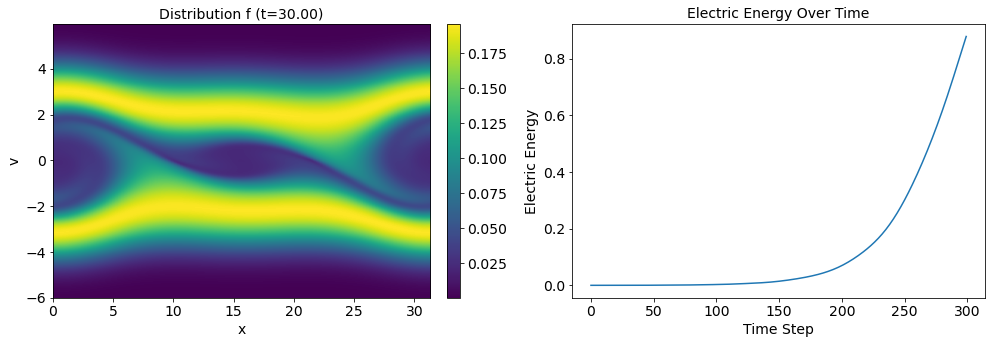

(256, 256)
Iteration 55, Cost: 0.5942708253860474, Coefficients: [-5.4838409e-04 -1.2813578e-05 -1.5552924e-04 -8.0572594e-05
 -1.7324096e-04 -1.6221486e-04 -8.9331312e-05 -8.7654465e-05
 -7.4065138e-06 -1.8172521e-05  3.9529194e-05 -4.2087537e-05
 -1.0233647e-05 -4.7239853e-05 -1.5565822e-05 -4.1241851e-04
 -1.7144940e-03 -5.5377111e-03 -4.0403977e-03 -2.7145010e-03
 -1.3108694e-03 -2.6915653e-04  2.0592561e-04  4.2518988e-04
  3.3627817e-04  1.4763609e-04  7.5918062e-05  8.5101230e-05
  7.2040071e-05  9.3965355e-05]


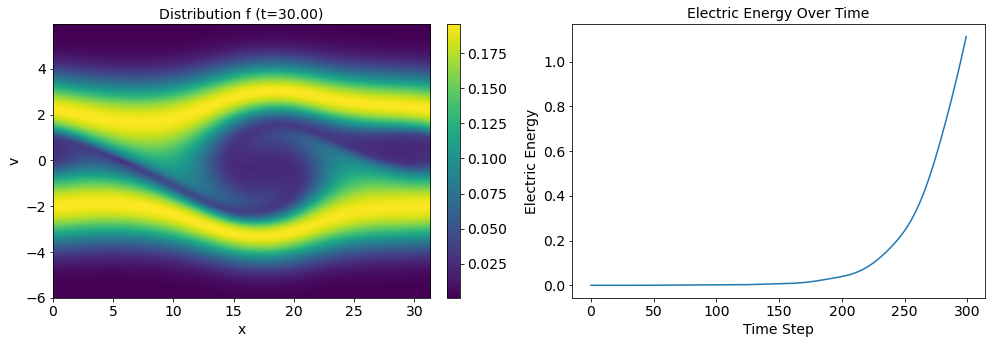

(256, 256)
Iteration 56, Cost: 0.39895331859588623, Coefficients: [ 6.16791658e-05  3.31417177e-05 -2.36948719e-04 -1.00069410e-04
 -1.88688849e-04 -1.59931631e-04 -1.02602578e-04 -1.09405126e-04
 -2.43834311e-05 -3.65877349e-05  1.91884592e-05 -6.07047987e-05
 -3.11231088e-05 -6.26641267e-05 -3.46738379e-05 -3.88839911e-03
 -3.17285908e-03 -5.81618166e-03 -4.13757749e-03 -2.77091260e-03
 -1.32406782e-03 -2.73824931e-04  2.19911337e-04  4.28870640e-04
  3.37368227e-04  1.41077355e-04  7.80282353e-05  8.84910405e-05
  7.77007226e-05  1.05102903e-04]


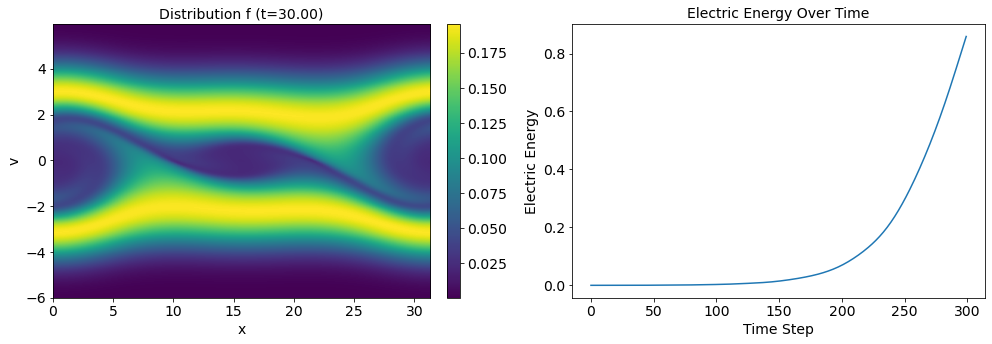

(256, 256)
Iteration 57, Cost: 0.6002141833305359, Coefficients: [-5.39437751e-04 -2.12608466e-05 -1.68981351e-04 -9.12056930e-05
 -1.79380164e-04 -1.70818093e-04 -9.29431844e-05 -9.45622160e-05
 -8.28849079e-06 -2.07555076e-05  3.92816655e-05 -4.54717410e-05
 -1.10341043e-05 -5.11921462e-05 -1.76011381e-05 -4.14055306e-04
 -1.73074938e-03 -5.73403109e-03 -4.22401214e-03 -2.83028488e-03
 -1.38120586e-03 -2.85098387e-04  2.12407758e-04  4.43659257e-04
  3.53144977e-04  1.51927758e-04  7.66464436e-05  8.80561929e-05
  7.02991674e-05  1.00164696e-04]


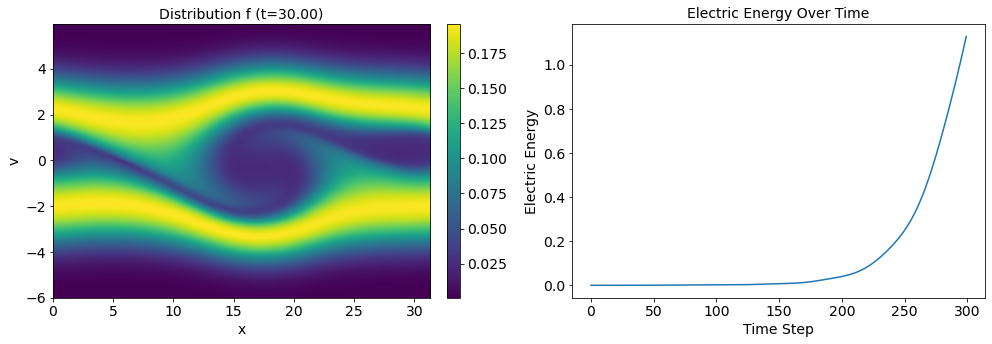

(256, 256)
Iteration 58, Cost: 0.4054359793663025, Coefficients: [ 5.4996344e-05  2.8302471e-05 -2.4823323e-04 -1.0963624e-04
 -1.9404273e-04 -1.6878877e-04 -1.0497994e-04 -1.1581399e-04
 -2.4596004e-05 -3.8309918e-05  1.9200010e-05 -6.3004387e-05
 -3.1655854e-05 -6.6126842e-05 -3.6049532e-05 -3.9526876e-03
 -3.2047615e-03 -6.0181343e-03 -4.3227728e-03 -2.8881500e-03
 -1.3959120e-03 -2.9007529e-04  2.2631210e-04  4.4738880e-04
  3.5400866e-04  1.4516487e-04  7.8359961e-05  9.0939968e-05
  7.6204858e-05  1.1096546e-04]


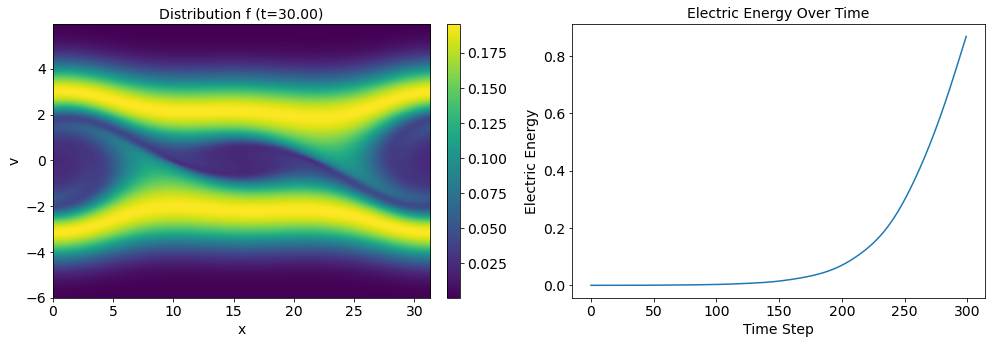

(256, 256)
Iteration 59, Cost: 0.591286301612854, Coefficients: [-5.42752328e-04 -1.45990743e-05 -1.79439638e-04 -9.68216264e-05
 -1.85293291e-04 -1.75563502e-04 -9.52069386e-05 -9.87103558e-05
 -7.81523886e-06 -2.21885657e-05  4.04107959e-05 -4.76610185e-05
 -1.06302432e-05 -5.39642097e-05 -1.95011016e-05 -4.71418723e-04
 -1.78736926e-03 -5.93748130e-03 -4.41228598e-03 -2.94773537e-03
 -1.45079114e-03 -3.01205175e-04  2.20190763e-04  4.62511729e-04
  3.69301037e-04  1.57956281e-04  7.54720895e-05  9.22840554e-05
  6.75679039e-05  1.06231986e-04]


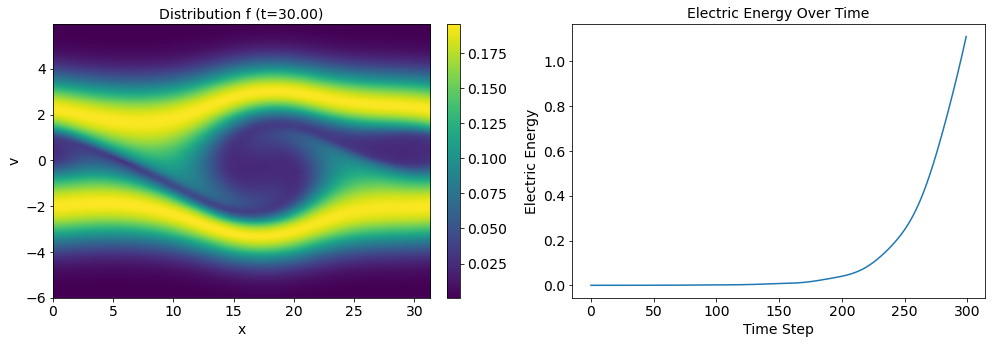

(256, 256)
Iteration 60, Cost: 0.39761218428611755, Coefficients: [ 5.75222657e-05  3.63257495e-05 -2.59095832e-04 -1.16013805e-04
 -1.99719405e-04 -1.74087370e-04 -1.07217231e-04 -1.20161218e-04
 -2.46231393e-05 -3.94442250e-05  1.97280897e-05 -6.49103822e-05
 -3.15442121e-05 -6.91622336e-05 -3.79241064e-05 -3.96443345e-03
 -3.24041583e-03 -6.21905504e-03 -4.50991979e-03 -3.00429645e-03
 -1.46590744e-03 -3.05561611e-04  2.33871295e-04  4.66615369e-04
  3.69996502e-04  1.51589396e-04  7.68606187e-05  9.50219328e-05
  7.35187932e-05  1.16719166e-04]


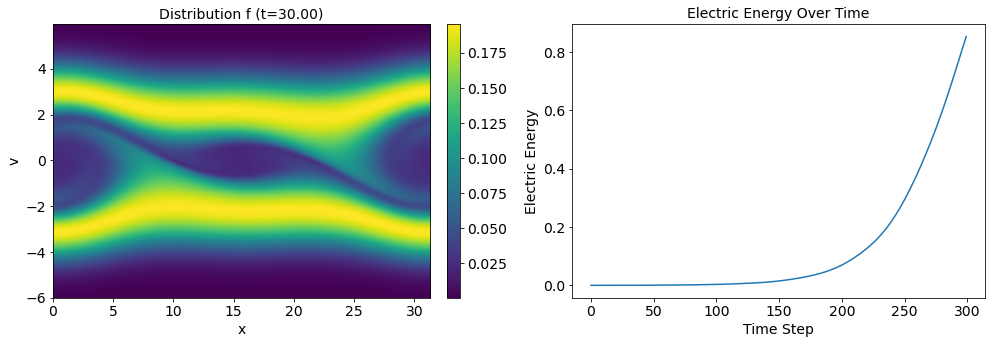

(256, 256)
Iteration 61, Cost: 0.5948746800422668, Coefficients: [-5.3594442e-04 -2.1257638e-05 -1.9291328e-04 -1.0608723e-04
 -1.9265754e-04 -1.8211507e-04 -9.9439960e-05 -1.0478408e-04
 -8.0123664e-06 -2.5956735e-05  4.1105886e-05 -5.1198625e-05
 -1.1183025e-05 -5.6721405e-05 -2.2756125e-05 -4.8339437e-04
 -1.8066166e-03 -6.1292634e-03 -4.5954520e-03 -3.0645949e-03
 -1.5193732e-03 -3.1979699e-04  2.2833461e-04  4.7995910e-04
  3.8553166e-04  1.6445998e-04  7.4108822e-05  9.6651056e-05
  6.5297805e-05  1.1091677e-04]


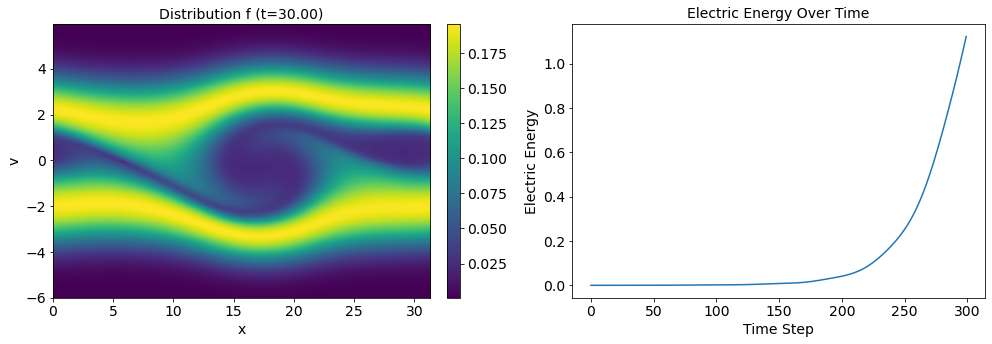

(256, 256)
Iteration 62, Cost: 0.40230005979537964, Coefficients: [ 5.30536636e-05  3.23868808e-05 -2.70823832e-04 -1.24695929e-04
 -2.06309851e-04 -1.80997537e-04 -1.10557165e-04 -1.25965002e-04
 -2.45308092e-05 -4.22823141e-05  2.04320240e-05 -6.75721822e-05
 -3.16935984e-05 -7.17874209e-05 -4.05590108e-05 -4.01998824e-03
 -3.26997880e-03 -6.41460344e-03 -4.69439430e-03 -3.12185218e-03
 -1.53555733e-03 -3.24441207e-04  2.41946938e-04  4.84140211e-04
  3.86119325e-04  1.57910676e-04  7.54878056e-05  9.88547181e-05
  7.13758636e-05  1.21157515e-04]


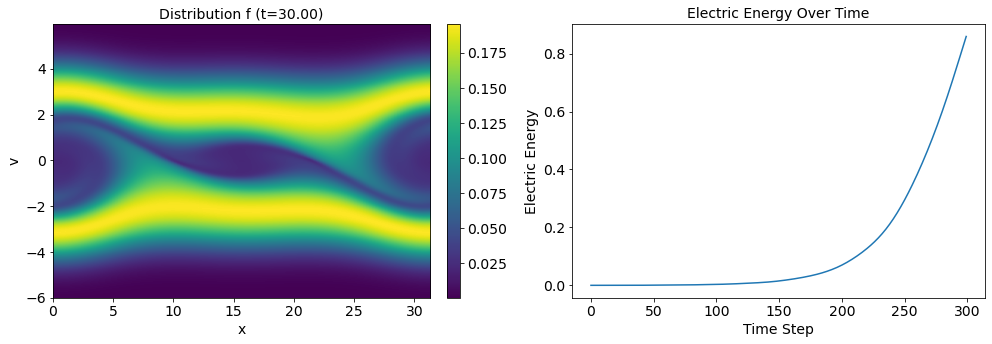

(256, 256)
Iteration 63, Cost: 0.5884527564048767, Coefficients: [-5.38799271e-04 -1.68930674e-05 -2.04036274e-04 -1.11246081e-04
 -1.99990915e-04 -1.86052901e-04 -1.02529695e-04 -1.09624227e-04
 -6.33733362e-06 -2.91823490e-05  4.30575092e-05 -5.35295621e-05
 -1.16412575e-05 -5.80284359e-05 -2.64375194e-05 -5.35369385e-04
 -1.85540610e-03 -6.32580742e-03 -4.78178635e-03 -3.18335113e-03
 -1.58689078e-03 -3.38933169e-04  2.37673536e-04  4.98066889e-04
  4.00536199e-04  1.72735163e-04  7.13205009e-05  1.01359547e-04
  6.31843504e-05  1.14959017e-04]


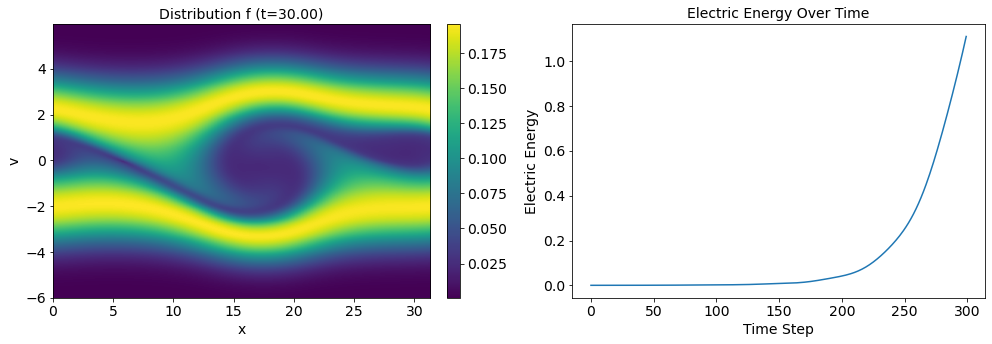

(256, 256)
Iteration 64, Cost: 0.39642202854156494, Coefficients: [ 5.4822245e-05  3.8377930e-05 -2.8204150e-04 -1.3046070e-04
 -2.1351960e-04 -1.8518246e-04 -1.1368432e-04 -1.3077132e-04
 -2.3300783e-05 -4.5183497e-05  2.1897933e-05 -6.9735681e-05
 -3.2244330e-05 -7.3317962e-05 -4.4198379e-05 -4.0373281e-03
 -3.3025509e-03 -6.6092936e-03 -4.8801620e-03 -3.2393693e-03
 -1.6035824e-03 -3.4325814e-04  2.5136842e-04  5.0229137e-04
  4.0113361e-04  1.6665680e-04  7.2355098e-05  1.0345595e-04
  6.9222631e-05  1.2487252e-04]


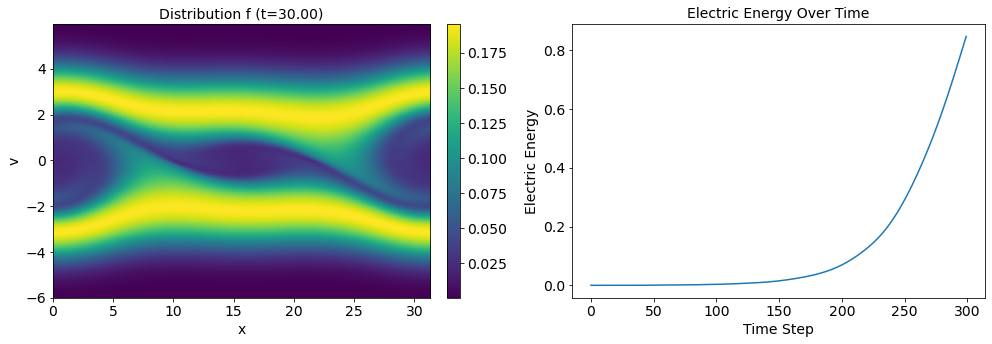

(256, 256)
Iteration 65, Cost: 0.5911553502082825, Coefficients: [-5.34213614e-04 -2.18624155e-05 -2.16917397e-04 -1.19026430e-04
 -2.08137819e-04 -1.91577332e-04 -1.06832529e-04 -1.16329909e-04
 -4.56525777e-06 -3.40266160e-05  4.46762497e-05 -5.62859132e-05
 -1.34327292e-05 -5.92434262e-05 -3.08093768e-05 -5.52739715e-04
 -1.87727215e-03 -6.51392713e-03 -4.96392092e-03 -3.30194598e-03
 -1.65355788e-03 -3.59835656e-04  2.46802374e-04  5.15455438e-04
  4.15350369e-04  1.81756346e-04  6.87197462e-05  1.05722764e-04
  6.17894038e-05  1.17228119e-04]


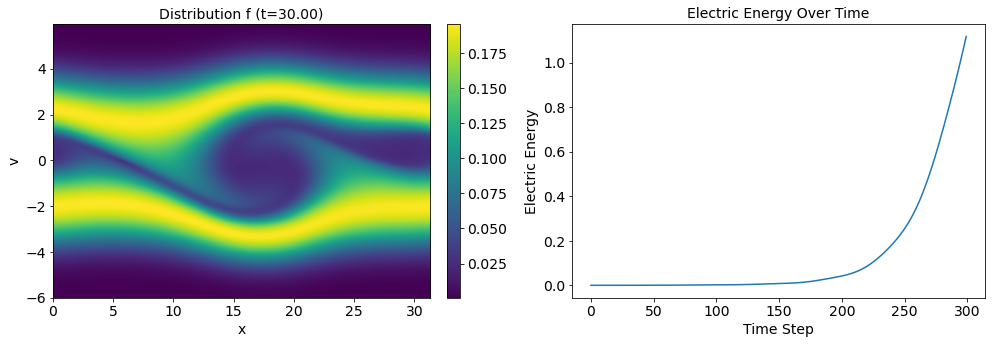

(256, 256)
Iteration 66, Cost: 0.40056413412094116, Coefficients: [ 5.07194200e-05  3.72184586e-05 -2.93397374e-04 -1.37210140e-04
 -2.21263879e-04 -1.90322840e-04 -1.17408235e-04 -1.36623494e-04
 -2.12130853e-05 -4.93748666e-05  2.38371085e-05 -7.19018717e-05
 -3.36347293e-05 -7.43356213e-05 -4.79489900e-05 -4.09208750e-03
 -3.33501445e-03 -6.80151489e-03 -5.06325299e-03 -3.35871615e-03
 -1.67083624e-03 -3.64001899e-04  2.60050467e-04  5.20107860e-04
  4.15438961e-04  1.75624868e-04  6.97454743e-05  1.07320811e-04
  6.83416074e-05  1.26579384e-04]


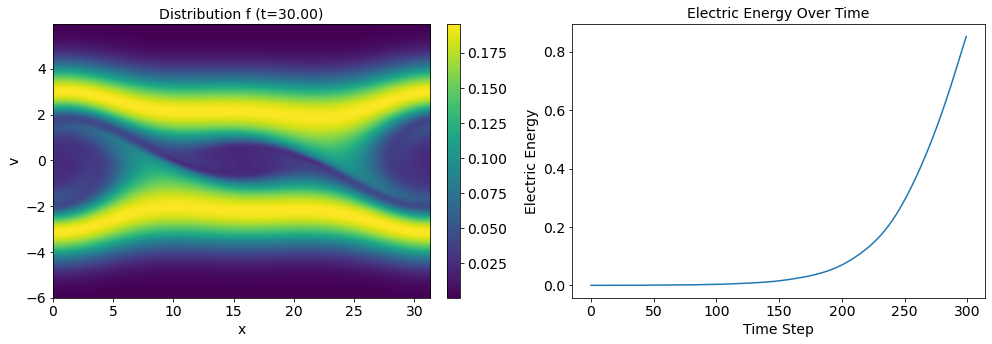

(256, 256)
Iteration 67, Cost: 0.5841257572174072, Coefficients: [-5.3680746e-04 -1.6229602e-05 -2.2777890e-04 -1.2305606e-04
 -2.1576272e-04 -1.9520265e-04 -1.0926219e-04 -1.2183951e-04
 -1.2009696e-06 -3.8040358e-05  4.6985977e-05 -5.7765355e-05
 -1.5174710e-05 -5.9423211e-05 -3.4535227e-05 -6.0649961e-04
 -1.9274969e-03 -6.7080017e-03 -5.1481025e-03 -3.4228999e-03
 -1.7189300e-03 -3.8014495e-04  2.5571752e-04  5.3448859e-04
  4.2869450e-04  1.9185401e-04  6.5646069e-05  1.0966915e-04
  6.1543957e-05  1.1803602e-04]


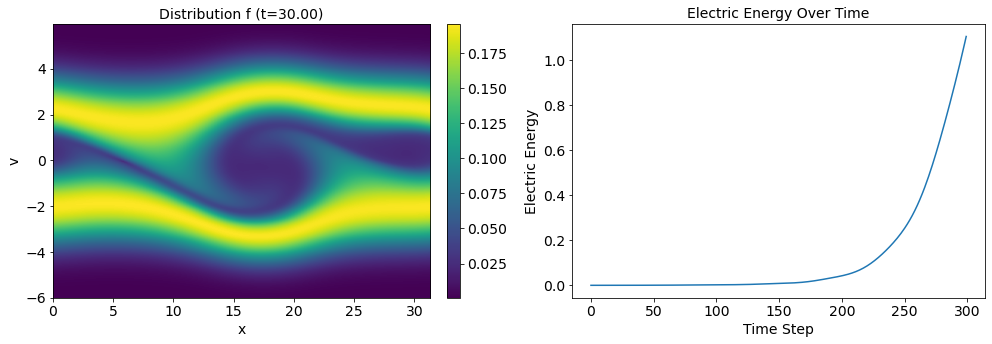

(256, 256)
Iteration 68, Cost: 0.3939605951309204, Coefficients: [ 5.3545577e-05  4.4693585e-05 -3.0411198e-04 -1.4196565e-04
 -2.2863659e-04 -1.9429847e-04 -1.1979635e-04 -1.4201943e-04
 -1.8463556e-05 -5.2970710e-05  2.5704654e-05 -7.3353898e-05
 -3.5496221e-05 -7.4753530e-05 -5.1609306e-05 -4.1068448e-03
 -3.3677449e-03 -6.9936821e-03 -5.2464847e-03 -3.4781434e-03
 -1.7366884e-03 -3.8376945e-04  2.6906130e-04  5.3912069e-04
  4.2873551e-04  1.8616646e-04  6.6448323e-05  1.1094985e-04
  6.8362533e-05  1.2701070e-04]


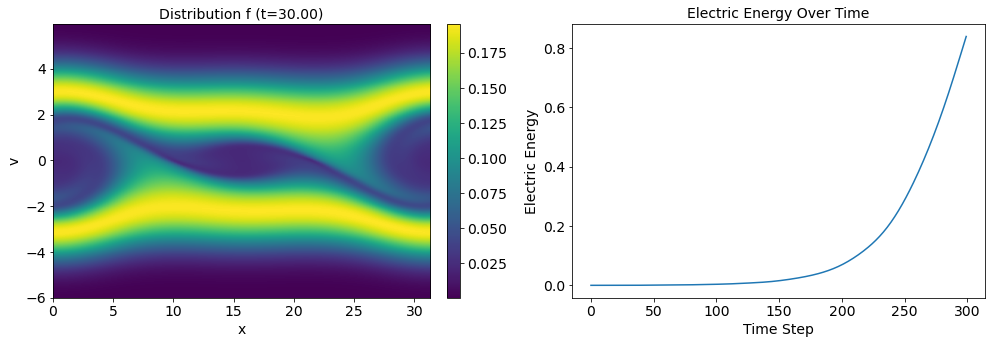

(256, 256)
Iteration 69, Cost: 0.5866325497627258, Coefficients: [-5.32044272e-04 -2.01512048e-05 -2.40629073e-04 -1.30234432e-04
 -2.23979412e-04 -2.00450682e-04 -1.13165923e-04 -1.28536165e-04
  8.87474016e-07 -4.31248372e-05  4.84987322e-05 -5.99525883e-05
 -1.74831948e-05 -6.00631647e-05 -3.85110034e-05 -6.23809639e-04
 -1.94808887e-03 -6.89404784e-03 -5.32738492e-03 -3.54285748e-03
 -1.78452581e-03 -4.00989433e-04  2.63670983e-04  5.52990939e-04
  4.41505981e-04  2.02614625e-04  6.29665665e-05  1.13051967e-04
  6.21708750e-05  1.17876676e-04]


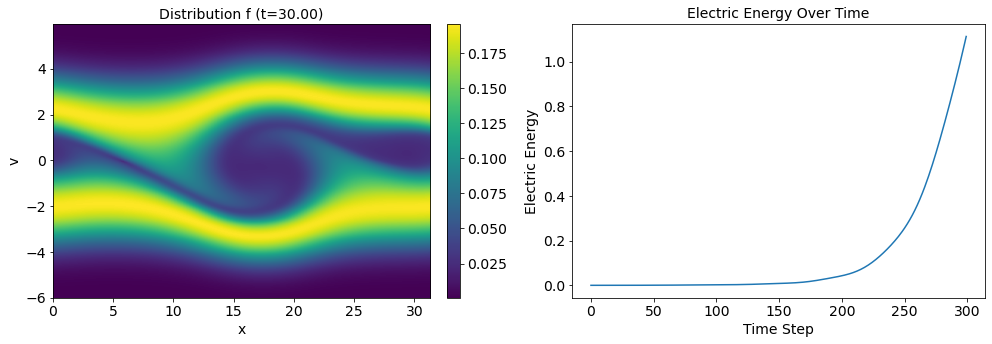

(256, 256)
Iteration 70, Cost: 0.3981812596321106, Coefficients: [ 5.01451432e-05  4.40965778e-05 -3.15347686e-04 -1.48552863e-04
 -2.36261898e-04 -1.99507427e-04 -1.22878875e-04 -1.48129882e-04
 -1.61778407e-05 -5.71919227e-05  2.71689005e-05 -7.49715546e-05
 -3.72703471e-05 -7.53470886e-05 -5.49868528e-05 -4.16087732e-03
 -3.39865033e-03 -7.18295854e-03 -5.42691862e-03 -3.59868864e-03
 -1.80274399e-03 -4.04797494e-04  2.77056941e-04  5.57604188e-04
  4.41538286e-04  1.96668218e-04  6.36881668e-05  1.13930066e-04
  6.93341790e-05  1.26514991e-04]


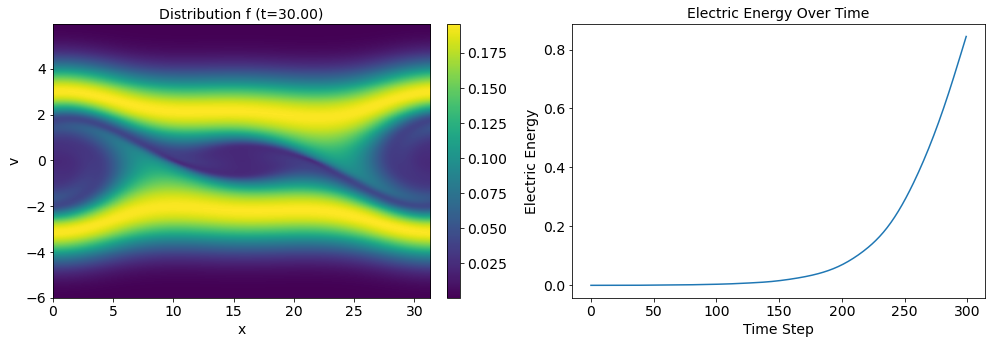

(256, 256)
Iteration 71, Cost: 0.5795871615409851, Coefficients: [-5.3506414e-04 -1.4039433e-05 -2.5078066e-04 -1.3445027e-04
 -2.3100982e-04 -2.0440573e-04 -1.1478900e-04 -1.3434816e-04
  4.4609587e-06 -4.6896308e-05  5.0109105e-05 -6.0559538e-05
 -1.9457835e-05 -6.0277918e-05 -4.1339477e-05 -6.7921169e-04
 -1.9970471e-03 -7.0861243e-03 -5.5089500e-03 -3.6648454e-03
 -1.8488795e-03 -4.2137058e-04  2.7188490e-04  5.7269499e-04
  4.5366070e-04  2.1349428e-04  6.0600931e-05  1.1559995e-04
  6.3653286e-05  1.1714492e-04]


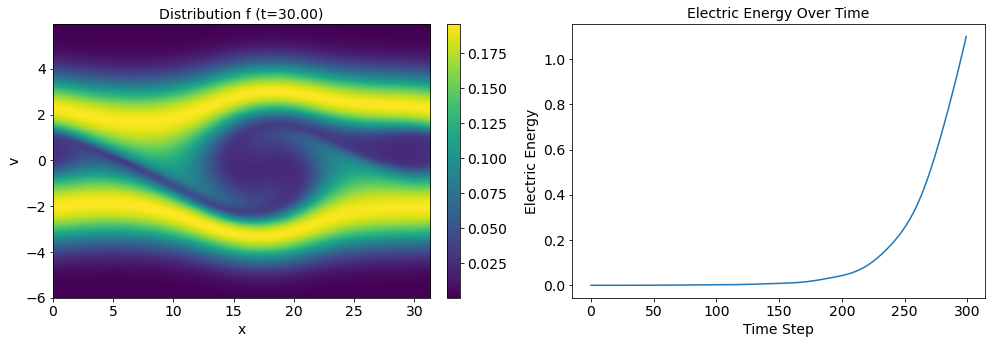

(256, 256)
Iteration 72, Cost: 0.39101457595825195, Coefficients: [ 5.3501688e-05  5.1404073e-05 -3.2556109e-04 -1.5341982e-04
 -2.4351850e-04 -2.0339852e-04 -1.2485142e-04 -1.5362422e-04
 -1.3333909e-05 -6.0691385e-05  2.8433667e-05 -7.5857555e-05
 -3.9099890e-05 -7.6028562e-05 -5.7600031e-05 -4.1727056e-03
 -3.4292263e-03 -7.3730950e-03 -5.6070136e-03 -3.7195410e-03
 -1.8672930e-03 -4.2417913e-04  2.8453176e-04  5.7790242e-04
  4.5343465e-04  2.0760937e-04  6.1637686e-05  1.1596056e-04
  7.1173214e-05  1.2555656e-04]


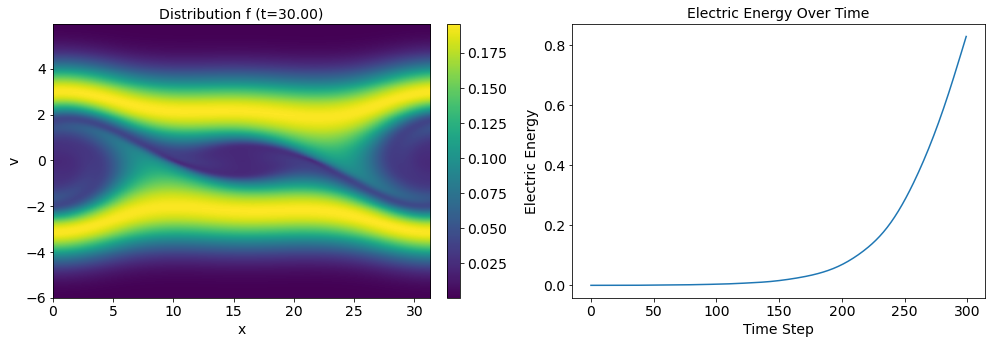

(256, 256)
Iteration 73, Cost: 0.5825591087341309, Coefficients: [-5.30649268e-04 -1.87041296e-05 -2.63311871e-04 -1.41594050e-04
 -2.39619083e-04 -2.09627222e-04 -1.18195167e-04 -1.41549026e-04
  6.63731043e-06 -5.16755390e-05  5.06567812e-05 -6.21873987e-05
 -2.18307596e-05 -6.12413787e-05 -4.44233410e-05 -6.96899369e-04
 -2.01487774e-03 -7.26997573e-03 -5.68516925e-03 -3.78625095e-03
 -1.91332039e-03 -4.41948941e-04  2.78310326e-04  5.92670112e-04
  4.65056655e-04  2.24636664e-04  5.89889241e-05  1.17497366e-04
  6.59896905e-05  1.15711344e-04]


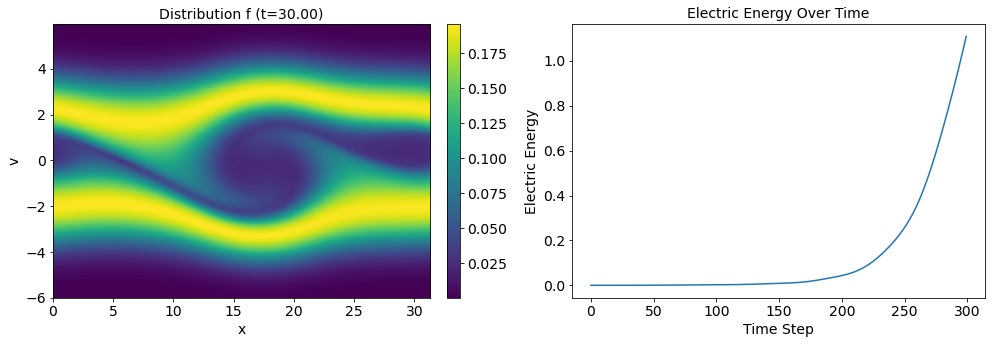

(256, 256)
Iteration 74, Cost: 0.3961811661720276, Coefficients: [ 5.08762314e-05  4.95580534e-05 -3.36530415e-04 -1.60299998e-04
 -2.51389341e-04 -2.08670826e-04 -1.27730076e-04 -1.60114170e-04
 -1.10919682e-05 -6.48487767e-05  2.92351706e-05 -7.71789928e-05
 -4.08964515e-05 -7.71117338e-05 -5.99469568e-05 -4.22754558e-03
 -3.45617626e-03 -7.56067270e-03 -5.78429271e-03 -3.84127419e-03
 -1.93273707e-03 -4.44711623e-04  2.90996133e-04  5.97995531e-04
  4.64800425e-04  2.18533314e-04  6.01278953e-05  1.16897616e-04
  7.41855474e-05  1.23631529e-04]


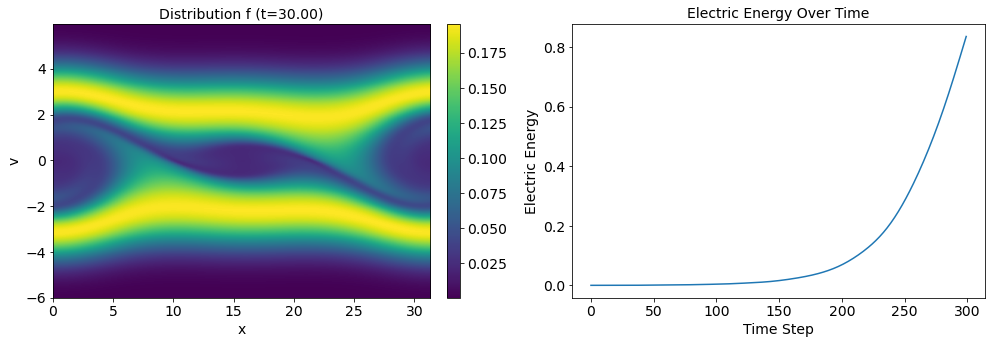

(256, 256)
Iteration 75, Cost: 0.5750091075897217, Coefficients: [-5.34708844e-04 -1.08658132e-05 -2.72454927e-04 -1.45406433e-04
 -2.46672222e-04 -2.13052859e-04 -1.19573575e-04 -1.46908598e-04
  9.90635090e-06 -5.46665651e-05  5.18644119e-05 -6.25520770e-05
 -2.33883184e-05 -6.18933555e-05 -4.62427415e-05 -7.55541725e-04
 -2.06339755e-03 -7.46158650e-03 -5.86383650e-03 -3.90967680e-03
 -1.97749306e-03 -4.61036369e-04  2.84502021e-04  6.14397868e-04
  4.75814129e-04  2.35733183e-04  5.79642765e-05  1.17983087e-04
  6.89926310e-05  1.14309973e-04]


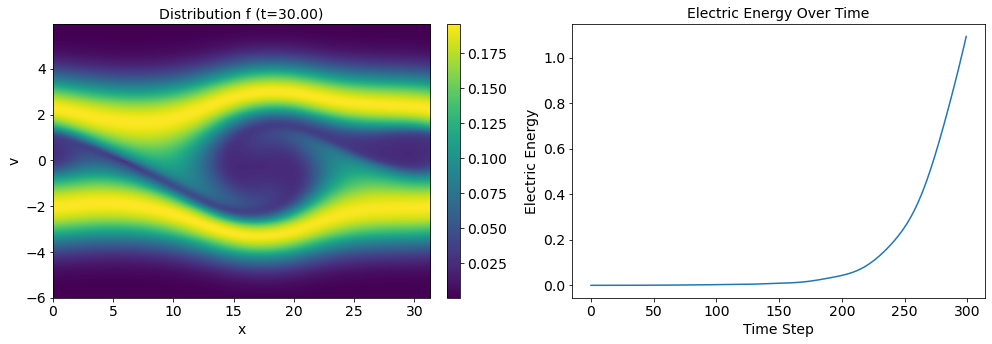

(256, 256)
Iteration 76, Cost: 0.38919758796691895, Coefficients: [ 5.4415374e-05  5.7985650e-05 -3.4609821e-04 -1.6500251e-04
 -2.5859461e-04 -2.1228318e-04 -1.2948413e-04 -1.6528524e-04
 -8.6226555e-06 -6.7550856e-05  2.9967066e-05 -7.8008990e-05
 -4.2067088e-05 -7.8585545e-05 -6.1529230e-05 -4.2398479e-03
 -3.4855441e-03 -7.7496339e-03 -5.9615499e-03 -3.9633578e-03
 -1.9969393e-03 -4.6291738e-04  2.9658832e-04  6.2017189e-04
  4.7553808e-04  2.2955528e-04  5.9568047e-05  1.1697504e-04
  7.7208300e-05  1.2242347e-04]


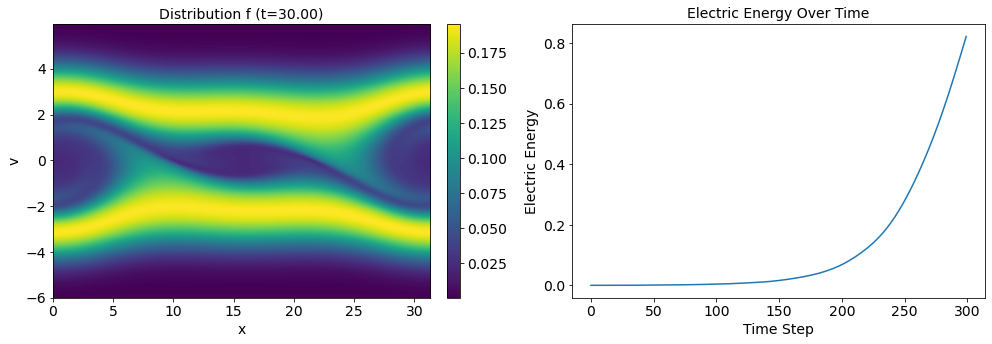

(256, 256)
Iteration 77, Cost: 0.5770505666732788, Coefficients: [-5.30560501e-04 -1.36910021e-05 -2.84645590e-04 -1.51932938e-04
 -2.55061983e-04 -2.18104236e-04 -1.22693731e-04 -1.53585584e-04
  1.17718846e-05 -5.83646761e-05  5.17771732e-05 -6.37643680e-05
 -2.53792023e-05 -6.37210687e-05 -4.80074486e-05 -7.75458058e-04
 -2.08154297e-03 -7.64483912e-03 -6.03737962e-03 -4.03208565e-03
 -2.04168702e-03 -4.80262504e-04  2.89159128e-04  6.36071782e-04
  4.86194098e-04  2.46860145e-04  5.77449355e-05  1.18036005e-04
  7.25098871e-05  1.12613619e-04]


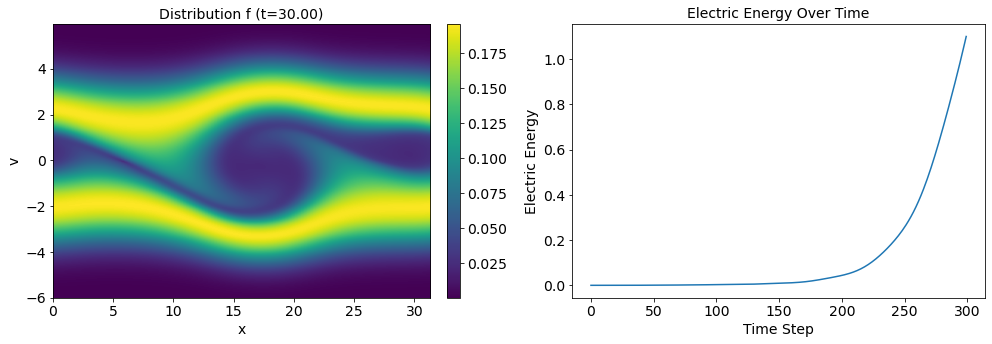

(256, 256)
Iteration 78, Cost: 0.3927783966064453, Coefficients: [ 5.31991827e-05  5.73513098e-05 -3.57021054e-04 -1.70744810e-04
 -2.67092342e-04 -2.16632077e-04 -1.32887944e-04 -1.71130960e-04
 -6.62103776e-06 -7.09496089e-05  3.05129033e-05 -7.92499268e-05
 -4.32407178e-05 -8.08112527e-05 -6.27653571e-05 -4.28763311e-03
 -3.51069355e-03 -7.93614332e-03 -6.13542041e-03 -4.08616103e-03
 -2.06166017e-03 -4.81953059e-04  3.00900516e-04  6.42366009e-04
  4.85362572e-04  2.40783600e-04  5.93957775e-05  1.16263072e-04
  8.12801954e-05  1.20357145e-04]


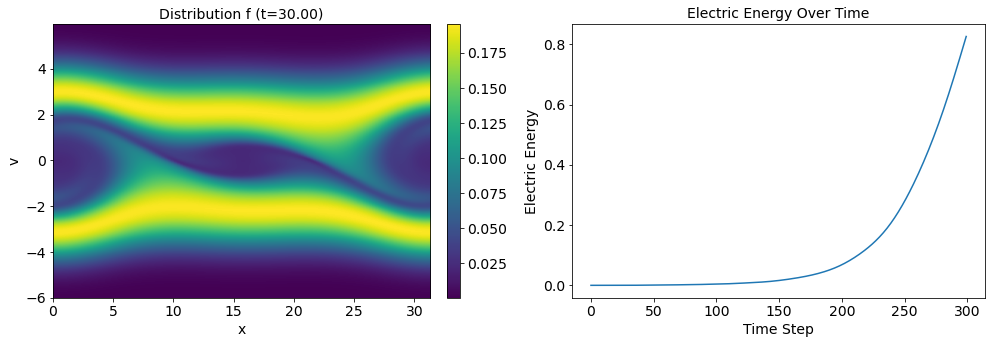

(256, 256)
Iteration 79, Cost: 0.5709500908851624, Coefficients: [-5.34493476e-04 -6.29138231e-06 -2.94403872e-04 -1.55252739e-04
 -2.62817222e-04 -2.20674221e-04 -1.25418985e-04 -1.58023046e-04
  1.46524035e-05 -6.13190423e-05  5.28953606e-05 -6.43874373e-05
 -2.64242135e-05 -6.56149714e-05 -4.85383207e-05 -8.30328325e-04
 -2.12502689e-03 -7.83442799e-03 -6.21222798e-03 -4.15601535e-03
 -2.10581580e-03 -4.97544359e-04  2.92688870e-04  6.59775920e-04
  4.95299697e-04  2.58410961e-04  5.76009443e-05  1.17593016e-04
  7.60912153e-05  1.11424590e-04]


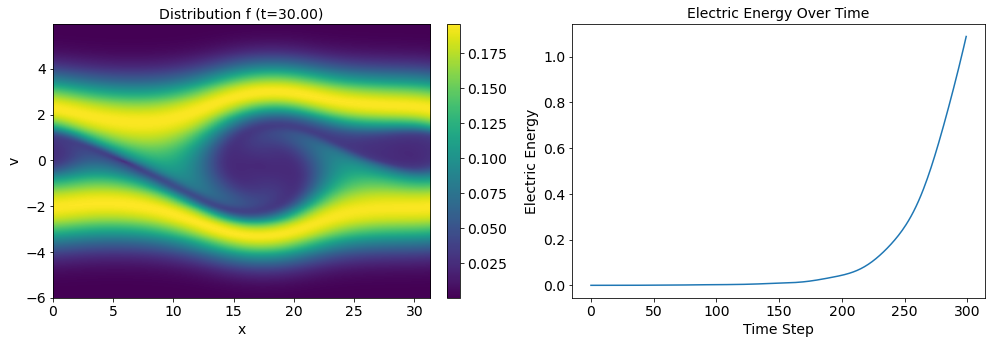

(256, 256)
Iteration 80, Cost: 0.38811010122299194, Coefficients: [ 5.6617486e-05  6.4874293e-05 -3.6728292e-04 -1.7426189e-04
 -2.7607800e-04 -2.1826825e-04 -1.3716037e-04 -1.7472885e-04
 -4.6694313e-06 -7.4248972e-05  3.2389900e-05 -8.1502207e-05
 -4.3190208e-05 -8.3703075e-05 -6.3451997e-05 -4.3072491e-03
 -3.5376465e-03 -8.1248134e-03 -6.3083326e-03 -4.2092307e-03
 -2.1262385e-03 -4.9771549e-04  3.0303106e-04  6.6735304e-04
  4.9376418e-04  2.5274046e-04  5.9432197e-05  1.1517561e-04
  8.5523527e-05  1.1854516e-04]


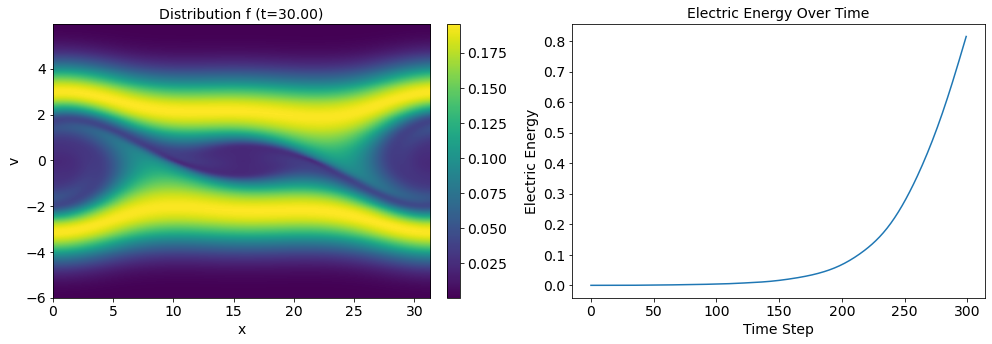

(256, 256)
Iteration 81, Cost: 0.5695443749427795, Coefficients: [-5.30079822e-04 -6.33492164e-06 -3.05398775e-04 -1.60518510e-04
 -2.71962548e-04 -2.23602998e-04 -1.29573775e-04 -1.63176461e-04
  1.68382376e-05 -6.54505129e-05  5.39357679e-05 -6.67456407e-05
 -2.68209933e-05 -6.88481668e-05 -4.90750317e-05 -8.60089669e-04
 -2.14804639e-03 -8.02006386e-03 -6.38223812e-03 -4.28005774e-03
 -2.16949661e-03 -5.14483079e-04  2.94689613e-04  6.83942810e-04
  5.04171301e-04  2.69456912e-04  5.89903429e-05  1.15738563e-04
  8.13318693e-05  1.08770895e-04]


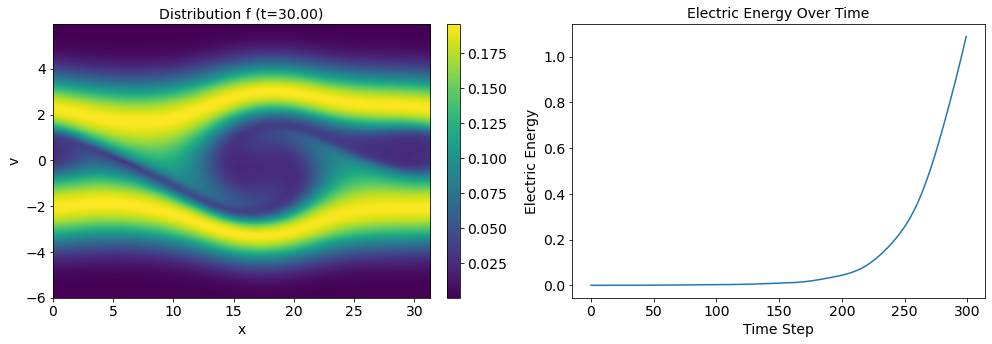

(256, 256)
Iteration 82, Cost: 0.38889724016189575, Coefficients: [ 5.85360103e-05  6.52413364e-05 -3.77222954e-04 -1.79307259e-04
 -2.86227674e-04 -2.19978509e-04 -1.42308243e-04 -1.78636910e-04
 -2.55464329e-06 -7.82690040e-05  3.40966144e-05 -8.45553004e-05
 -4.28902858e-05 -8.74663965e-05 -6.34915486e-05 -4.34171222e-03
 -3.55732907e-03 -8.31253827e-03 -6.47734664e-03 -4.33325674e-03
 -2.19022273e-03 -5.13824401e-04  3.04262445e-04  6.92162022e-04
  5.02005336e-04  2.63689260e-04  6.06613175e-05  1.13118695e-04
  9.08995207e-05  1.16179413e-04]


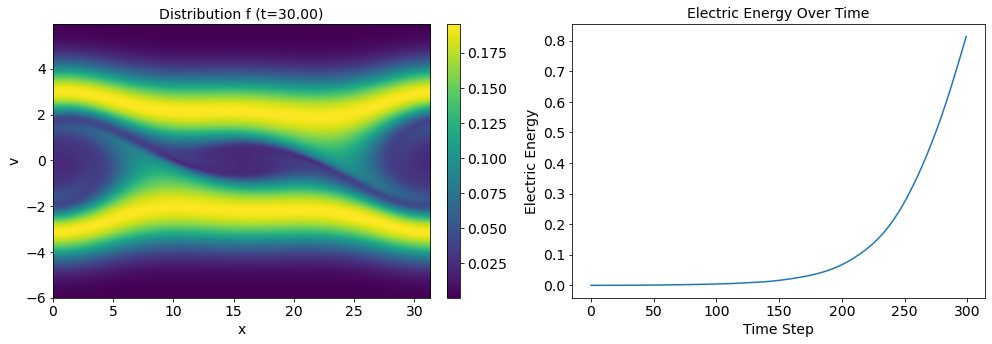

(256, 256)
Iteration 83, Cost: 0.5650768280029297, Coefficients: [-5.3075171e-04 -1.4512334e-06 -3.1447038e-04 -1.6383424e-04
 -2.8147397e-04 -2.2457683e-04 -1.3382887e-04 -1.6642257e-04
  1.9324016e-05 -6.8862813e-05  5.5860306e-05 -6.9363785e-05
 -2.6456652e-05 -7.2199982e-05 -4.8923845e-05 -9.0619549e-04
 -2.1791698e-03 -8.2091140e-03 -6.5509495e-03 -4.4051576e-03
 -2.2329739e-03 -5.2994548e-04  2.9556701e-04  7.0922257e-04
  5.1238644e-04  2.8019625e-04  6.0624858e-05  1.1350536e-04
  8.6717358e-05  1.0656297e-04]


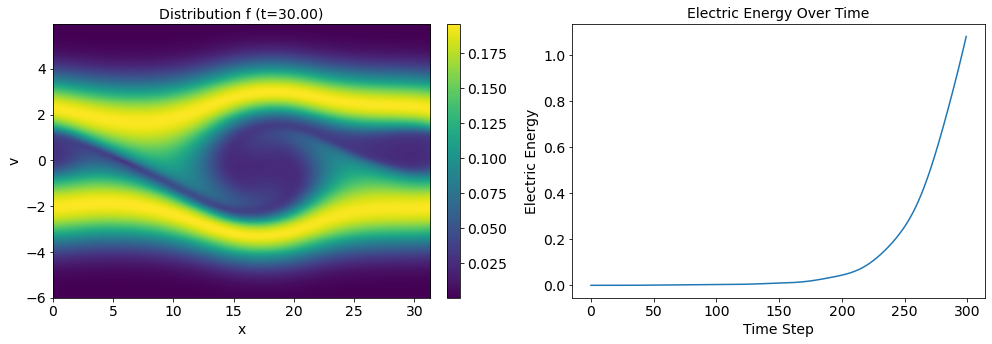

(256, 256)
Iteration 84, Cost: 0.385816365480423, Coefficients: [ 6.19911589e-05  7.02457182e-05 -3.86558269e-04 -1.82885604e-04
 -2.96372455e-04 -2.20864225e-04 -1.46928287e-04 -1.81685333e-04
 -6.77577191e-07 -8.15087624e-05  3.59122932e-05 -8.76210688e-05
 -4.24076716e-05 -9.08315051e-05 -6.37226040e-05 -4.36334405e-03
 -3.57789872e-03 -8.50044098e-03 -6.64508762e-03 -4.45722323e-03
 -2.25375569e-03 -5.28616481e-04  3.04940186e-04  7.17539690e-04
  5.10318961e-04  2.74235354e-04  6.26083129e-05  1.10765468e-04
  9.59000754e-05  1.14698734e-04]


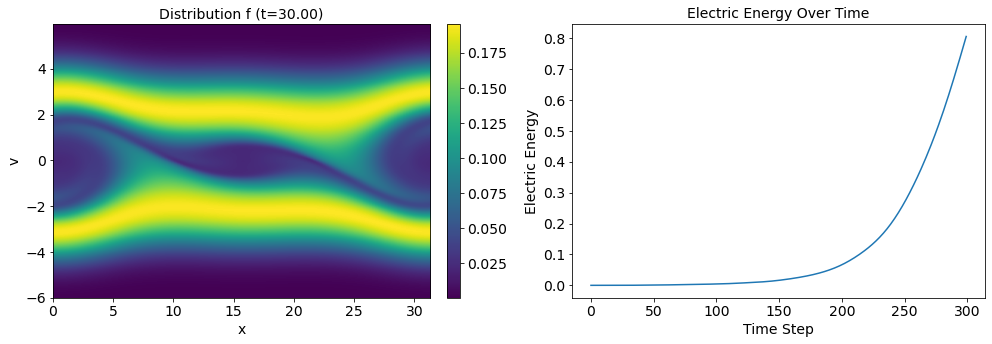

(256, 256)
Iteration 85, Cost: 0.5630427002906799, Coefficients: [-5.28751232e-04  4.78292350e-07 -3.23881337e-04 -1.67683262e-04
 -2.91523873e-04 -2.25739321e-04 -1.38487754e-04 -1.69927036e-04
  2.13570402e-05 -7.23348348e-05  5.76415841e-05 -7.24495621e-05
 -2.61009263e-05 -7.55228975e-05 -4.92212093e-05 -9.41401115e-04
 -2.20191595e-03 -8.39546975e-03 -6.71683671e-03 -4.52991389e-03
 -2.29614554e-03 -5.44990646e-04  2.95717211e-04  7.34501809e-04
  5.20763628e-04  2.90278083e-04  6.31826260e-05  1.10907036e-04
  9.19252052e-05  1.04962128e-04]


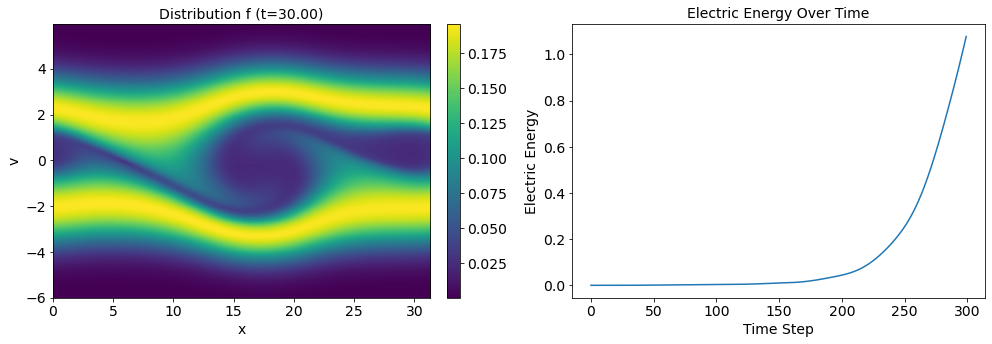

(256, 256)
Iteration 86, Cost: 0.3850306570529938, Coefficients: [ 6.3731510e-05  7.3219162e-05 -3.9552842e-04 -1.8680858e-04
 -3.0669483e-04 -2.2172648e-04 -1.5182518e-04 -1.8472984e-04
  1.1007287e-06 -8.4657317e-05  3.7494403e-05 -9.0511312e-05
 -4.2022497e-05 -9.4146722e-05 -6.3834952e-05 -4.3915100e-03
 -3.5958923e-03 -8.6866207e-03 -6.8106349e-03 -4.5813918e-03
 -2.3169708e-03 -5.4341240e-04  3.0501393e-04  7.4286491e-04
  5.1878433e-04  2.8409046e-04  6.5319909e-05  1.0817548e-04
  1.0056785e-04  1.1388332e-04]


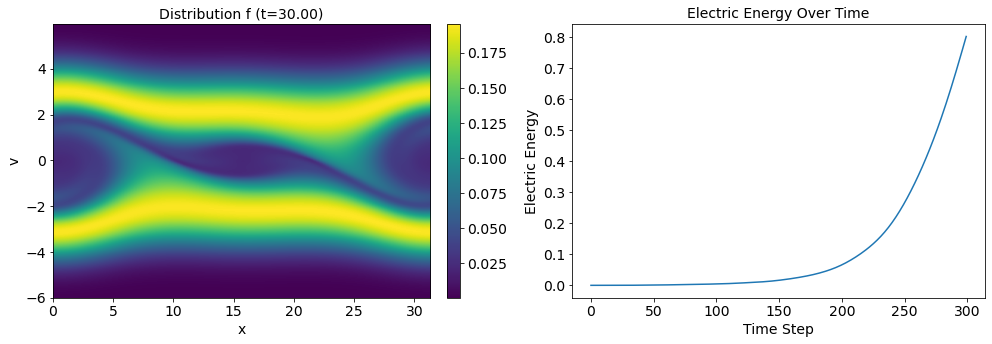

(256, 256)
Iteration 87, Cost: 0.5585849285125732, Coefficients: [-5.2818807e-04  4.5374109e-06 -3.3231027e-04 -1.7076757e-04
 -3.0159962e-04 -2.2628868e-04 -1.4250167e-04 -1.7315622e-04
  2.3654346e-05 -7.5247415e-05  5.9079430e-05 -7.5039781e-05
 -2.5526198e-05 -7.8964491e-05 -4.8716098e-05 -9.8608038e-04
 -2.2298673e-03 -8.5824737e-03 -6.8816193e-03 -4.6550389e-03
 -2.3589467e-03 -5.5943785e-04  2.9548799e-04  7.5998052e-04
  5.2925257e-04  2.9978238e-04  6.6378576e-05  1.0812993e-04
  9.6777971e-05  1.0406156e-04]


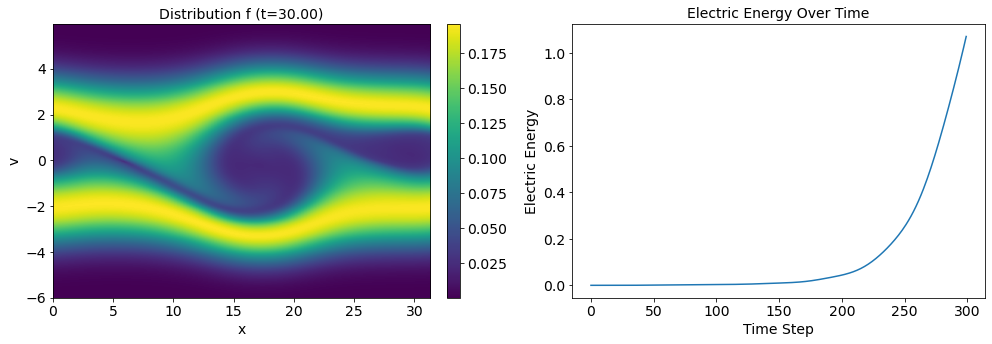

(256, 256)
Iteration 88, Cost: 0.38214272260665894, Coefficients: [ 6.7656394e-05  7.7347620e-05 -4.0387764e-04 -1.9070470e-04
 -3.1686615e-04 -2.2246686e-04 -1.5625851e-04 -1.8785393e-04
  2.8718987e-06 -8.7570319e-05  3.8872600e-05 -9.3393930e-05
 -4.1306244e-05 -9.7765136e-05 -6.3534208e-05 -4.4113719e-03
 -3.6121816e-03 -8.8719502e-03 -6.9746845e-03 -4.7050253e-03
 -2.3801990e-03 -5.5729499e-04  3.0495628e-04  7.6792249e-04
  5.2790658e-04  2.9333471e-04  6.8479378e-05  1.0556299e-04
  1.0482565e-04  1.1352540e-04]


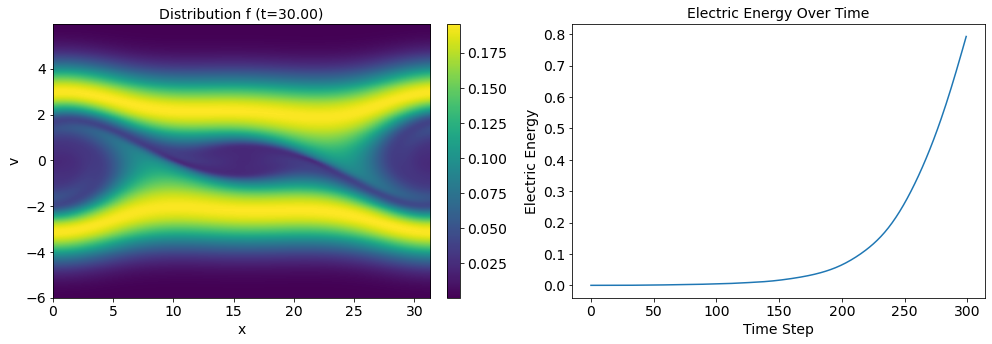

(256, 256)
Iteration 89, Cost: 0.556026816368103, Coefficients: [-5.25979442e-04  7.31916225e-06 -3.40934872e-04 -1.74518180e-04
 -3.11635347e-04 -2.27043478e-04 -1.46914274e-04 -1.76251328e-04
  2.56499025e-05 -7.83730648e-05  6.05562091e-05 -7.80744813e-05
 -2.48320666e-05 -8.27278418e-05 -4.79989758e-05 -1.02218171e-03
 -2.25044833e-03 -8.76673684e-03 -7.04403920e-03 -4.77926247e-03
 -2.42214766e-03 -5.72983758e-04  2.94540048e-04  7.85251905e-04
  5.38121792e-04  3.08762217e-04  6.98281583e-05  1.05686857e-04
  1.00777266e-04  1.04196697e-04]


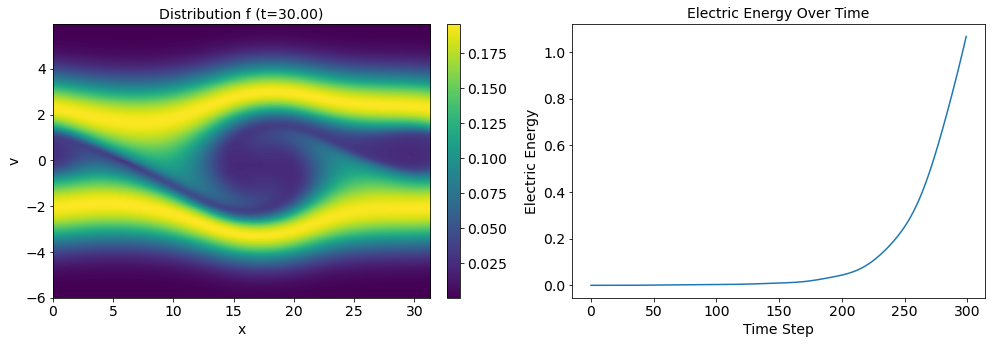

(256, 256)
Iteration 90, Cost: 0.3812318444252014, Coefficients: [ 7.00860401e-05  8.04600786e-05 -4.12352907e-04 -1.94699300e-04
 -3.27153481e-04 -2.23040537e-04 -1.61119475e-04 -1.90517734e-04
  4.58770046e-06 -9.06407222e-05  4.01644647e-05 -9.61921323e-05
 -4.09010754e-05 -1.01314028e-04 -6.28389607e-05 -4.43751737e-03
 -3.62742413e-03 -9.05591995e-03 -7.13666482e-03 -4.82835248e-03
 -2.44354736e-03 -5.70617849e-04  3.04339948e-04  7.92780716e-04
  5.37035346e-04  3.02281987e-04  7.16888899e-05  1.03474522e-04
  1.08108004e-04  1.14441274e-04]


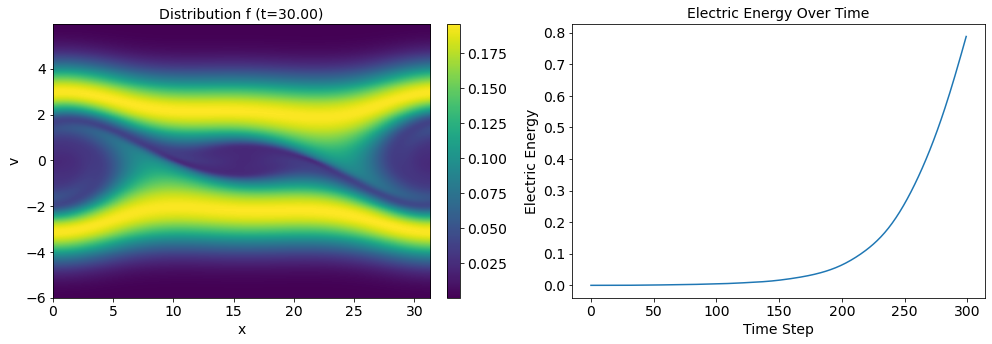

(256, 256)
Iteration 91, Cost: 0.5511780977249146, Coefficients: [-5.2542443e-04  1.1922981e-05 -3.4899029e-04 -1.7745598e-04
 -3.2151936e-04 -2.2739994e-04 -1.5117181e-04 -1.7874283e-04
  2.7592354e-05 -8.1092665e-05  6.2053034e-05 -8.0644204e-05
 -2.4383522e-05 -8.6224645e-05 -4.6986417e-05 -1.0682275e-03
 -2.2762148e-03 -8.9517944e-03 -7.2056078e-03 -4.9030762e-03
 -2.4853263e-03 -5.8605103e-04  2.9388047e-04  8.1019849e-04
  5.4709084e-04  3.1758350e-04  7.3226940e-05  1.0349785e-04
  1.0418998e-04  1.0515635e-04]


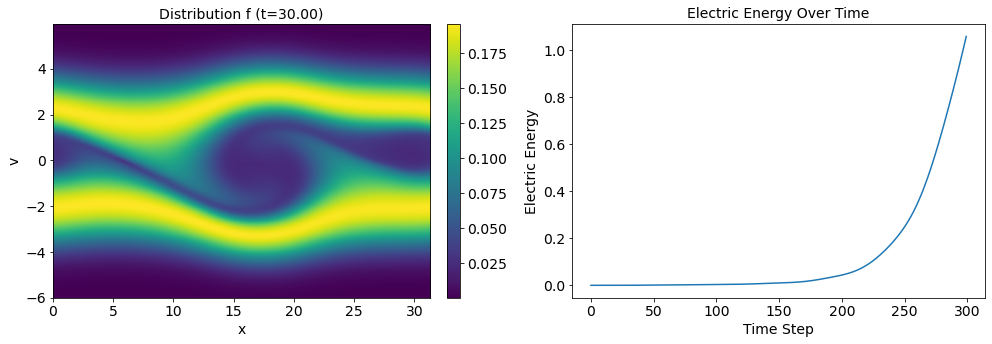

(256, 256)
Iteration 92, Cost: 0.3772822618484497, Coefficients: [ 7.41619151e-05  8.47952906e-05 -4.20523982e-04 -1.98351408e-04
 -3.37287318e-04 -2.23402865e-04 -1.65882084e-04 -1.93003129e-04
  6.02898217e-06 -9.34033014e-05  4.15206887e-05 -9.88479587e-05
 -4.04711973e-05 -1.04728046e-04 -6.21622166e-05 -4.45182808e-03
 -3.64011433e-03 -9.23854392e-03 -7.29749911e-03 -4.95056389e-03
 -2.50648474e-03 -5.83151763e-04  3.03785113e-04  8.17381660e-04
  5.46144787e-04  3.10744508e-04  7.51088082e-05  1.01598162e-04
  1.11170928e-04  1.16077041e-04]


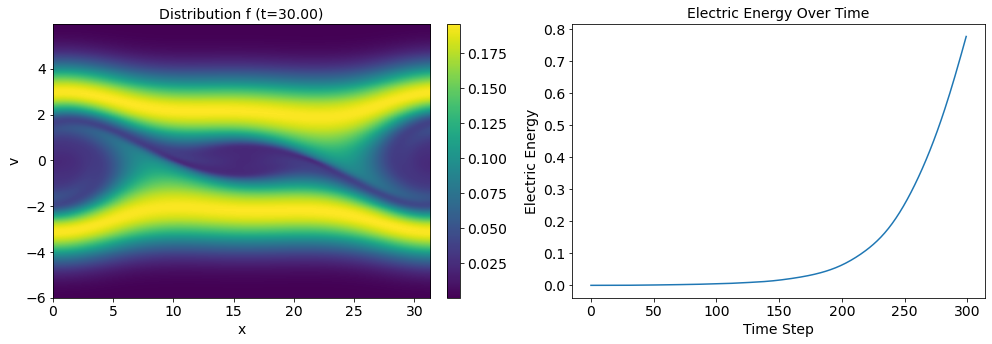

(256, 256)
Iteration 93, Cost: 0.5486732721328735, Coefficients: [-5.2211684e-04  1.2762161e-05 -3.5745179e-04 -1.8152305e-04
 -3.3137843e-04 -2.2837722e-04 -1.5583845e-04 -1.8185940e-04
  2.9259687e-05 -8.4192048e-05  6.3247615e-05 -8.3152452e-05
 -2.4237701e-05 -8.9807225e-05 -4.6001653e-05 -1.1038387e-03
 -2.2927430e-03 -9.1331117e-03 -7.3643131e-03 -5.0260760e-03
 -2.5478241e-03 -5.9906516e-04  2.9291210e-04  8.3449180e-04
  5.5641355e-04  3.2538461e-04  7.7494406e-05  1.0115200e-04
  1.0761279e-04  1.0655701e-04]


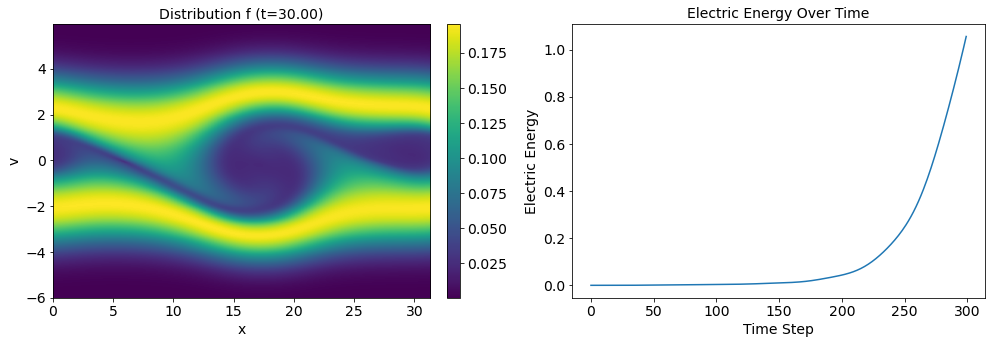

(256, 256)
Iteration 94, Cost: 0.37568527460098267, Coefficients: [ 7.80734117e-05  8.59083957e-05 -4.28985746e-04 -2.02697614e-04
 -3.47327674e-04 -2.24534073e-04 -1.70484709e-04 -1.96116118e-04
  7.63210119e-06 -9.64619030e-05  4.24673126e-05 -1.01254234e-04
 -4.03643789e-05 -1.08286797e-04 -6.11200958e-05 -4.47191531e-03
 -3.64914536e-03 -9.41856764e-03 -7.45582161e-03 -5.07255737e-03
 -2.56894808e-03 -5.95965248e-04  3.03023553e-04  8.41410423e-04
  5.55869250e-04  3.18305130e-04  7.93132713e-05  9.94269722e-05
  1.14139795e-04  1.17843039e-04]


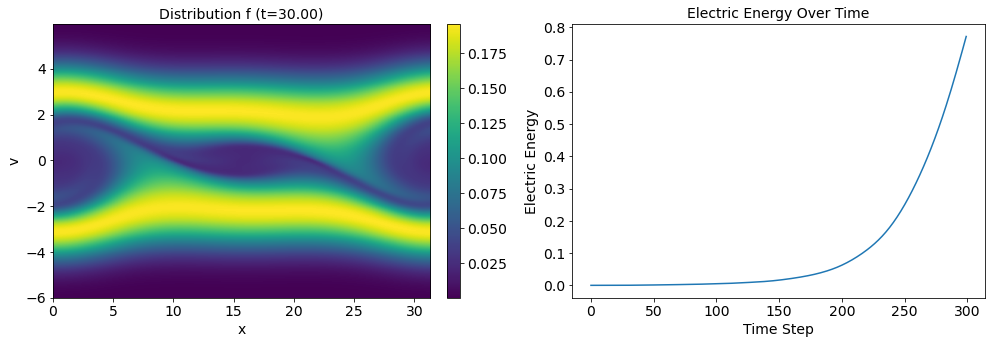

(256, 256)
Iteration 95, Cost: 0.5442771911621094, Coefficients: [-5.20315545e-04  1.61791104e-05 -3.65467626e-04 -1.84562479e-04
 -3.41312349e-04 -2.28805497e-04 -1.59947507e-04 -1.84747769e-04
  3.11641707e-05 -8.67092531e-05  6.41512015e-05 -8.53122037e-05
 -2.37798122e-05 -9.35967546e-05 -4.45440965e-05 -1.14681222e-03
 -2.31226278e-03 -9.31369700e-03 -7.52178859e-03 -5.14866272e-03
 -2.61026714e-03 -6.11228985e-04  2.91345554e-04  8.58916028e-04
  5.65963041e-04  3.32664291e-04  8.18511835e-05  9.93013164e-05
  1.10104054e-04  1.08835484e-04]


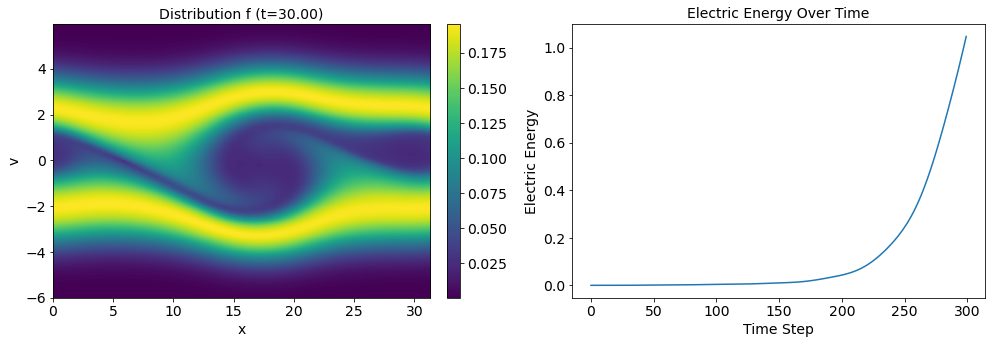

(256, 256)
Iteration 96, Cost: 0.3720952570438385, Coefficients: [ 8.35125684e-05  8.85602785e-05 -4.37038863e-04 -2.06733850e-04
 -3.57428769e-04 -2.25134892e-04 -1.75207984e-04 -1.98938636e-04
  9.08986840e-06 -9.90139888e-05  4.30650398e-05 -1.03421291e-04
 -4.01592406e-05 -1.12058835e-04 -6.00112980e-05 -4.48364671e-03
 -3.65562062e-03 -9.59661976e-03 -7.61230290e-03 -5.19381789e-03
 -2.63107638e-03 -6.08114235e-04  3.01938970e-04  8.65356182e-04
  5.65766473e-04  3.25694215e-04  8.33120575e-05  9.80590848e-05
  1.15982824e-04  1.20487144e-04]


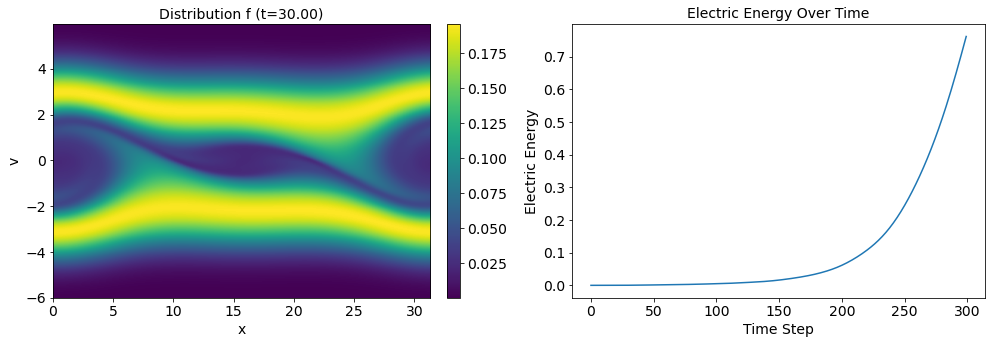

(256, 256)
Iteration 97, Cost: 0.540807843208313, Coefficients: [-5.16545551e-04  1.77859984e-05 -3.73810472e-04 -1.88339967e-04
 -3.51070164e-04 -2.29572601e-04 -1.64488229e-04 -1.87456622e-04
  3.26338850e-05 -8.92241296e-05  6.46010230e-05 -8.73772078e-05
 -2.37053519e-05 -9.73174028e-05 -4.32685483e-05 -1.18408771e-03
 -2.32495321e-03 -9.49110184e-03 -7.67628150e-03 -5.27033210e-03
 -2.67244969e-03 -6.23397180e-04  2.89910327e-04  8.82277440e-04
  5.76001476e-04  3.39696271e-04  8.59370921e-05  9.79520482e-05
  1.12242262e-04  1.11277404e-04]


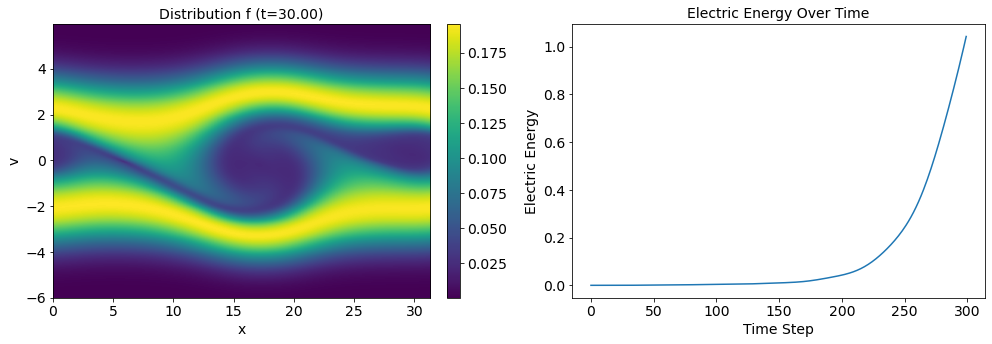

(256, 256)
Iteration 98, Cost: 0.36937904357910156, Coefficients: [ 8.8480243e-05  8.9991467e-05 -4.4530706e-04 -2.1118487e-04
 -3.6726525e-04 -2.2610363e-04 -1.8002625e-04 -2.0151006e-04
  1.0315280e-05 -1.0171239e-04  4.3610467e-05 -1.0579327e-04
 -4.0085710e-05 -1.1567634e-04 -5.8950882e-05 -4.4957525e-03
 -3.6578383e-03 -9.7717978e-03 -7.7661555e-03 -5.3139306e-03
 -2.6932633e-03 -6.1988883e-04  3.0071641e-04  8.8837673e-04
  5.7620544e-04  3.3256086e-04  8.7386470e-05  9.6908559e-05
  1.1763567e-04  1.2329487e-04]


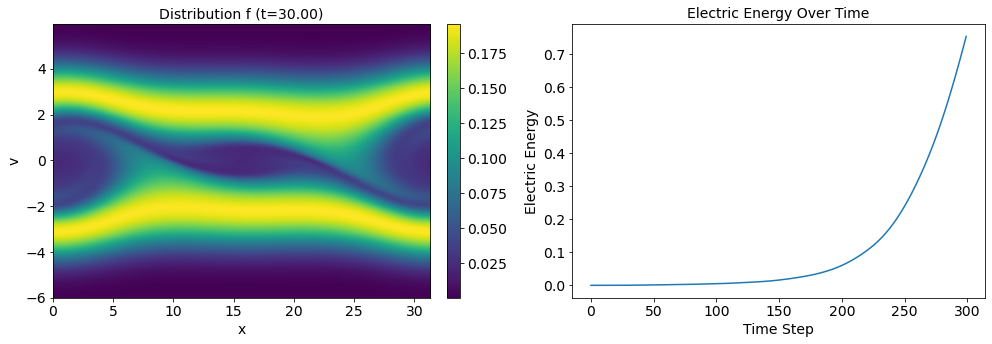

(256, 256)
Iteration 99, Cost: 0.5359920263290405, Coefficients: [-5.1324378e-04  2.0120882e-05 -3.8178242e-04 -1.9180283e-04
 -3.6061177e-04 -2.3033116e-04 -1.6890936e-04 -1.9005708e-04
  3.3903976e-05 -9.1458394e-05  6.5139262e-05 -8.9470035e-05
 -2.3456581e-05 -1.0094171e-04 -4.2189273e-05 -1.2261600e-03
 -2.3375708e-03 -9.6666552e-03 -7.8289229e-03 -5.3908043e-03
 -2.7344297e-03 -6.3513574e-04  2.8829923e-04  9.0517564e-04
  5.8629143e-04  3.4617676e-04  9.0383284e-05  9.6749303e-05
  1.1394371e-04  1.1427382e-04]


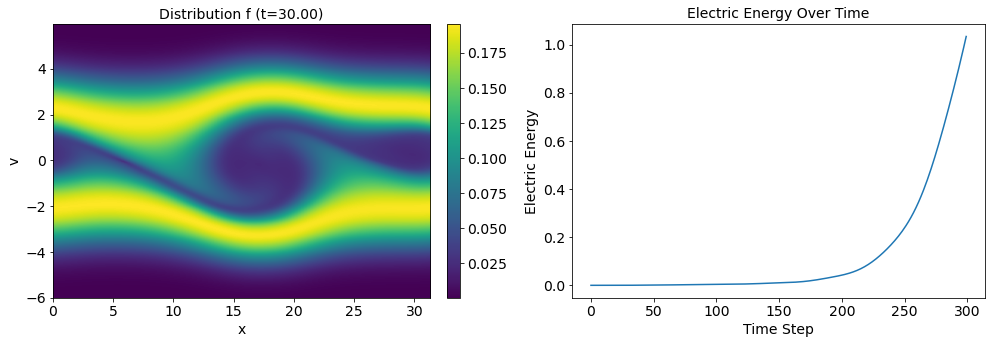

(256, 256)
Iteration 100, Cost: 0.3649110198020935, Coefficients: [ 9.5499912e-05  9.0959482e-05 -4.5376210e-04 -2.1540167e-04
 -3.7724429e-04 -2.2722059e-04 -1.8458115e-04 -2.0448852e-04
  1.1364096e-05 -1.0412729e-04  4.3856337e-05 -1.0797689e-04
 -4.0131086e-05 -1.1925063e-04 -5.7940731e-05 -4.4992846e-03
 -3.6554988e-03 -9.9436929e-03 -7.9176230e-03 -5.4327096e-03
 -2.7547379e-03 -6.3138432e-04  2.9935787e-04  9.1100781e-04
  5.8676110e-04  3.3905436e-04  9.1647205e-05  9.6005293e-05
  1.1900146e-04  1.2633768e-04]


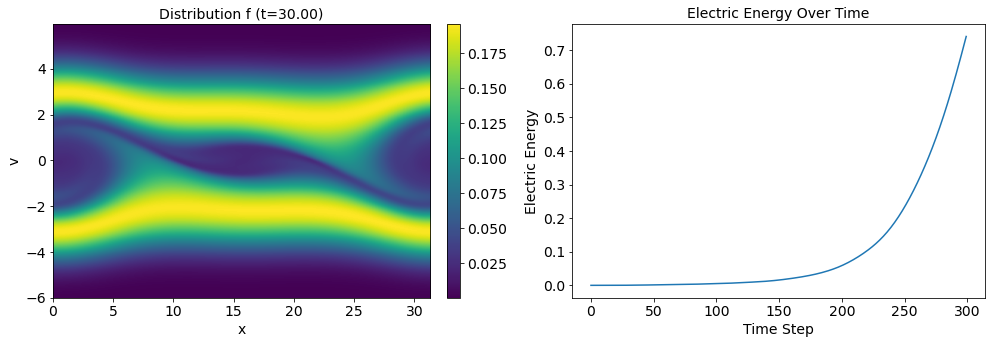

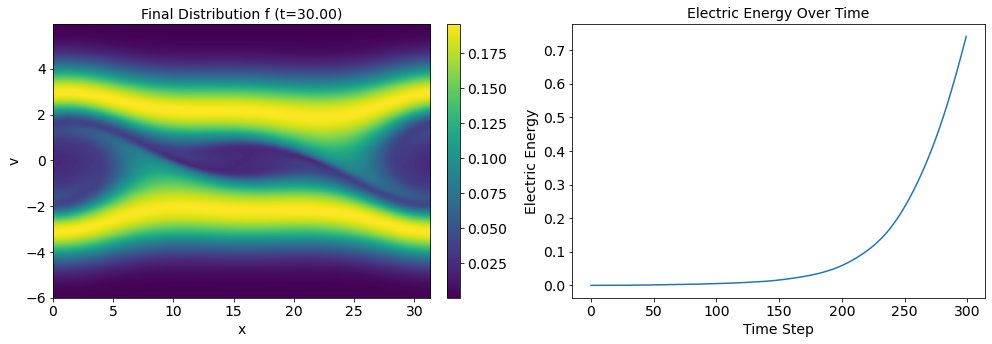

Best Loss: 0.12092819809913635
Optimal Coefficients: [ 3.5164488e-04  9.0411077e-06 -3.1953386e-05 -6.0834586e-06
  5.8570990e-06  6.0852408e-06 -2.7067827e-06 -8.1664248e-06
 -8.8577590e-06 -9.7180082e-06 -9.5229143e-06 -9.5641644e-06
 -8.8652696e-06 -8.6681093e-06 -7.7312543e-06 -9.6406386e-04
 -5.9252861e-04  2.9924628e-05  4.2226049e-05  5.3339943e-05
  3.5979556e-05  2.5546415e-05  1.0124806e-05  6.6790512e-06
  1.3618927e-06  3.0158180e-06  7.7909431e-07  3.0062322e-06
  1.2950333e-06  3.2279252e-06]


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import jax.numpy as jnp

# Initialize cost function and initial parameters
def J(f, f_eq, hx, hv):
    return jnp.sum((f[-1] - f_eq) ** 2) * hx * hv

# Function to plot the initial distribution of f_eq over x and v
def plot_feq_distribution(ax, f_eq, title):
    im = ax.imshow(f_eq.T, extent=[solver.mesh.xs[0], solver.mesh.xs[-1], solver.mesh.vs[0], solver.mesh.vs[-1]], 
                   aspect='auto', cmap='viridis')
    ax.set_title(title)
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

# Function to plot the distribution of f at a specific time
def plot_distribution(ax, data, title, time):
    im = ax.imshow(data.T, extent=[solver.mesh.xs[0], solver.mesh.xs[-1], solver.mesh.vs[0], solver.mesh.vs[-1]], 
                   aspect='auto', cmap='viridis')
    ax.set_title(f'{title} (t={time:.2f})')
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

solver = VlasovPoissonSolver(mesh=mesh, dt=dt, f_eq=jnp.array(f_eq))

# Define cosine and sine basis functions (15 cosine and 15 sine)
basis_functions = [
    jnp.cos(k * solver.mesh.xs / solver.mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
] + [
    jnp.sin(k * solver.mesh.xs / solver.mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
]

# Initialize coefficients for each basis function
a = jnp.zeros(len(basis_functions))
a = a + 0.0
max_iter = 100
hist_J = []

# Tracking best cost and optimal coefficients
best_cost = float('inf')
optimal_a = a

# Fixed learning rate
gamma = 0.0000001

# Plot the initial distribution
fig, ax = plt.subplots()
plot_feq_distribution(ax, solver.f_eq, "Initial Distribution f_eq")
plt.show()

# Optimization loop
for i in range(max_iter):
    # Define H based on the current coefficients `a`
    H = sum(a_k * basis for a_k, basis in zip(a, basis_functions))

    # Run forward pass and calculate cost
    cost, gradient, f_array, ee_array = solver.calc_cost_gradient(H, jnp.array(f_iv), t_final)
    hist_J.append(cost)
    print(f"Iteration {i+1}, Cost: {cost}, Coefficients: {a}")

    # Check if the current cost is the best and update if so
    if cost < best_cost:
        best_cost = cost
        optimal_a = a

    # Plot the 2D distribution of f_array at the current iteration
    fig, ax = plt.subplots(1, 2, figsize=(14, 5))
    plot_distribution(ax[0], f_array[-1], "Distribution f", t_final)  # Select the last time step from f_array

    # Plot electric energy over time
    ax[1].plot(ee_array)
    ax[1].set_title("Electric Energy Over Time")
    ax[1].set_xlabel("Time Step")
    ax[1].set_ylabel("Electric Energy")

    plt.tight_layout()
    plt.show()

    # Project the gradient onto each basis function to update coefficients
    a_grad = jnp.array([jnp.dot(basis, gradient) for basis in basis_functions])

    # Update coefficients with fixed learning rate
    a -= gamma * a_grad

# Final plot of results
fig, ax = plt.subplots(1, 2, figsize=(14, 5))

# Plot final 2D distribution of f
plot_distribution(ax[0], f_array[-1], "Final Distribution f", t_final)  # Select the last time step from f_array

# Plot history of electric energy over time
ax[1].plot(ee_array)
ax[1].set_title("Electric Energy Over Time")
ax[1].set_xlabel("Time Step")
ax[1].set_ylabel("Electric Energy")

plt.tight_layout()
plt.show()

# Print the best loss and optimal coefficients
print(f"Best Loss: {best_cost}")
print(f"Optimal Coefficients: {optimal_a}")


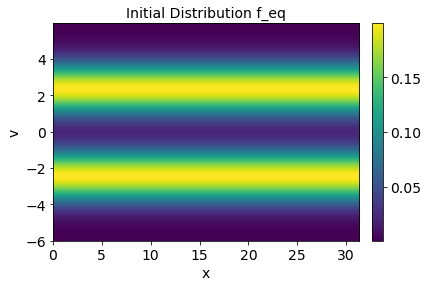

Iteration 1, Cost (KL Divergence): 3.45526123046875, Coefficients: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]


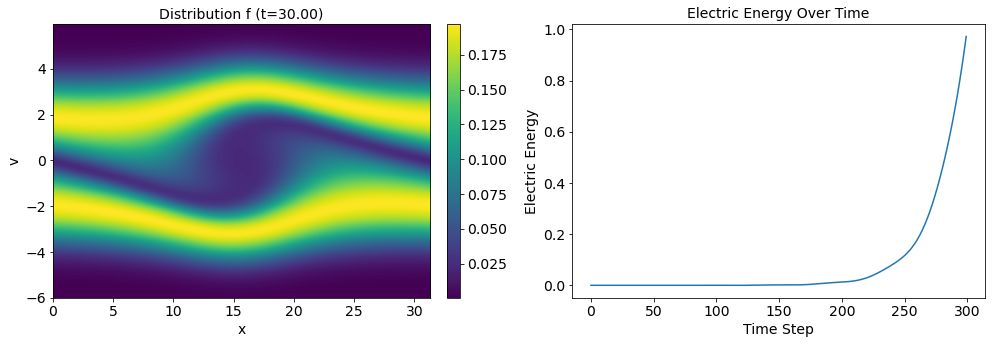

Iteration 2, Cost (KL Divergence): 2.5920603275299072, Coefficients: [ 1.7310100e-04 -4.4208232e-06 -2.0282141e-05 -1.8836087e-06
  3.7935706e-06  3.8299358e-06  1.2641662e-07 -3.7412915e-06
 -3.4395996e-06 -4.6690989e-06 -3.9138090e-06 -4.6460800e-06
 -3.5680468e-06 -4.1929393e-06 -2.9462035e-06 -2.6290119e-03
 -1.2772332e-03 -8.2098486e-05 -2.1026035e-05  1.7263605e-05
  1.0783530e-05  1.8010305e-05  7.3451401e-06  1.1167571e-05
  4.4904759e-06  9.1767288e-06  4.8761799e-06  8.8674060e-06
  4.9855980e-06  8.4965986e-06]


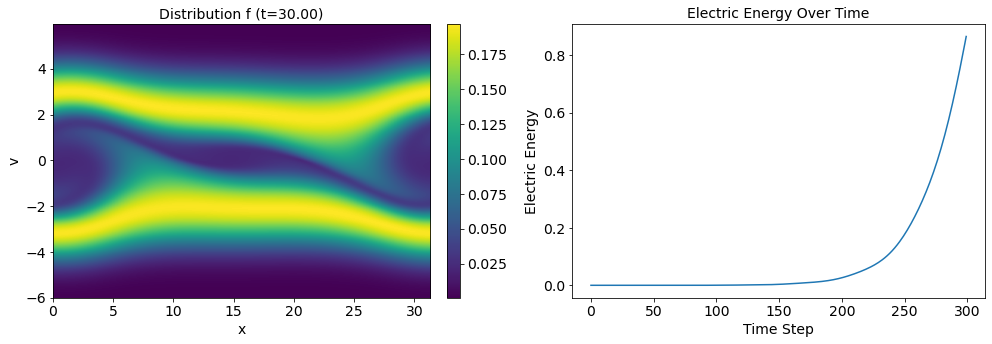

Iteration 3, Cost (KL Divergence): 7.083657264709473, Coefficients: [-3.80765385e-04  9.24927954e-05  5.61022316e-05  2.39824021e-05
  6.19937236e-06  9.34440504e-06  1.63951099e-05  2.12024679e-05
  1.67506496e-05  1.89807033e-05  1.47112769e-05  1.68521692e-05
  1.24485241e-05  1.48229592e-05  1.04848705e-05  9.49922716e-04
  3.42864427e-04 -1.80805699e-04 -1.00412479e-04 -7.09509841e-05
 -2.27267956e-05 -1.56516107e-05  1.00072666e-05  1.21824996e-06
  1.15694529e-05  1.43050420e-06  8.14883424e-06 -1.38068026e-06
  4.42995361e-06 -1.42975659e-06]


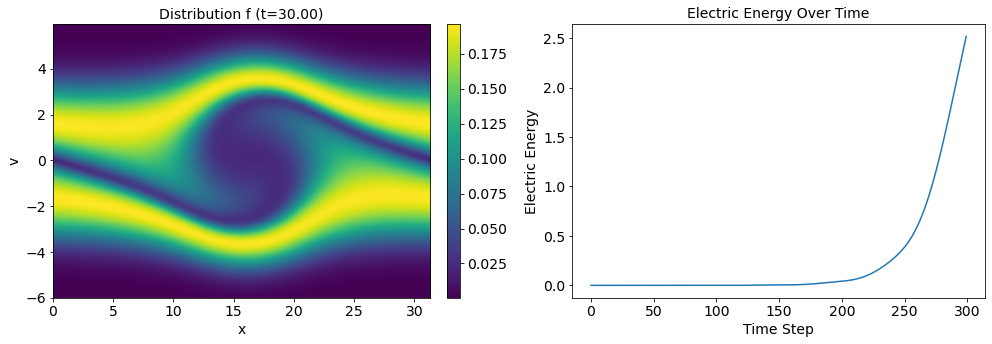

Iteration 4, Cost (KL Divergence): 5.961552619934082, Coefficients: [-5.2554620e-04 -8.9933026e-05 -2.9544462e-06  9.8778137e-06
 -2.7435583e-05  2.5565987e-07 -1.3637595e-05  1.7966837e-05
 -1.3092922e-06  2.0858017e-05  4.6155910e-06  2.0784024e-05
  6.3587022e-06  1.9994312e-05  6.8604954e-06 -5.9586922e-03
 -2.4043466e-03 -4.9208896e-04 -2.2809925e-04 -1.3438670e-04
 -6.1682003e-05 -3.2521664e-05  1.3093663e-05  8.0934160e-06
  3.1600328e-05  1.7891432e-05  3.2133106e-05  1.6068143e-05
  2.9146398e-05  1.6162177e-05]


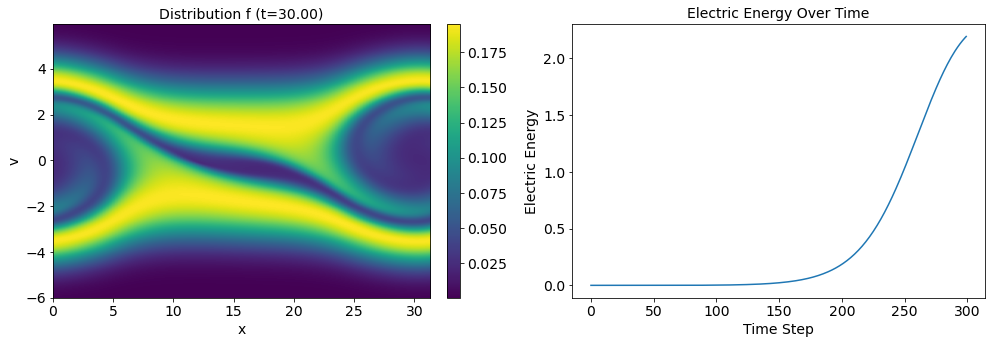

Iteration 5, Cost (KL Divergence): 3.099208116531372, Coefficients: [-6.3993299e-04 -7.7326913e-06  4.5874720e-05  1.5394209e-05
  1.3359204e-06  1.8834870e-06  8.7417011e-06  2.9860144e-05
  1.8543176e-05  2.4500350e-05  2.1673597e-05  2.6693751e-05
  1.7493450e-05  2.4572637e-05  1.7319568e-05 -2.3304166e-03
 -1.2325918e-03 -4.8196537e-04 -1.5999902e-04 -5.6176177e-05
 -6.2207328e-06 -4.1072781e-08  5.0133855e-05  1.9161591e-05
  3.3175096e-05  1.9533023e-05  3.0561034e-05  1.1556541e-05
  2.0996351e-05  1.4037089e-05]


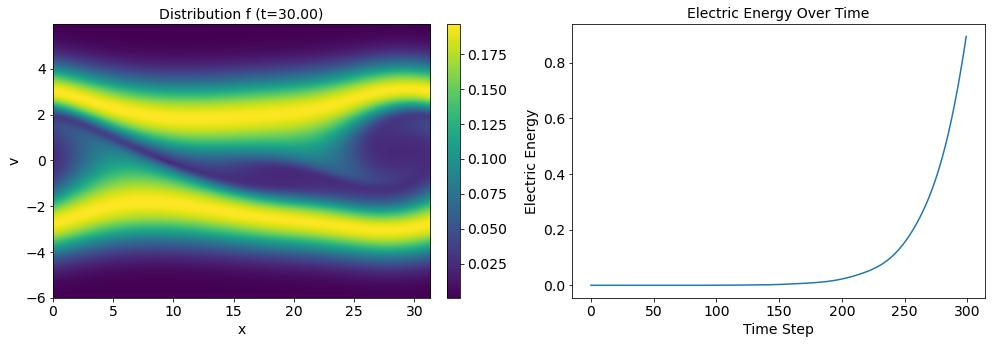

Iteration 6, Cost (KL Divergence): 5.227422714233398, Coefficients: [-7.9501135e-04 -2.9481263e-04  1.0320324e-05 -4.0148250e-05
 -2.8909049e-05 -4.4928085e-05 -2.2368635e-05  5.3172334e-07
  4.2608208e-06  6.6082212e-06  1.2147675e-05  1.3913152e-05
  1.0016816e-05  1.5926382e-05  1.1972517e-05  1.2453273e-04
 -9.9836383e-05 -5.0337543e-04 -2.0384288e-04 -1.0096432e-04
 -3.0945601e-05 -9.7711445e-06  4.7224468e-05  2.4115969e-05
  3.2747146e-05  2.3831888e-05  2.8711116e-05  1.4617238e-05
  1.7327797e-05  1.4997705e-05]


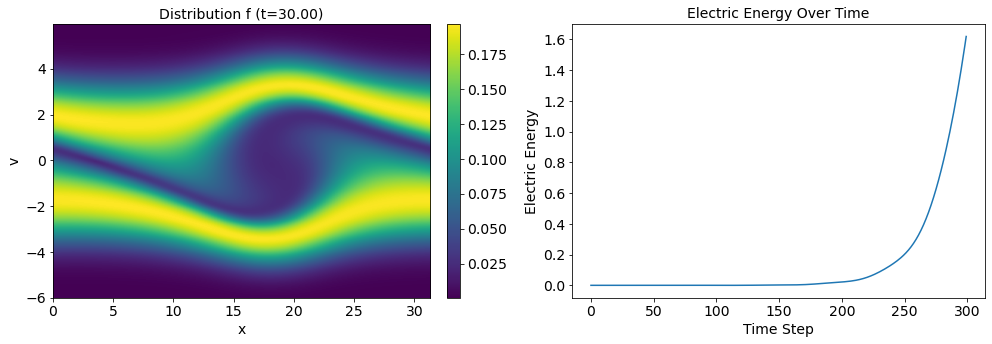

Iteration 7, Cost (KL Divergence): 4.550189018249512, Coefficients: [-2.6244432e-04 -4.3502927e-04 -9.7010226e-05 -7.2350740e-05
 -4.9911825e-05 -5.5254684e-05 -5.2960255e-05 -2.4866658e-05
 -2.3820092e-05 -1.5182914e-05 -1.1825396e-05 -5.2424166e-06
 -9.4891620e-06 -1.3645604e-06 -3.1664031e-06 -4.5022964e-03
 -2.2077607e-03 -7.5492065e-04 -3.0904589e-04 -1.4540376e-04
 -4.9610368e-05 -1.4234085e-05  5.5541517e-05  3.0699593e-05
  4.7234025e-05  3.5179422e-05  4.7577221e-05  2.5621726e-05
  3.5286095e-05  2.7321752e-05]


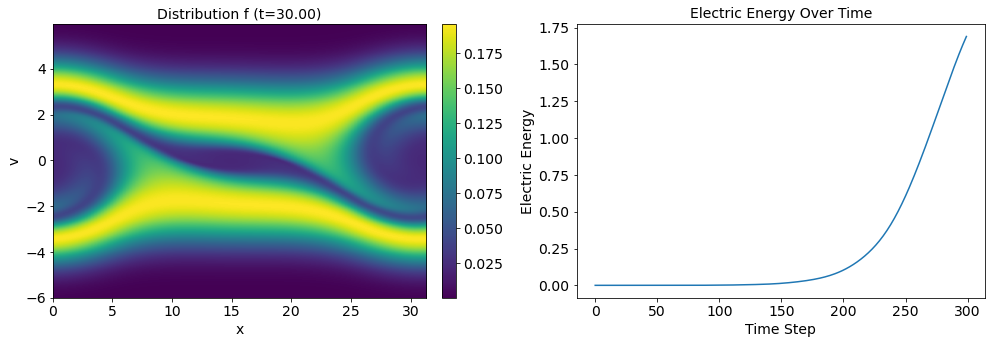

Iteration 8, Cost (KL Divergence): 2.8621506690979004, Coefficients: [-5.79749816e-04 -1.61569391e-04 -2.77750223e-05 -2.34216204e-05
 -2.17654233e-05 -1.24457292e-05 -1.80917050e-05  1.58263647e-05
  8.82638415e-06  1.65791262e-05  9.09098526e-06  2.17269298e-05
  9.10864765e-06  1.69256837e-05  8.77920229e-06 -3.61212529e-04
 -9.71835805e-04 -8.63104535e-04 -3.56985460e-04 -1.42537610e-04
 -1.00479265e-05  1.19153701e-05  8.36249965e-05  4.72807551e-05
  5.56825398e-05  3.48635040e-05  4.50540101e-05  1.85756035e-05
  2.79343276e-05  1.56912647e-05]


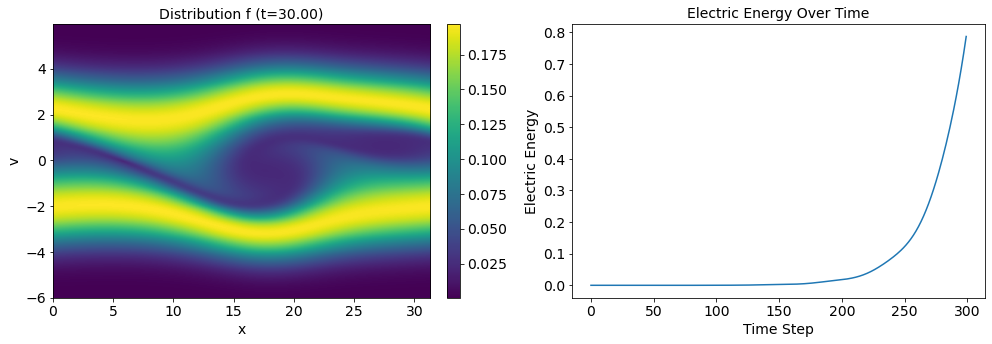

Iteration 9, Cost (KL Divergence): 1.6315646171569824, Coefficients: [ 6.2933832e-05 -4.1465831e-04 -1.6278363e-04 -9.0235051e-05
 -5.9198985e-05 -4.2175885e-05 -6.8324123e-05 -2.7567472e-05
 -3.5829562e-05 -1.9437002e-05 -3.0227220e-05 -9.2859991e-06
 -2.2897824e-05 -8.8258257e-06 -1.6644401e-05 -2.3525495e-03
 -2.0046155e-03 -9.7596075e-04 -4.0383276e-04 -1.5183508e-04
 -1.1110236e-05  1.9834639e-05  9.3735005e-05  5.6998600e-05
  6.6558227e-05  4.3528547e-05  5.6031087e-05  2.5901054e-05
  3.8212394e-05  2.2344575e-05]


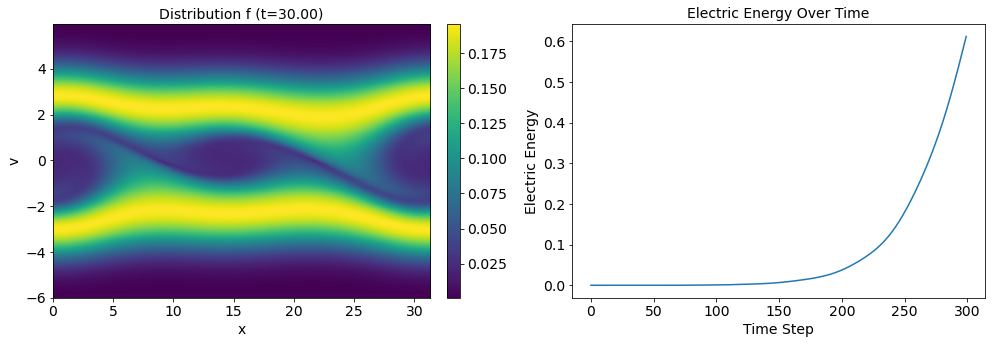

Iteration 10, Cost (KL Divergence): 7.379421234130859, Coefficients: [-4.2121686e-04 -3.8819897e-04 -1.1447328e-04 -7.6972421e-05
 -7.2105118e-05 -4.1982228e-05 -6.9023117e-05 -1.0873755e-05
 -2.6727570e-05  1.8295086e-06 -1.7756644e-05  7.9367783e-06
 -1.2581981e-05  6.4940814e-06 -8.6557920e-06  1.1840935e-03
  8.2255108e-05 -8.7633409e-04 -4.1267677e-04 -2.1965237e-04
 -5.9002668e-05 -2.1676919e-05  7.3450487e-05  4.7078509e-05
  6.2652471e-05  3.8373073e-05  4.7932452e-05  1.9365309e-05
  2.8093478e-05  1.4870064e-05]


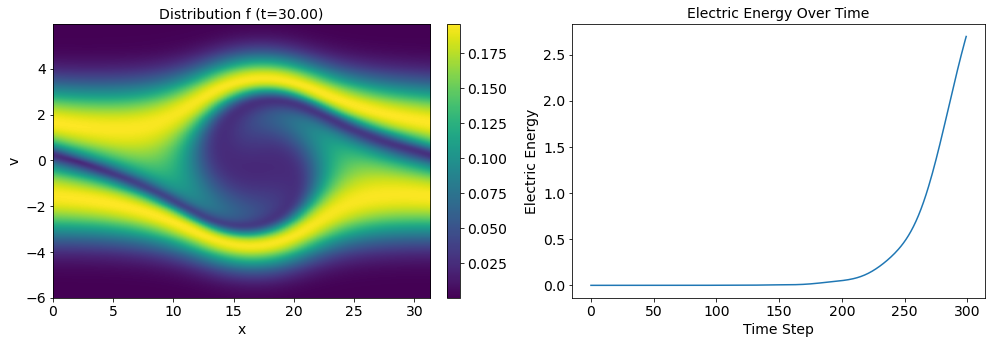

Iteration 11, Cost (KL Divergence): 5.042369365692139, Coefficients: [-4.54162131e-04 -6.24994165e-04 -1.86874357e-04 -1.13926988e-04
 -1.09635504e-04 -6.97505457e-05 -1.03380895e-04 -2.97249699e-05
 -4.71800777e-05 -8.25111783e-06 -3.26531990e-05  4.03834747e-06
 -2.27043001e-05  4.82395444e-06 -1.52189168e-05 -5.12938760e-03
 -2.37421575e-03 -1.17785227e-03 -5.46376978e-04 -2.98138300e-04
 -1.09996879e-04 -5.14529711e-05  6.65645130e-05  4.63770630e-05
  7.53456261e-05  5.06435281e-05  6.78766373e-05  3.52578645e-05
  4.85026467e-05  3.15355901e-05]


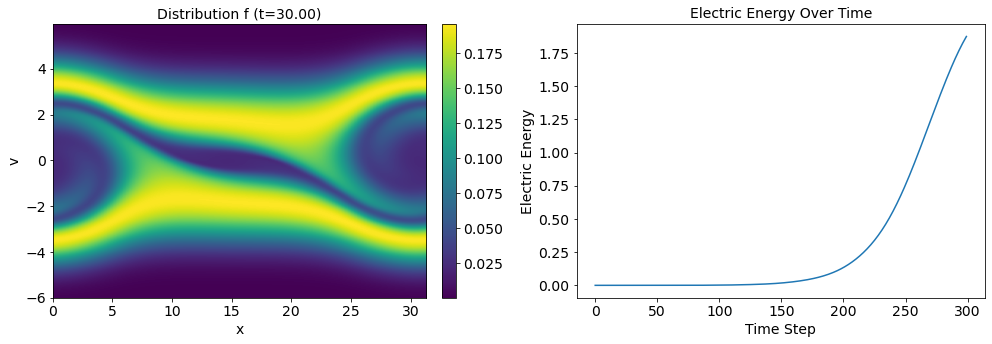

Iteration 12, Cost (KL Divergence): 2.7206263542175293, Coefficients: [-7.3192944e-04 -4.0807558e-04 -1.2962476e-04 -8.9855712e-05
 -7.6027733e-05 -3.9868595e-05 -7.2062910e-05 -8.5022184e-06
 -1.0300504e-05  8.7082226e-06 -8.2122242e-06  1.7106417e-05
 -1.0705116e-06  1.3394560e-05  7.2823241e-07 -1.0618246e-03
 -1.1889709e-03 -1.2074186e-03 -5.5504305e-04 -2.5545232e-04
 -5.4742846e-05 -8.5387910e-06  9.2272334e-05  6.5361761e-05
  7.8876779e-05  5.6466029e-05  5.7185018e-05  3.0283712e-05
  3.7113023e-05  2.5117954e-05]


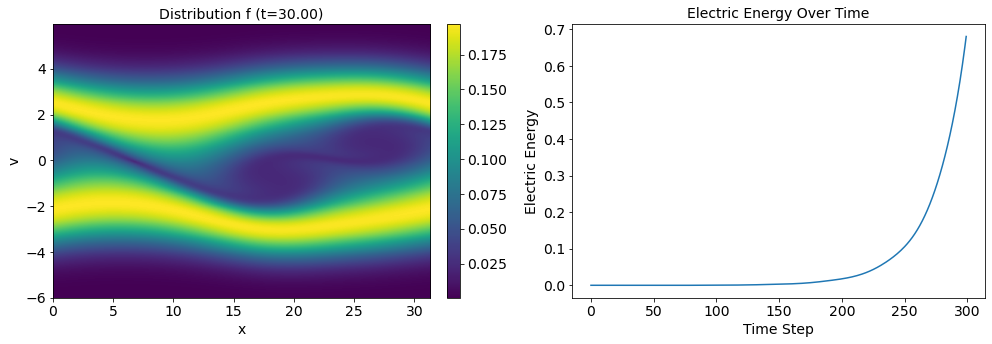

Iteration 13, Cost (KL Divergence): 0.9617255330085754, Coefficients: [-2.4012156e-04 -8.0238911e-04 -2.6945458e-04 -1.8072431e-04
 -1.2685658e-04 -9.1386777e-05 -1.3504943e-04 -6.4513253e-05
 -6.0036553e-05 -3.5465098e-05 -4.9200687e-05 -1.7787690e-05
 -3.2486194e-05 -1.3187422e-05 -2.3041157e-05 -1.5840281e-03
 -1.5420401e-03 -1.2472988e-03 -5.6873943e-04 -2.5144772e-04
 -4.6160527e-05  2.5172712e-06  1.0328555e-04  7.3972966e-05
  8.6921311e-05  6.2930179e-05  6.3683408e-05  3.5710113e-05
  4.3315275e-05  3.0659179e-05]


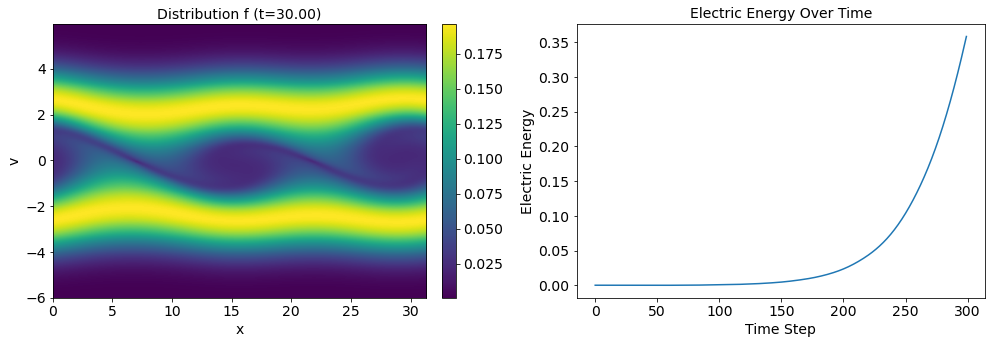

Iteration 14, Cost (KL Divergence): 7.560723781585693, Coefficients: [-3.4520481e-04 -7.9095218e-04 -2.6646943e-04 -1.8675625e-04
 -1.4035651e-04 -9.1277092e-05 -1.4115860e-04 -6.4306041e-05
 -6.3424799e-05 -3.3074135e-05 -4.8891652e-05 -1.5823709e-05
 -3.2066677e-05 -1.1368205e-05 -2.3113129e-05  1.0012521e-03
  1.5498814e-04 -1.0322572e-03 -4.8777476e-04 -2.5602666e-04
 -7.0729235e-05 -2.9619783e-05  7.6129480e-05  5.6811637e-05
  7.4793497e-05  5.4236836e-05  5.7519475e-05  2.8876460e-05
  3.4785418e-05  2.1133008e-05]


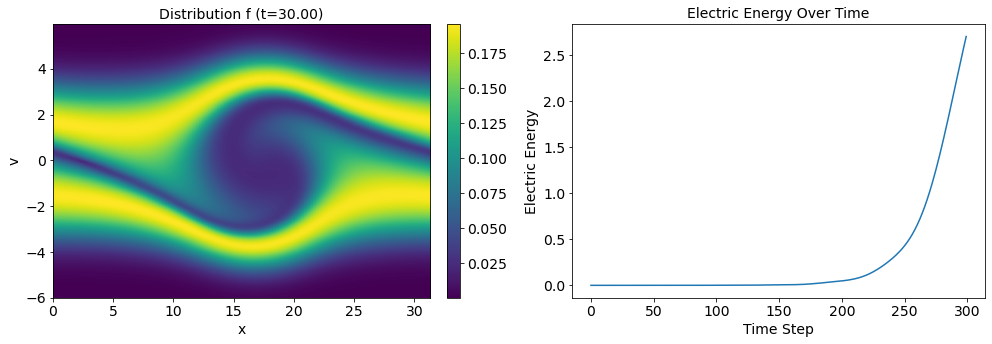

Iteration 15, Cost (KL Divergence): 5.602888584136963, Coefficients: [-3.30167037e-04 -1.00380392e-03 -3.10635078e-04 -2.22082483e-04
 -1.51679196e-04 -1.17150332e-04 -1.52534558e-04 -8.25549141e-05
 -6.67178101e-05 -4.33015593e-05 -5.08376907e-05 -2.26235006e-05
 -3.12210432e-05 -1.75820041e-05 -2.08038218e-05 -5.41874580e-03
 -2.35309126e-03 -1.35879172e-03 -6.33798481e-04 -3.40889848e-04
 -1.20368335e-04 -5.73650323e-05  7.09179440e-05  6.18975464e-05
  9.00302766e-05  7.31764449e-05  7.80687624e-05  4.87783145e-05
  5.39227840e-05  3.95965144e-05]


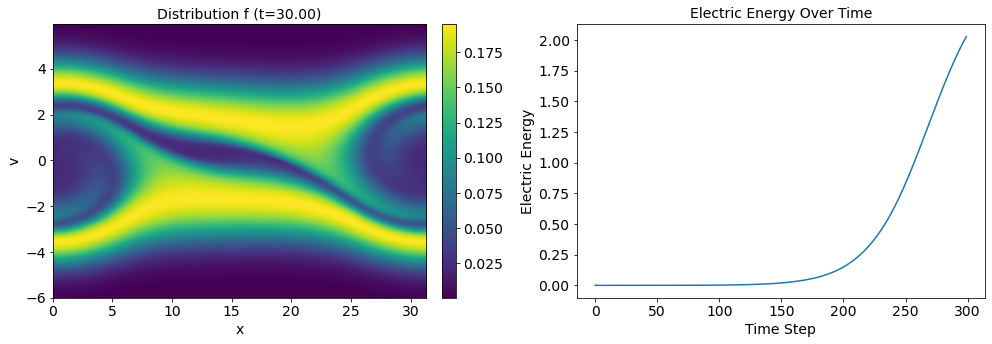

Iteration 16, Cost (KL Divergence): 1.4512121677398682, Coefficients: [-4.99662594e-04 -6.47394452e-04 -2.69119686e-04 -1.82645905e-04
 -1.11588066e-04 -6.62215389e-05 -1.14639755e-04 -5.27423617e-05
 -3.60766644e-05 -1.94756685e-05 -2.27511282e-05 -8.47260708e-06
 -1.87719088e-05 -2.14281317e-06 -7.59095565e-06 -1.47210760e-03
 -1.17778115e-03 -1.32898451e-03 -6.17937359e-04 -2.88900512e-04
 -7.55032961e-05 -7.92492938e-06  9.47504450e-05  6.81600068e-05
  9.31163158e-05  7.12054389e-05  7.07677682e-05  3.97618023e-05
  4.25868602e-05  2.55167870e-05]


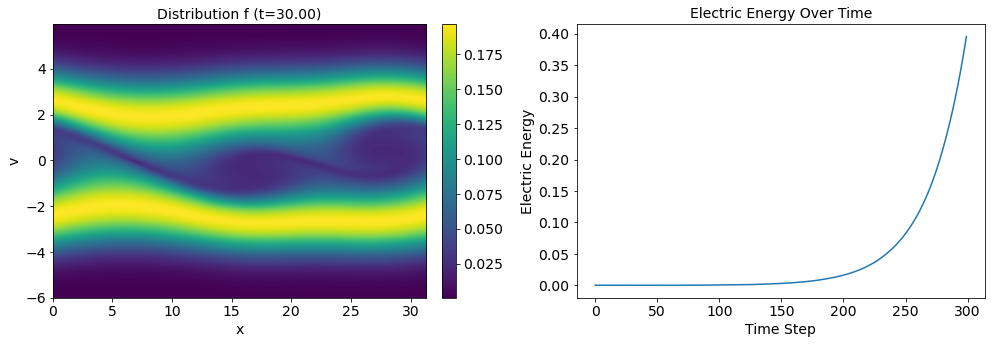

Iteration 17, Cost (KL Divergence): 5.0188307762146, Coefficients: [-3.39594844e-04 -8.20757181e-04 -3.25336325e-04 -2.29519937e-04
 -1.38620409e-04 -9.20226084e-05 -1.42320816e-04 -7.80027185e-05
 -5.76870225e-05 -3.91758658e-05 -3.91643553e-05 -2.38349148e-05
 -3.17106169e-05 -1.44387905e-05 -1.69887135e-05  1.64977973e-04
 -2.21420079e-04 -1.20019191e-03 -5.63347014e-04 -2.81307992e-04
 -8.08805271e-05 -1.89233942e-05  8.53722595e-05  6.08024930e-05
  8.82274835e-05  6.77323114e-05  6.84442493e-05  3.78386867e-05
  4.00533427e-05  2.23326861e-05]


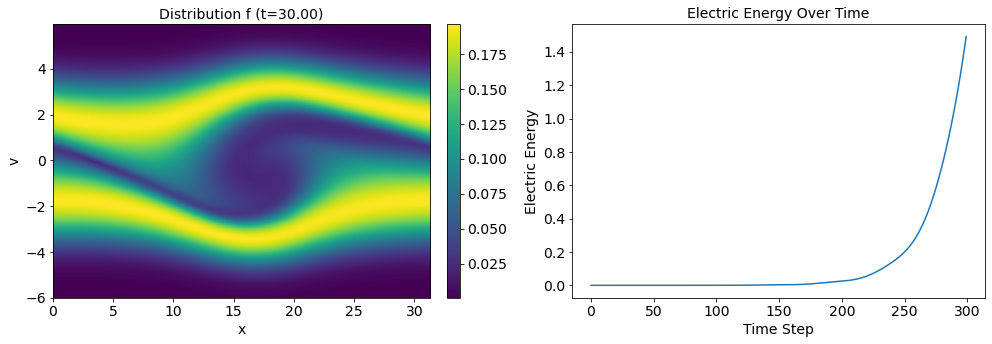

Iteration 18, Cost (KL Divergence): 4.5513458251953125, Coefficients: [ 1.24793820e-04 -9.58047749e-04 -3.98787553e-04 -2.68168340e-04
 -1.41400727e-04 -1.06271735e-04 -1.58357318e-04 -1.04549377e-04
 -7.32500557e-05 -6.04827947e-05 -5.45376461e-05 -4.38483694e-05
 -4.47632010e-05 -3.08440940e-05 -2.58158743e-05 -3.87303182e-03
 -2.11528130e-03 -1.46720803e-03 -6.79591554e-04 -3.27426416e-04
 -9.55916039e-05 -1.54243226e-05  9.75563235e-05  7.54051798e-05
  1.05753519e-04  8.49342396e-05  8.49720236e-05  5.23709423e-05
  5.41105801e-05  3.56409473e-05]


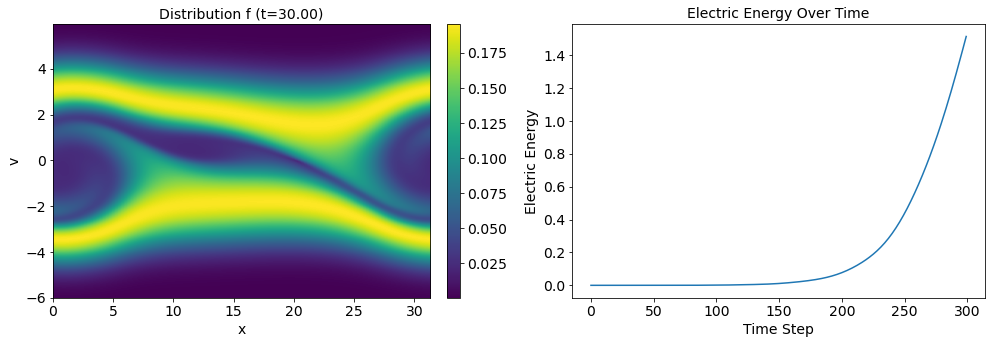

Iteration 19, Cost (KL Divergence): 3.7976250648498535, Coefficients: [-2.60463363e-04 -4.72775719e-04 -2.87219707e-04 -1.93043612e-04
 -1.10121226e-04 -4.14483293e-05 -9.19751183e-05 -4.68411345e-05
 -2.76940991e-05 -1.91500621e-05 -1.68443912e-05 -1.34269139e-05
 -1.67015733e-05 -6.40594044e-06 -3.73790135e-06  1.01056183e-04
 -6.70725014e-04 -1.50265568e-03 -7.54290435e-04 -3.65495158e-04
 -1.10546607e-04 -1.63563345e-06  1.05421022e-04  8.40770808e-05
  1.05508007e-04  8.15123713e-05  7.96336171e-05  4.40413787e-05
  4.41152006e-05  2.28637309e-05]


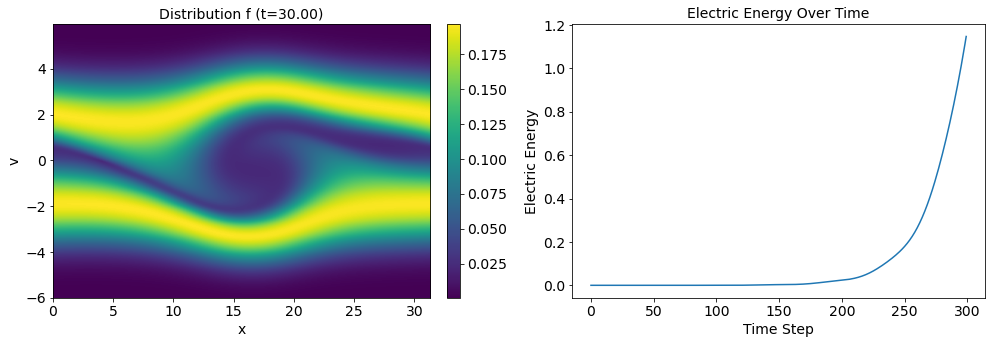

Iteration 20, Cost (KL Divergence): 3.012152910232544, Coefficients: [ 1.13278773e-04 -5.84718364e-04 -3.58355755e-04 -2.27896089e-04
 -1.22621452e-04 -5.45311850e-05 -1.13385075e-04 -7.19599047e-05
 -4.83105541e-05 -3.94531526e-05 -3.53887044e-05 -3.06315196e-05
 -3.29539434e-05 -1.93075284e-05 -1.57565810e-05 -3.31474748e-03
 -2.26228847e-03 -1.72649883e-03 -8.55286489e-04 -4.05652449e-04
 -1.24904953e-04 -1.36937638e-06  1.13170259e-04  9.43658524e-05
  1.18786549e-04  9.44222920e-05  9.26253488e-05  5.53669961e-05
  5.56855812e-05  3.39436010e-05]


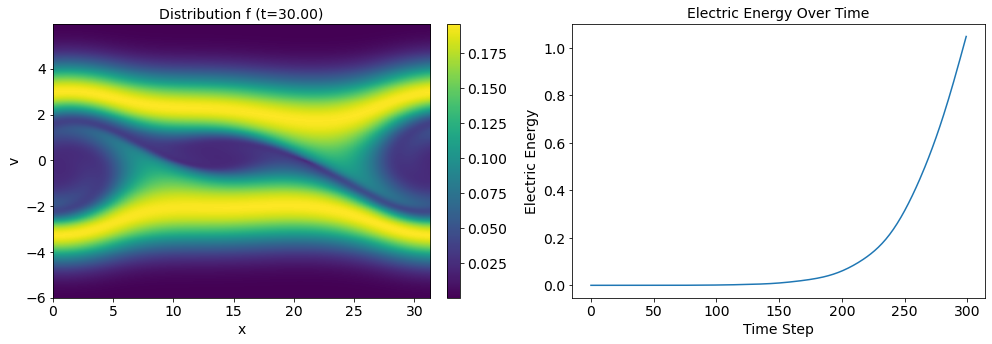

Iteration 21, Cost (KL Divergence): 5.664468288421631, Coefficients: [-4.3151263e-04 -2.9291425e-04 -2.5126419e-04 -1.6706722e-04
 -1.1499598e-04 -1.8726980e-05 -7.2177005e-05 -2.2376440e-05
 -1.5256217e-05  9.9192039e-07 -4.3661239e-06 -1.2500132e-06
 -1.0023739e-05  6.0153616e-06  6.1893734e-06  6.8438239e-04
 -4.6700472e-04 -1.7174141e-03 -9.2750276e-04 -4.8191473e-04
 -1.6532504e-04 -6.5647528e-06  1.0977850e-04  1.0206719e-04
  1.1371493e-04  9.5098148e-05  8.3844934e-05  5.2024337e-05
  4.4259195e-05  2.6660156e-05]


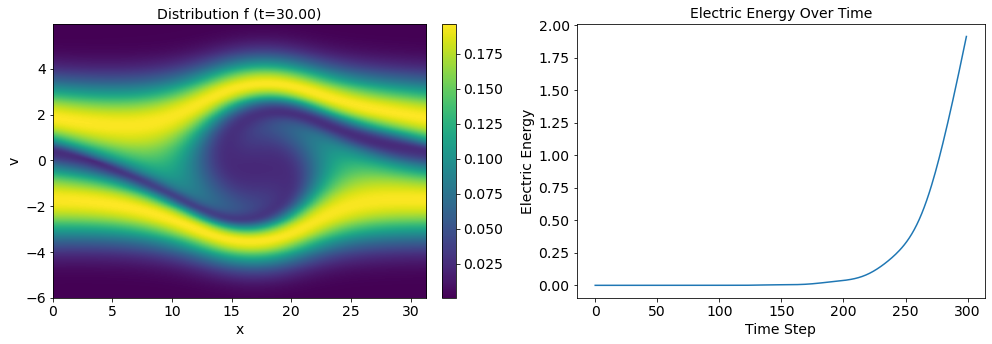

Iteration 22, Cost (KL Divergence): 4.349737167358398, Coefficients: [-3.39598977e-04 -4.21087258e-04 -3.30797571e-04 -1.90016290e-04
 -1.47789469e-04 -2.89909894e-05 -1.08341374e-04 -4.14050155e-05
 -4.36042028e-05 -1.18701892e-05 -2.60616362e-05 -1.18482430e-05
 -2.68897275e-05 -3.61296770e-09 -4.67682730e-06 -4.86057904e-03
 -2.74051074e-03 -2.06989376e-03 -1.09241786e-03 -5.76308346e-04
 -2.06872151e-04 -3.00400843e-05  1.12187219e-04  1.04983250e-04
  1.34194837e-04  1.07731015e-04  1.05036379e-04  6.37806588e-05
  6.22256994e-05  3.89475972e-05]


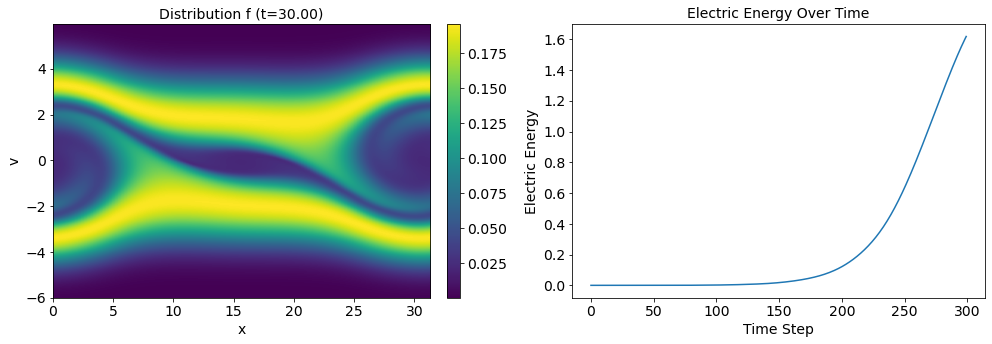

Iteration 23, Cost (KL Divergence): 2.9094581604003906, Coefficients: [-6.00886182e-04 -2.42446054e-04 -2.36484979e-04 -1.66800543e-04
 -1.21307705e-04 -1.51269633e-05 -5.46569972e-05 -1.34465045e-05
 -1.33961512e-05  3.37018628e-06  7.08729203e-06  7.58443548e-06
 -4.47529419e-06  1.03091352e-05  1.37120296e-05 -5.61013818e-04
 -1.42518419e-03 -2.06836662e-03 -1.14169426e-03 -5.74721198e-04
 -1.63983117e-04  2.90993648e-05  1.38113392e-04  1.23651786e-04
  1.40391887e-04  1.19443699e-04  9.82040583e-05  6.19862112e-05
  5.21501497e-05  3.42224412e-05]


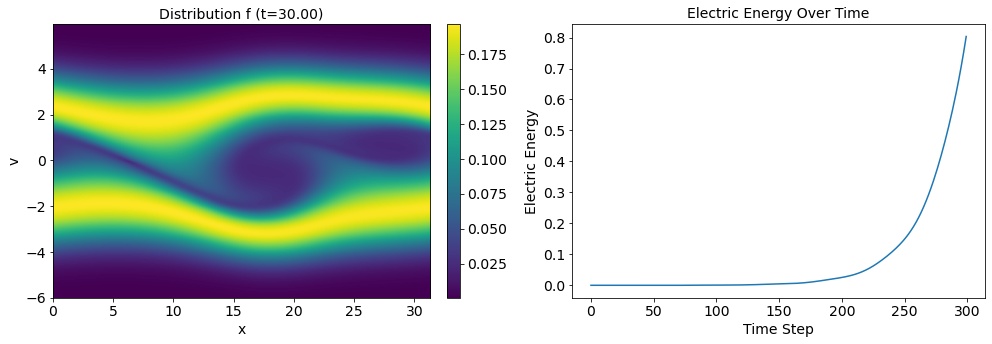

Iteration 24, Cost (KL Divergence): 1.3967723846435547, Coefficients: [-9.11817187e-06 -4.58688417e-04 -3.62937048e-04 -2.33199884e-04
 -1.59781455e-04 -3.95632815e-05 -1.01072146e-04 -5.63166977e-05
 -5.72694116e-05 -3.15054713e-05 -2.83429108e-05 -2.26402080e-05
 -3.45022163e-05 -1.40295051e-05 -8.00808812e-06 -2.37747282e-03
 -2.34301225e-03 -2.20134901e-03 -1.19756558e-03 -5.89567644e-04
 -1.61998076e-04  3.21720472e-05  1.47199840e-04  1.30414206e-04
  1.51016575e-04  1.25061692e-04  1.05905347e-04  6.75380434e-05
  6.21003783e-05  4.15726681e-05]


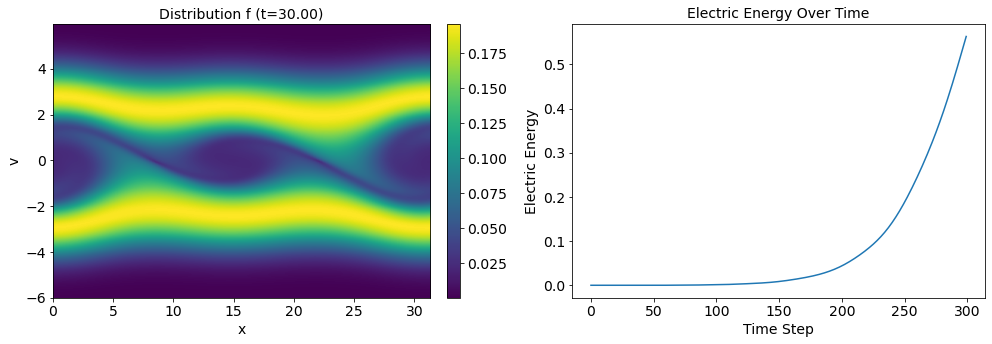

Iteration 25, Cost (KL Divergence): 7.283590793609619, Coefficients: [-3.84080369e-04 -5.16412198e-04 -3.31562886e-04 -2.34808918e-04
 -1.81237978e-04 -5.96999162e-05 -1.08243134e-04 -5.11766630e-05
 -5.37672058e-05 -2.55757786e-05 -1.92965599e-05 -1.29633008e-05
 -2.57435531e-05 -8.92357730e-06 -1.51867425e-06  1.26069365e-03
 -1.38292788e-04 -1.98255875e-03 -1.15072855e-03 -6.49431779e-04
 -2.12439627e-04 -2.67710129e-06  1.28295884e-04  1.19762786e-04
  1.47946004e-04  1.22118072e-04  9.77019372e-05  5.61606357e-05
  5.42892012e-05  3.38285427e-05]


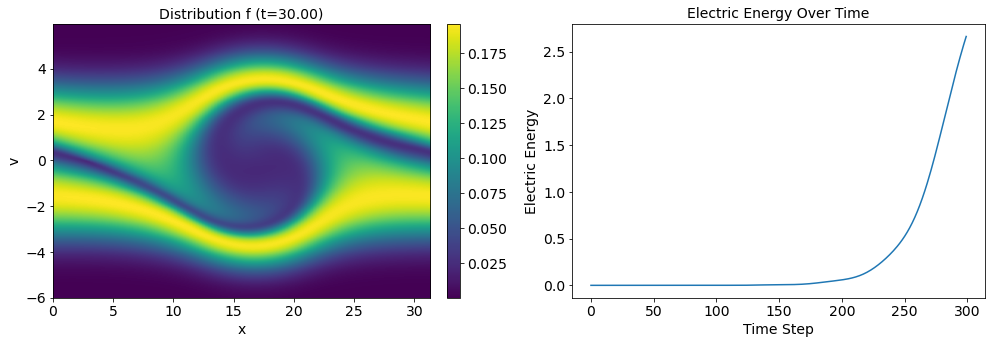

Iteration 26, Cost (KL Divergence): 4.648872375488281, Coefficients: [-3.5831577e-04 -6.9433381e-04 -4.0266517e-04 -2.6719170e-04
 -2.1631755e-04 -7.9535501e-05 -1.4166400e-04 -7.0851274e-05
 -8.1635706e-05 -4.3704575e-05 -3.9336614e-05 -2.2535940e-05
 -3.8392936e-05 -1.5655745e-05 -1.0525852e-05 -4.8129931e-03
 -2.4531763e-03 -2.3288156e-03 -1.3026976e-03 -7.4729114e-04
 -2.5190061e-04 -3.4044086e-05  1.3066796e-04  1.2172260e-04
  1.7063181e-04  1.3490306e-04  1.1671867e-04  6.9727561e-05
  7.4365671e-05  4.7443347e-05]


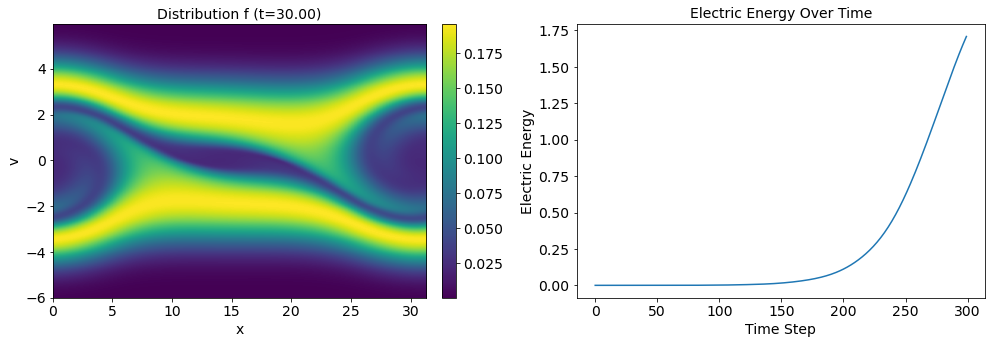

Iteration 27, Cost (KL Divergence): 3.792353630065918, Coefficients: [-6.5266748e-04 -4.5911936e-04 -3.1795559e-04 -2.3378441e-04
 -1.8911515e-04 -6.0765669e-05 -9.1249618e-05 -3.5727109e-05
 -4.4820437e-05 -2.2807426e-05 -1.3902607e-05 -3.2489697e-06
 -1.1793225e-05 -1.4210091e-06  8.5826932e-06 -4.1121384e-04
 -1.1815615e-03 -2.2936452e-03 -1.3456638e-03 -7.3031767e-04
 -2.2363094e-04  2.5347392e-05  1.5751303e-04  1.4749261e-04
  1.7086565e-04  1.4326235e-04  1.0503514e-04  7.1155424e-05
  6.0170602e-05  4.1063278e-05]


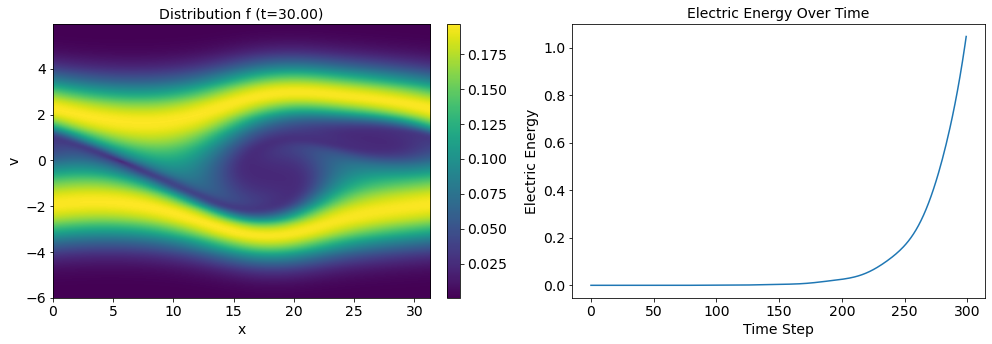

Iteration 28, Cost (KL Divergence): 1.9418730735778809, Coefficients: [-1.40427728e-05 -6.57764613e-04 -4.47617087e-04 -2.99158157e-04
 -2.28390098e-04 -8.22181901e-05 -1.35336624e-04 -7.77214154e-05
 -9.04021072e-05 -5.95659949e-05 -4.89507729e-05 -3.31652082e-05
 -4.25487560e-05 -2.71903591e-05 -1.48438203e-05 -2.89758947e-03
 -2.42973026e-03 -2.49398407e-03 -1.43085502e-03 -7.58392795e-04
 -2.19907699e-04  3.04229852e-05  1.70687097e-04  1.56140668e-04
  1.84968958e-04  1.50227890e-04  1.15362935e-04  7.82291172e-05
  7.25538048e-05  5.02542425e-05]


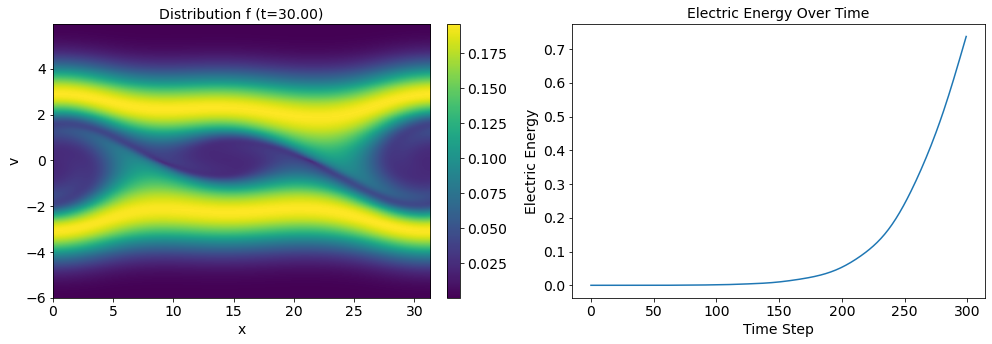

Iteration 29, Cost (KL Divergence): 7.225085735321045, Coefficients: [-5.2268727e-04 -5.4086663e-04 -3.7543091e-04 -2.6096369e-04
 -2.3167887e-04 -8.0560960e-05 -1.2140776e-04 -4.5842091e-05
 -6.5136621e-05 -3.4328448e-05 -2.9861549e-05 -1.0680433e-05
 -2.5526197e-05 -8.4886069e-06 -2.4228220e-06  1.1291541e-03
 -2.6865746e-04 -2.3449941e-03 -1.4393469e-03 -8.3832641e-04
 -2.8373470e-04  4.9089667e-06  1.5467146e-04  1.5481490e-04
  1.8282958e-04  1.4918788e-04  1.0324911e-04  6.9362468e-05
  6.0781080e-05  4.4593602e-05]


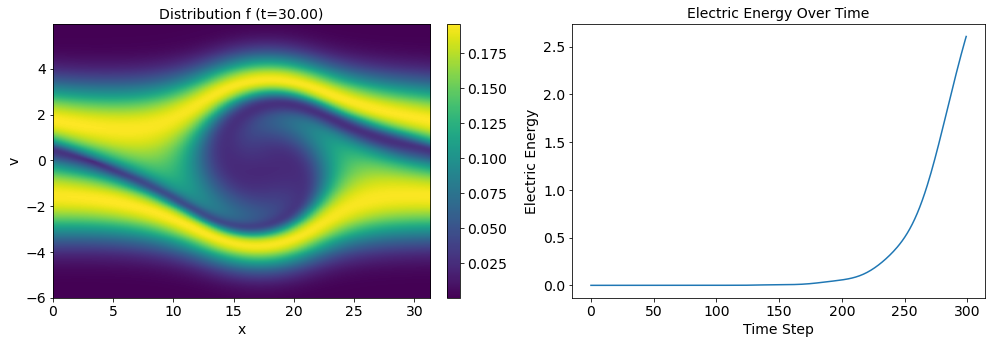

Iteration 30, Cost (KL Divergence): 4.530210971832275, Coefficients: [-4.72798100e-04 -7.29691354e-04 -4.57682239e-04 -2.97524326e-04
 -2.77380284e-04 -1.02083402e-04 -1.59018004e-04 -6.52517774e-05
 -9.96862509e-05 -5.47425443e-05 -5.59477412e-05 -2.04016724e-05
 -4.29896681e-05 -1.58765561e-05 -1.40963375e-05 -4.80743730e-03
 -2.52588582e-03 -2.70568859e-03 -1.59563927e-03 -9.39145975e-04
 -3.19120125e-04 -2.42343503e-05  1.59051197e-04  1.58486000e-04
  2.04045486e-04  1.58027004e-04  1.19899618e-04  7.91375642e-05
  8.18119224e-05  5.41591507e-05]


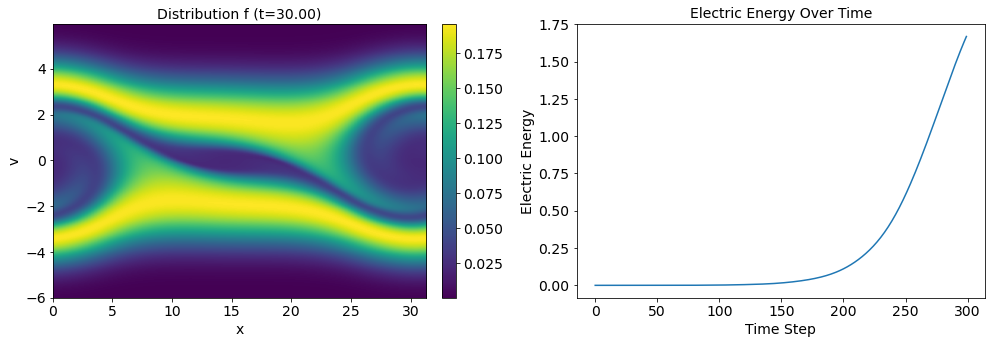

Iteration 31, Cost (KL Divergence): 4.969944953918457, Coefficients: [-7.80147500e-04 -5.77198109e-04 -3.76410899e-04 -2.74771242e-04
 -2.48071359e-04 -9.75861622e-05 -1.18563425e-04 -3.57446115e-05
 -6.24273889e-05 -3.58308789e-05 -3.34486758e-05 -2.89317722e-06
 -1.95236626e-05 -2.56976909e-06  1.75009245e-06 -2.66515184e-04
 -1.20955752e-03 -2.64438265e-03 -1.63585600e-03 -9.24884516e-04
 -2.97712744e-04  3.30641342e-05  1.87678714e-04  1.88195496e-04
  2.03873249e-04  1.67520397e-04  1.06567604e-04  7.80820046e-05
  7.05274870e-05  4.72306565e-05]


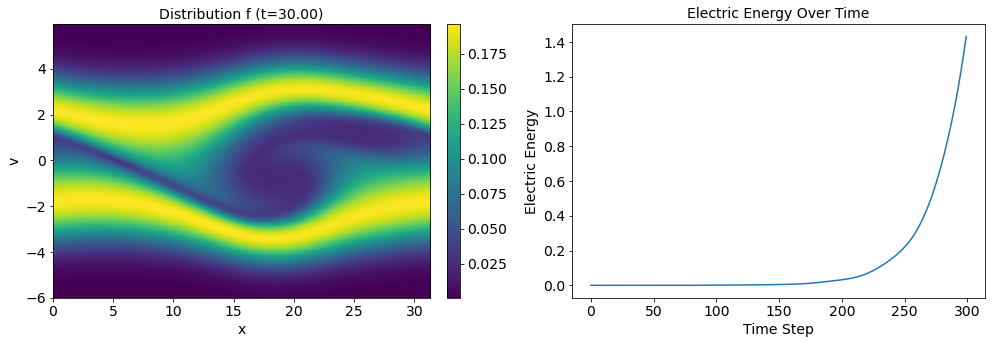

Iteration 32, Cost (KL Divergence): 2.5330965518951416, Coefficients: [-1.24403450e-04 -7.23112200e-04 -5.02594397e-04 -3.31819407e-04
 -2.85962567e-04 -1.12273432e-04 -1.57444825e-04 -7.23965204e-05
 -1.07036001e-04 -7.06612409e-05 -6.86383428e-05 -3.02554672e-05
 -4.89181402e-05 -2.61927416e-05 -2.14030952e-05 -3.59295914e-03
 -2.80334568e-03 -2.92002247e-03 -1.75540196e-03 -9.73928196e-04
 -2.99164909e-04  3.57232057e-05  2.03255186e-04  1.97527581e-04
  2.18062502e-04  1.73433393e-04  1.19125485e-04  8.67459821e-05
  8.60022410e-05  5.70920311e-05]


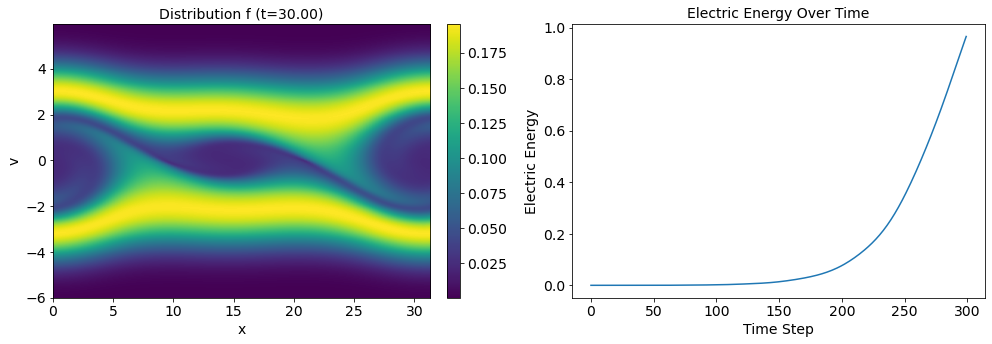

Iteration 33, Cost (KL Divergence): 6.7043914794921875, Coefficients: [-6.0210429e-04 -5.7016104e-04 -4.1717873e-04 -2.9150242e-04
 -2.7511193e-04 -1.1075143e-04 -1.2870396e-04 -4.1338881e-05
 -6.9310743e-05 -4.5520133e-05 -4.2679749e-05 -1.1883723e-05
 -2.6271167e-05 -8.5953398e-06 -1.8409082e-06  8.9964690e-04
 -7.4939104e-04 -2.8274404e-03 -1.8022216e-03 -1.0563488e-03
 -3.4794211e-04  2.6222358e-05  2.0327339e-04  2.0722474e-04
  2.2447508e-04  1.7004505e-04  1.0959340e-04  7.8786135e-05
  7.8345096e-05  4.7116719e-05]


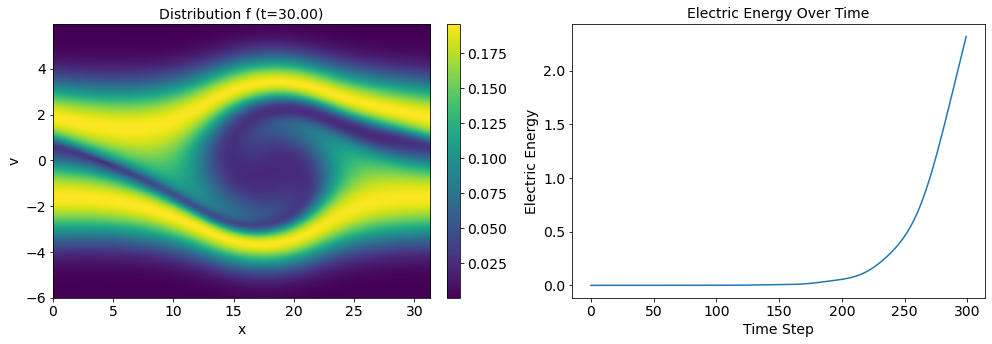

Iteration 34, Cost (KL Divergence): 3.7253456115722656, Coefficients: [-4.49066167e-04 -7.05689192e-04 -4.98631038e-04 -3.23339133e-04
 -3.15462850e-04 -1.25379607e-04 -1.60962984e-04 -5.87554750e-05
 -1.01838465e-04 -6.43210224e-05 -6.86324056e-05 -2.39403962e-05
 -4.49381005e-05 -1.66523514e-05 -1.46139455e-05 -4.53612162e-03
 -2.87150266e-03 -3.18420748e-03 -1.95717509e-03 -1.15309760e-03
 -3.78559926e-04  1.98648922e-06  2.11201623e-04  2.11524384e-04
  2.39353947e-04  1.71217995e-04  1.22824567e-04  8.77457060e-05
  9.74453578e-05  5.59615510e-05]


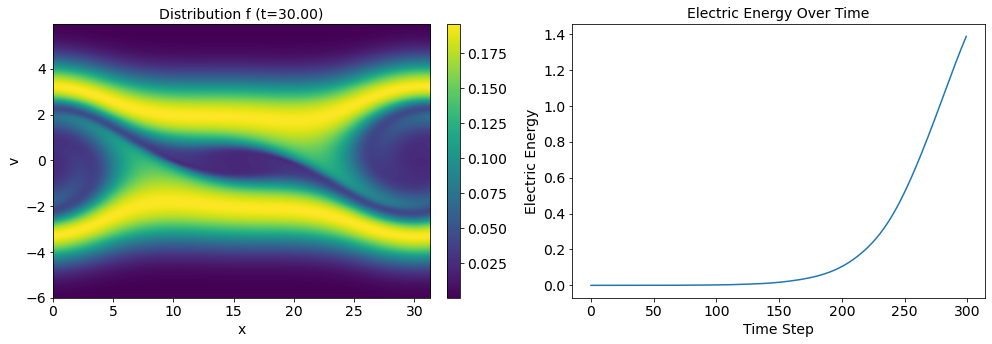

Iteration 35, Cost (KL Divergence): 5.887795925140381, Coefficients: [-7.8027003e-04 -6.0590665e-04 -4.2083900e-04 -3.0711584e-04
 -2.9007701e-04 -1.3037112e-04 -1.2793839e-04 -3.6425121e-05
 -6.5856555e-05 -4.7146597e-05 -4.5503504e-05 -9.7277543e-06
 -2.3685210e-05 -3.4869363e-06  1.3793406e-06  1.4387630e-04
 -1.3098117e-03 -3.1283344e-03 -2.0153774e-03 -1.1744127e-03
 -3.8394154e-04  4.0680112e-05  2.3251155e-04  2.4172285e-04
  2.4490821e-04  1.7955223e-04  1.0912100e-04  8.9544970e-05
  8.4748914e-05  5.1899391e-05]


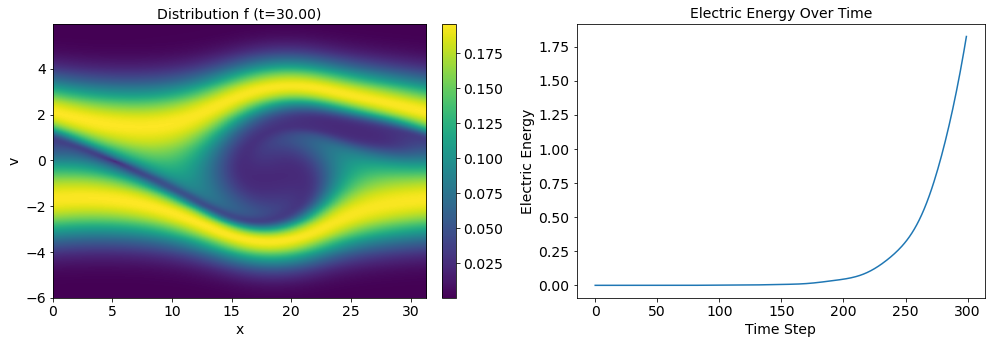

Iteration 36, Cost (KL Divergence): 2.794987201690674, Coefficients: [-3.05363705e-04 -6.74817536e-04 -5.17117500e-04 -3.42188170e-04
 -3.21391533e-04 -1.36136005e-04 -1.55858143e-04 -5.83843575e-05
 -1.00395060e-04 -6.99466473e-05 -7.48411185e-05 -2.89291856e-05
 -4.64432305e-05 -1.88780359e-05 -1.59960764e-05 -4.06900607e-03
 -3.14712152e-03 -3.46069084e-03 -2.16010073e-03 -1.25136343e-03
 -3.99564160e-04  3.12002048e-05  2.46881798e-04  2.48192227e-04
  2.55171559e-04  1.80255171e-04  1.21575031e-04  9.87333406e-05
  1.01064164e-04  6.22228181e-05]


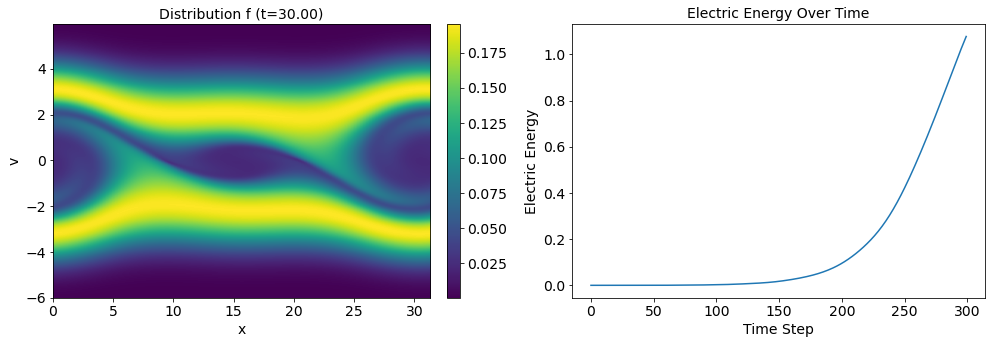

Iteration 37, Cost (KL Divergence): 6.392153739929199, Coefficients: [-6.78375189e-04 -6.02853193e-04 -4.46277380e-04 -3.27021757e-04
 -3.06612870e-04 -1.47194849e-04 -1.30945700e-04 -4.30634391e-05
 -6.66256601e-05 -5.46815681e-05 -5.05264034e-05 -2.01933108e-05
 -2.59045446e-05 -7.22683944e-06  2.45929004e-06  6.50839414e-04
 -1.18107093e-03 -3.37391952e-03 -2.21339939e-03 -1.31590560e-03
 -4.36435686e-04  3.53116448e-05  2.53938400e-04  2.70048680e-04
  2.65550101e-04  1.81196287e-04  1.10870664e-04  9.71178742e-05
  9.10796734e-05  5.66941853e-05]


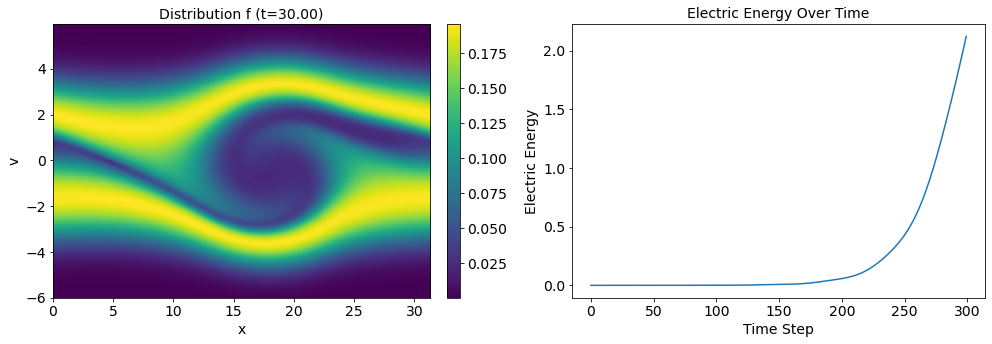

Iteration 38, Cost (KL Divergence): 3.0700857639312744, Coefficients: [-4.03209880e-04 -6.89363515e-04 -5.27927768e-04 -3.56038974e-04
 -3.40470608e-04 -1.55888643e-04 -1.58117095e-04 -5.99550622e-05
 -9.66948501e-05 -7.32377375e-05 -7.63893113e-05 -3.63218423e-05
 -4.43339450e-05 -1.82063268e-05 -1.02593822e-05 -4.27989848e-03
 -3.15824430e-03 -3.72251449e-03 -2.36176420e-03 -1.40689116e-03
 -4.62606142e-04  1.51021450e-05  2.64691364e-04  2.73798796e-04
  2.74539285e-04  1.77866154e-04  1.23567865e-04  1.04616935e-04
  1.09058579e-04  6.58806312e-05]


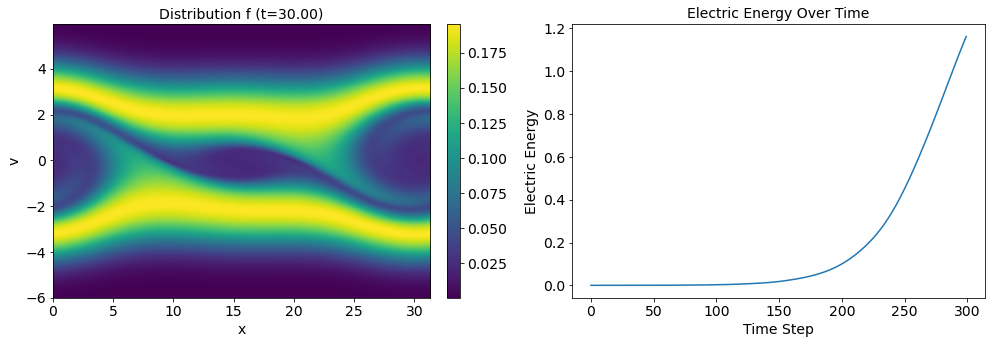

Iteration 39, Cost (KL Divergence): 6.385660171508789, Coefficients: [-7.31868146e-04 -6.38974248e-04 -4.61056217e-04 -3.47577065e-04
 -3.22782347e-04 -1.67684513e-04 -1.34559596e-04 -4.60664523e-05
 -6.68797002e-05 -5.73312245e-05 -5.56559535e-05 -2.57843458e-05
 -2.73879305e-05 -5.98917813e-06  4.97137989e-06  4.77481633e-04
 -1.31670805e-03 -3.63528286e-03 -2.41997349e-03 -1.45275507e-03
 -4.93778731e-04  3.07846567e-05  2.72415986e-04  3.02848173e-04
  2.82723311e-04  1.85450277e-04  1.09687855e-04  1.05847430e-04
  9.71267509e-05  6.14175879e-05]


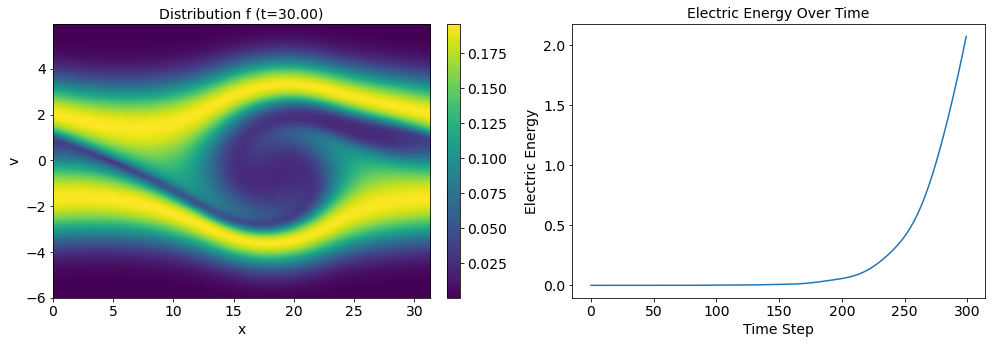

Iteration 40, Cost (KL Divergence): 2.917525053024292, Coefficients: [-3.9032035e-04 -7.0261309e-04 -5.4290792e-04 -3.7594986e-04
 -3.5320909e-04 -1.7406353e-04 -1.5924437e-04 -6.3436048e-05
 -9.5666481e-05 -7.6452765e-05 -8.0928461e-05 -4.3803178e-05
 -4.5184068e-05 -1.8666899e-05 -7.6445185e-06 -4.2327754e-03
 -3.2357257e-03 -3.9844038e-03 -2.5671758e-03 -1.5416070e-03
 -5.1804370e-04  1.4041574e-05  2.8484841e-04  3.0765173e-04
  2.9066182e-04  1.8100116e-04  1.2235684e-04  1.1250818e-04
  1.1506458e-04  7.1156886e-05]


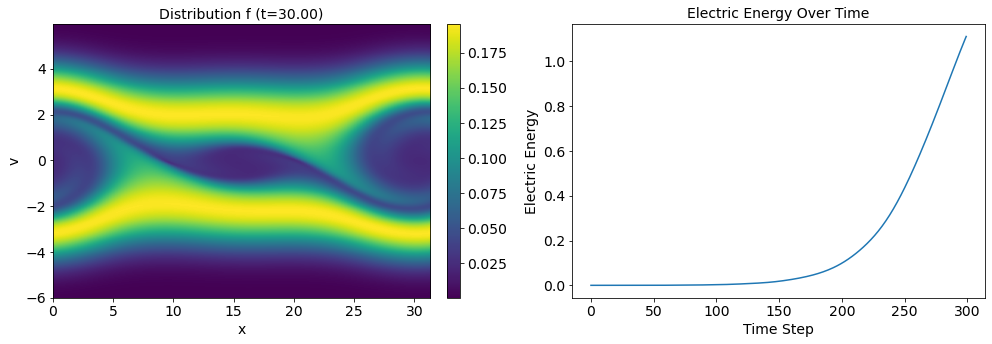

Iteration 41, Cost (KL Divergence): 6.5146565437316895, Coefficients: [-7.1393530e-04 -6.6160690e-04 -4.7943526e-04 -3.6868380e-04
 -3.3699156e-04 -1.8556781e-04 -1.3896156e-04 -5.0910647e-05
 -6.8050227e-05 -6.0668019e-05 -6.0526188e-05 -3.3719945e-05
 -2.9380062e-05 -7.4533637e-06  7.4520149e-06  5.5145705e-04
 -1.3221739e-03 -3.8794479e-03 -2.6212321e-03 -1.5899425e-03
 -5.5598730e-04  2.3343922e-05  2.8774806e-04  3.3568032e-04
  2.9931017e-04  1.8934729e-04  1.0828454e-04  1.1286224e-04
  1.0325580e-04  6.5765984e-05]


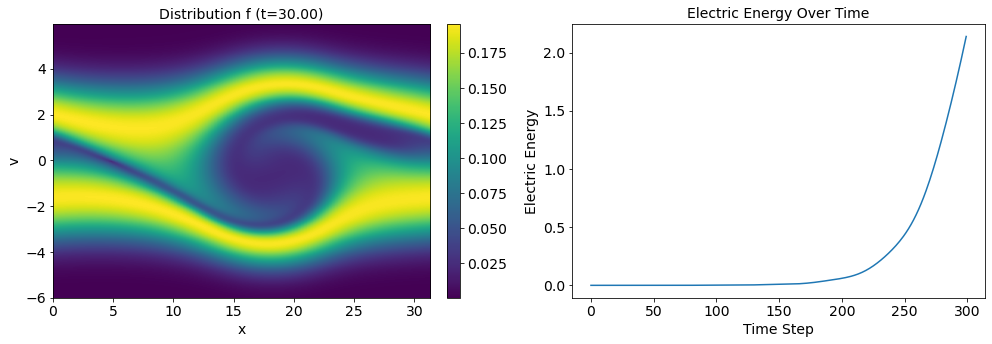

Iteration 42, Cost (KL Divergence): 2.9183402061462402, Coefficients: [-3.97178694e-04 -7.22828903e-04 -5.57132124e-04 -3.95832438e-04
 -3.66334454e-04 -1.91817831e-04 -1.62509590e-04 -6.74226394e-05
 -9.48041125e-05 -7.90235936e-05 -8.48778582e-05 -5.21667716e-05
 -4.59926669e-05 -1.99507849e-05 -4.71470412e-06 -4.26091487e-03
 -3.24983057e-03 -4.23217658e-03 -2.76740454e-03 -1.68031733e-03
 -5.83047397e-04  5.37858250e-06  2.99536856e-04  3.39912018e-04
  3.06154834e-04  1.82201446e-04  1.21194127e-04  1.17403964e-04
  1.21233723e-04  7.56411391e-05]


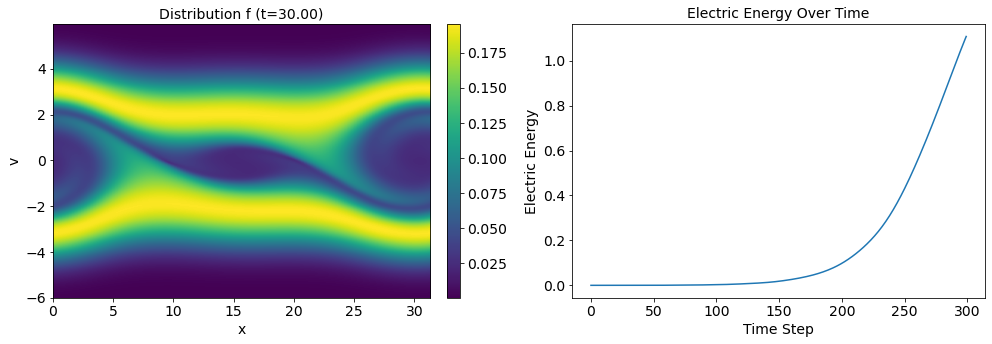

Iteration 43, Cost (KL Divergence): 6.610869407653809, Coefficients: [-7.14965397e-04 -6.81384350e-04 -4.94650158e-04 -3.86634259e-04
 -3.50509625e-04 -2.01151270e-04 -1.43984944e-04 -5.46234442e-05
 -6.77025382e-05 -6.28691487e-05 -6.29235728e-05 -4.28711792e-05
 -3.03234247e-05 -9.77412492e-06  1.00209163e-05  5.60554210e-04
 -1.33930403e-03 -4.11522761e-03 -2.82293907e-03 -1.72384118e-03
 -6.23537519e-04  1.50970072e-05  2.99838721e-04  3.69255722e-04
  3.14643548e-04  1.92619074e-04  1.06201602e-04  1.17376614e-04
  1.10142893e-04  6.86270796e-05]


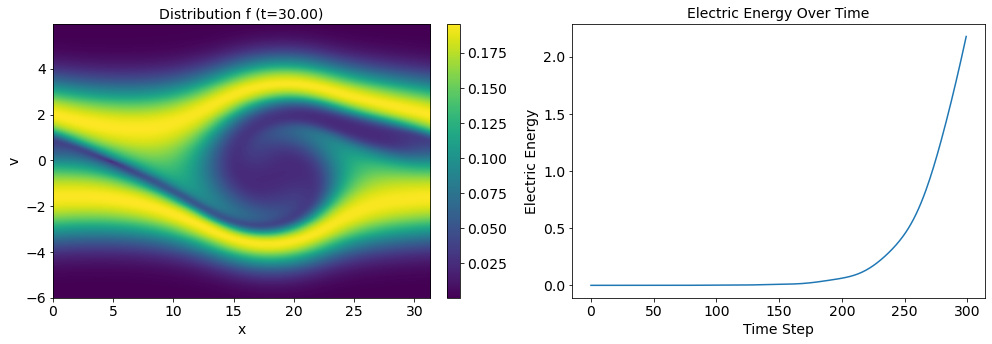

Iteration 44, Cost (KL Divergence): 2.912952184677124, Coefficients: [-4.0117148e-04 -7.3723053e-04 -5.7099829e-04 -4.1277180e-04
 -3.7912937e-04 -2.0723479e-04 -1.6670485e-04 -7.0607239e-05
 -9.2728522e-05 -8.1538281e-05 -8.5772204e-05 -6.2275314e-05
 -4.6434041e-05 -2.2679487e-05 -1.5090982e-06 -4.2831004e-03
 -3.2634980e-03 -4.4709784e-03 -2.9684447e-03 -1.8150085e-03
 -6.5166492e-04 -3.2110993e-06  3.1223538e-04  3.7281308e-04
  3.2220443e-04  1.8365741e-04  1.1918405e-04  1.2092570e-04
  1.2791020e-04  7.9117708e-05]


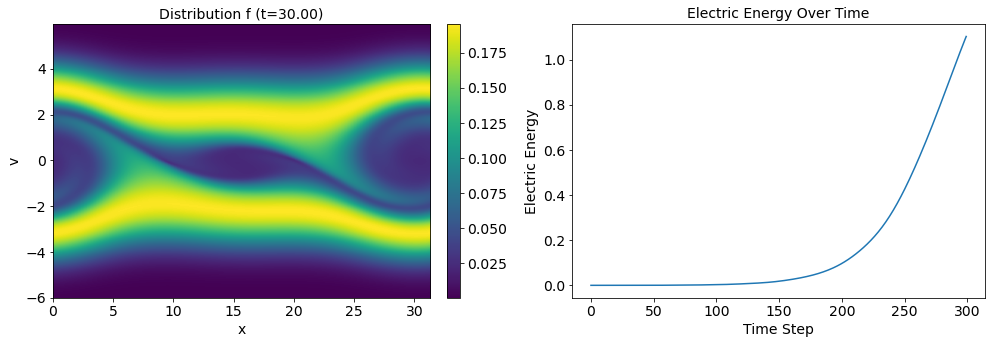

Iteration 45, Cost (KL Divergence): 6.694746971130371, Coefficients: [-7.16565934e-04 -6.94964605e-04 -5.11032529e-04 -4.01596510e-04
 -3.63664818e-04 -2.14901738e-04 -1.48491803e-04 -5.85551024e-05
 -6.55523036e-05 -6.61836675e-05 -6.29372225e-05 -5.26468793e-05
 -3.12434095e-05 -1.28206639e-05  1.28065221e-05  5.70715871e-04
 -1.35665108e-03 -4.34144028e-03 -3.02626635e-03 -1.85256370e-03
 -6.95630966e-04  8.18657645e-06  3.08286923e-04  4.04587103e-04
  3.29628238e-04  1.96490757e-04  1.05164807e-04  1.18375894e-04
  1.19209828e-04  6.86073836e-05]


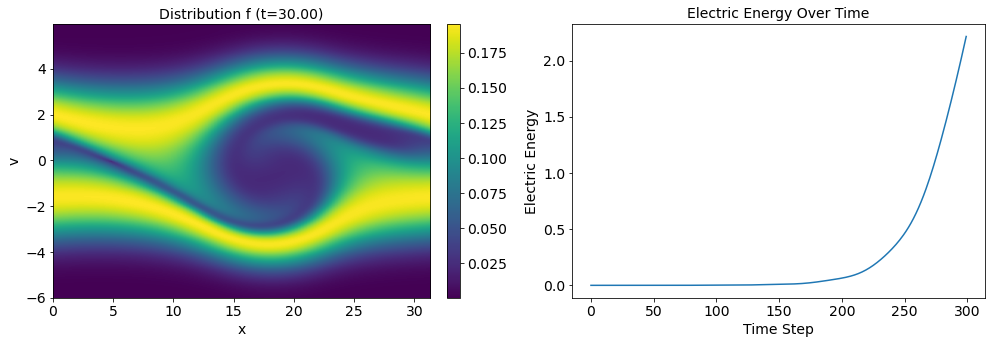

Iteration 46, Cost (KL Divergence): 2.905028820037842, Coefficients: [-4.0594419e-04 -7.4679469e-04 -5.8607513e-04 -4.2722642e-04
 -3.9224850e-04 -2.2029181e-04 -1.7060732e-04 -7.3935036e-05
 -8.8815395e-05 -8.4635001e-05 -8.4992658e-05 -7.2592913e-05
 -4.7156791e-05 -2.5924199e-05  1.9033187e-06 -4.3012514e-03
 -3.2778624e-03 -4.6993122e-03 -3.1715841e-03 -1.9435179e-03
 -7.2541024e-04 -9.8475157e-06  3.2073515e-04  4.0809144e-04
  3.3678825e-04  1.8577563e-04  1.1791022e-04  1.2096956e-04
  1.3634750e-04  8.0105165e-05]


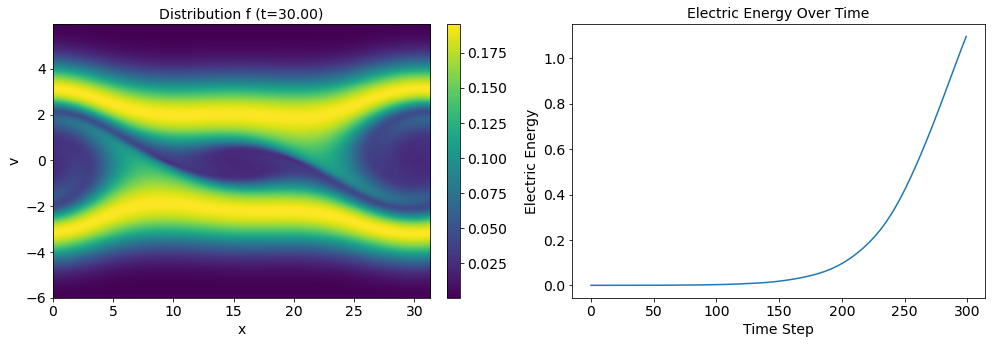

Iteration 47, Cost (KL Divergence): 6.776647567749023, Coefficients: [-7.1912084e-04 -7.0891471e-04 -5.2793237e-04 -4.1578917e-04
 -3.7737974e-04 -2.2769321e-04 -1.5409602e-04 -6.2763065e-05
 -6.3499290e-05 -6.9035850e-05 -6.2631960e-05 -6.1752973e-05
 -3.3590695e-05 -1.5965335e-05  1.4300799e-05  5.7683839e-04
 -1.3732010e-03 -4.5589944e-03 -3.2286460e-03 -1.9776088e-03
 -7.6969928e-04  1.1840220e-06  3.1647136e-04  4.3918073e-04
  3.4558895e-04  1.9951537e-04  1.0576930e-04  1.1703797e-04
  1.2957027e-04  6.8987720e-05]


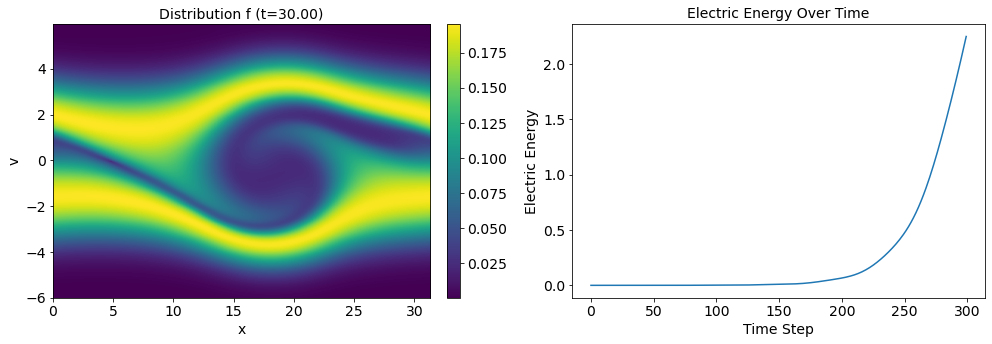

Iteration 48, Cost (KL Divergence): 2.8933587074279785, Coefficients: [-4.1051701e-04 -7.5672806e-04 -6.0186558e-04 -4.4023865e-04
 -4.0547407e-04 -2.3303174e-04 -1.7531907e-04 -7.8180790e-05
 -8.5773943e-05 -8.7044755e-05 -8.3986299e-05 -8.1691607e-05
 -4.9256058e-05 -2.9171213e-05  3.6825031e-06 -4.3155258e-03
 -3.2910137e-03 -4.9183136e-03 -3.3736471e-03 -2.0683599e-03
 -8.0101716e-04 -1.6671227e-05  3.2889555e-04  4.4244813e-04
  3.5261316e-04  1.8800904e-04  1.1806835e-04  1.1890974e-04
  1.4625244e-04  8.1002130e-05]


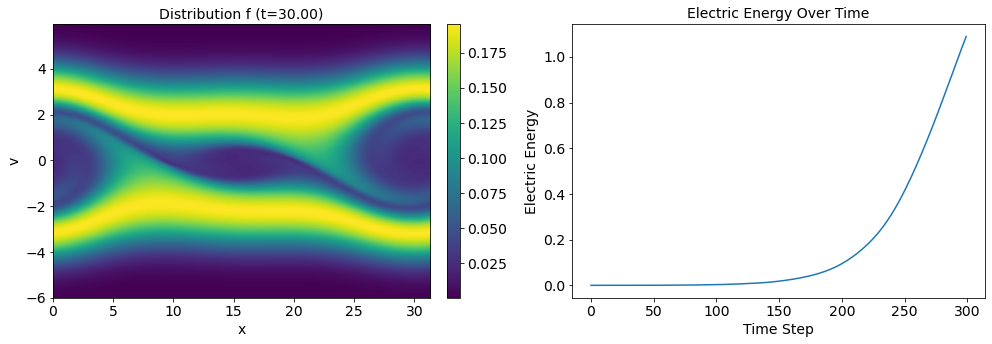

Iteration 49, Cost (KL Divergence): 6.8537187576293945, Coefficients: [-7.2093296e-04 -7.2203722e-04 -5.4527883e-04 -4.2909774e-04
 -3.9108537e-04 -2.4004580e-04 -1.5909347e-04 -6.7863220e-05
 -6.1166313e-05 -7.1913186e-05 -6.2545361e-05 -6.9772330e-05
 -3.6818037e-05 -1.8485003e-05  1.4738977e-05  5.8153598e-04
 -1.3861354e-03 -4.7679609e-03 -3.4299027e-03 -2.0998965e-03
 -8.4541767e-04 -6.8560366e-06  3.2385057e-04  4.7224431e-04
  3.6333679e-04  2.0174796e-04  1.0866838e-04  1.1336098e-04
  1.3982724e-04  6.9679198e-05]


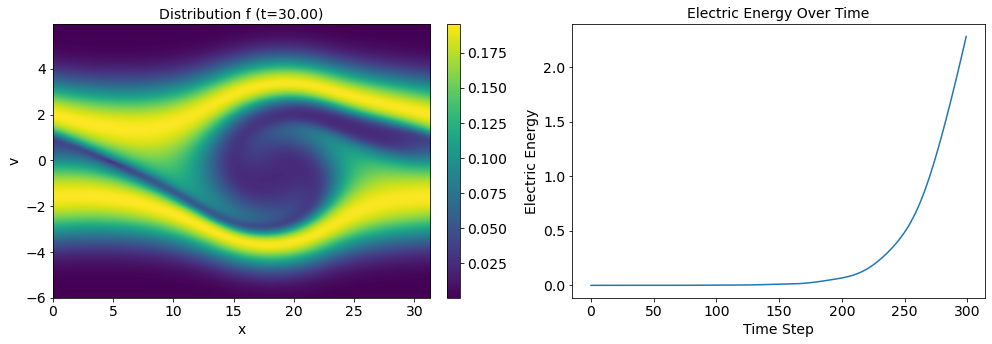

Iteration 50, Cost (KL Divergence): 2.8856711387634277, Coefficients: [-4.13925620e-04 -7.65449135e-04 -6.17643294e-04 -4.52465669e-04
 -4.18137817e-04 -2.44881143e-04 -1.79111215e-04 -8.28864650e-05
 -8.18619228e-05 -8.98924627e-05 -8.27400290e-05 -9.02069660e-05
 -5.17859226e-05 -3.22545238e-05  4.93223433e-06 -4.33123065e-03
 -3.30100674e-03 -5.12867328e-03 -3.57528008e-03 -2.19059200e-03
 -8.78377585e-04 -2.51345282e-05  3.36090685e-04  4.74675529e-04
  3.70338006e-04  1.88727005e-04  1.20076045e-04  1.14321934e-04
  1.55350732e-04  8.16187021e-05]


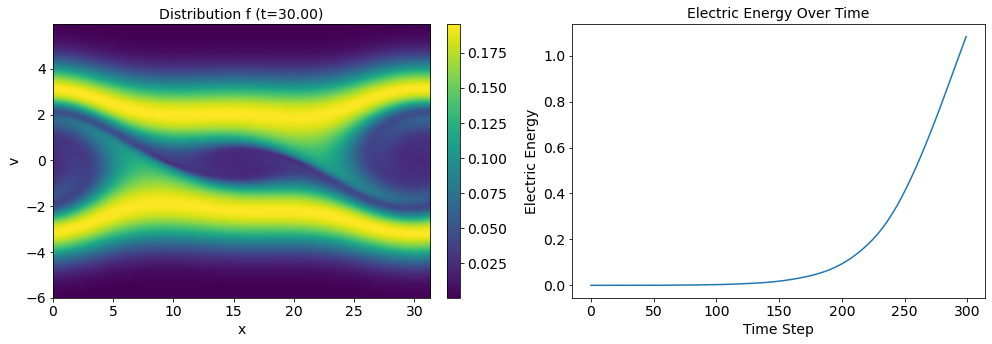

Iteration 51, Cost (KL Divergence): 6.919665336608887, Coefficients: [-7.2402472e-04 -7.3187787e-04 -5.6204345e-04 -4.4128986e-04
 -4.0363203e-04 -2.5214898e-04 -1.6282307e-04 -7.2923081e-05
 -5.8573758e-05 -7.3815099e-05 -6.3159532e-05 -7.6198514e-05
 -4.1462561e-05 -1.9970314e-05  1.4248094e-05  5.8067869e-04
 -1.3995286e-03 -4.9682101e-03 -3.6321769e-03 -2.2201696e-03
 -9.2253153e-04 -1.6804759e-05  3.3206557e-04  5.0214288e-04
  3.8405147e-04  2.0114929e-04  1.1283587e-04  1.0849222e-04
  1.4783627e-04  7.2633411e-05]


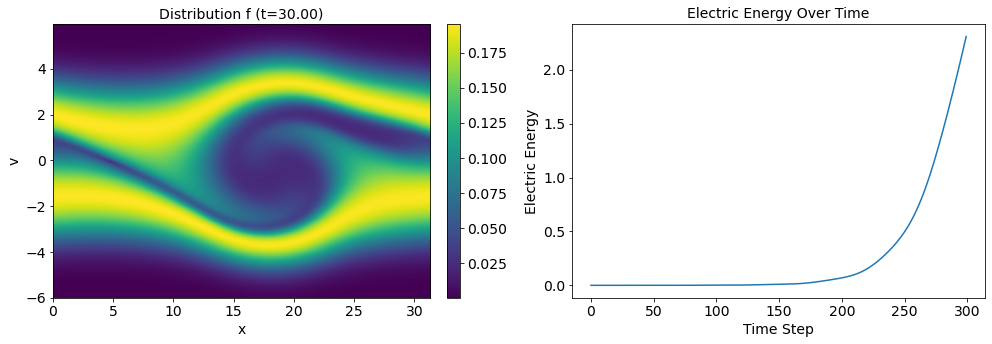

Iteration 52, Cost (KL Divergence): 2.8818206787109375, Coefficients: [-4.1868893e-04 -7.7146123e-04 -6.3364150e-04 -4.6369058e-04
 -4.3054132e-04 -2.5658580e-04 -1.8219360e-04 -8.7850451e-05
 -7.8385390e-05 -9.1759648e-05 -8.2673236e-05 -9.6725809e-05
 -5.6406374e-05 -3.3611039e-05  4.5854667e-06 -4.3480019e-03
 -3.3107866e-03 -5.3300215e-03 -3.7776311e-03 -2.3105373e-03
 -9.5657038e-04 -3.5318822e-05  3.4448819e-04  5.0410227e-04
  3.9177726e-04  1.8730032e-04  1.2396144e-04  1.0898178e-04
  1.6275598e-04  8.4357926e-05]


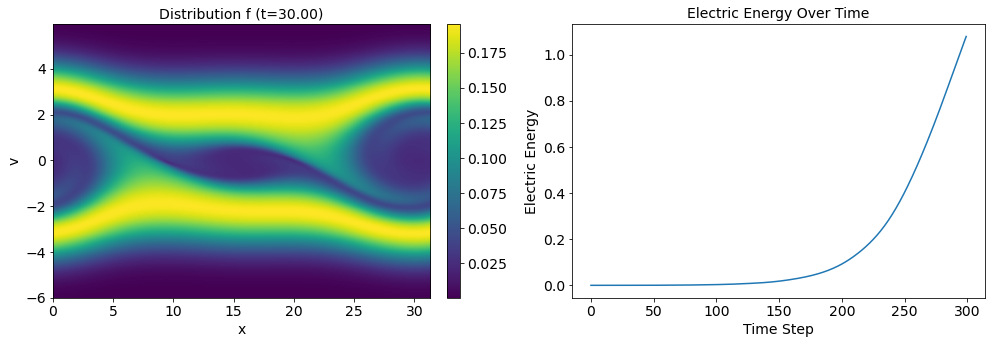

Iteration 53, Cost (KL Divergence): 6.981429576873779, Coefficients: [-7.27187900e-04 -7.39967858e-04 -5.79645508e-04 -4.51903616e-04
 -4.16593743e-04 -2.63147958e-04 -1.67242004e-04 -7.73086140e-05
 -5.72009958e-05 -7.43446508e-05 -6.47658890e-05 -8.10908532e-05
 -4.68486905e-05 -2.21092669e-05  1.42332110e-05  5.79678454e-04
 -1.41376862e-03 -5.15976315e-03 -3.83442873e-03 -2.33858498e-03
 -9.99555225e-04 -2.90663647e-05  3.40976927e-04  5.29720797e-04
  4.06938867e-04  2.00726019e-04  1.16748975e-04  1.04536186e-04
  1.52774359e-04  7.72829007e-05]


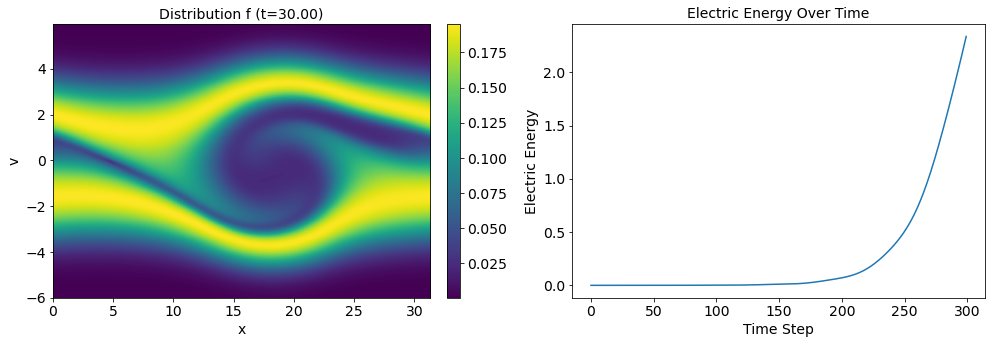

Iteration 54, Cost (KL Divergence): 2.8756487369537354, Coefficients: [-4.24083613e-04 -7.76295201e-04 -6.50750706e-04 -4.73221182e-04
 -4.43483383e-04 -2.67411699e-04 -1.86309524e-04 -9.22940890e-05
 -7.63466160e-05 -9.19357626e-05 -8.40718494e-05 -1.01321697e-04
 -6.19651328e-05 -3.58599173e-05  4.93838706e-06 -4.36303206e-03
 -3.32232751e-03 -5.52235916e-03 -3.98035394e-03 -2.42828298e-03
 -1.03487063e-03 -4.74756562e-05  3.53778567e-04  5.31617261e-04
  4.15014161e-04  1.86141915e-04  1.27570733e-04  1.04557526e-04
  1.67315942e-04  8.93377437e-05]


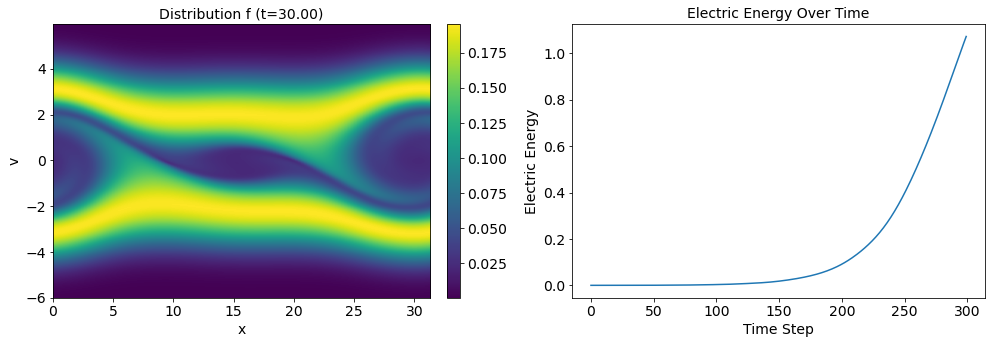

Iteration 55, Cost (KL Divergence): 7.029521942138672, Coefficients: [-7.27984239e-04 -7.49557628e-04 -5.96772821e-04 -4.61645599e-04
 -4.30176762e-04 -2.72732461e-04 -1.73272012e-04 -8.06728640e-05
 -5.72416939e-05 -7.45656362e-05 -6.60159567e-05 -8.59050342e-05
 -5.17187946e-05 -2.49655241e-05  1.43868147e-05  5.72178047e-04
 -1.42990006e-03 -5.34387492e-03 -4.03600605e-03 -2.45625759e-03
 -1.07496115e-03 -4.46677113e-05  3.52278003e-04  5.53150137e-04
  4.32257977e-04  1.99658811e-04  1.20294695e-04  1.02629754e-04
  1.54949361e-04  8.36605177e-05]


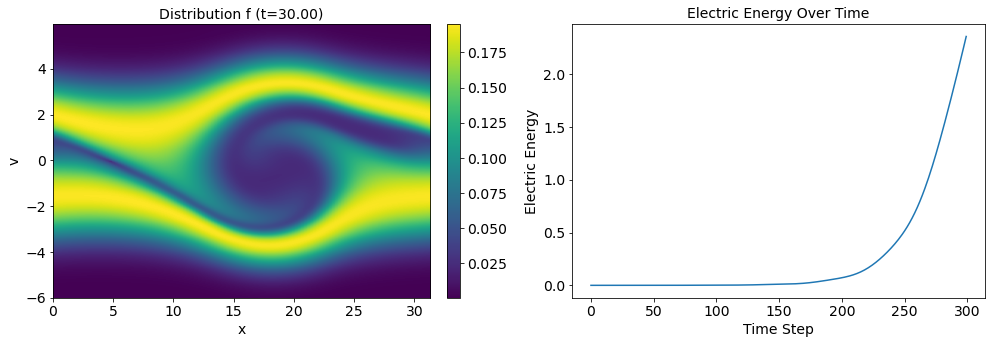

Iteration 56, Cost (KL Divergence): 2.864999294281006, Coefficients: [-4.25775856e-04 -7.82408693e-04 -6.67457934e-04 -4.82424744e-04
 -4.56611742e-04 -2.76802341e-04 -1.92075822e-04 -9.53441122e-05
 -7.60464682e-05 -9.18684163e-05 -8.51044024e-05 -1.05870895e-04
 -6.67392087e-05 -3.88259832e-05  5.28539385e-06 -4.37815767e-03
 -3.33489943e-03 -5.70700224e-03 -4.18238249e-03 -2.54513253e-03
 -1.11121591e-03 -6.31380317e-05  3.65497312e-04  5.54557540e-04
  4.40855016e-04  1.84708813e-04  1.30780318e-04  1.02446815e-04
  1.69141131e-04  9.56617660e-05]


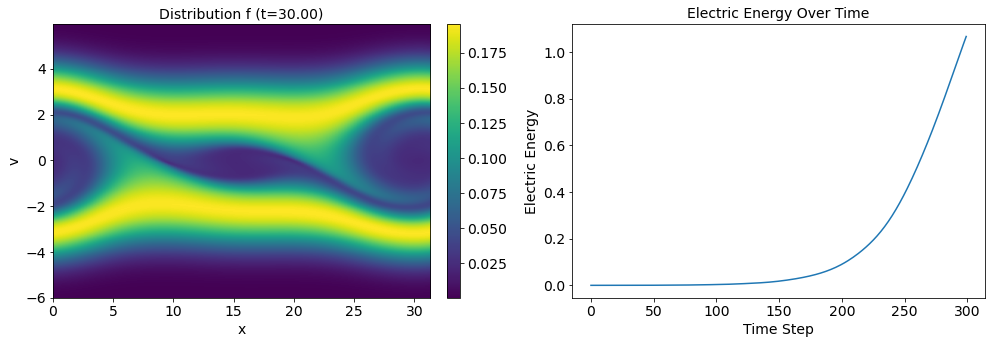

Iteration 57, Cost (KL Divergence): 7.06466817855835, Coefficients: [-7.2626490e-04 -7.5678632e-04 -6.1478268e-04 -4.6849251e-04
 -4.4634775e-04 -2.7890489e-04 -1.8106725e-04 -8.3069368e-05
 -5.6598426e-05 -7.6300166e-05 -6.4817876e-05 -9.3116294e-05
 -5.3716845e-05 -2.9826755e-05  1.5522561e-05  5.6555914e-04
 -1.4464032e-03 -5.5192672e-03 -4.2390977e-03 -2.5719497e-03
 -1.1507488e-03 -6.2856750e-05  3.6543570e-04  5.7380018e-04
  4.5793940e-04  2.0031576e-04  1.2175866e-04  1.0308611e-04
  1.5431692e-04  9.1133159e-05]


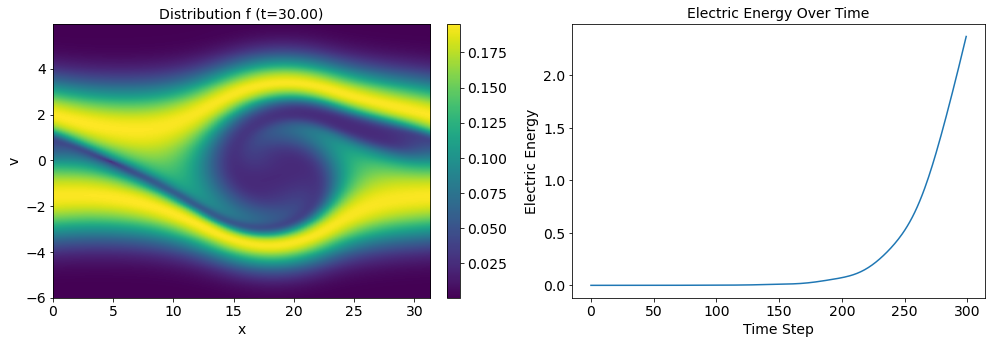

Iteration 58, Cost (KL Divergence): 2.854808807373047, Coefficients: [-4.25850943e-04 -7.86942954e-04 -6.85245206e-04 -4.88429330e-04
 -4.73059044e-04 -2.82540568e-04 -1.99501927e-04 -9.77520322e-05
 -7.48321836e-05 -9.33860574e-05 -8.34867969e-05 -1.13384594e-04
 -6.82043101e-05 -4.41039920e-05  6.90853722e-06 -4.39482694e-03
 -3.34810861e-03 -5.88284573e-03 -4.38583968e-03 -2.66020373e-03
 -1.18746655e-03 -8.18964108e-05  3.79403966e-04  5.74714562e-04
  4.66946221e-04  1.84994220e-04  1.31747525e-04  1.02855178e-04
  1.67831866e-04  1.03329992e-04]


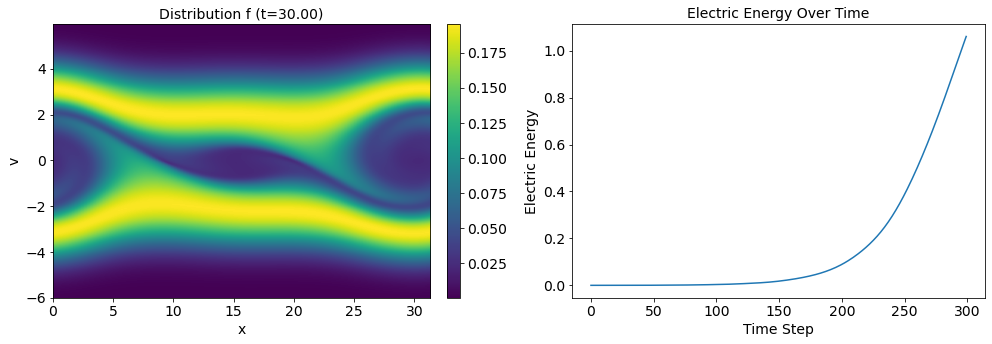

Iteration 59, Cost (KL Divergence): 7.094383239746094, Coefficients: [-7.24112266e-04 -7.63217162e-04 -6.31147646e-04 -4.75882611e-04
 -4.60885843e-04 -2.85780319e-04 -1.87246740e-04 -8.63680689e-05
 -5.49656688e-05 -7.81830022e-05 -6.39042992e-05 -9.89028413e-05
 -5.69363947e-05 -3.32159907e-05  1.54265745e-05  5.55995386e-04
 -1.45991810e-03 -5.69177885e-03 -4.43796441e-03 -2.69064587e-03
 -1.22328720e-03 -8.50179495e-05  3.80117155e-04  5.92498807e-04
  4.84000542e-04  2.01650677e-04  1.23191421e-04  1.03253304e-04
  1.53624467e-04  9.69630855e-05]


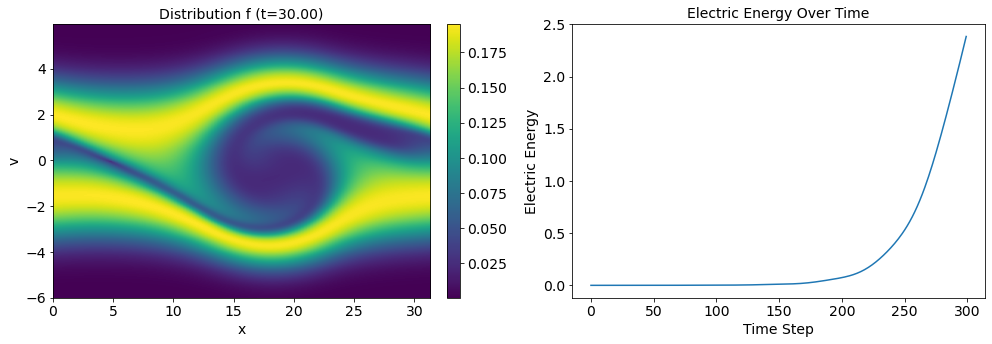

Iteration 60, Cost (KL Divergence): 2.8459975719451904, Coefficients: [-4.25122271e-04 -7.92236242e-04 -7.01927114e-04 -4.95239685e-04
 -4.88173246e-04 -2.89158401e-04 -2.05648015e-04 -1.01184487e-04
 -7.25851205e-05 -9.54300267e-05 -8.22874790e-05 -1.19300850e-04
 -7.12934707e-05 -4.79511655e-05  7.26756116e-06 -4.41198004e-03
 -3.35914874e-03 -6.05579466e-03 -4.58527170e-03 -2.77835713e-03
 -1.26029935e-03 -1.04636187e-04  3.95068171e-04  5.92831348e-04
  4.93641477e-04  1.86144840e-04  1.32588772e-04  1.03367449e-04
  1.66293001e-04  1.09630826e-04]


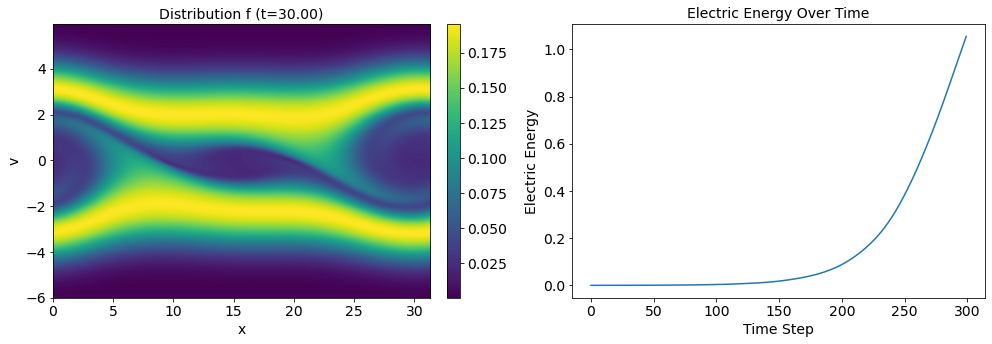

Iteration 61, Cost (KL Divergence): 7.128509521484375, Coefficients: [-7.24875368e-04 -7.66776793e-04 -6.48528105e-04 -4.81221068e-04
 -4.76146204e-04 -2.91891571e-04 -1.93440865e-04 -8.98875223e-05
 -5.22441587e-05 -8.10725469e-05 -6.15202298e-05 -1.05378531e-04
 -5.90391246e-05 -3.83518491e-05  1.71803258e-05  5.46610914e-04
 -1.47321576e-03 -5.85938944e-03 -4.63610468e-03 -2.80952174e-03
 -1.29586388e-03 -1.07865788e-04  3.94216448e-04  6.11631549e-04
  5.08774945e-04  2.05134813e-04  1.22986516e-04  1.04224127e-04
  1.52626104e-04  1.01828744e-04]


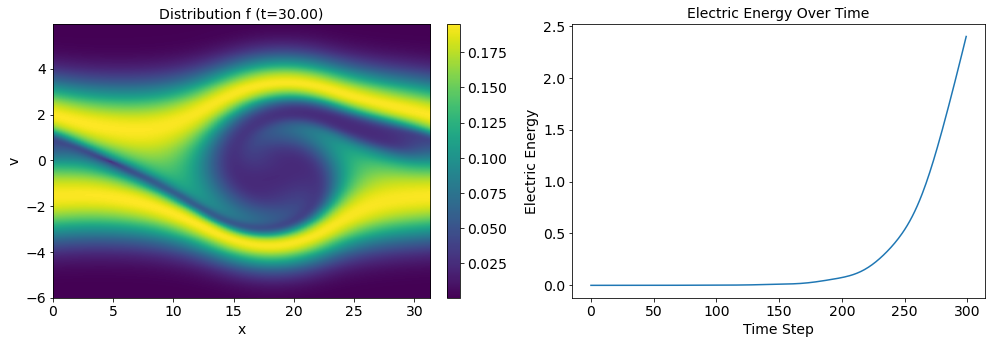

Iteration 62, Cost (KL Divergence): 2.8435776233673096, Coefficients: [-4.27443301e-04 -7.94857857e-04 -7.19698030e-04 -4.99775691e-04
 -5.03790041e-04 -2.95179838e-04 -2.12092054e-04 -1.04918399e-04
 -6.97401774e-05 -9.83235659e-05 -7.90642298e-05 -1.26320723e-04
 -7.27049410e-05 -5.36158695e-05  9.03099954e-06 -4.43234807e-03
 -3.37255746e-03 -6.22428581e-03 -4.78396891e-03 -2.89699947e-03
 -1.33337837e-03 -1.28044834e-04  4.10215056e-04  6.11506228e-04
  5.19235327e-04  1.89465674e-04  1.31583147e-04  1.04413222e-04
  1.64251265e-04  1.14891984e-04]


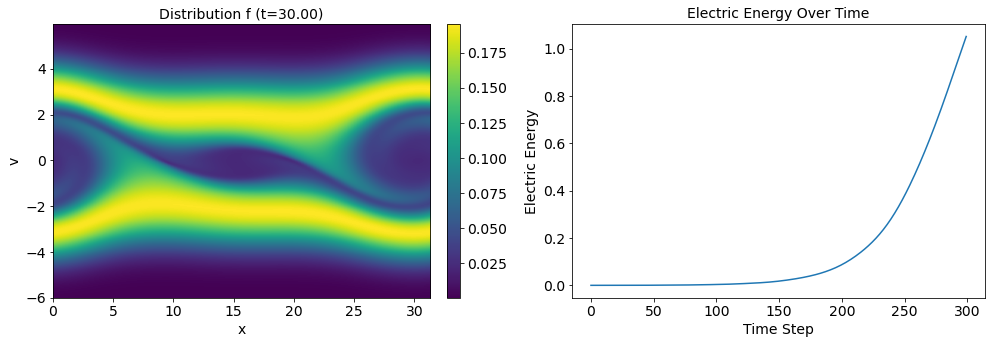

Iteration 63, Cost (KL Divergence): 7.149271011352539, Coefficients: [-7.25151505e-04 -7.70850573e-04 -6.66032545e-04 -4.86360688e-04
 -4.90917009e-04 -2.98300176e-04 -1.99272094e-04 -9.35126955e-05
 -4.98437730e-05 -8.38337000e-05 -5.93320001e-05 -1.11445006e-04
 -6.11085998e-05 -4.29004103e-05  1.82269214e-05  5.26665244e-04
 -1.49040436e-03 -6.02521375e-03 -4.83133551e-03 -2.93066842e-03
 -1.36612623e-03 -1.33027148e-04  4.09308763e-04  6.29430986e-04
  5.33886952e-04  2.09160484e-04  1.22626589e-04  1.05042076e-04
  1.51886197e-04  1.05078077e-04]


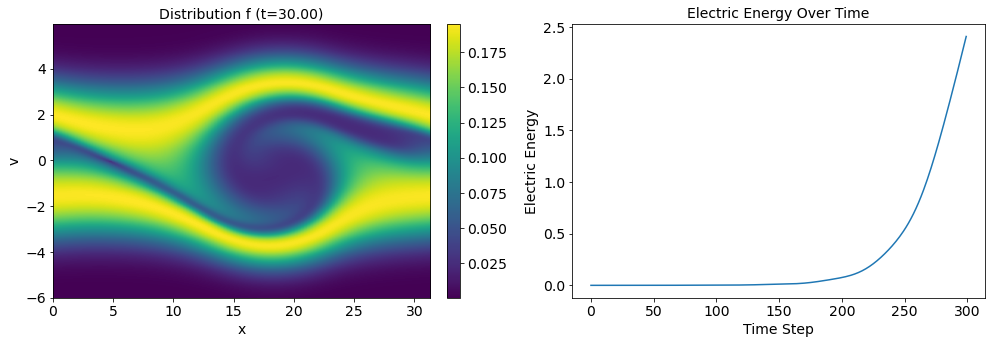

Iteration 64, Cost (KL Divergence): 2.843066692352295, Coefficients: [-4.27327846e-04 -7.97063170e-04 -7.37471681e-04 -5.04300639e-04
 -5.18523448e-04 -3.01360706e-04 -2.17406065e-04 -1.08696215e-04
 -6.65559783e-05 -1.01338956e-04 -7.64621582e-05 -1.32490590e-04
 -7.45393627e-05 -5.84737427e-05  1.03118828e-05 -4.45779134e-03
 -3.38868285e-03 -6.39134739e-03 -4.97985724e-03 -3.01811169e-03
 -1.40360009e-03 -1.54023917e-04  4.25999780e-04  6.28698443e-04
  5.44519396e-04  1.93196713e-04  1.30300497e-04  1.05476567e-04
  1.62207929e-04  1.18348064e-04]


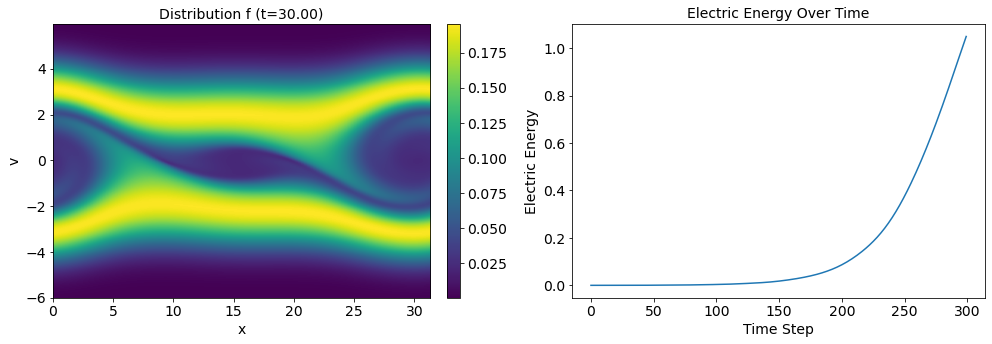

Iteration 65, Cost (KL Divergence): 7.165914535522461, Coefficients: [-7.2634645e-04 -7.7246956e-04 -6.8323291e-04 -4.9035414e-04
 -5.0553703e-04 -3.0362746e-04 -2.0493026e-04 -9.7010678e-05
 -4.6961650e-05 -8.6897737e-05 -5.6175326e-05 -1.1788105e-04
 -6.1939900e-05 -4.8150352e-05  1.9405255e-05  5.0696218e-04
 -1.5117590e-03 -6.1892970e-03 -5.0249393e-03 -3.0524810e-03
 -1.4350642e-03 -1.5873602e-04  4.2362028e-04  6.4688909e-04
  5.5784732e-04  2.1391753e-04  1.2189880e-04  1.0611844e-04
  1.5059294e-04  1.0785321e-04]


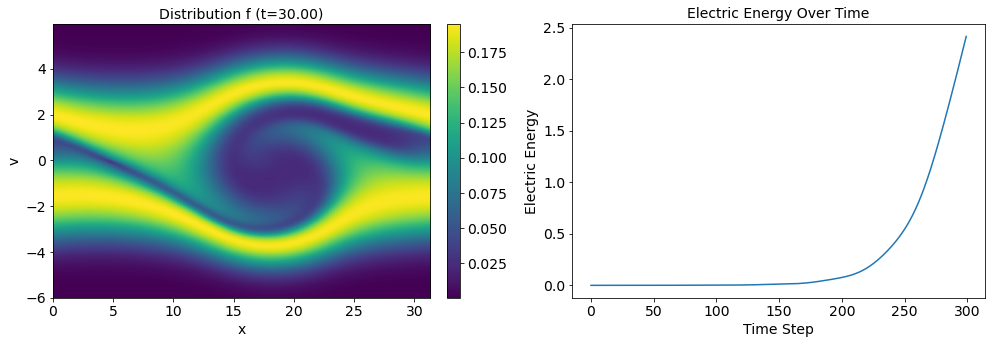

Iteration 66, Cost (KL Divergence): 2.836239814758301, Coefficients: [-4.27995430e-04 -7.96827488e-04 -7.54692242e-04 -5.07996941e-04
 -5.33010403e-04 -3.06251983e-04 -2.22863455e-04 -1.12045265e-04
 -6.30281138e-05 -1.04633618e-04 -7.30720130e-05 -1.38998963e-04
 -7.51867265e-05 -6.38138517e-05  1.15350113e-05 -4.47920524e-03
 -3.40830279e-03 -6.55579194e-03 -5.17427456e-03 -3.13971890e-03
 -1.47226511e-03 -1.80461575e-04  4.40890464e-04  6.45748747e-04
  5.68611664e-04  1.97974732e-04  1.28628002e-04  1.06729058e-04
  1.60404219e-04  1.20615397e-04]


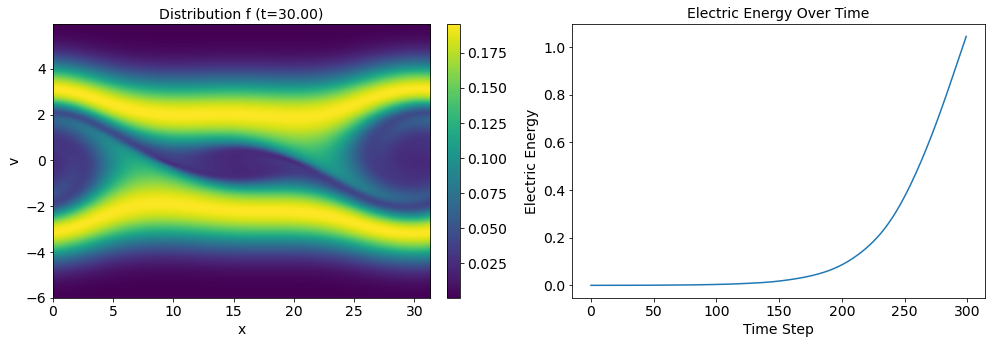

Iteration 67, Cost (KL Divergence): 7.174704551696777, Coefficients: [-7.2586769e-04 -7.7386829e-04 -6.9997000e-04 -4.9438648e-04
 -5.1952031e-04 -3.0880413e-04 -2.1042308e-04 -1.0025437e-04
 -4.3884371e-05 -9.0076217e-05 -5.2811491e-05 -1.2432518e-04
 -6.2629602e-05 -5.3176169e-05  2.0094449e-05  4.8501464e-04
 -1.5330575e-03 -6.3509205e-03 -5.2165128e-03 -3.1759634e-03
 -1.5021150e-03 -1.8603580e-04  4.3775147e-04  6.6395354e-04
  5.8134011e-04  2.1868438e-04  1.2145424e-04  1.0654632e-04
  1.4964469e-04  1.0961975e-04]


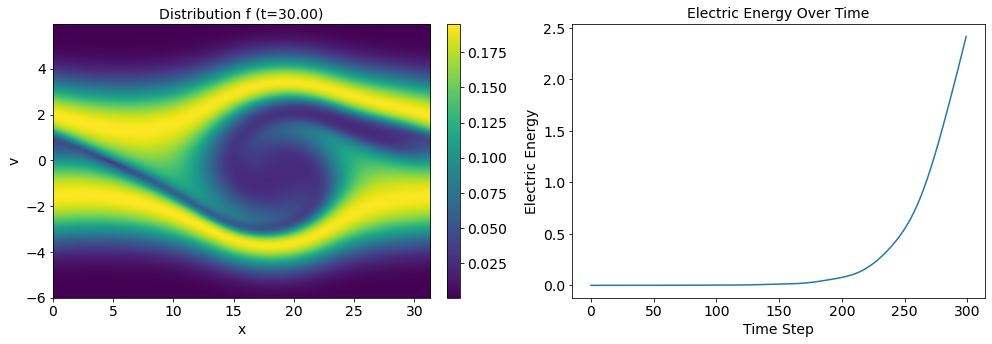

Iteration 68, Cost (KL Divergence): 2.833876848220825, Coefficients: [-4.27428778e-04 -7.97092798e-04 -7.71743653e-04 -5.11543476e-04
 -5.47176925e-04 -3.11567215e-04 -2.28083052e-04 -1.15912699e-04
 -5.92237775e-05 -1.08403634e-04 -6.88171640e-05 -1.45953280e-04
 -7.54484718e-05 -6.91051464e-05  1.19294973e-05 -4.50482173e-03
 -3.42754135e-03 -6.71869237e-03 -5.36622480e-03 -3.26282298e-03
 -1.53948145e-03 -2.08082289e-04  4.55683301e-04  6.62662904e-04
  5.92136988e-04  2.02855881e-04  1.27657084e-04  1.07149113e-04
  1.59032745e-04  1.22566868e-04]


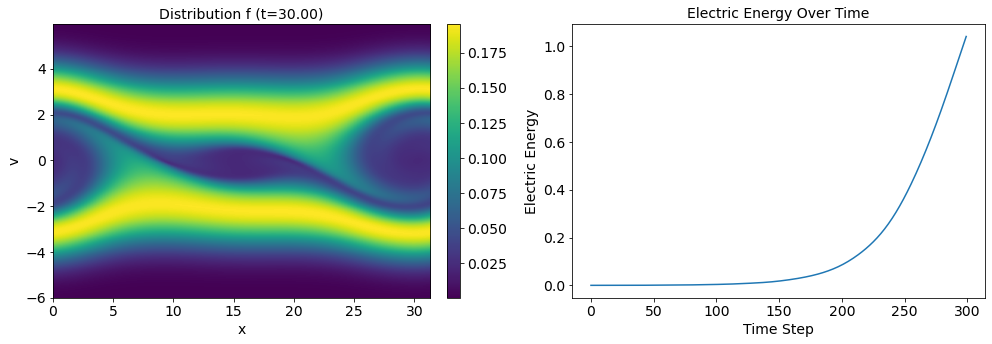

Iteration 69, Cost (KL Divergence): 7.182043075561523, Coefficients: [-7.2713650e-04 -7.7271194e-04 -7.1764475e-04 -4.9644185e-04
 -5.3423562e-04 -3.1348917e-04 -2.1554928e-04 -1.0371463e-04
 -4.0274736e-05 -9.3403949e-05 -4.8879378e-05 -1.3088167e-04
 -6.3020379e-05 -5.8467238e-05  2.1149854e-05  4.6146940e-04
 -1.5556498e-03 -6.5113241e-03 -5.4062591e-03 -3.3001560e-03
 -1.5691413e-03 -2.1292949e-04  4.5097520e-04  6.8211911e-04
  6.0328533e-04  2.2479788e-04  1.2045374e-04  1.0680070e-04
  1.4848387e-04  1.1183996e-04]


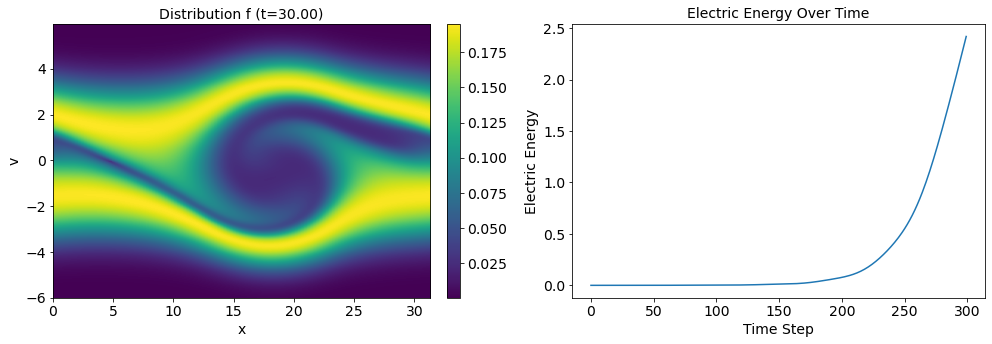

Iteration 70, Cost (KL Divergence): 2.831890106201172, Coefficients: [-4.2834715e-04 -7.9467183e-04 -7.9017587e-04 -5.1292212e-04
 -5.6243787e-04 -3.1624193e-04 -2.3301443e-04 -1.1965020e-04
 -5.5332675e-05 -1.1166202e-04 -6.4580927e-05 -1.5256241e-04
 -7.5952259e-05 -7.4276919e-05  1.2531963e-05 -4.5299605e-03
 -3.4482854e-03 -6.8797143e-03 -5.5565098e-03 -3.3867988e-03
 -1.6067141e-03 -2.3532046e-04  4.6932726e-04  6.8099966e-04
  6.1392924e-04  2.0961992e-04  1.2574600e-04  1.0765598e-04
  1.5726787e-04  1.2475213e-04]


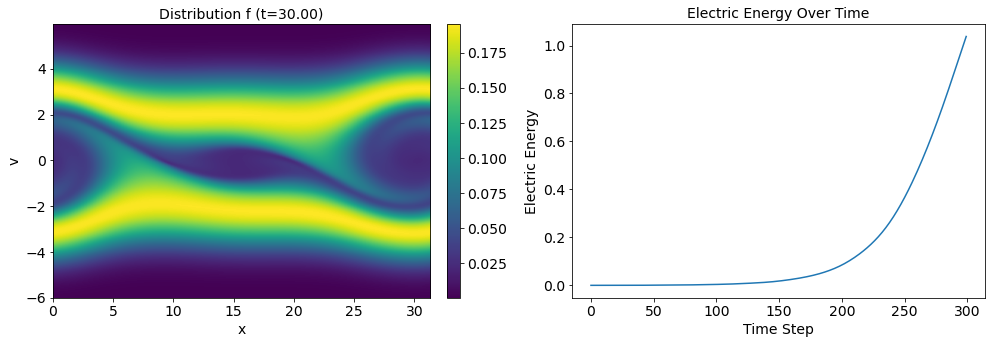

Iteration 71, Cost (KL Divergence): 7.184871196746826, Coefficients: [-7.27206934e-04 -7.72213447e-04 -7.35556416e-04 -4.98883077e-04
 -5.48567914e-04 -3.18472012e-04 -2.20875067e-04 -1.07610991e-04
 -3.64115258e-05 -9.72136695e-05 -4.52056265e-05 -1.36830771e-04
 -6.37929843e-05 -6.37502890e-05  2.12877203e-05  4.36120201e-04
 -1.57962262e-03 -6.67038793e-03 -5.59309404e-03 -3.42631550e-03
 -1.63478206e-03 -2.40760302e-04  4.64287034e-04  7.00128148e-04
  6.25137007e-04  2.31428916e-04  1.20223231e-04  1.06037362e-04
  1.47891798e-04  1.13916474e-04]


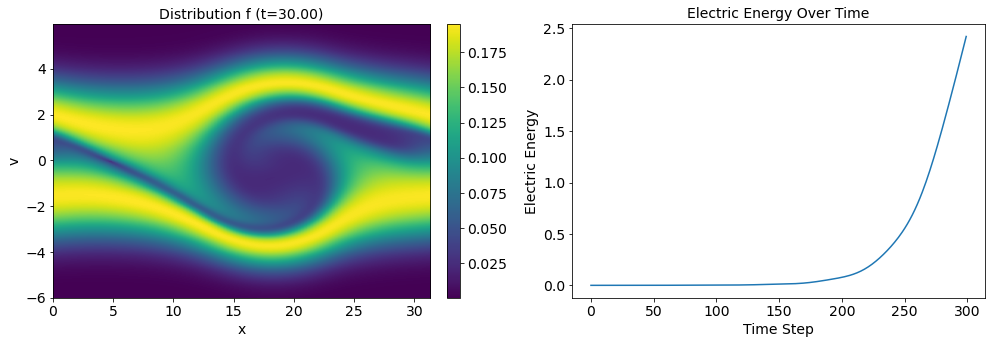

Iteration 72, Cost (KL Divergence): 2.8302559852600098, Coefficients: [-4.27968276e-04 -7.92859006e-04 -8.07946082e-04 -5.15106076e-04
 -5.76768303e-04 -3.21314496e-04 -2.38100212e-04 -1.23851540e-04
 -5.10025347e-05 -1.15665047e-04 -6.00993990e-05 -1.58752548e-04
 -7.66028534e-05 -7.95803062e-05  1.23966902e-05 -4.55728918e-03
 -3.47035890e-03 -7.03975838e-03 -5.74368518e-03 -3.51313967e-03
 -1.67223311e-03 -2.63659720e-04  4.83210286e-04  6.99071214e-04
  6.35836797e-04  2.16610759e-04  1.24438360e-04  1.07047774e-04
  1.56003560e-04  1.26788451e-04]


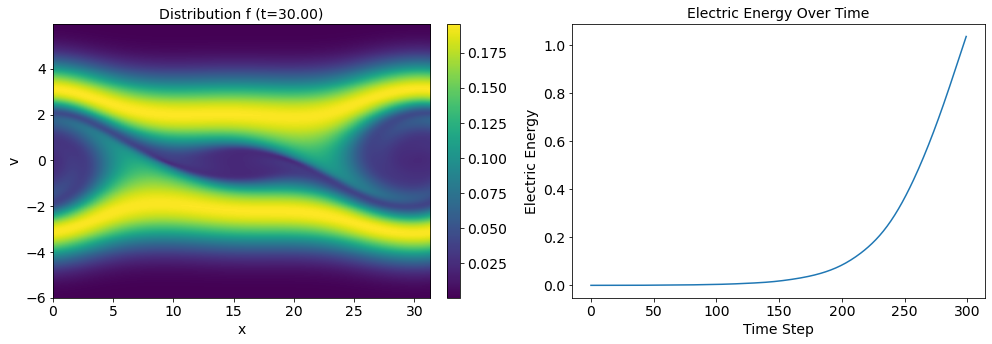

Iteration 73, Cost (KL Divergence): 7.183387756347656, Coefficients: [-7.2796491e-04 -7.7023881e-04 -7.5306930e-04 -5.0080381e-04
 -5.6294864e-04 -3.2335203e-04 -2.2576528e-04 -1.1189866e-04
 -3.2214892e-05 -1.0139482e-04 -4.0747713e-05 -1.4311964e-04
 -6.4130218e-05 -6.9129994e-05  2.1189098e-05  4.0825643e-04
 -1.6043885e-03 -6.8284790e-03 -5.7778931e-03 -3.5535302e-03
 -1.6998203e-03 -2.6834058e-04  4.7677231e-04  7.1866723e-04
  6.4683479e-04  2.3852865e-04  1.1982362e-04  1.0549729e-04
  1.4688124e-04  1.1612841e-04]


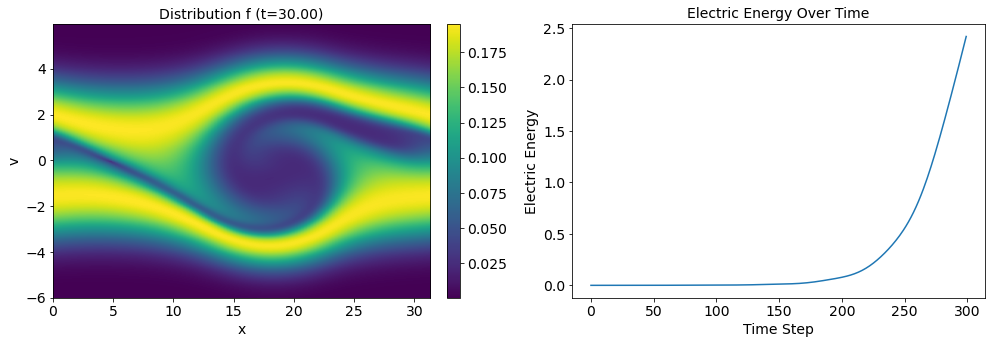

Iteration 74, Cost (KL Divergence): 2.8284003734588623, Coefficients: [-4.2839747e-04 -7.9018850e-04 -8.2614960e-04 -5.1669113e-04
 -5.9139711e-04 -3.2619806e-04 -2.4310997e-04 -1.2819936e-04
 -4.6941634e-05 -1.1978584e-04 -5.5829394e-05 -1.6485681e-04
 -7.6979217e-05 -8.4991210e-05  1.2159245e-05 -4.5843506e-03
 -3.4937363e-03 -7.1983007e-03 -5.9290924e-03 -3.6399669e-03
 -1.7373845e-03 -2.9124468e-04  4.9591745e-04  7.1769778e-04
  6.5755215e-04  2.2403768e-04  1.2367535e-04  1.0660049e-04
  1.5496807e-04  1.2872677e-04]


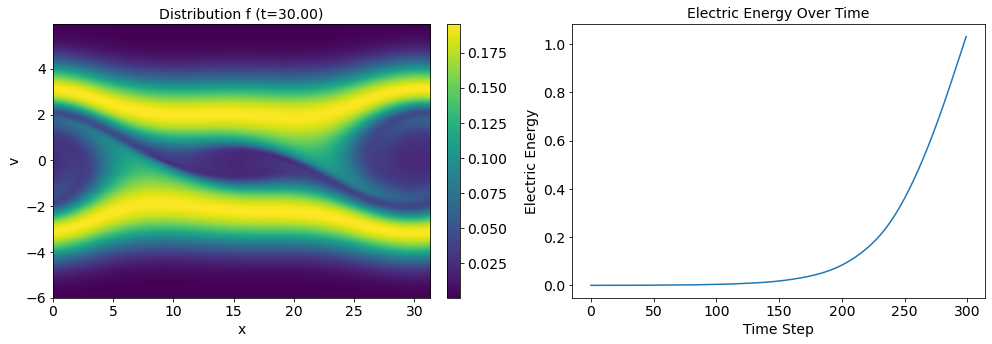

Iteration 75, Cost (KL Divergence): 7.182382106781006, Coefficients: [-7.28674524e-04 -7.68389145e-04 -7.70968210e-04 -5.02492650e-04
 -5.77653409e-04 -3.28170951e-04 -2.30583144e-04 -1.16301766e-04
 -2.82499641e-05 -1.05307772e-04 -3.71611968e-05 -1.48962165e-04
 -6.47571433e-05 -7.43833953e-05  2.09115751e-05  3.80198006e-04
 -1.62985118e-03 -6.98532024e-03 -5.96065167e-03 -3.68186296e-03
 -1.76416500e-03 -2.95872771e-04  4.88656107e-04  7.37390888e-04
  6.68382039e-04  2.45881412e-04  1.20121877e-04  1.04557330e-04
  1.46412844e-04  1.18206292e-04]


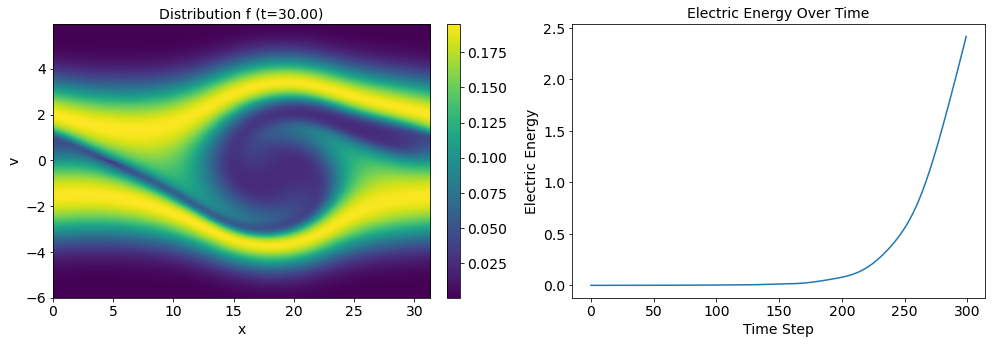

Iteration 76, Cost (KL Divergence): 2.8274970054626465, Coefficients: [-4.2856811e-04 -7.8725669e-04 -8.4418268e-04 -5.1824731e-04
 -6.0625421e-04 -3.3120270e-04 -2.4758792e-04 -1.3304420e-04
 -4.2875658e-05 -1.2359185e-04 -5.2167143e-05 -1.7077234e-04
 -7.7579047e-05 -9.0082234e-05  1.1272054e-05 -4.6121357e-03
 -3.5169520e-03 -7.3559280e-03 -6.1122188e-03 -3.7681737e-03
 -1.8015198e-03 -3.1925814e-04  5.0842128e-04  7.3664892e-04
  6.7878613e-04  2.3211278e-04  1.2311769e-04  1.0573840e-04
  1.5428594e-04  1.3060067e-04]


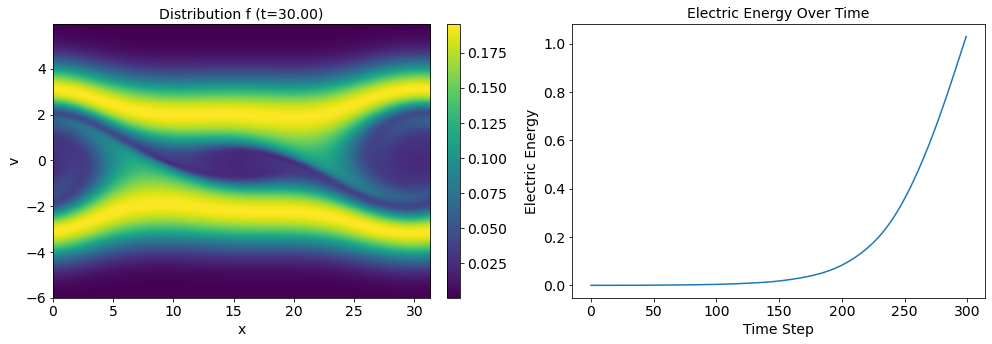

Iteration 77, Cost (KL Divergence): 7.178314208984375, Coefficients: [-7.29687919e-04 -7.65341683e-04 -7.88942911e-04 -5.04129683e-04
 -5.92518889e-04 -3.32862663e-04 -2.35436222e-04 -1.20826197e-04
 -2.45329029e-05 -1.09452034e-04 -3.34667420e-05 -1.55068716e-04
 -6.54602482e-05 -7.90324630e-05  1.96056899e-05  3.50728165e-04
 -1.65566034e-03 -7.14164041e-03 -6.14126399e-03 -3.81076010e-03
 -1.82806782e-03 -3.23177606e-04  5.00118244e-04  7.56644644e-04
  6.89099019e-04  2.54099694e-04  1.20686156e-04  1.03861217e-04
  1.45793718e-04  1.20796292e-04]


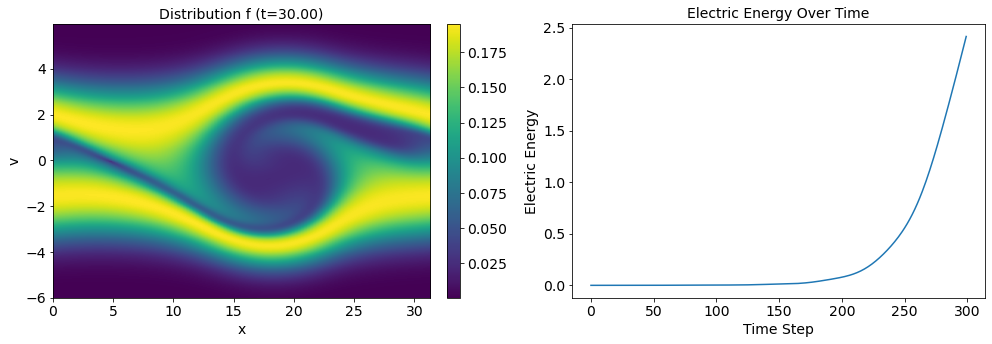

Iteration 78, Cost (KL Divergence): 2.826166868209839, Coefficients: [-4.28812404e-04 -7.83175870e-04 -8.62659712e-04 -5.19842666e-04
 -6.21084473e-04 -3.36216239e-04 -2.52192229e-04 -1.37940326e-04
 -3.89030138e-05 -1.27995911e-04 -4.84014417e-05 -1.76701738e-04
 -7.85759912e-05 -9.44639687e-05  9.55446922e-06 -4.63949470e-03
 -3.54063278e-03 -7.51277851e-03 -6.29330752e-03 -3.89687554e-03
 -1.86506414e-03 -3.46857210e-04  5.20151341e-04  7.56173395e-04
  6.99382101e-04  2.40554757e-04  1.23306818e-04  1.05551146e-04
  1.53026675e-04  1.33325593e-04]


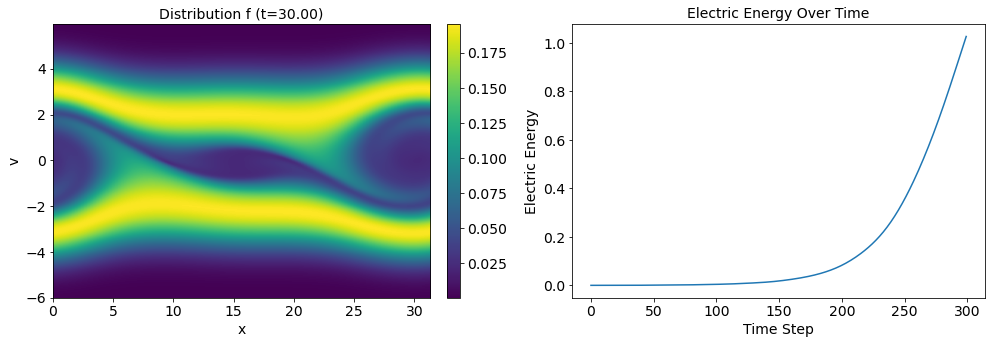

Iteration 79, Cost (KL Divergence): 7.167067050933838, Coefficients: [-7.29200547e-04 -7.61306321e-04 -8.07558245e-04 -5.05548611e-04
 -6.06868882e-04 -3.38064594e-04 -2.39515022e-04 -1.25769380e-04
 -2.04014668e-05 -1.14111790e-04 -2.95259142e-05 -1.61286414e-04
 -6.60286678e-05 -8.36290637e-05  1.82777003e-05  3.21979634e-04
 -1.68163853e-03 -7.29684578e-03 -6.31992146e-03 -3.94065725e-03
 -1.89118565e-03 -3.50128626e-04  5.10441139e-04  7.76403293e-04
  7.09361397e-04  2.62142537e-04  1.21918740e-04  1.03297716e-04
  1.44811434e-04  1.23842619e-04]


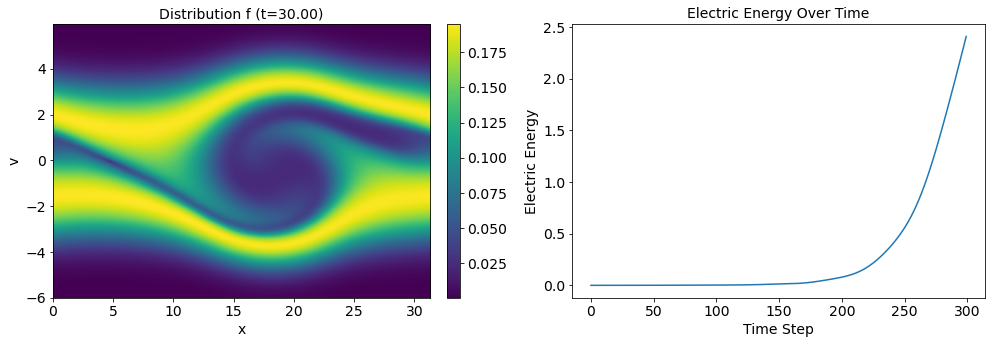

Iteration 80, Cost (KL Divergence): 2.825718879699707, Coefficients: [-4.2763763e-04 -7.7897531e-04 -8.8171585e-04 -5.2119046e-04
 -6.3607632e-04 -3.4114622e-04 -2.5646776e-04 -1.4296098e-04
 -3.4453755e-05 -1.3299906e-04 -4.4311761e-05 -1.8314601e-04
 -7.9308280e-05 -9.8823773e-05  7.7471732e-06 -4.6685743e-03
 -3.5645857e-03 -7.6687052e-03 -6.4722337e-03 -4.0265950e-03
 -1.9282396e-03 -3.7391219e-04  5.3051359e-04  7.7645417e-04
  7.1925041e-04  2.4908010e-04  1.2444101e-04  1.0449389e-04
  1.5225763e-04  1.3615217e-04]


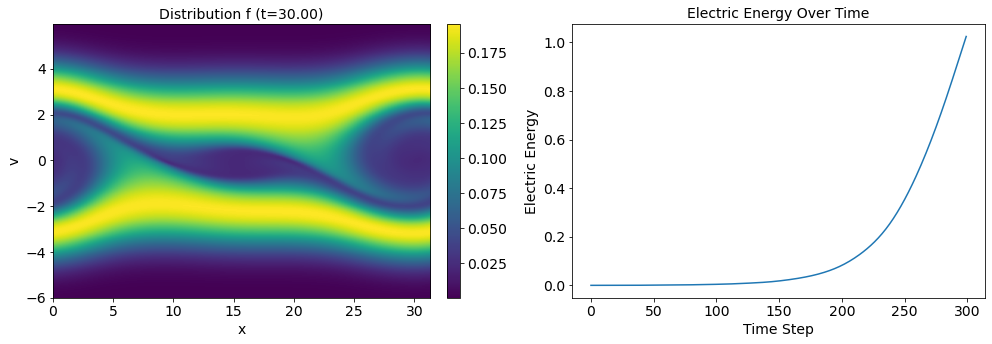

Iteration 81, Cost (KL Divergence): 7.153565406799316, Coefficients: [-7.28489365e-04 -7.57025380e-04 -8.25258787e-04 -5.06700482e-04
 -6.21594954e-04 -3.42485931e-04 -2.43670336e-04 -1.31026871e-04
 -1.55860689e-05 -1.19253760e-04 -2.51813562e-05 -1.67416452e-04
 -6.65522457e-05 -8.79438448e-05  1.64946396e-05  2.91423872e-04
 -1.70776853e-03 -7.45177176e-03 -6.49710838e-03 -4.07122541e-03
 -1.95388077e-03 -3.76744661e-04  5.19852445e-04  7.96498847e-04
  7.29057938e-04  2.70331395e-04  1.23664737e-04  1.02447666e-04
  1.44194637e-04  1.26829837e-04]


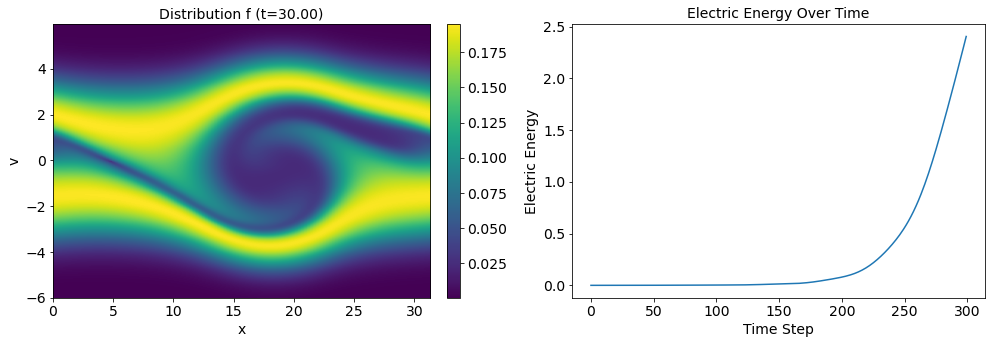

Iteration 82, Cost (KL Divergence): 2.8280320167541504, Coefficients: [-4.2677307e-04 -7.7382225e-04 -8.9988223e-04 -5.2224909e-04
 -6.5090338e-04 -3.4579993e-04 -2.6027480e-04 -1.4860812e-04
 -2.9087949e-05 -1.3858642e-04 -3.9582450e-05 -1.8952982e-04
 -7.9989331e-05 -1.0269505e-04  5.1593761e-06 -4.6997545e-03
 -3.5892837e-03 -7.8243930e-03 -6.6496357e-03 -4.1571204e-03
 -1.9907211e-03 -4.0066047e-04  5.4003811e-04  7.9695595e-04
  7.3865568e-04  2.5782213e-04  1.2552271e-04  1.0399566e-04
  1.5117318e-04  1.3906410e-04]


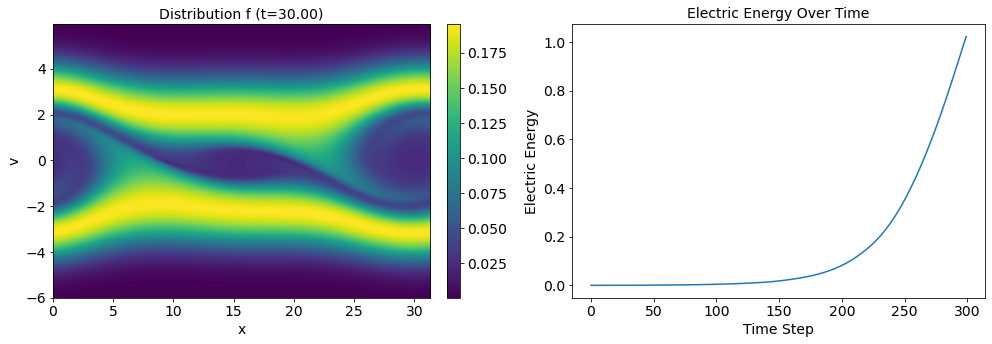

Iteration 83, Cost (KL Divergence): 7.133139610290527, Coefficients: [-7.2811655e-04 -7.5074064e-04 -8.4351737e-04 -5.0709263e-04
 -6.3581916e-04 -3.4714412e-04 -2.4720043e-04 -1.3636956e-04
 -1.0121163e-05 -1.2470967e-04 -2.0458641e-05 -1.7347993e-04
 -6.7199959e-05 -9.1863170e-05  1.4137252e-05  2.5801966e-04
 -1.7366086e-03 -7.6069217e-03 -6.6724326e-03 -4.2030108e-03
 -2.0160936e-03 -4.0278610e-04  5.2847137e-04  8.1721274e-04
  7.4841792e-04  2.7838632e-04  1.2574837e-04  1.0172115e-04
  1.4277612e-04  1.3054596e-04]


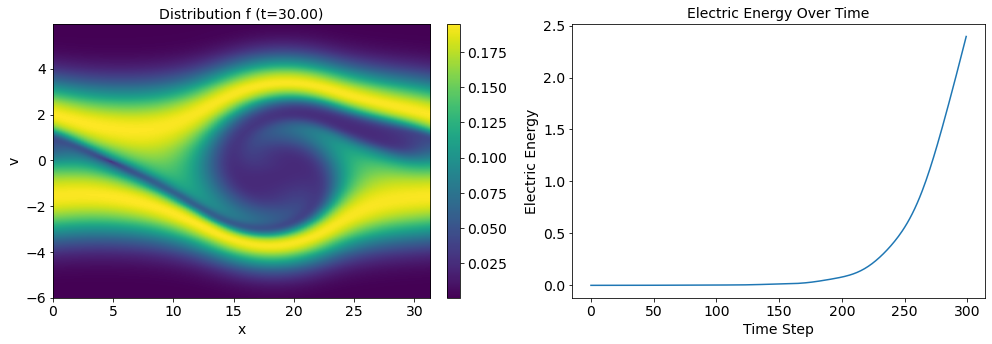

Iteration 84, Cost (KL Divergence): 2.8282339572906494, Coefficients: [-4.2593866e-04 -7.6766568e-04 -9.1841933e-04 -5.2241120e-04
 -6.6558155e-04 -3.5073480e-04 -2.6367942e-04 -1.5439373e-04
 -2.3810582e-05 -1.4380029e-04 -3.4996061e-05 -1.9521861e-04
 -8.1017803e-05 -1.0643152e-04  2.5245181e-06 -4.7301929e-03
 -3.6154892e-03 -7.9798624e-03 -6.8254448e-03 -4.2889435e-03
 -2.0528708e-03 -4.2681236e-04  5.4872257e-04  8.1800245e-04
  7.5800758e-04  2.6639522e-04  1.2693001e-04  1.0337417e-04
  1.4975361e-04  1.4245430e-04]


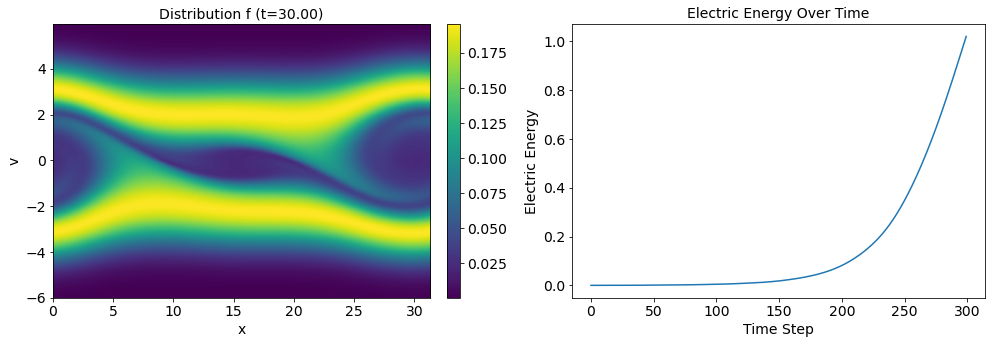

Iteration 85, Cost (KL Divergence): 7.1119279861450195, Coefficients: [-7.27089180e-04 -7.44856894e-04 -8.61180073e-04 -5.07263292e-04
 -6.50527596e-04 -3.51662806e-04 -2.50190147e-04 -1.42439545e-04
 -4.43865429e-06 -1.30259199e-04 -1.55041052e-05 -1.79622817e-04
 -6.77317730e-05 -9.55961586e-05  1.16263145e-05  2.24569347e-04
 -1.76562520e-03 -7.76174199e-03 -6.84667472e-03 -4.33557667e-03
 -2.07850826e-03 -4.28243104e-04  5.36398788e-04  8.38030013e-04
  7.67786871e-04  2.86868191e-04  1.27437597e-04  1.01126585e-04
  1.41531287e-04  1.33969443e-04]


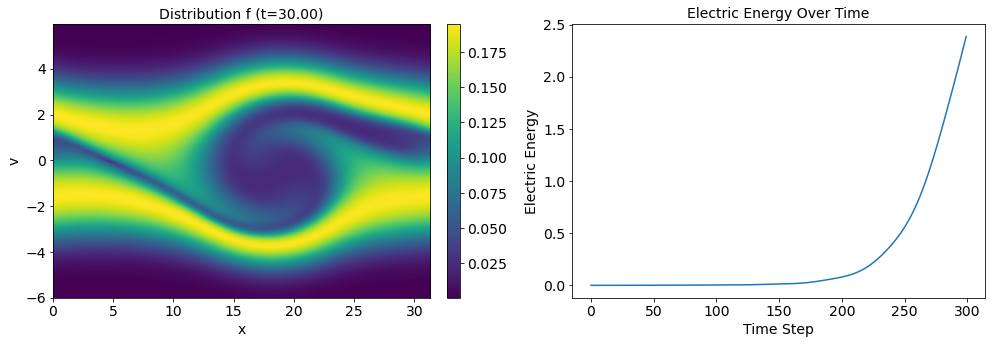

Iteration 86, Cost (KL Divergence): 2.827345371246338, Coefficients: [-4.23716294e-04 -7.61898991e-04 -9.36277327e-04 -5.22729824e-04
 -6.80668047e-04 -3.55065422e-04 -2.66850053e-04 -1.60664335e-04
 -1.78632581e-05 -1.49672240e-04 -2.98835621e-05 -2.01522416e-04
 -8.15621679e-05 -1.09891815e-04 -5.05204298e-07 -4.76148538e-03
 -3.64280073e-03 -8.13527126e-03 -6.99996902e-03 -4.42161737e-03
 -2.11523939e-03 -4.52155335e-04  5.56407613e-04  8.39362561e-04
  7.77327106e-04  2.75096361e-04  1.28361964e-04  1.02682010e-04
  1.48489285e-04  1.45365993e-04]


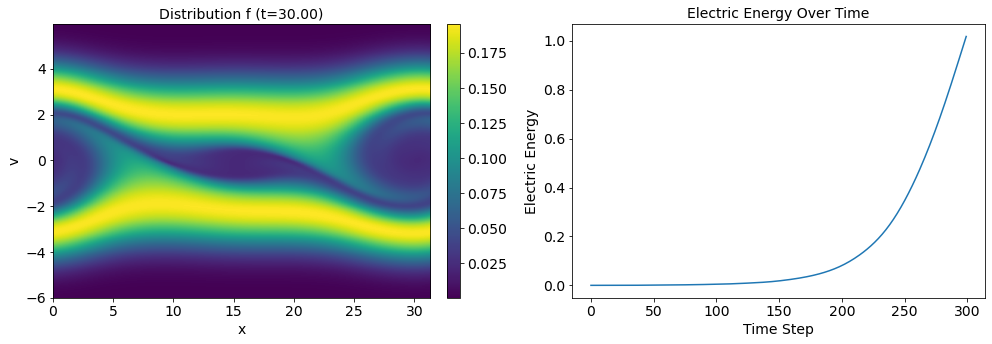

Iteration 87, Cost (KL Divergence): 7.084593772888184, Coefficients: [-7.25152146e-04 -7.38157367e-04 -8.78624909e-04 -5.07278892e-04
 -6.65033003e-04 -3.55670316e-04 -2.53332139e-04 -1.48515770e-04
  1.80403731e-06 -1.36298913e-04 -1.03301554e-05 -1.85525350e-04
 -6.82936225e-05 -9.89642722e-05  8.75324804e-06  1.91303436e-04
 -1.79557467e-03 -7.91676342e-03 -7.01957289e-03 -4.46929457e-03
 -2.14080280e-03 -4.53025306e-04  5.43428876e-04  8.59319640e-04
  7.87268335e-04  2.94966099e-04  1.29486827e-04  1.00528545e-04
  1.39927535e-04  1.37408366e-04]


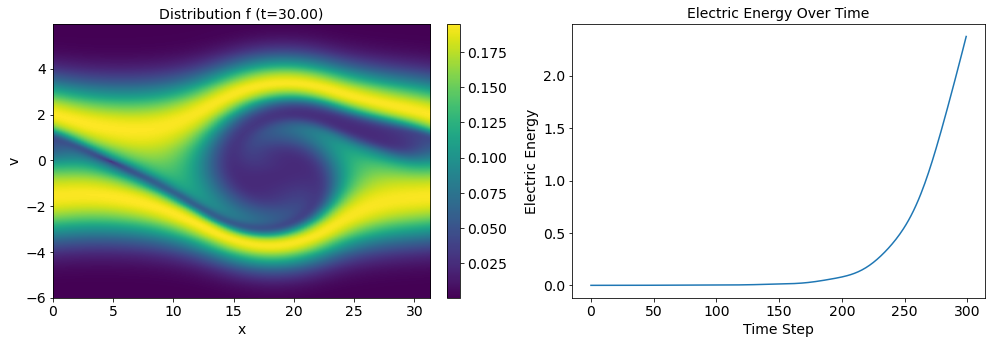

Iteration 88, Cost (KL Divergence): 2.829613208770752, Coefficients: [-4.2207612e-04 -7.5446384e-04 -9.5417729e-04 -5.2221701e-04
 -6.9505977e-04 -3.5924237e-04 -2.6970965e-04 -1.6687217e-04
 -1.1313033e-05 -1.5561804e-04 -2.4338004e-05 -2.0716175e-04
 -8.2309969e-05 -1.1256821e-04 -4.1746616e-06 -4.7945562e-03
 -3.6705106e-03 -8.2912669e-03 -7.1730576e-03 -4.5556519e-03
 -2.1774028e-03 -4.7719214e-04  5.6324544e-04  8.6137204e-04
  7.9594372e-04  2.8373269e-04  1.2971678e-04  1.0187161e-04
  1.4656238e-04  1.4858512e-04]


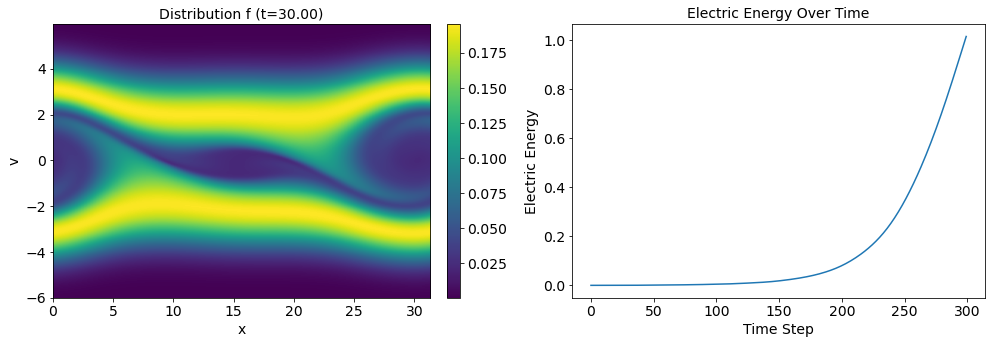

Iteration 89, Cost (KL Divergence): 7.053868293762207, Coefficients: [-7.2331994e-04 -7.3100644e-04 -8.9602591e-04 -5.0657842e-04
 -6.7916181e-04 -3.5994643e-04 -2.5568734e-04 -1.5510149e-04
  8.6330756e-06 -1.4218209e-04 -4.7154590e-06 -1.9128033e-04
 -6.8680965e-05 -1.0194081e-04  5.1734241e-06  1.5528360e-04
 -1.8274843e-03 -8.0725914e-03 -7.1912757e-03 -4.6043680e-03
 -2.2027099e-03 -4.7745553e-04  5.4971536e-04  8.8128069e-04
  8.0620061e-04  3.0317894e-04  1.3138443e-04  9.9648605e-05
  1.3804188e-04  1.4090214e-04]


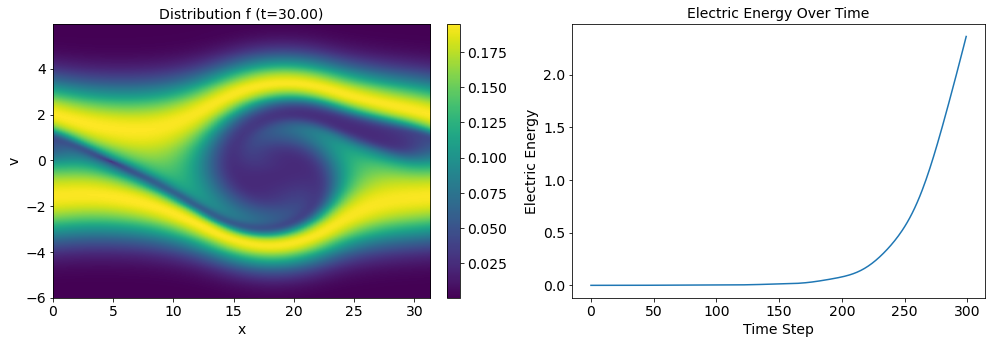

Iteration 90, Cost (KL Divergence): 2.8298261165618896, Coefficients: [-4.1974123e-04 -7.4675691e-04 -9.7159285e-04 -5.2092987e-04
 -7.0937938e-04 -3.6318778e-04 -2.7210204e-04 -1.7338396e-04
 -4.1896492e-06 -1.6143025e-04 -1.8177783e-05 -2.1277259e-04
 -8.2566585e-05 -1.1532880e-04 -8.0004475e-06 -4.8275087e-03
 -3.6996701e-03 -8.4476685e-03 -7.3451577e-03 -4.6904441e-03
 -2.2399281e-03 -5.0147984e-04  5.6941737e-04  8.8352693e-04
  8.1462204e-04  2.9206483e-04  1.3121410e-04  1.0041981e-04
  1.4458949e-04  1.5154391e-04]


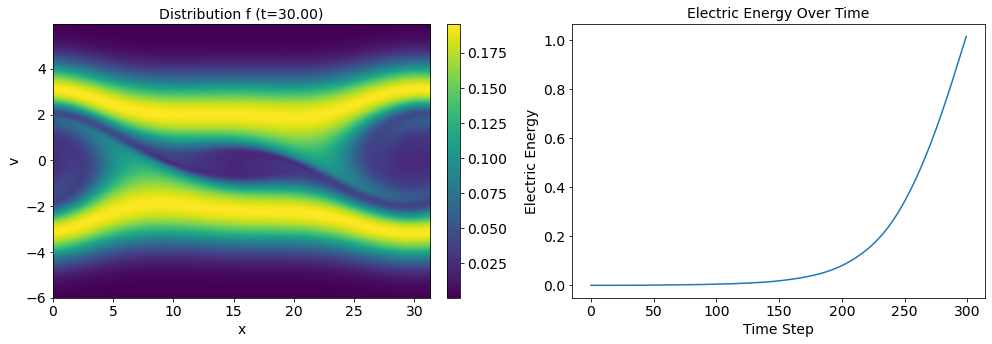

Iteration 91, Cost (KL Divergence): 7.023922920227051, Coefficients: [-7.21617485e-04 -7.23871344e-04 -9.13319760e-04 -5.05579636e-04
 -6.93188456e-04 -3.63789586e-04 -2.58184649e-04 -1.61673102e-04
  1.60548389e-05 -1.48530191e-04  1.17014315e-06 -1.96772424e-04
 -6.89744847e-05 -1.04866878e-04  1.51088079e-06  1.19371805e-04
 -1.86057354e-03 -8.22932087e-03 -7.36166863e-03 -4.73991688e-03
 -2.26564379e-03 -5.01016213e-04  5.55729959e-04  9.02965490e-04
  8.25118390e-04  3.11465614e-04  1.33218229e-04  9.84448343e-05
  1.35939525e-04  1.44201098e-04]


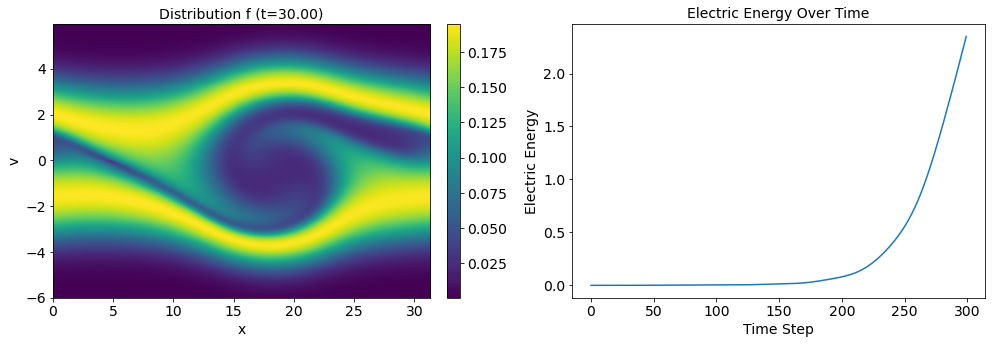

Iteration 92, Cost (KL Divergence): 2.827681541442871, Coefficients: [-4.1770778e-04 -7.3934346e-04 -9.8909298e-04 -5.1954901e-04
 -7.2354986e-04 -3.6692229e-04 -2.7420666e-04 -1.7999702e-04
  3.5533403e-06 -1.6772865e-04 -1.2104415e-05 -2.1785493e-04
 -8.3317020e-05 -1.1733207e-04 -1.2088294e-05 -4.8603695e-03
 -3.7310780e-03 -8.6054150e-03 -7.5157057e-03 -4.8261862e-03
 -2.3029335e-03 -5.2482192e-04  5.7483133e-04  9.0565078e-04
  8.3300855e-04  3.0030575e-04  1.3278032e-04  9.8986042e-05
  1.4222585e-04  1.5445733e-04]


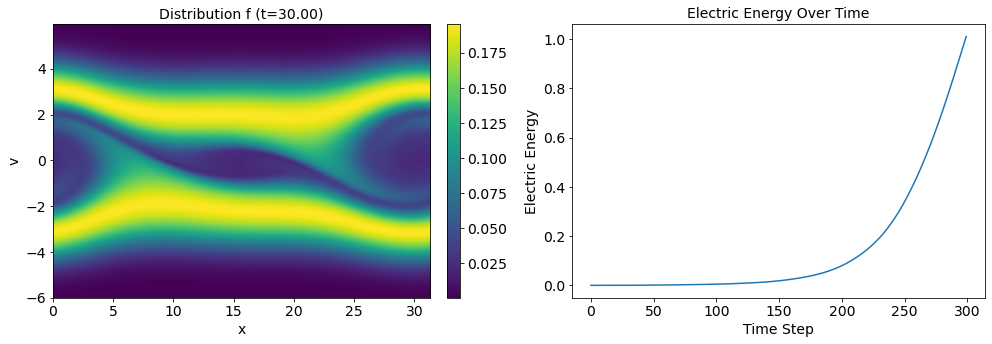

Iteration 93, Cost (KL Divergence): 6.992769241333008, Coefficients: [-7.1967836e-04 -7.1769673e-04 -9.3033840e-04 -5.0451356e-04
 -7.0716598e-04 -3.6749919e-04 -2.6025058e-04 -1.6863459e-04
  2.4182667e-05 -1.5530878e-04  7.1513505e-06 -2.0159726e-04
 -6.9858499e-05 -1.0712334e-04 -2.2152617e-06  8.1795268e-05
 -1.8955406e-03 -8.3871773e-03 -7.5306450e-03 -4.8764409e-03
 -2.3287060e-03 -5.2402634e-04  5.6100969e-04  9.2486659e-04
  8.4361021e-04  3.1925499e-04  1.3562257e-04  9.6839067e-05
  1.3338131e-04  1.4766277e-04]


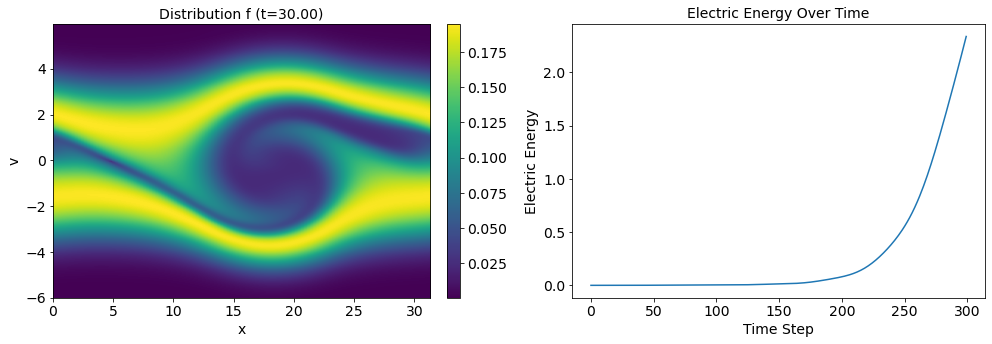

Iteration 94, Cost (KL Divergence): 2.8246755599975586, Coefficients: [-4.1468811e-04 -7.3254498e-04 -1.0065116e-03 -5.1830575e-04
 -7.3792395e-04 -3.7041958e-04 -2.7617070e-04 -1.8734267e-04
  1.2390729e-05 -1.7496613e-04 -5.9216636e-06 -2.2251958e-04
 -8.4540843e-05 -1.1892611e-04 -1.6672409e-05 -4.8934645e-03
 -3.7623039e-03 -8.7642707e-03 -7.6843286e-03 -4.9631358e-03
 -2.3659472e-03 -5.4747268e-04  5.7930127e-04  9.2851731e-04
  8.5082033e-04  3.0853806e-04  1.3495333e-04  9.7186195e-05
  1.3990724e-04  1.5729158e-04]


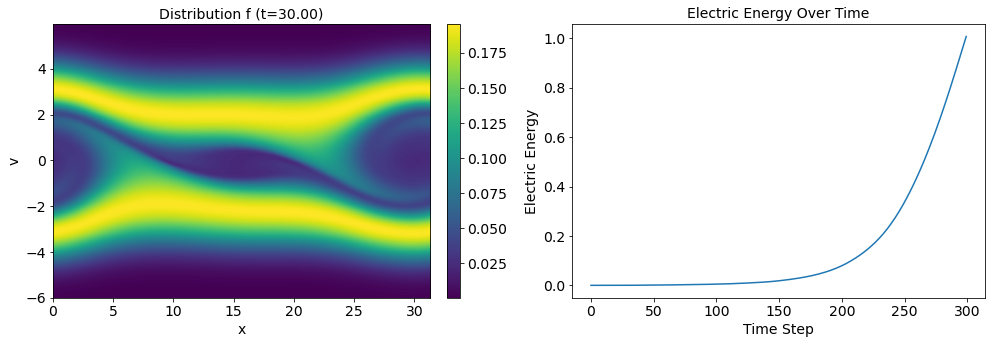

Iteration 95, Cost (KL Divergence): 6.955750465393066, Coefficients: [-7.16584385e-04 -7.10239867e-04 -9.47748078e-04 -5.02837356e-04
 -7.21396354e-04 -3.70956259e-04 -2.61843088e-04 -1.75987007e-04
  3.31189076e-05 -1.62671640e-04  1.36179588e-05 -2.06658267e-04
 -7.07785366e-05 -1.08797525e-04 -6.52857671e-06  4.48343344e-05
 -1.93088665e-03 -8.54609534e-03 -7.69808469e-03 -5.01417182e-03
 -2.39195791e-03 -5.45734598e-04  5.64561517e-04  9.47868451e-04
  8.61422683e-04  3.27128742e-04  1.38259682e-04  9.55109135e-05
  1.30672168e-04  1.50925742e-04]


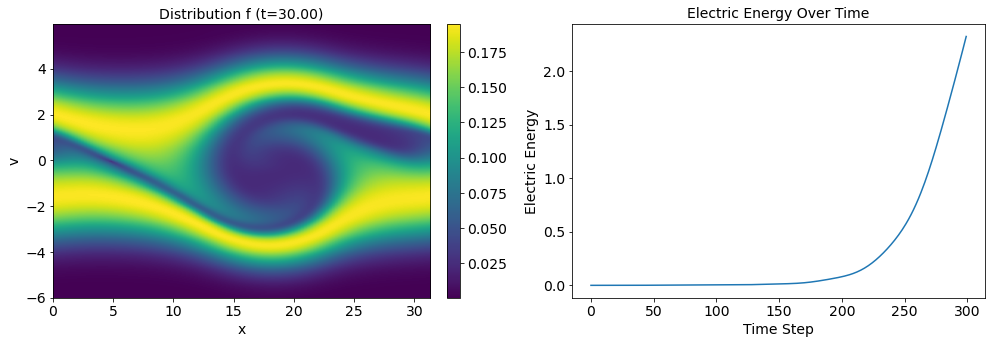

Iteration 96, Cost (KL Divergence): 2.822301149368286, Coefficients: [-4.11137211e-04 -7.25358899e-04 -1.02444598e-03 -5.16056083e-04
 -7.53303815e-04 -3.73077113e-04 -2.78408465e-04 -1.94707682e-04
  2.16811095e-05 -1.82886812e-04  9.22824256e-07 -2.27833196e-04
 -8.54315076e-05 -1.20312456e-04 -2.16755980e-05 -4.92795184e-03
 -3.79418209e-03 -8.92435759e-03 -7.85157550e-03 -5.10078343e-03
 -2.42958381e-03 -5.68602583e-04  5.82185632e-04  9.52291826e-04
  8.68030416e-04  3.16625315e-04  1.37898722e-04  9.50447065e-05
  1.37945754e-04  1.60123454e-04]


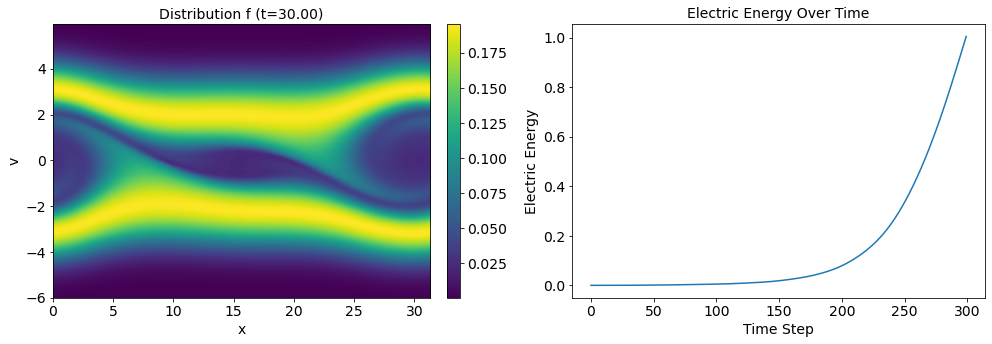

Iteration 97, Cost (KL Divergence): 6.916522979736328, Coefficients: [-7.1304501e-04 -7.0312578e-04 -9.6512301e-04 -5.0070556e-04
 -7.3643477e-04 -3.7331998e-04 -2.6392832e-04 -1.8331870e-04
  4.2627355e-05 -1.7049727e-04  2.0023532e-05 -2.1152938e-04
 -7.1822622e-05 -1.0992193e-04 -1.1740662e-05  6.2379986e-06
 -1.9662261e-03 -8.7065557e-03 -7.8641921e-03 -5.1528323e-03
 -2.4552965e-03 -5.6672376e-04  5.6739879e-04  9.7121514e-04
  8.7927270e-04  3.3459431e-04  1.4171898e-04  9.3582406e-05
  1.2852588e-04  1.5376727e-04]


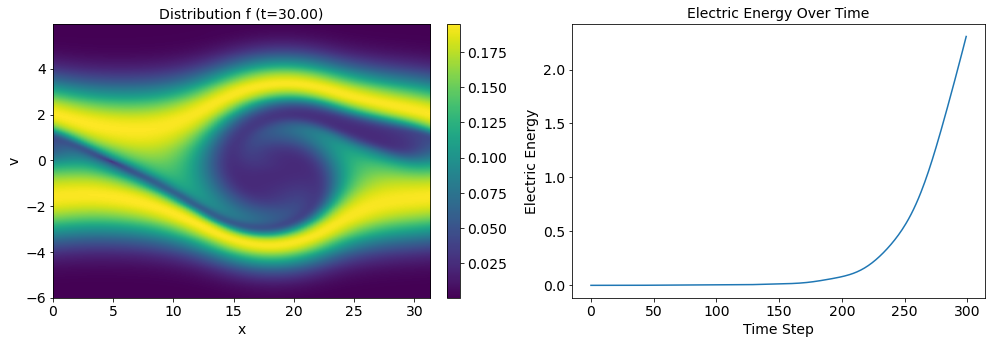

Iteration 98, Cost (KL Divergence): 2.8224422931671143, Coefficients: [-4.06005827e-04 -7.18723924e-04 -1.04280189e-03 -5.12378931e-04
 -7.70509185e-04 -3.73735529e-04 -2.81647313e-04 -2.02057796e-04
  3.19070277e-05 -1.91886298e-04  8.57074610e-06 -2.33338244e-04
 -8.65600450e-05 -1.20529905e-04 -2.85025653e-05 -4.96537611e-03
 -3.82601935e-03 -9.08757374e-03 -8.01631901e-03 -5.24003943e-03
 -2.49361782e-03 -5.87944989e-04  5.82923589e-04  9.77774733e-04
  8.84794397e-04  3.24284279e-04  1.42176708e-04  9.14757184e-05
  1.37118375e-04  1.61761665e-04]


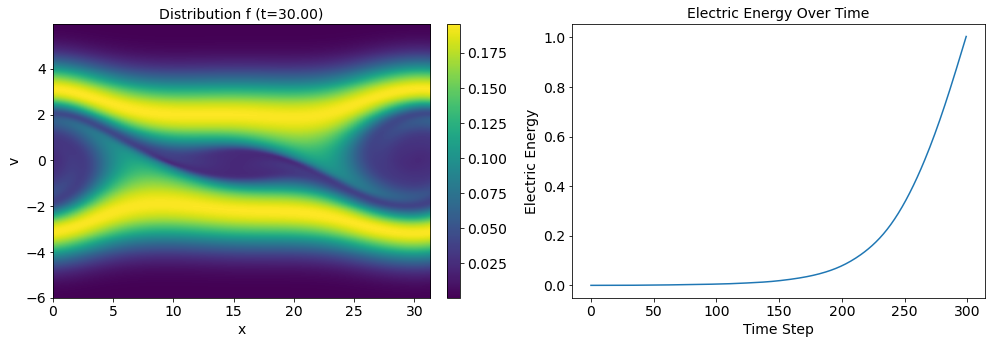

Iteration 99, Cost (KL Divergence): 6.871835708618164, Coefficients: [-7.0896198e-04 -6.9536170e-04 -9.8252459e-04 -4.9700361e-04
 -7.5318874e-04 -3.7363949e-04 -2.6660229e-04 -1.9056100e-04
  5.3492826e-05 -1.7967341e-04  2.7598242e-05 -2.1703292e-04
 -7.2845301e-05 -1.1003019e-04 -1.8263439e-05 -3.4445431e-05
 -2.0031999e-03 -8.8708242e-03 -8.0282213e-03 -5.2925190e-03
 -2.5192625e-03 -5.8554945e-04  5.6839408e-04  9.9605671e-04
  8.9629955e-04  3.4204536e-04  1.4626258e-04  9.0251109e-05
  1.2801032e-04  1.5521749e-04]


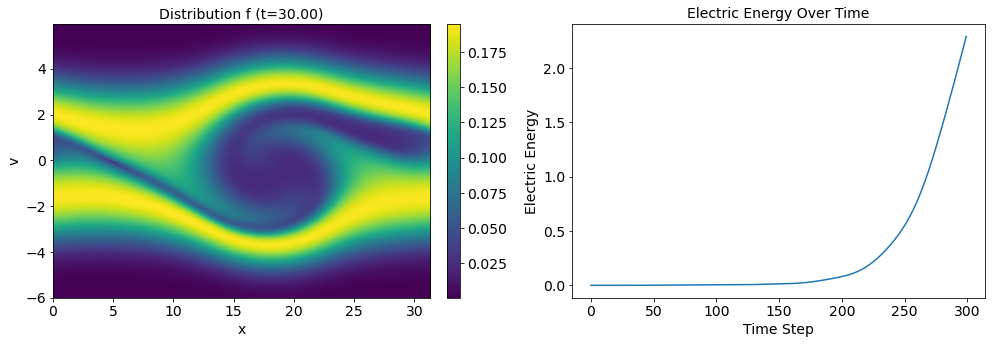

Iteration 100, Cost (KL Divergence): 2.821425199508667, Coefficients: [-4.0194398e-04 -7.1046141e-04 -1.0606049e-03 -5.0782308e-04
 -7.8824791e-04 -3.7361897e-04 -2.8430417e-04 -2.0973367e-04
  4.3151187e-05 -2.0138318e-04  1.6396394e-05 -2.3856777e-04
 -8.8215282e-05 -1.1953929e-04 -3.6015052e-05 -5.0017545e-03
 -3.8593421e-03 -9.2533696e-03 -8.1797242e-03 -5.3800330e-03
 -2.5578665e-03 -6.0593564e-04  5.8277202e-04  1.0039732e-03
  9.0120104e-04  3.3202648e-04  1.4689953e-04  8.7716187e-05
  1.3674118e-04  1.6280918e-04]


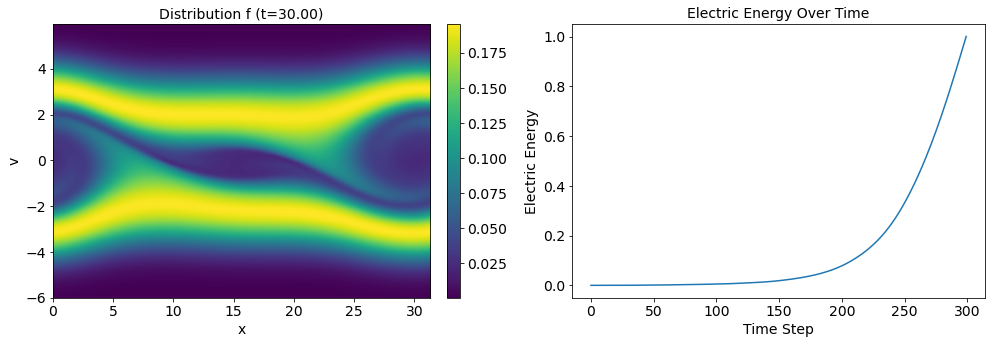

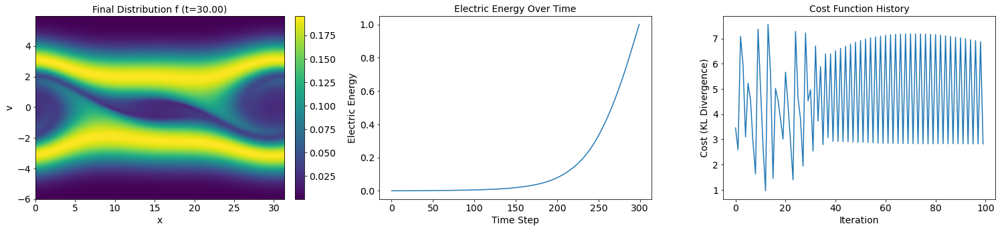

Best Loss (KL Divergence): 0.9617255330085754
Optimal Coefficients: [-2.4012156e-04 -8.0238911e-04 -2.6945458e-04 -1.8072431e-04
 -1.2685658e-04 -9.1386777e-05 -1.3504943e-04 -6.4513253e-05
 -6.0036553e-05 -3.5465098e-05 -4.9200687e-05 -1.7787690e-05
 -3.2486194e-05 -1.3187422e-05 -2.3041157e-05 -1.5840281e-03
 -1.5420401e-03 -1.2472988e-03 -5.6873943e-04 -2.5144772e-04
 -4.6160527e-05  2.5172712e-06  1.0328555e-04  7.3972966e-05
  8.6921311e-05  6.2930179e-05  6.3683408e-05  3.5710113e-05
  4.3315275e-05  3.0659179e-05]


In [6]:
import numpy as np
import matplotlib.pyplot as plt
import jax.numpy as jnp

# Function to plot the initial distribution of f_eq over x and v
def plot_feq_distribution(ax, f_eq, title):
    im = ax.imshow(
        f_eq.T,
        extent=[solver.mesh.xs[0], solver.mesh.xs[-1], solver.mesh.vs[0], solver.mesh.vs[-1]],
        aspect='auto',
        cmap='viridis'
    )
    ax.set_title(title)
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

# Function to plot the distribution of f at a specific time
def plot_distribution(ax, data, title, time):
    im = ax.imshow(
        data.T,
        extent=[solver.mesh.xs[0], solver.mesh.xs[-1], solver.mesh.vs[0], solver.mesh.vs[-1]],
        aspect='auto',
        cmap='viridis'
    )
    ax.set_title(f'{title} (t={time:.2f})')
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

# Assuming 'mesh', 'dt', 'f_eq', 'f_iv', and 't_final' are defined elsewhere in your code
solver = VlasovPoissonSolver(mesh=mesh, dt=dt, f_eq=jnp.array(f_eq))

# Define cosine and sine basis functions (15 cosine and 15 sine)
basis_functions = [
    jnp.cos(k * solver.mesh.xs / solver.mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
] + [
    jnp.sin(k * solver.mesh.xs / solver.mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
]

# Initialize coefficients for each basis function
a = jnp.zeros(len(basis_functions))
max_iter = 100
hist_J = []

# Tracking best cost and optimal coefficients
best_cost = float('inf')
optimal_a = a

# Fixed learning rate (you might need to adjust this)
gamma = 0.00000001

# Plot the initial distribution
fig, ax = plt.subplots()
plot_feq_distribution(ax, solver.f_eq, "Initial Distribution f_eq")
plt.show()

# Optimization loop
for i in range(max_iter):
    # Define H based on the current coefficients `a`
    H = sum(a_k * basis for a_k, basis in zip(a, basis_functions))

    # Run forward pass and calculate cost using KL divergence
    cost, gradient, f_array, ee_array = solver.calc_cost_gradient_KL(H, jnp.array(f_iv), t_final)
    hist_J.append(cost)
    print(f"Iteration {i+1}, Cost (KL Divergence): {cost}, Coefficients: {a}")

    # Check if the current cost is the best and update if so
    if cost < best_cost:
        best_cost = cost
        optimal_a = a.copy()

    # Plot the 2D distribution of f_array at the current iteration
    fig, ax = plt.subplots(1, 2, figsize=(14, 5))
    plot_distribution(ax[0], f_array[-1], "Distribution f", t_final)  # Last time step from f_array

    # Plot electric energy over time
    ax[1].plot(ee_array)
    ax[1].set_title("Electric Energy Over Time")
    ax[1].set_xlabel("Time Step")
    ax[1].set_ylabel("Electric Energy")

    plt.tight_layout()
    plt.show()

    # Project the gradient onto each basis function to update coefficients
    a_grad = jnp.array([jnp.dot(basis, gradient) for basis in basis_functions])

    # Update coefficients with fixed learning rate
    a -= gamma * a_grad

# Final plot of results
fig, ax = plt.subplots(1, 3, figsize=(21, 5))

# Plot final 2D distribution of f
plot_distribution(ax[0], f_array[-1], "Final Distribution f", t_final)  # Last time step from f_array

# Plot history of electric energy over time
ax[1].plot(ee_array)
ax[1].set_title("Electric Energy Over Time")
ax[1].set_xlabel("Time Step")
ax[1].set_ylabel("Electric Energy")

# Plot the history of the cost function
ax[2].plot(hist_J)
ax[2].set_title("Cost Function History")
ax[2].set_xlabel("Iteration")
ax[2].set_ylabel("Cost (KL Divergence)")

plt.tight_layout()
plt.show()

# Print the best loss and optimal coefficients
print(f"Best Loss (KL Divergence): {best_cost}")
print(f"Optimal Coefficients: {optimal_a}")


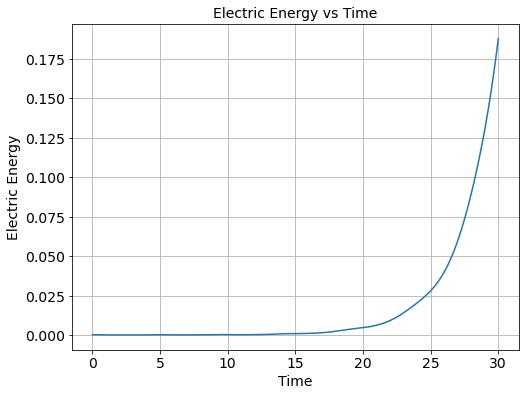

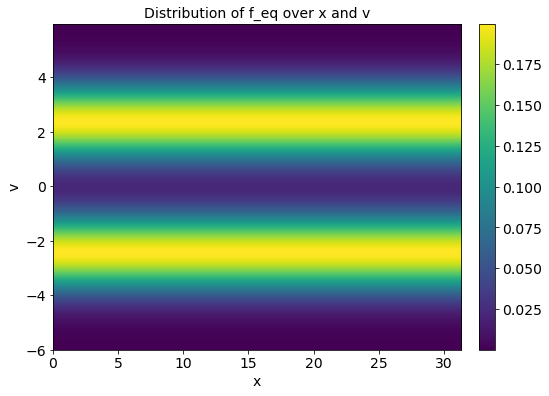

(300, 256, 256)


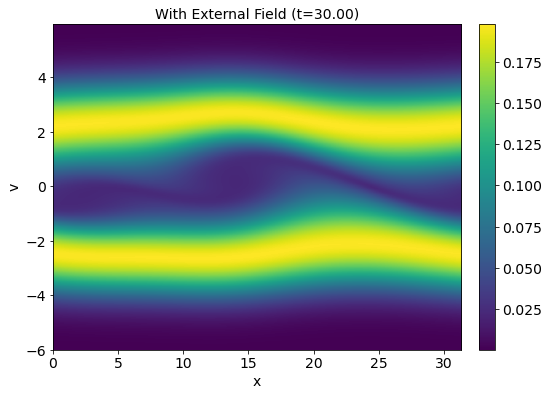

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import jax
import jax.numpy as jnp
import dataclasses
from typing import Callable, Union

# Mesh and Simulation Setup
mesh = make_mesh(10 * jnp.pi, 6.0, nx, nv)

L = 10 * jnp.pi
LV = 6.0
alpha = 0.5
mu1 = 2.4
mu2 = -2.4
f_eq = (alpha * jnp.exp(-0.5 * (mesh.V - mu1)**2) + (1 - alpha) * jnp.exp(-0.5 * (mesh.V - mu2)**2)) / jnp.sqrt(2 * jnp.pi)
epsilon = 0.001
k_0 = 0.2
f_iv = (1.0 + epsilon * jnp.cos(k_0 * mesh.X)) * f_eq

# New coefficients for the basis functions (15 cosine and 15 sine)
coefficients = [
    3.5164488e-04, 9.0411077e-06, -3.1953386e-05, -6.0834586e-06,
    5.8570990e-06, 6.0852408e-06, -2.7067827e-06, -8.1664248e-06,
    -8.8577590e-06, -9.7180082e-06, -9.5229143e-06, -9.5641644e-06,
    -8.8652696e-06, -8.6681093e-06, -7.7312543e-06, -9.6406386e-04,
    -5.9252861e-04, 2.9924628e-05, 4.2226049e-05, 5.3339943e-05,
    3.5979556e-05, 2.5546415e-05, 1.0124806e-05, 6.6790512e-06,
    1.3618927e-06, 3.0158180e-06, 7.7909431e-07, 3.0062322e-06,
    1.2950333e-06, 3.2279252e-06
]

# Define the basis functions
basis_functions = [
    jnp.cos(k * mesh.xs / mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
] + [
    jnp.sin(k * mesh.xs / mesh.period_x * 2 * jnp.pi) for k in range(1, 16)
]

# Function to compute the external field H with the given coefficients
def compute_external_field(xs, coefficients, basis_functions):
    H = jnp.zeros(len(xs))
    for coeff, basis_func in zip(coefficients, basis_functions):
        H += coeff * basis_func
    return H

# Compute the external field
H = compute_external_field(mesh.xs, coefficients, basis_functions)

# Function to plot the distribution of f_eq over x and v
def plot_feq_distribution(ax, f_eq, title):
    im = ax.imshow(f_eq.T, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], 
                   aspect='auto', cmap='viridis')
    ax.set_title(title)
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

# Modify the plot_distribution function to handle 2D data
def plot_distribution(ax, data, title, time):
    im = ax.imshow(data.T, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], 
                   aspect='auto', cmap='viridis')
    ax.set_title(f'{title} (t={time:.2f})')
    ax.set_xlabel('x')
    ax.set_ylabel('v')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

# Solver initialization
solver = VlasovPoissonSolver(mesh=mesh, dt=dt, f_eq=f_eq)

# Run the forward solver without JIT
f_array, E_array, ee_array = solver.run_forward_jax_loop(f_iv, H, t_final=t_final)

# Plot electric energy over time
fig, ax = plt.subplots(figsize=(8, 6))
t_values = jnp.linspace(0, t_final, int(t_final / dt))

plt.plot(t_values, ee_array)
plt.xlabel('Time')
plt.ylabel('Electric Energy')
plt.title('Electric Energy vs Time')
plt.grid(True)
plt.show()

# Plot the distribution of f_eq over x and v
fig, ax = plt.subplots(figsize=(8, 6))
plot_feq_distribution(ax, f_eq, 'Distribution of f_eq over x and v')
plt.show()

print(f_array.shape)  # This will help understand the dimensions of f_array

# Plot f_array at the final time step
fig, ax = plt.subplots(figsize=(8, 6))
plot_distribution(ax, f_array[-1], 'With External Field', t_final)
plt.show()


In [ ]:
# # Test Code for JAX Version of `shift_by_n_pure`
# import jax.numpy as jnp
# import jax

# # Define parameters for the test
# vs = jnp.linspace(-3, 3, 8, endpoint=False)  # Same as the NumPy version

# # Updated parameters to match NumPy version
# dv = 0.3
# dt = 0.5
# nx = 8

# # Create example data for `g` and `EH`
# g = jnp.array([[jnp.sin(2 * jnp.pi * i / nx) for _ in vs] for i in range(nx)])  # Random initial values like NumPy version
# EH = jnp.array([jnp.cos(2 * jnp.pi * i / nx) for i in range(nx)])  # Updated to match random type of input

# # Run the JAX version
# shifted_g_jax = shift_by_n_pure(vs, dv, dt, g, EH)

# # Print the result for verification
# print("Shifted g (JAX version):")
# print(shifted_g_jax)


In [ ]:
# # Import necessary modules
# import jax.numpy as jnp
# import matplotlib.pyplot as plt
# from numpy import cos, pi, sin, sqrt, exp

# # Set up the initial data for the JAX test, exactly matching the setup in your provided code
# nx = 128
# nv = 128
# deltat = 0.1
# problem = 'ts'

# # Define problem-specific parameters for the "ts" case
# if problem == 'ts':
#     L = 10 * pi
#     LV = 6.0
#     mesh = make_mesh(L, LV, nx, nv)
#     f_eq_jax = 0.5 * (jnp.exp(-0.5 * (mesh.V - 2.4) ** 2) + jnp.exp(-0.5 * (mesh.V + 2.4) ** 2)) / jnp.sqrt(2 * jnp.pi)
#     f_iv_jax = (1.0 + 0.001 * jnp.cos(0.2 * mesh.X)) * f_eq_jax
#     t_final = 10

# # Number of time steps
# num_steps = int(t_final / deltat)

# # Set initial control field `H_jax`
# H_jax = jnp.sin(mesh.xs * jnp.pi)

# # Instantiate the JAX solver with the mesh and initial conditions
# jax_solver = VlasovPoissonSolver(mesh, deltat, f_eq_jax)

# # Run the JAX `run_forward_jax_loop` using `f_iv_jax` and `H_jax`
# f_array, E_array, ee_array = jax_solver.run_forward_jax_loop(f_iv_jax, H_jax, t_final)

# # Plot results

# # Plot f_array over time (2D plot for each time step)
# for i, f in enumerate(f_array):
#     plt.figure()
#     plt.imshow(f.T, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], aspect='auto')
#     plt.colorbar(label="f")
#     plt.xlabel('x')
#     plt.ylabel('v')
#     plt.title(f'f at time step {i}')
#     plt.show()

# # Plot electric energy (ee_array) over time
# plt.figure()
# plt.plot(range(len(ee_array)), ee_array, label='Electric Energy')
# plt.xlabel('Time step')
# plt.ylabel('Electric Energy')
# plt.title('Electric Energy over Time')
# plt.legend()
# plt.show()

# # Plot E_array over time (1D plot for each time step)
# for i, E in enumerate(E_array):
#     plt.figure()
#     plt.plot(mesh.xs, E, label=f'E at step {i}')
#     plt.xlabel('x')
#     plt.ylabel('E')
#     plt.title(f'E over x at time step {i}')
#     plt.legend()
#     plt.show()

# # Display summary results
# print("JAX `run_forward_jax_loop` Results:")
# print("f_array:", f_array)
# print("E_array:", E_array)
# print("ee_array:", ee_array)


In [ ]:
# # Import necessary modules for JAX if not already imported
# import jax.numpy as jnp
# import matplotlib.pyplot as plt

# # Create mesh, initial conditions, and instantiate the solver for JAX
# mesh = make_mesh(10 * pi, 6.0, 256, 256)
# f_eq_jax = 0.5 * (jnp.exp(-0.5 * (mesh.V - 2.4) ** 2) + jnp.exp(-0.5 * (mesh.V + 2.4) ** 2)) / jnp.sqrt(2 * jnp.pi)
# f_iv_jax = (1.0 + 0.001 * jnp.cos(0.2 * mesh.X)) * f_eq_jax
# H_jax = jnp.sin(mesh.xs * jnp.pi)

# # Instantiate the JAX solver with mesh and initial conditions
# jax_solver = VlasovPoissonSolver(mesh, deltat, f_eq_jax)

# # Run the forward solver to get `f_array`, `E_array`
# f_array, E_array, ee_array = jax_solver.run_forward_jax_loop(f_iv_jax, H_jax, t_final)

# # Initialize `gT` as the terminal gradient (e.g., gradient of cost function)
# gT_jax = 2 * (f_array[-1] - f_eq_jax) / deltat

# # Run the JAX backward solver
# fs_array_jax, g_starstars_array_jax = jax_solver.run_backward_loop(gT_jax, f_array, E_array)

# # Plot the results
# for i, (g, g_starstar) in enumerate(zip(fs_array_jax, g_starstars_array_jax)):
#     plt.figure()
#     plt.imshow(g, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], aspect='auto')
#     plt.colorbar(label="g")
#     plt.xlabel('x')
#     plt.ylabel('v')
#     plt.title(f'g at backward step {i} (JAX)')
#     plt.show()

#     plt.figure()
#     plt.imshow(g_starstar, extent=[float(mesh.xs[0]), float(mesh.xs[-1]), float(mesh.vs[0]), float(mesh.vs[-1])], aspect='auto')
#     plt.colorbar(label="g_starstar")
#     plt.xlabel('x')
#     plt.ylabel('v')
#     plt.title(f'g_starstar at backward step {i} (JAX)')
#     plt.show()

# # Display summary results
# print("JAX Backward Pass Results:")
# print("fs_array (JAX):", fs_array_jax)
# print("g_starstars_array (JAX):", g_starstars_array_jax)
